## BorutaShap(importance_measure='gini',classification=False)

* very very expensive
* train of boruta columns
* outlier removal iqr
* mutual info
* outlier removal by eye test from scatterplot
  * [('total_indoor_sqft', 11000),
  * ('GrLivArea', 4000),
  *  ('TotalBsmtSF', 4000),
  *  ('1stFlrSF', 3000),
  *  ('no_finishes', 100000),
  *  ('TotalBsmtSF', 4000),
  *  ('LotFrontage', 250),
  *  ('BsmtFinSF1', 4000),
  *  ('MasVnrArea', 1200)]
  
* apply log to some features and plot scatterplots

###  Intro to ClusterS
#### Cluster Labels as a Feature
* Applied to a single real-valued feature, 
* clustering acts like a traditional "binning" or "discretization" transform. 
* On multiple features, it's like "multi-dimensional binning" (sometimes called vector quantization).

In [ ]:
X = df.copy()
y = X.pop("CompressiveStrength")

# Train and score baseline model
baseline = RandomForestRegressor(criterion="mae", random_state=0)
baseline_score = cross_val_score(
    baseline, X, y, cv=5, scoring="neg_mean_absolute_error"
)
baseline_score = -1 * baseline_score.mean()

print(f"MAE Baseline Score: {baseline_score:.4}")

In [3]:
    import pandas as pd
    import numpy as np
    import seaborn as sns

    import warnings
    warnings.filterwarnings('ignore')

    import matplotlib.pyplot as plt
    import seaborn as sns

In [4]:
LE_df = pd.read_csv("data/train_df_label_encoded.csv")
OHE_df = pd.read_csv("data/train_df_OHE_encoded.csv")

In [5]:
LE_df.head().T

,0,1,2,3,4
Id,1.000000,2.000000,3.000000,4.000000,5.000000
MSSubClass,60.000000,20.000000,60.000000,70.000000,60.000000
MSZoning,0.000000,0.000000,0.000000,0.000000,0.000000
LotFrontage,65.000000,80.000000,68.000000,60.000000,84.000000
LotArea,8450.000000,9600.000000,11250.000000,9550.000000,14260.000000
...,...,...,...,...,...
avg_Bmt_Qual,5.000000,4.600000,5.200000,4.000000,5.400000
avg_Gar_Qual,4.000000,4.000000,4.000000,3.500000,4.000000
total_All_Qualities,59.000000,58.600000,60.200000,54.500000,61.400000
avg_All_Qualities,5.363636,5.327273,5.472727,4.954545,5.581818


In [8]:
LE_df

Index(['Id', 'MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street',
       'Alley', 'LotShape', 'LandContour', 'Utilities',
       ...
       'total_Bmt_Ql_Cd', 'total_Garage_Ql_Cd', 'total_Bmt_Fn_Area',
       'Bsmt_Fsh_Per', 'avg_Ext_Qual', 'avg_Bmt_Qual', 'avg_Gar_Qual',
       'total_All_Qualities', 'avg_All_Qualities', 'kfold'],
      dtype='object', length=120)

In [16]:
LE_df["LivLotRatio"] = LE_df.GrLivArea  /LE_df.LotArea
LE_df["Spaciousness"] = (LE_df['1stFlrSF'] + LE_df['2ndFlrSF']) / LE_df.TotRmsAbvGrd
#X_1["TotalOutsideSF"] =  X.WoodDeckSF + X.OpenPorchSF + X.EnclosedPorch + X.Threeseasonporch + X.ScreenPorch

LE_df["PorchTypes"] = LE_df[['WoodDeckSF','OpenPorchSF','EnclosedPorch','3SsnPorch','ScreenPorch']].gt(0).sum(axis=1)


In [114]:
Ext_Qual_Cond = ['ExterQual','ExterCond']
Bmt_Qual_Cond = ['BsmtQual','BsmtCond','BsmtFinType2','BsmtFinType1','BsmtExposure']
Bmt_Fnsh_Area = ['BsmtFinSF1','BsmtFinSF2']
Garage_Qual_Cond = ['GarageFinish','GarageQual','GarageCond','GarageFinish']

In [115]:
LE_df["Ext_Qual_Cond_cnt"] = LE_df[Ext_Qual_Cond].gt(0).sum(axis=1)
LE_df["Bmt_Qual_Cond_cnt"] = LE_df[Bmt_Qual_Cond].gt(0).sum(axis=1)
LE_df["Bmt_Finish_Area_cnt"] = LE_df[Bmt_Fnsh_Area].gt(0).sum(axis=1)
LE_df["Gra_Qual_Cond_cnt"] = LE_df[Garage_Qual_Cond].gt(0).sum(axis=1)

In [116]:
LE_df.columns.to_list()

['Id',
 'MSSubClass',
 'MSZoning',
 'LotFrontage',
 'LotArea',
 'Street',
 'Alley',
 'LotShape',
 'LandContour',
 'Utilities',
 'LotConfig',
 'LandSlope',
 'Neighborhood',
 'Condition1',
 'Condition2',
 'BldgType',
 'HouseStyle',
 'OverallQual',
 'OverallCond',
 'YearBuilt',
 'YearRemodAdd',
 'RoofStyle',
 'RoofMatl',
 'Exterior1st',
 'Exterior2nd',
 'MasVnrType',
 'MasVnrArea',
 'ExterQual',
 'ExterCond',
 'Foundation',
 'BsmtQual',
 'BsmtCond',
 'BsmtExposure',
 'BsmtFinType1',
 'BsmtFinSF1',
 'BsmtFinType2',
 'BsmtFinSF2',
 'BsmtUnfSF',
 'TotalBsmtSF',
 'Heating',
 'HeatingQC',
 'CentralAir',
 'Electrical',
 '1stFlrSF',
 '2ndFlrSF',
 'LowQualFinSF',
 'GrLivArea',
 'BsmtFullBath',
 'BsmtHalfBath',
 'FullBath',
 'HalfBath',
 'BedroomAbvGr',
 'KitchenAbvGr',
 'KitchenQual',
 'TotRmsAbvGrd',
 'Functional',
 'Fireplaces',
 'FireplaceQu',
 'GarageType',
 'GarageYrBlt',
 'GarageFinish',
 'GarageCars',
 'GarageArea',
 'GarageQual',
 'GarageCond',
 'PavedDrive',
 'WoodDeckSF',
 'OpenPorchSF'

In [117]:
new_trans_cols=  ['PorchTypes','Ext_Qual_Cond_cnt','Bmt_Qual_Cond_cnt','Bmt_Finish_Area_cnt','Gra_Qual_Cond_cnt']
for col in new_trans_cols:
    print(col)
    print(LE_df[col].value_counts())
    print('==========================')

PorchTypes
1    609
2    549
0    254
3     48
Name: PorchTypes, dtype: int64
Ext_Qual_Cond_cnt
2    1459
1       1
Name: Ext_Qual_Cond_cnt, dtype: int64
Bmt_Qual_Cond_cnt
5    1421
0      37
4       2
Name: Bmt_Qual_Cond_cnt, dtype: int64
Bmt_Finish_Area_cnt
1    826
0    467
2    167
Name: Bmt_Finish_Area_cnt, dtype: int64
Gra_Qual_Cond_cnt
4    1379
0      81
Name: Gra_Qual_Cond_cnt, dtype: int64


In [118]:
LE_df = LE_df.drop(['Ext_Qual_Cond_cnt','Bmt_Qual_Cond_cnt','Gra_Qual_Cond_cnt'],axis=1)

In [4]:
#'YearBuilt','YearRemodAdd','YrSold',

In [17]:
drops =['Id','Utilities','Street','Alley','area_per_finishes','RoofMatl',
       'MiscFeature','Heating','kfold','SalePrice']

In [7]:
from BorutaShap import BorutaShap, load_data

In [8]:
X=LE_df.drop(drops,axis=1)

In [9]:
y=LE_df.SalePrice

In [10]:
# no model selected default is Random Forest, if classification is False it is a Regression problem
Feature_Selector1 = BorutaShap(importance_measure='shap',
                              classification=False)

Feature_Selector1.fit(X=X, y=y, n_trials=100, random_state=0)






32 attributes confirmed important: ['2ndFlrSF', 'total_Bmt_Fn_Area', 'BsmtUnfSF', 'total_All_Qualities', 'YearBuilt_Age', 'GarageCars', 'total_Bmt_Ql_Cd', 'TotalBsmtSF', 'BsmtQual', 'total_outdoor_sqft', 'OverallQual', 'total_in_out_sqft', 'GrLivArea', 'OpenPorchSF', 'YrSd_YrBlt', 'total_indoor_sqft', 'no_finishes', 'MasVnrArea', 'YrSd_YrRmd', 'GarageType', 'Neighborhood', 'total_Max_Porch_Area', 'GarageYrBlt', 'avg_All_Qualities', 'Garage_per_Car_Cap', 'YearRemodAdd_Age', 'YearBuilt', 'BsmtFinSF1', '1stFlrSF', 'GarageArea', 'avg_Bmt_Qual', 'LotFrontage']
74 attributes confirmed unimportant: ['LotShape_LandContour', 'BsmtFinType2', 'GarageCond', 'GarageFinish', 'BldgType', 'YrSold', 'Condition1_Condition2', 'BsmtExposure', 'BsmtCond', 'SaleCondition', 'Foundation', 'MSSubClass', 'LotShape_LotConfig', 'no_finishes_perc', 'Exterior2nd', 'Foundation_MasVnrType', 'LandSlope', 'house_story', 'KitchenAbvGr', 'OverallCond', 'LotShape', 'RoofStyle', 'SaleCondition_SaleType', 'CentralAir', 'Mi

In [11]:
# no model selected default is Random Forest, if classification is False it is a Regression problem
Feature_Selector2 = BorutaShap(importance_measure='gini',
                              classification=False)

Feature_Selector2.fit(X=X, y=y, n_trials=100, random_state=0)



17 attributes confirmed important: ['TotalBsmtSF', '2ndFlrSF', 'YrSd_YrBlt', 'total_indoor_sqft', 'no_finishes', 'OverallQual', 'avg_All_Qualities', 'total_in_out_sqft', 'total_All_Qualities', 'MasVnrArea', 'YearBuilt', 'GrLivArea', 'BsmtFinSF1', '1stFlrSF', 'GarageArea', 'YearBuilt_Age', 'LotFrontage']
87 attributes confirmed unimportant: ['LotShape_LandContour', 'BsmtFinType2', 'GarageCond', 'BldgType', 'YrSold', 'FullBath', 'BsmtCond', 'SaleCondition', 'MSSubClass', 'LotShape_LotConfig', 'no_finishes_perc', 'Foundation_MasVnrType', 'house_story', 'KitchenAbvGr', 'RoofStyle', 'Fireplaces', 'Remodeled', 'house_finish', 'YearRemodAdd', 'HouseStyle', 'Exterior1st', 'Electrical', 'BedroomAbvGr', 'LotAreaPerFront', '3SsnPorch', 'Bsmt_Unf_Per', 'LotShape_LandSlope', 'HeatingQC', 'FireplaceQu', 'GarageType', 'YrSd_YrRmd', 'GarageQual', 'ExterCond', 'Exterior1st_Exterior2nd', 'total_Max_Porch_Area', 'LotConfig', 'LandContour', 'total_Garage_Ql_Cd', 'YearRemodAdd_Age', 'PavedDrive', 'Conditi

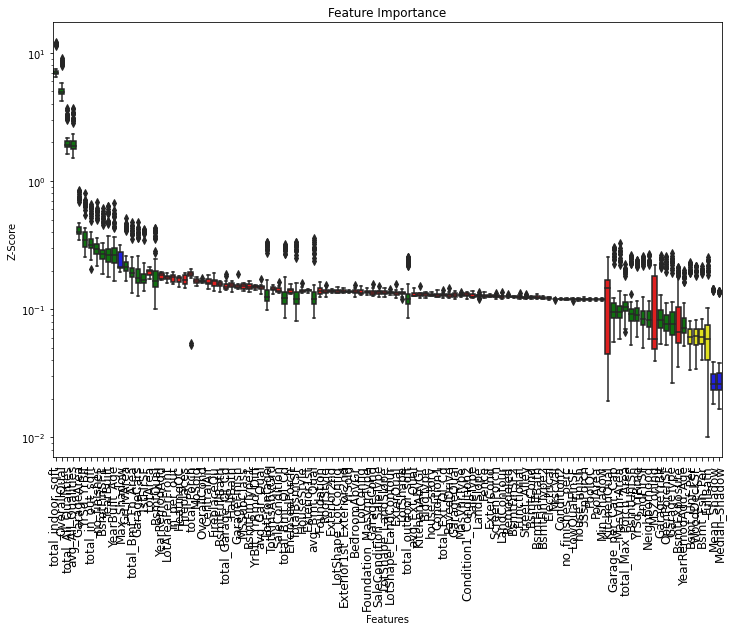

In [12]:
# Returns Boxplot of features
# I would recommend plotting Y axis on the Log Scale
Feature_Selector1.plot(X_size=12, figsize=(12,8),
            y_scale='log', which_features='all')

In [19]:
subset = Feature_Selector1.Subset()
subset.head()

,2ndFlrSF,total_Bmt_Fn_Area,BsmtUnfSF,total_All_Qualities,YearBuilt_Age,GarageCars,total_Bmt_Ql_Cd,TotalBsmtSF,BsmtQual,total_outdoor_sqft,...,GarageYrBlt,avg_All_Qualities,Garage_per_Car_Cap,YearRemodAdd_Age,YearBuilt,BsmtFinSF1,1stFlrSF,GarageArea,avg_Bmt_Qual,LotFrontage
0,854,706.0,150.0,59.0,8,2.0,25.0,856.0,7,8998.0,...,2003.0,5.363636,182.666667,8,2003,706.0,856,548.0,5.0,65.0
1,0,978.0,284.0,58.6,35,2.0,23.0,1262.0,7,10060.0,...,1976.0,5.327273,153.333333,35,1976,978.0,1262,460.0,4.6,80.0
2,866,486.0,434.0,60.2,10,2.0,26.0,920.0,7,11858.0,...,2001.0,5.472727,202.666667,9,2001,486.0,920,608.0,5.2,68.0
3,756,216.0,540.0,54.5,96,3.0,20.0,756.0,5,10192.0,...,1998.0,4.954545,160.500000,41,1915,216.0,961,642.0,4.0,60.0
4,1053,655.0,490.0,61.4,11,3.0,27.0,1145.0,7,15096.0,...,2000.0,5.581818,209.000000,11,2000,655.0,1145,836.0,5.4,84.0


In [20]:
subset.SalePrice

AttributeError: 'DataFrame' object has no attribute 'SalePrice'

In [14]:
# no model selected default is Random Forest, if classification is False it is a Regression problem
Feature_Selector3 = BorutaShap(importance_measure='shap',
                              classification=False)

Feature_Selector3.fit(X=X, y=y, n_trials=100, random_state=0, sample=True)


31 attributes confirmed important: ['2ndFlrSF', 'total_Bmt_Fn_Area', 'BsmtUnfSF', 'total_All_Qualities', 'YearBuilt_Age', 'GarageCars', 'total_Bmt_Ql_Cd', 'TotalBsmtSF', 'BsmtQual', 'total_outdoor_sqft', 'OverallQual', 'total_in_out_sqft', 'GrLivArea', 'OpenPorchSF', 'YrSd_YrBlt', 'total_indoor_sqft', 'no_finishes', 'MasVnrArea', 'YrSd_YrRmd', 'GarageType', 'Neighborhood', 'GarageYrBlt', 'avg_All_Qualities', 'Garage_per_Car_Cap', 'YearRemodAdd_Age', 'YearBuilt', 'BsmtFinSF1', '1stFlrSF', 'GarageArea', 'avg_Bmt_Qual', 'LotFrontage']
70 attributes confirmed unimportant: ['LotShape_LandContour', 'BsmtFinType2', 'GarageCond', 'GarageFinish', 'BldgType', 'YrSold', 'Condition1_Condition2', 'BsmtCond', 'SaleCondition', 'Foundation', 'MSSubClass', 'LotShape_LotConfig', 'no_finishes_perc', 'Exterior2nd', 'Foundation_MasVnrType', 'LandSlope', 'house_story', 'KitchenAbvGr', 'OverallCond', 'LotShape', 'RoofStyle', 'SaleCondition_SaleType', 'CentralAir', 'MiscVal', 'BsmtHalfBath', 'Fireplaces', 'R

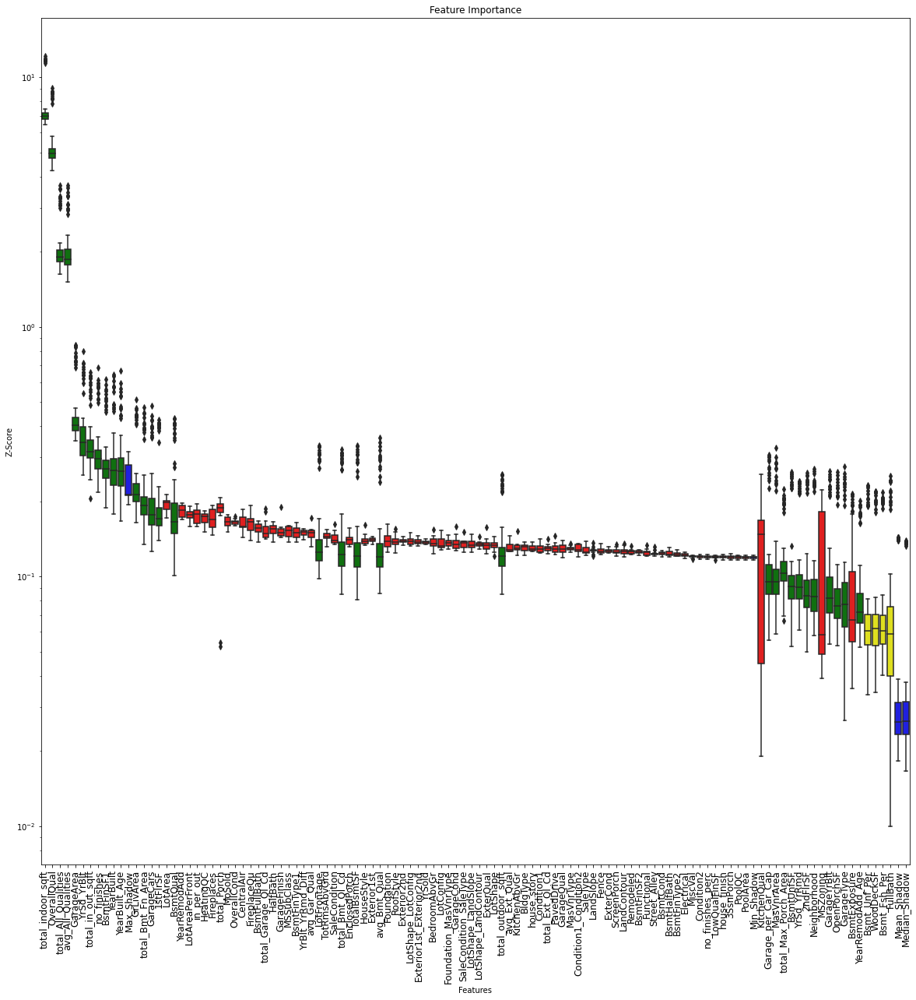

In [15]:
# Returns Boxplot of features
# I would recommend plotting Y axis on the Log Scale
Feature_Selector1.plot(X_size=12, figsize=(20,20),
            y_scale='log', which_features='all')

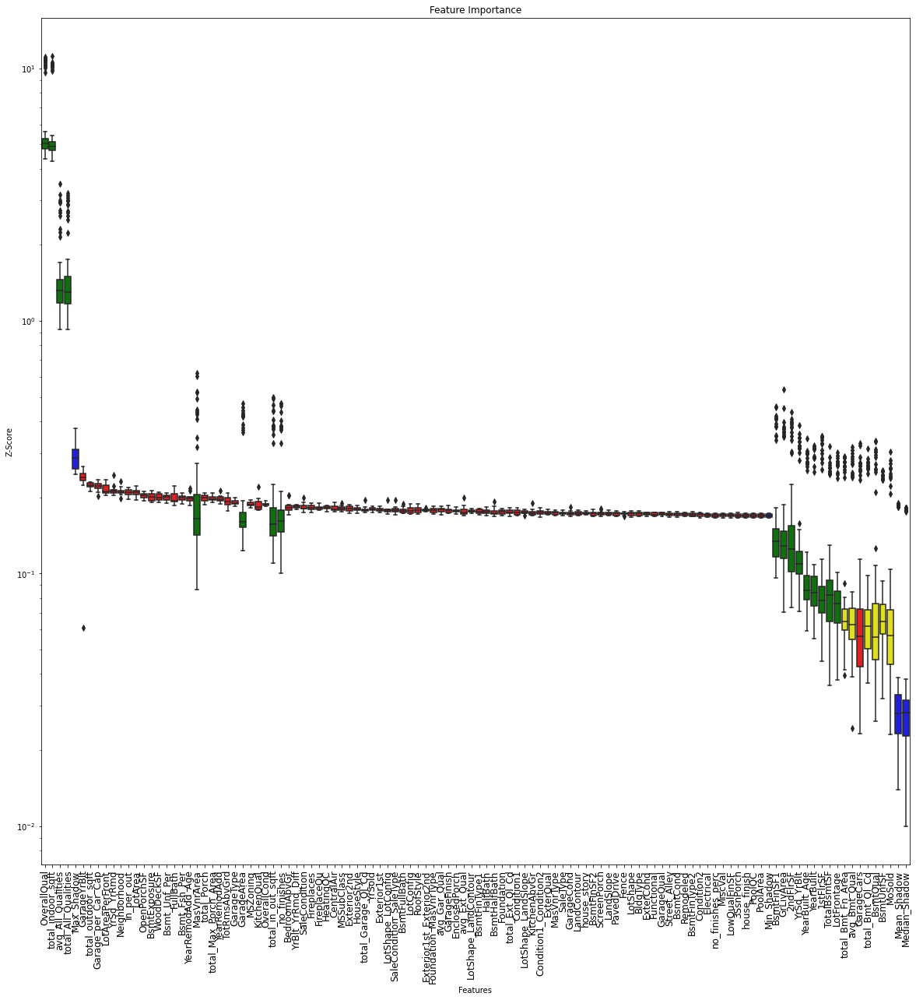

In [16]:
# Returns Boxplot of features
# I would recommend plotting Y axis on the Log Scale
Feature_Selector2.plot(X_size=12, figsize=(20,20),
            y_scale='log', which_features='all')

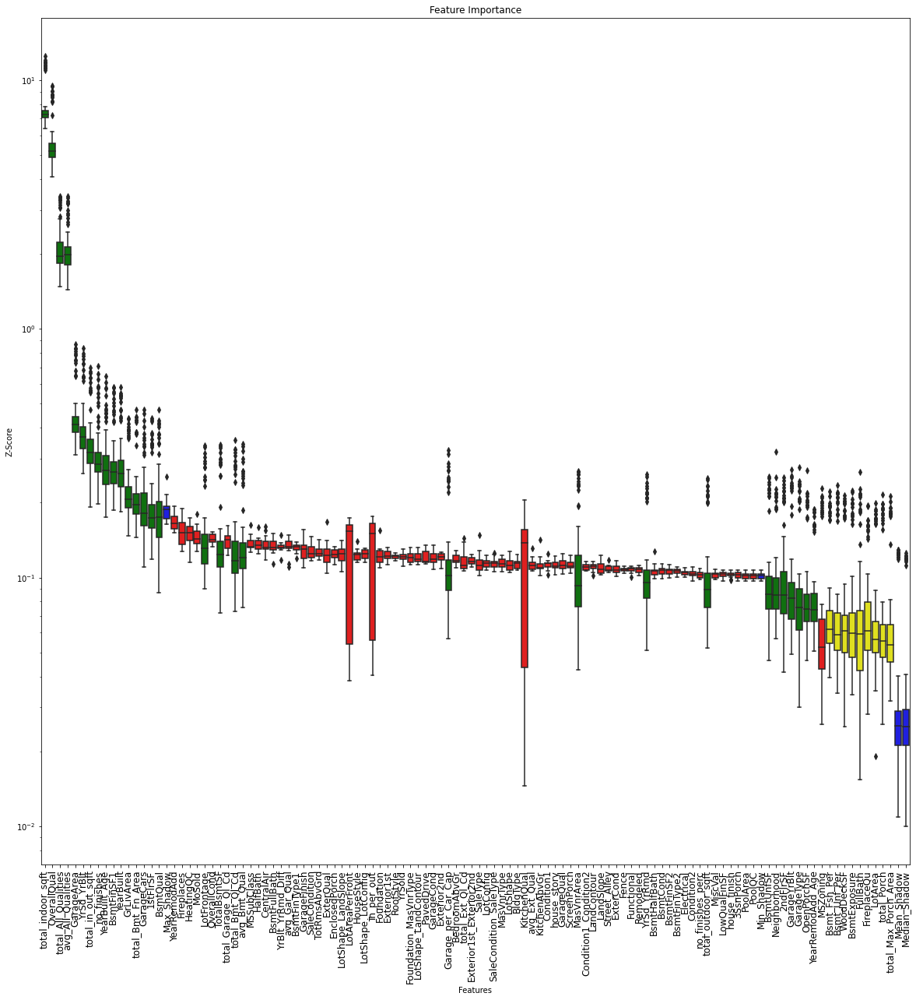

In [17]:
# Returns Boxplot of features
# I would recommend plotting Y axis on the Log Scale
Feature_Selector3.plot(X_size=12, figsize=(20,20),
            y_scale='log', which_features='all')

In [5]:
from xgboost import XGBRegressor
xgb = XGBRegressor(n_estimators=500)

#
from sklearn.ensemble import RandomForestRegressor ,ExtraTreesRegressor
from sklearn.linear_model import Lasso,LinearRegression
from sklearn.metrics import  mean_absolute_error,r2_score,mean_squared_error
las_R = Lasso()
L_R = LinearRegression()
rf = RandomForestRegressor(n_estimators=200)
et= ExtraTreesRegressor(n_estimators=200)
from sklearn.tree import DecisionTreeRegressor
D_R = DecisionTreeRegressor()

baseline = RandomForestRegressor(criterion="mae", random_state=0)
# 
#from sklearn.metrics import SCORERS
#SCORERS.keys()

classifier_list= [rf,et,L_R,las_R,D_R]
classifier_name =['rf','et','L_R','las_R','D_R']
scoring ='neg_root_mean_squared_error'

In [75]:
def run(df,target,model,fold,dropped,save_fold_csv=False):
    from sklearn import model_selection
    from sklearn import metrics ; from sklearn import preprocessing ; from sklearn import impute
    # we create a new column called kfold and fill it with -1
    df["kfold"] = -1
    # the next step is to randomize the rows of the data
    df = df.sample(frac=1).reset_index(drop=True)
    # fetch labels
    y = df[target].values
    # initiate the kfold class from model_selection module
    kf = model_selection.StratifiedKFold(n_splits=5)

    for f, (t_, v_) in enumerate(kf.split(X=df, y=y)): # f= fold, t_=train_index ,v_= valid_index
        df.loc[v_, 'kfold'] = f

    #save the new csv with kfold column
    #if save_fold_csv == True:
        #df.to_csv("../input/cat_train_folds.csv", index=False)
    # load the full training data with folds
    # df = pd.read_csv("../input/adult_folds.csv")
    #drop unwanted columns
    df = df.drop(dropped,axis=1)
    
    features = [f for f in df.columns if f not in ("kfold",target)]
    num_col =  [f for f in df.select_dtypes(exclude='object').columns if f not in ("kfold",target)]
    #1. fill all NaN values with NONE
    cat_col = df.select_dtypes(include='object').columns
    for col in cat_col:
    # do not encode the numerical columns
        df.loc[:, col] = df[col].astype(str).fillna("NONE")
        
    #3. fill all NaN values with median
    for col in num_col: 
        imputer = df[col].median()
        df.loc[:, col] = df[col].fillna(imputer)

    #2. label encode the features
    for col in cat_col: 
        lbl = preprocessing.LabelEncoder()
        lbl.fit(df[col])
        df.loc[:, col] = lbl.transform(df[col])
    # get training data using folds
    df_train = df[df.kfold != fold].reset_index(drop=True)
    # get validation data using folds
    df_valid = df[df.kfold == fold].reset_index(drop=True)
    # get training data
    x_train = df_train[features].values
    # get validation data
    x_valid = df_valid[features].values
    # fit model on training data (ohe)
    model.fit(x_train, df_train[target].values)
    # predict on validation data
    # we may need the probability values as we are calculating AUC
    # we will use the probability of 1s
    #valid_preds = model.predict_proba(x_valid)[:, 1]
    valid_prediction = model.predict(x_valid)
    # get roc auc score
    #auc = metrics.roc_auc_score(df_valid[target].values, valid_preds)
    #f1 = metrics.f1_score(df_valid[target].values, valid_prediction)
    MSE = metrics.mean_squared_error(df_valid[target].values, valid_prediction) ; RMSE = np.sqrt(MSE)
    #error= df_valid[target].values - valid_prediction
    #sns.distplot(error,kde=True)
    plt.figure(figsize=(10,8))
    plt.plot(np.arange(len(df_valid[target].values)),df_valid[target].values,label='Y_true',color='g')
    plt.plot(np.arange(len(df_valid[target].values)),valid_prediction,label='preds',color='r')
    plt.legend()
    plt.show()
    # print auc,f1
    #print(f"Fold = {fold}, AUC = {auc}, F1 = {f1}")
    print(f"Fold = {fold}, RMSE = {RMSE}")
    return(RMSE)

In [11]:
target='SalePrice'

In [19]:
baseline = RandomForestRegressor(criterion="mae", random_state=0)

# sub1

In [12]:
sub1= ['TotalBsmtSF', '2ndFlrSF', 'YrSd_YrBlt', 'total_indoor_sqft', 'no_finishes', 'OverallQual', 'avg_All_Qualities', 'total_in_out_sqft', 'total_All_Qualities', 'MasVnrArea',
       'YearBuilt', 'GrLivArea', 'BsmtFinSF1', '1stFlrSF', 'GarageArea', 'YearBuilt_Age', 'LotFrontage','SalePrice']

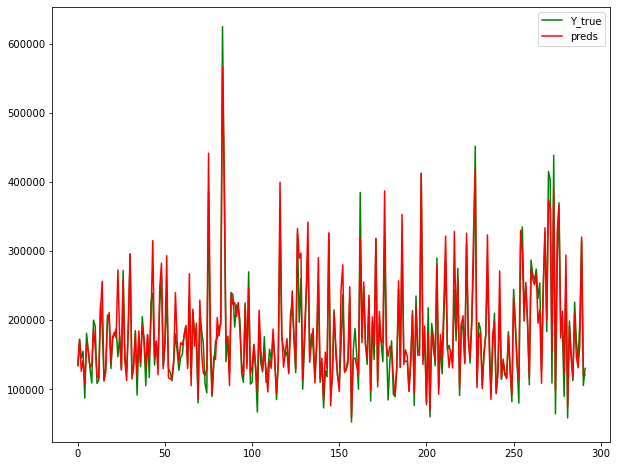

Fold = 0, RMSE = 24421.978618822337


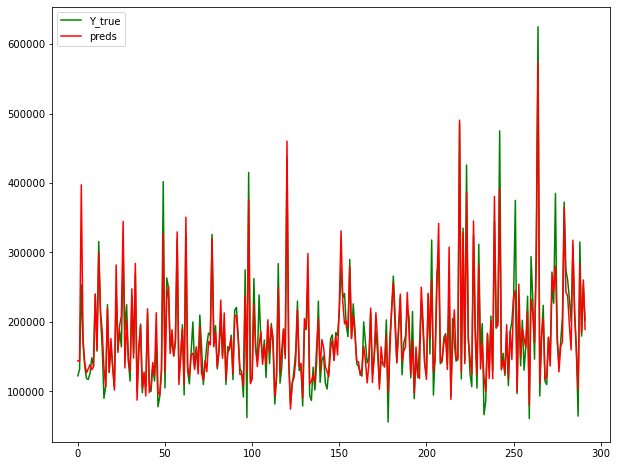

Fold = 1, RMSE = 25524.599841932337


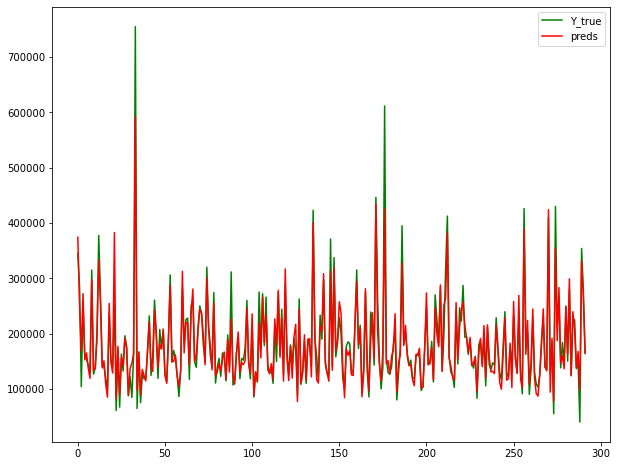

Fold = 2, RMSE = 25657.59463689284


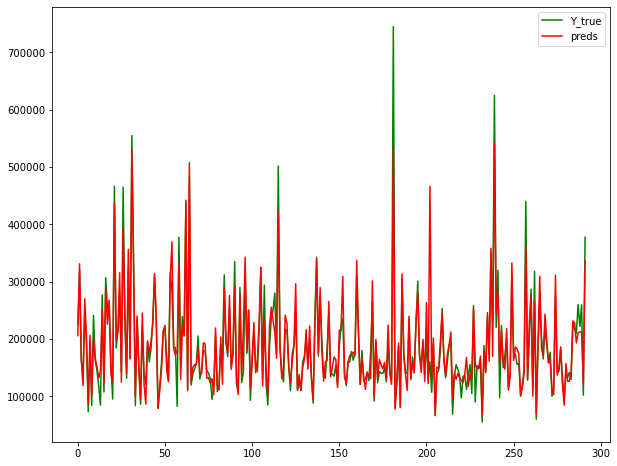

Fold = 3, RMSE = 32247.344266634576


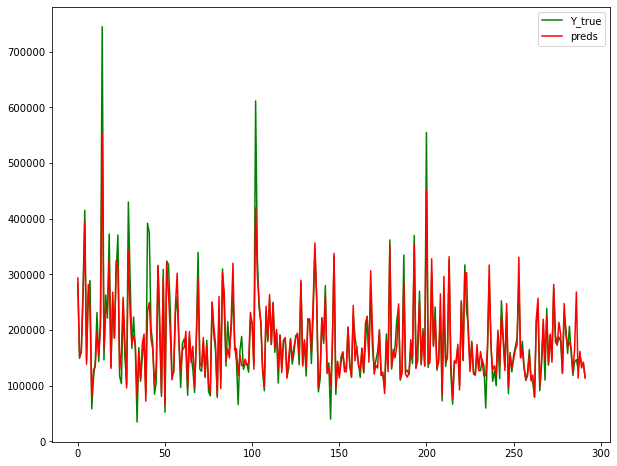

Fold = 4, RMSE = 29762.078788499202
mean_score =  27522.71923055626


In [76]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=LE_df[sub1],target=target,model=rf,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

count      1460.000000
mean     180921.195890
std       79442.502883
min       34900.000000
25%      129975.000000
50%      163000.000000
75%      214000.000000
max      755000.000000
Name: SalePrice, dtype: float64
max to 75 quatile ratio =  3.52803738317757
75 quatile to mean ratio =  1.1828354270310362


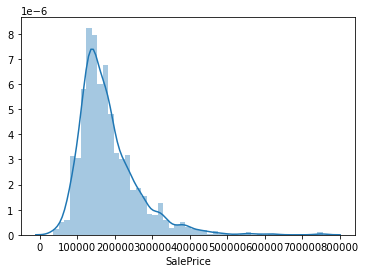

In [83]:
print(LE_df.SalePrice.describe())
print('max to 75 quatile ratio = ',LE_df.SalePrice.max()/LE_df.SalePrice.quantile(0.75))
print('75 quatile to mean ratio = ',LE_df.SalePrice.quantile(0.75)/LE_df.SalePrice.mean())
sns.distplot(a=LE_df['SalePrice'],kde=True)

In [112]:
def Calculate_IQR(df,col,get_new_df=False):
        q1 = df[col].quantile(0.25)  ; q3 = df[col].quantile(0.75)
        IQR = q3-q1
        lower_limit = q1 - 1.5*IQR  ; upper_limit = q3 + 1.5*IQR
        print("DESC")
        print(df[col].describe())
        print(" ")
        
        lower = df[(df[col]<lower_limit)]
        upper = df[(df[col] > upper_limit)]
        
        print('lower_limit = ',lower_limit,'   ||  ',' upper_limit = ',upper_limit)
        print('Counts == ; lower_limit = ',lower.shape[0],'   ||  ',' upper_limit = ',upper.shape[0])
        
        print(" ")
        possible_outlier = df[col][(df[col]<lower_limit) | (df[col] > upper_limit)]
        
        new_dist= df[(df[col]>lower_limit) & (df[col] < upper_limit)]
        print("Number of possible Outliers = ", len(possible_outlier))
        if len(possible_outlier) > 0:
            print("Outliers : ")
            print("head  : ",possible_outlier.head(3))
            print("tail  : ",possible_outlier.tail(3))
        print("================================================")
        if get_new_df == True:
            return new_dist
        
no_outlier = Calculate_IQR(df=LE_df,col='SalePrice',get_new_df=True)

DESC
count      1460.000000
mean     180921.195890
std       79442.502883
min       34900.000000
25%      129975.000000
50%      163000.000000
75%      214000.000000
max      755000.000000
Name: SalePrice, dtype: float64
 
lower_limit =  3937.5    ||    upper_limit =  340037.5
Counts == ; lower_limit =  0    ||    upper_limit =  61
 
Number of possible Outliers =  61
Outliers : 
head  :  11    345000
53    385000
58    438780
Name: SalePrice, dtype: int64
tail  :  1373    466500
1388    377500
1437    394617
Name: SalePrice, dtype: int64


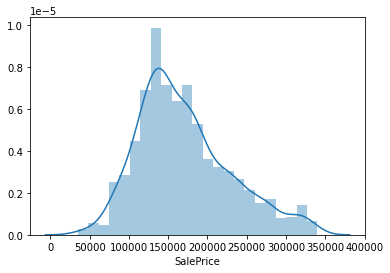

In [93]:
sns.distplot(no_outlier.SalePrice)

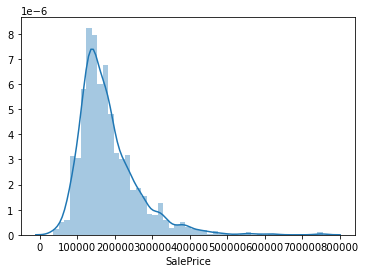

In [94]:
sns.distplot(LE_df.SalePrice)

In [109]:
LE_df.columns.to_list()

['Id',
 'MSSubClass',
 'MSZoning',
 'LotFrontage',
 'LotArea',
 'Street',
 'Alley',
 'LotShape',
 'LandContour',
 'Utilities',
 'LotConfig',
 'LandSlope',
 'Neighborhood',
 'Condition1',
 'Condition2',
 'BldgType',
 'HouseStyle',
 'OverallQual',
 'OverallCond',
 'YearBuilt',
 'YearRemodAdd',
 'RoofStyle',
 'RoofMatl',
 'Exterior1st',
 'Exterior2nd',
 'MasVnrType',
 'MasVnrArea',
 'ExterQual',
 'ExterCond',
 'Foundation',
 'BsmtQual',
 'BsmtCond',
 'BsmtExposure',
 'BsmtFinType1',
 'BsmtFinSF1',
 'BsmtFinType2',
 'BsmtFinSF2',
 'BsmtUnfSF',
 'TotalBsmtSF',
 'Heating',
 'HeatingQC',
 'CentralAir',
 'Electrical',
 '1stFlrSF',
 '2ndFlrSF',
 'LowQualFinSF',
 'GrLivArea',
 'BsmtFullBath',
 'BsmtHalfBath',
 'FullBath',
 'HalfBath',
 'BedroomAbvGr',
 'KitchenAbvGr',
 'KitchenQual',
 'TotRmsAbvGrd',
 'Functional',
 'Fireplaces',
 'FireplaceQu',
 'GarageType',
 'GarageYrBlt',
 'GarageFinish',
 'GarageCars',
 'GarageArea',
 'GarageQual',
 'GarageCond',
 'PavedDrive',
 'WoodDeckSF',
 'OpenPorchSF'

In [113]:
for col in sub1:
    Calculate_IQR(df=LE_df,col=col)

DESC
count    1460.000000
mean     1057.429452
std       438.705324
min         0.000000
25%       795.750000
50%       991.500000
75%      1298.250000
max      6110.000000
Name: TotalBsmtSF, dtype: float64
 
lower_limit =  42.0    ||    upper_limit =  2052.0
Counts == ; lower_limit =  37    ||    upper_limit =  24
 
Number of possible Outliers =  61
Outliers : 
head  :  17       0.0
39       0.0
70    2223.0
Name: TotalBsmtSF, dtype: float64
tail  :  1321       0.0
1373    2633.0
1412       0.0
Name: TotalBsmtSF, dtype: float64
DESC
count    1460.000000
mean      346.992466
std       436.528436
min         0.000000
25%         0.000000
50%         0.000000
75%       728.000000
max      2065.000000
Name: 2ndFlrSF, dtype: float64
 
lower_limit =  -1092.0    ||    upper_limit =  1820.0
Counts == ; lower_limit =  0    ||    upper_limit =  2
 
Number of possible Outliers =  2
Outliers : 
head  :  691     1872
1182    2065
Name: 2ndFlrSF, dtype: int64
tail  :  691     1872
1182    2065
Name

In [111]:
for col in sub1:
    Calculate_IQR(df=no_outlier,col=col)

DESC
count    1399.000000
mean     1024.273767
std       407.031806
min         0.000000
25%       788.000000
50%       973.000000
75%      1251.500000
max      6110.000000
Name: TotalBsmtSF, dtype: float64
 
lower_limit =  92.75    ||    upper_limit =  1946.75
 
Number of possible Outliers =  52
Outliers : 
head  :  17       0.0
39       0.0
66    1947.0
Name: TotalBsmtSF, dtype: float64
tail  :  1321       0.0
1359    1980.0
1412       0.0
Name: TotalBsmtSF, dtype: float64
DESC
count    1399.000000
mean      336.476054
std       421.440524
min         0.000000
25%         0.000000
50%         0.000000
75%       720.000000
max      1818.000000
Name: 2ndFlrSF, dtype: float64
 
lower_limit =  -1080.0    ||    upper_limit =  1800.0
 
Number of possible Outliers =  1
Outliers : 
head  :  304    1818
Name: 2ndFlrSF, dtype: int64
tail  :  304    1818
Name: 2ndFlrSF, dtype: int64
DESC
count    1399.000000
mean       37.739099
std        30.059547
min         0.000000
25%         9.000000
50%

# Logged

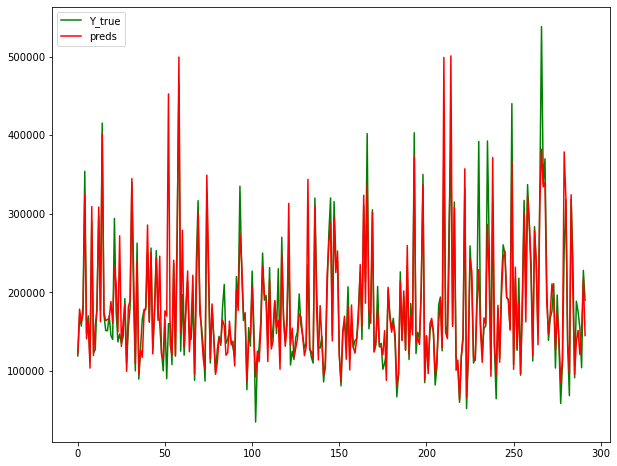

Fold = 0, RMSE = 34708.28719189669


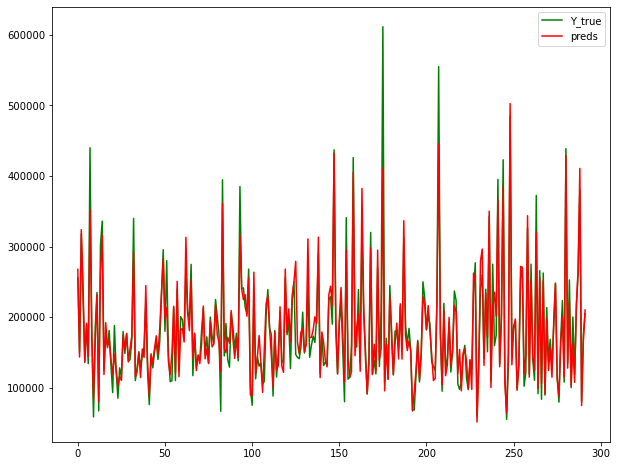

Fold = 1, RMSE = 25907.65433281266


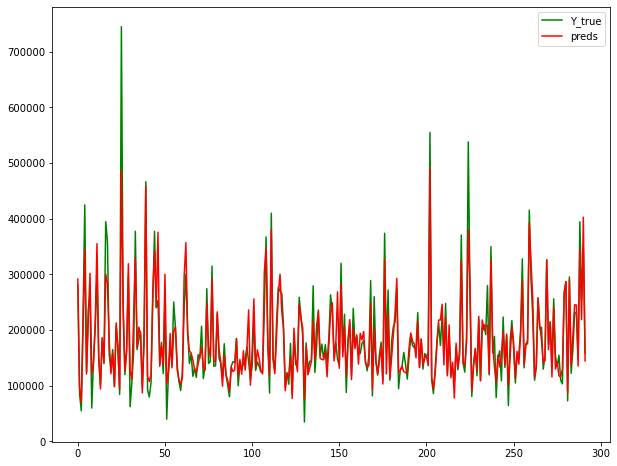

Fold = 2, RMSE = 31993.9701150132


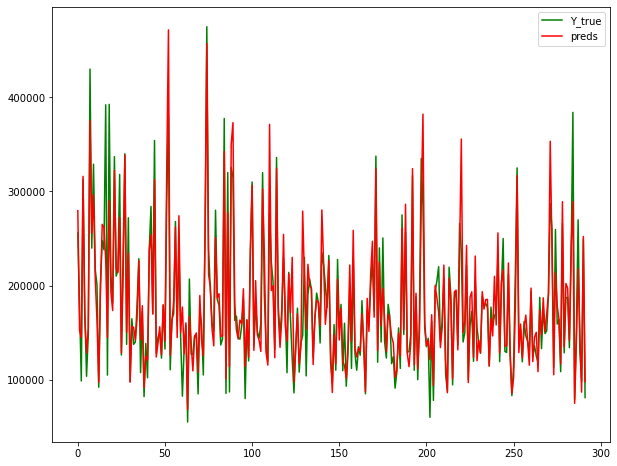

Fold = 3, RMSE = 28261.88734698188


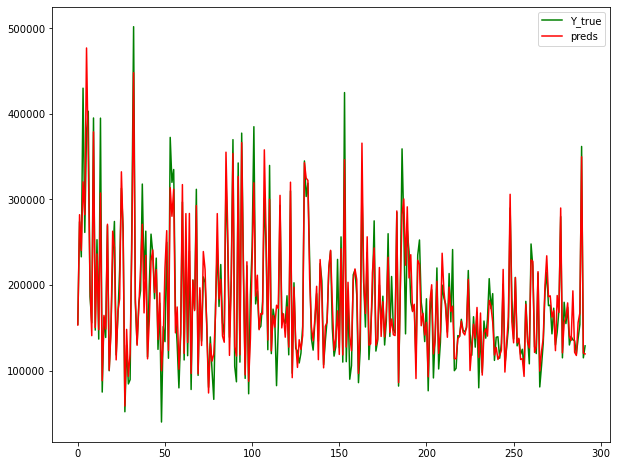

Fold = 4, RMSE = 25337.82143213718
mean_score =  29241.924083768325


In [85]:
#logged
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=logged[sub1],target=target,model=rf,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

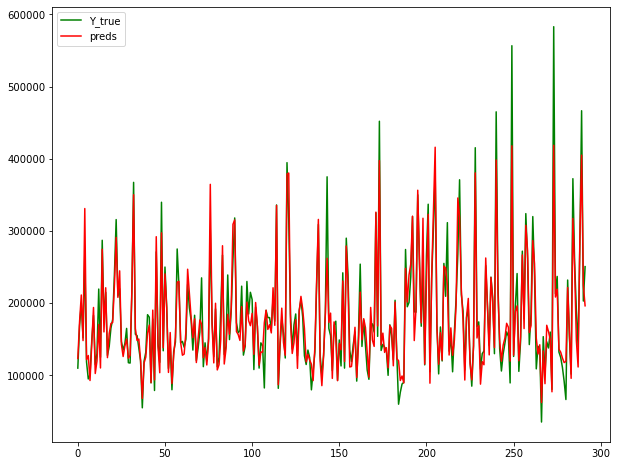

Fold = 0, RMSE = 26405.886851532345


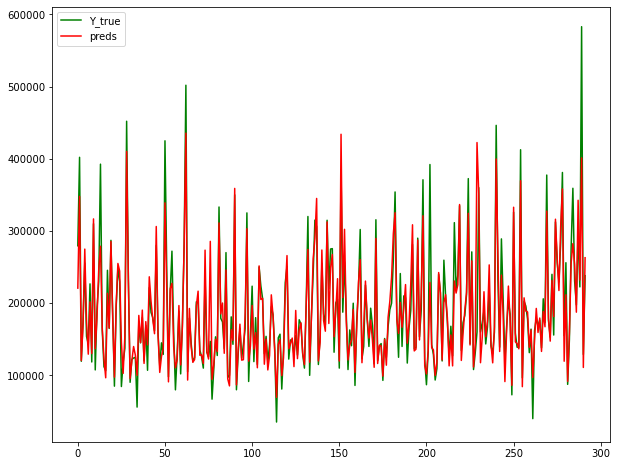

Fold = 1, RMSE = 32072.834580851693


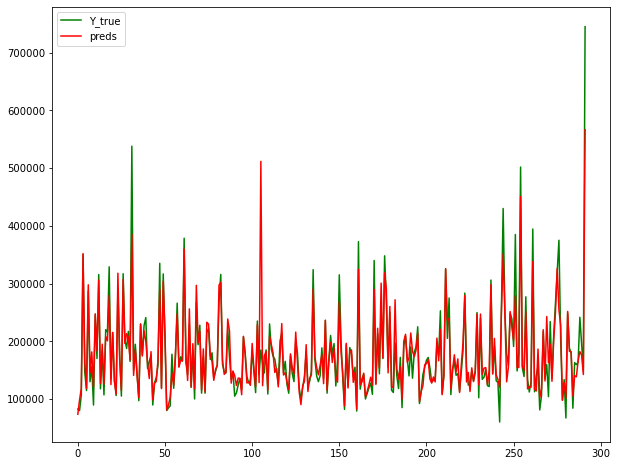

Fold = 2, RMSE = 31925.761845173638


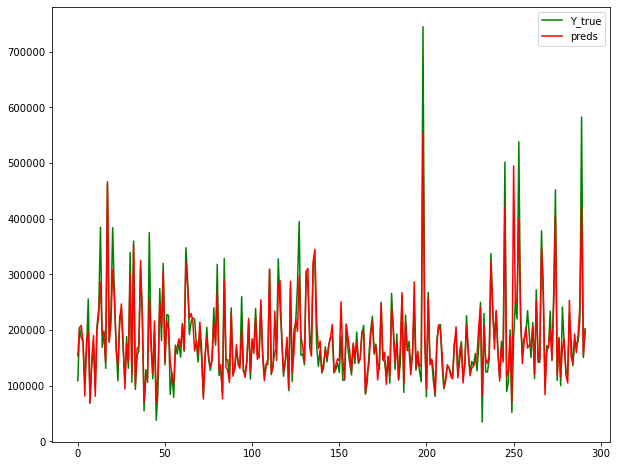

Fold = 3, RMSE = 34181.403427779536


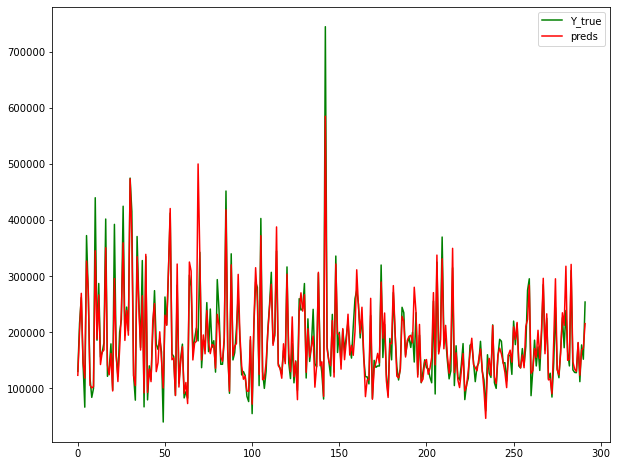

Fold = 4, RMSE = 31685.146703750856
mean_score =  31254.206681817614


In [86]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=logged[sub1],target=target,model=rf,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

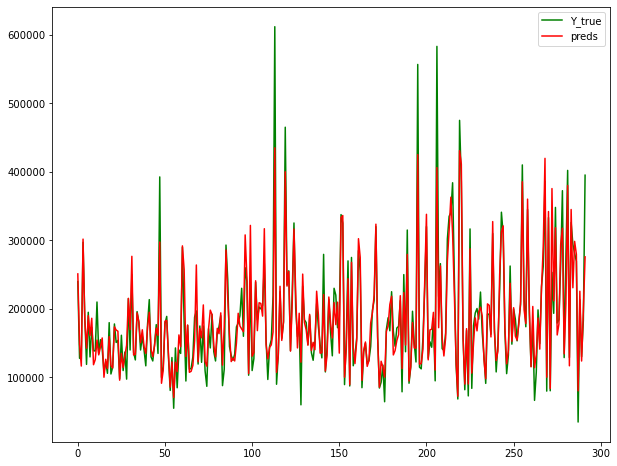

Fold = 0, RMSE = 30269.516496929507


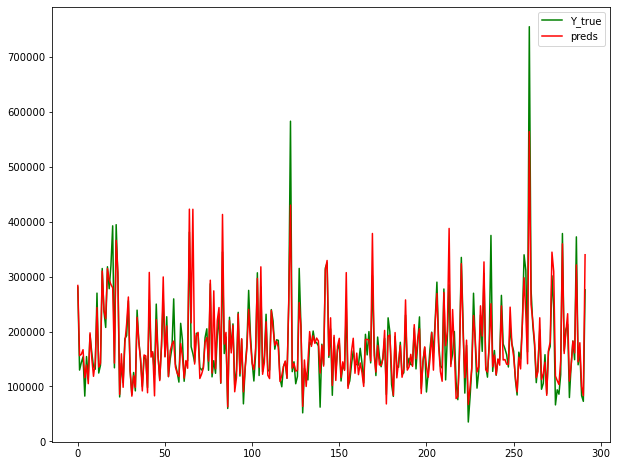

Fold = 1, RMSE = 32936.36574295359


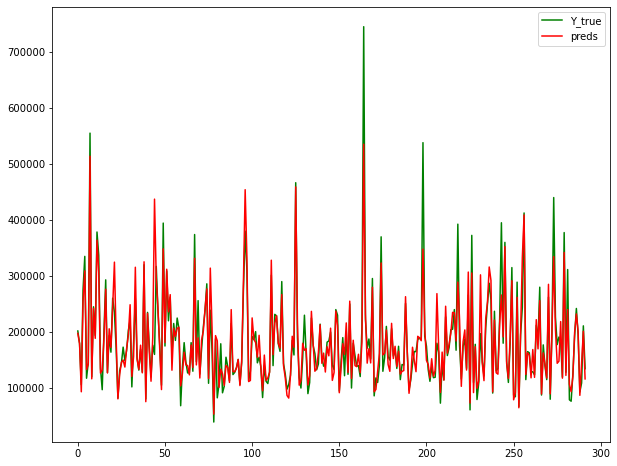

Fold = 2, RMSE = 34700.247187359295


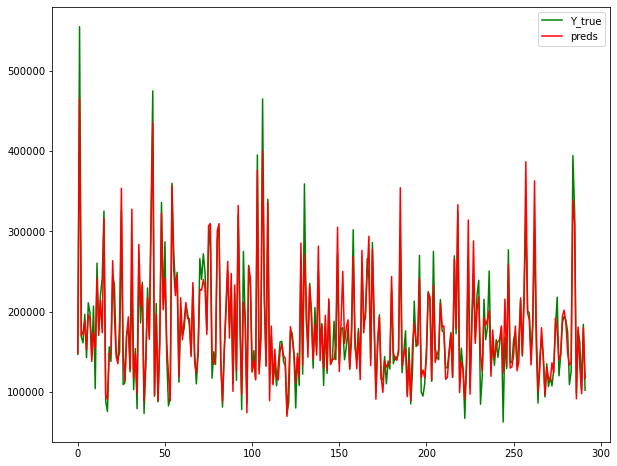

Fold = 3, RMSE = 22374.791266287146


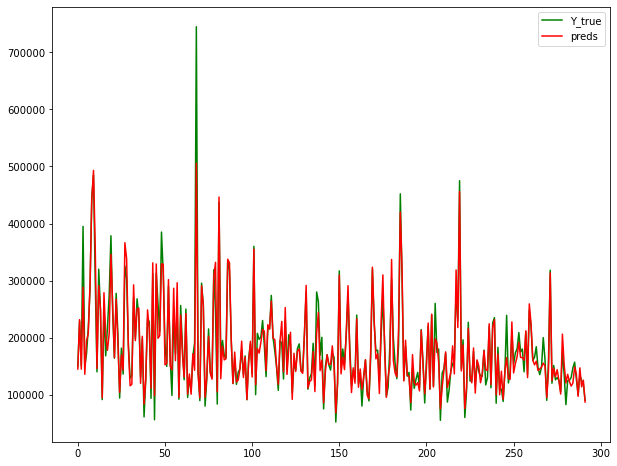

Fold = 4, RMSE = 24963.12282754291
mean_score =  29048.80870421449


In [95]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=LE_df[sub1],target=target,model=baseline,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

# no outlier

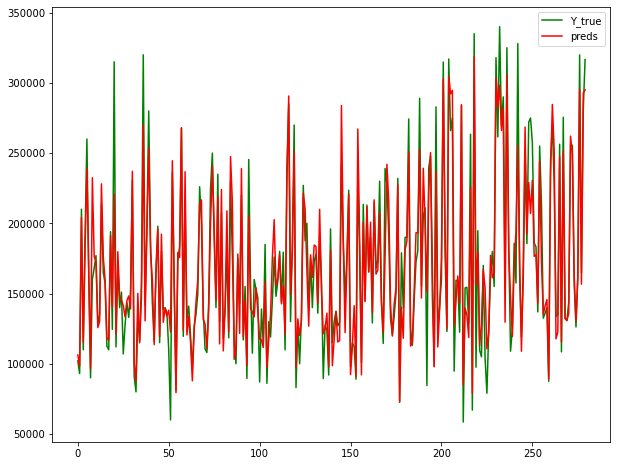

Fold = 0, RMSE = 20157.19044395211


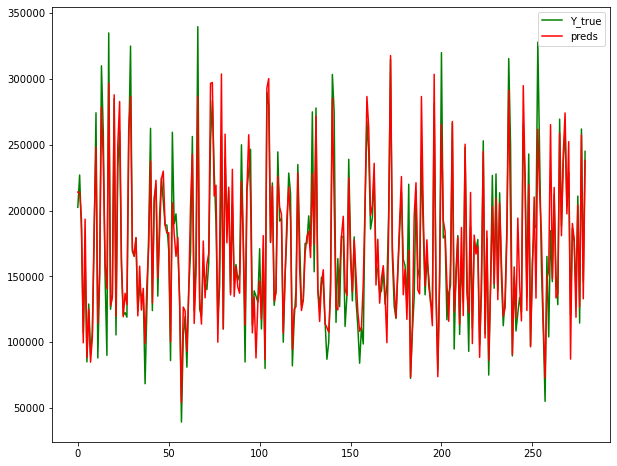

Fold = 1, RMSE = 20505.626475657722


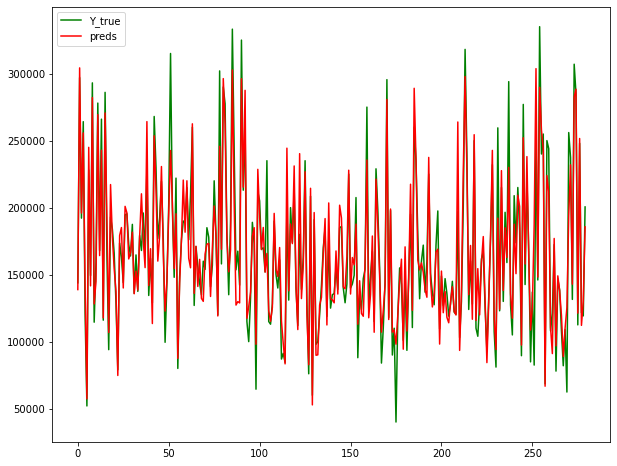

Fold = 2, RMSE = 20518.61335679229


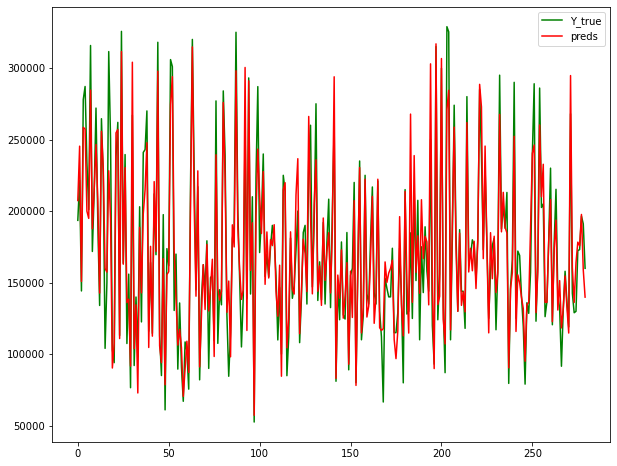

Fold = 3, RMSE = 20804.502735334663


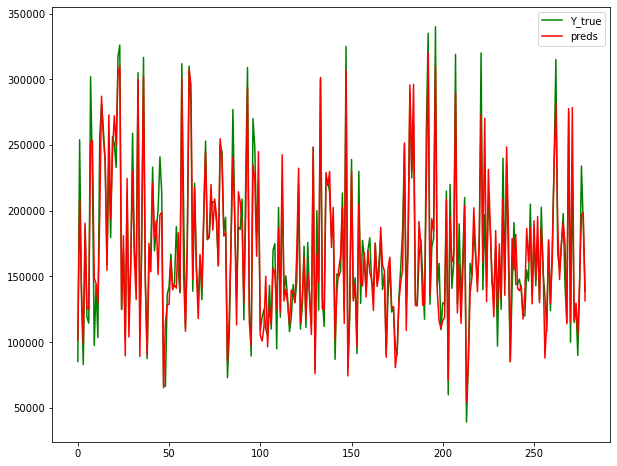

Fold = 4, RMSE = 18731.082790310724
mean_score =  20143.403160409503


In [96]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=no_outlier[sub1],target=target,model=rf,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

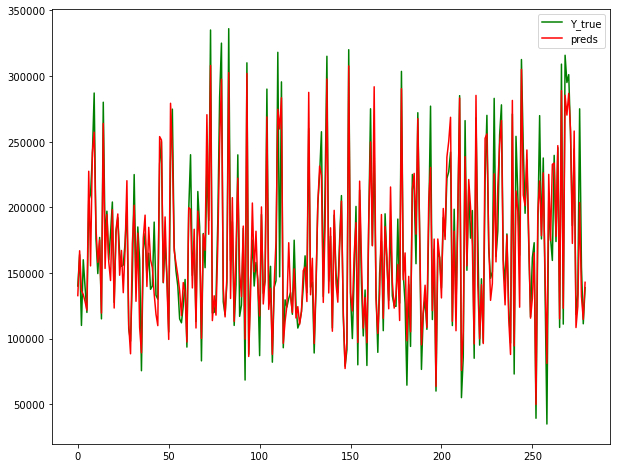

Fold = 0, RMSE = 20558.26403841786


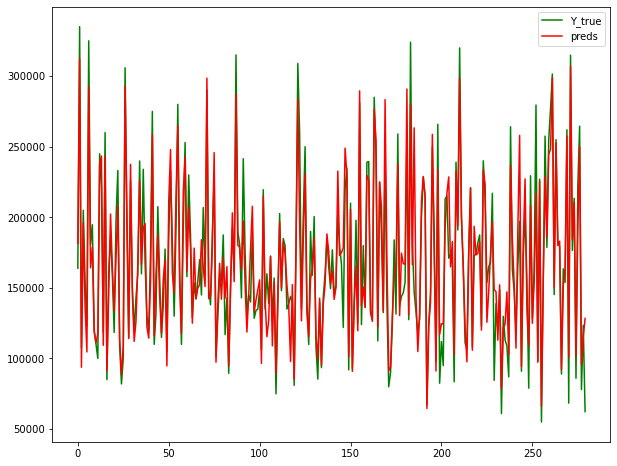

Fold = 1, RMSE = 20170.13350657478


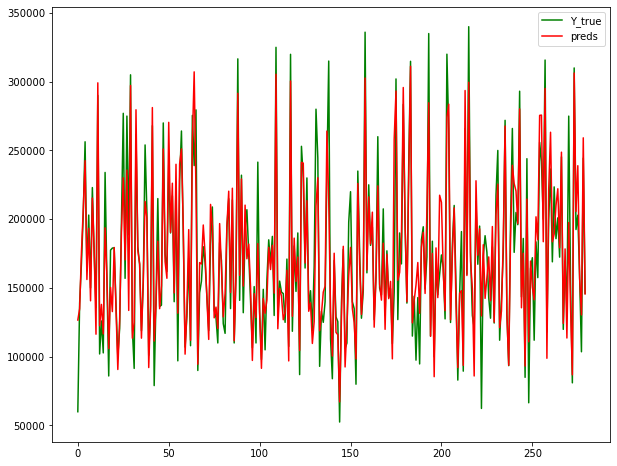

Fold = 2, RMSE = 23264.8946685424


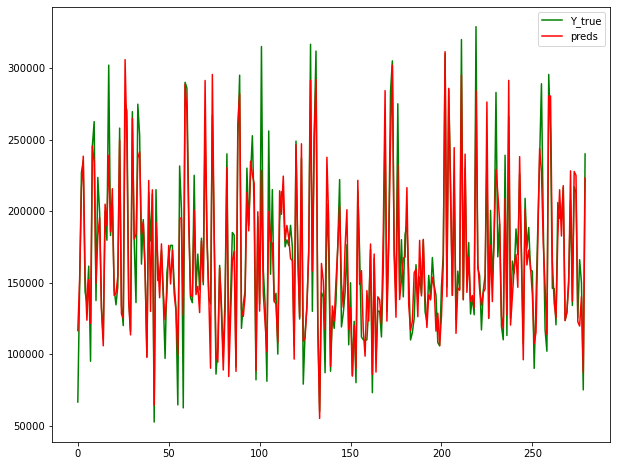

Fold = 3, RMSE = 19597.838573914527


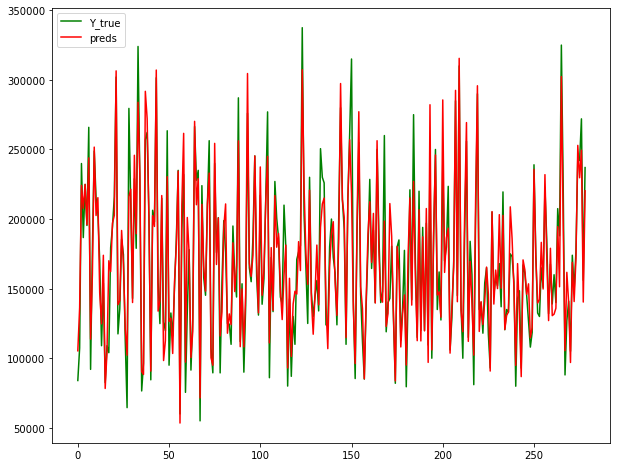

Fold = 4, RMSE = 19118.03106239582
mean_score =  20541.832369969077


In [97]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=no_outlier[sub1],target=target,model=baseline,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

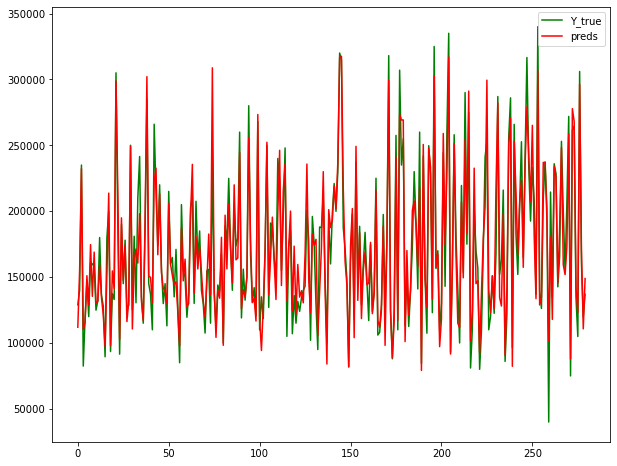

Fold = 0, RMSE = 18588.795352148907


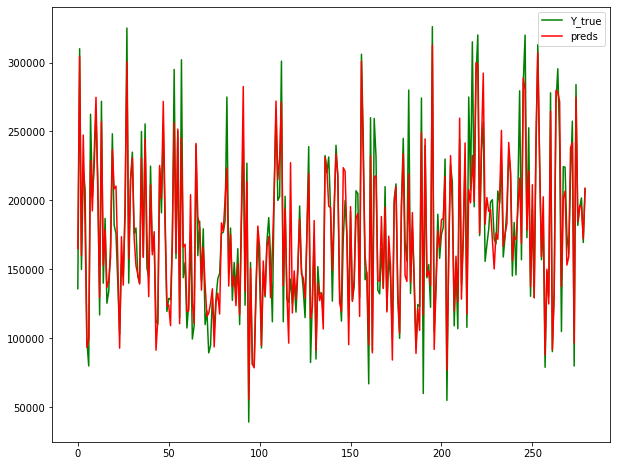

Fold = 1, RMSE = 19294.156564714198


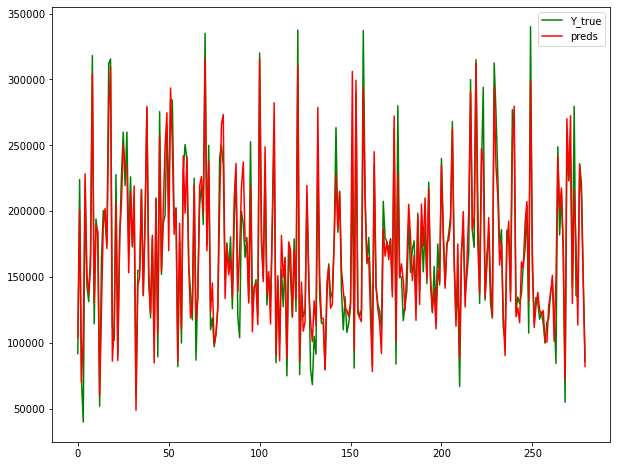

Fold = 2, RMSE = 18825.508489943553


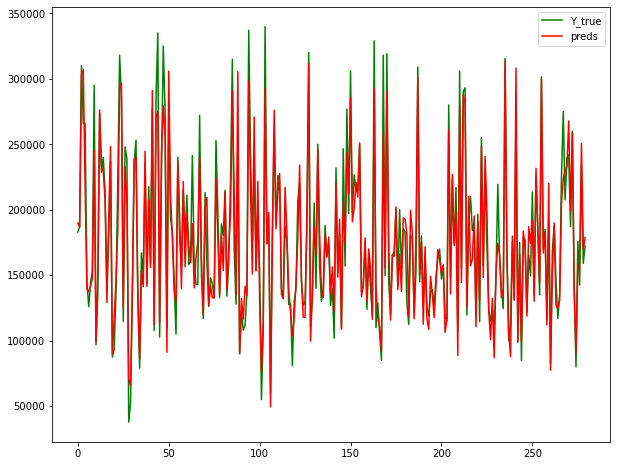

Fold = 3, RMSE = 18697.10463668595


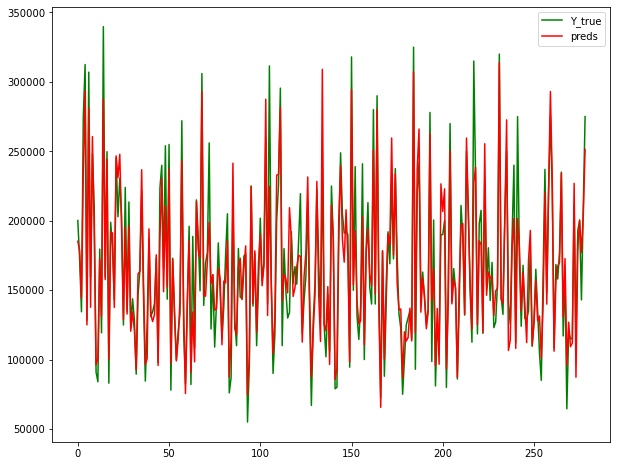

Fold = 4, RMSE = 19817.246896492175
mean_score =  19044.562387996957


In [98]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=no_outlier[sub1],target=target,model=et,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

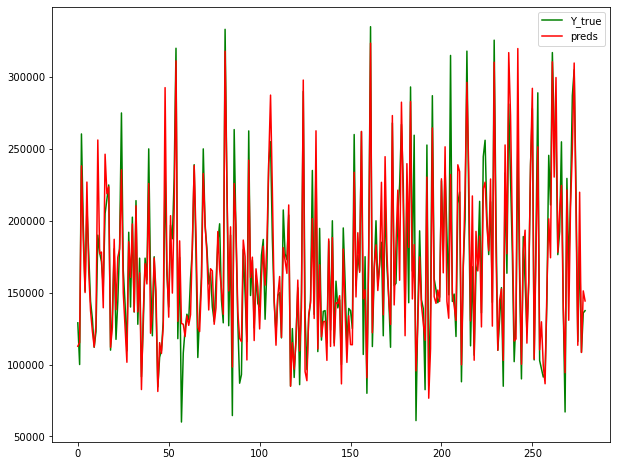

Fold = 0, RMSE = 20767.46384405828


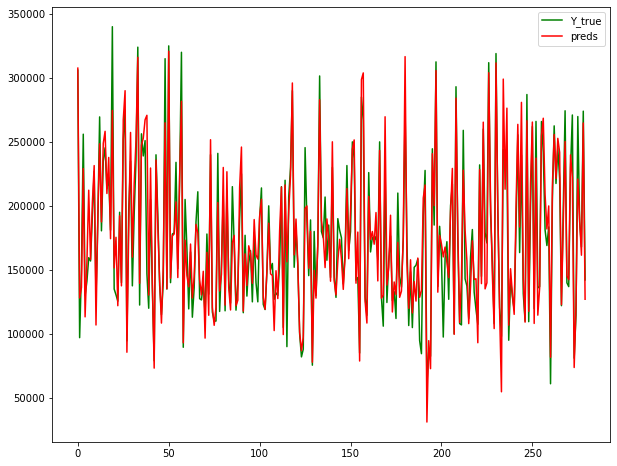

Fold = 1, RMSE = 20885.92530899854


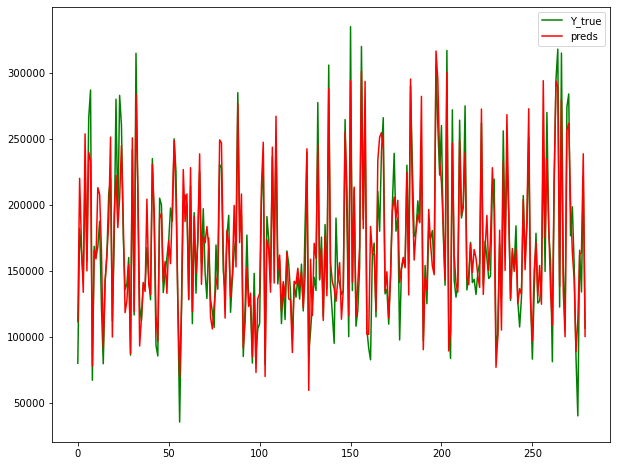

Fold = 2, RMSE = 21579.303651242022


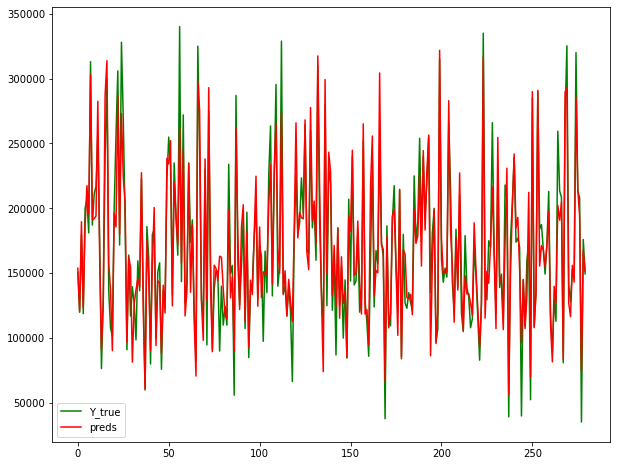

Fold = 3, RMSE = 21212.673862695952


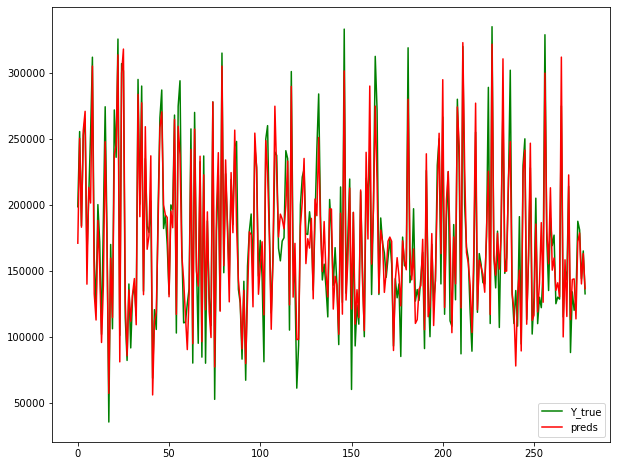

Fold = 4, RMSE = 20793.111887575888
mean_score =  21047.695710914137


In [99]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=no_outlier[sub1],target=target,model=xgb,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

# logged no outlier

In [100]:
def make_log(df,target):
    df_log = df.copy()
    num_cols = df_log.select_dtypes(exclude='object').columns
    num_cols = num_cols.drop(target)
    numeric = df_log.select_dtypes(exclude='object')
    for col in num_cols:
        numeric[col] = np.log(numeric[col]+1)
    return numeric        

In [101]:
log_no_outlier = make_log(no_outlier,'SalePrice')

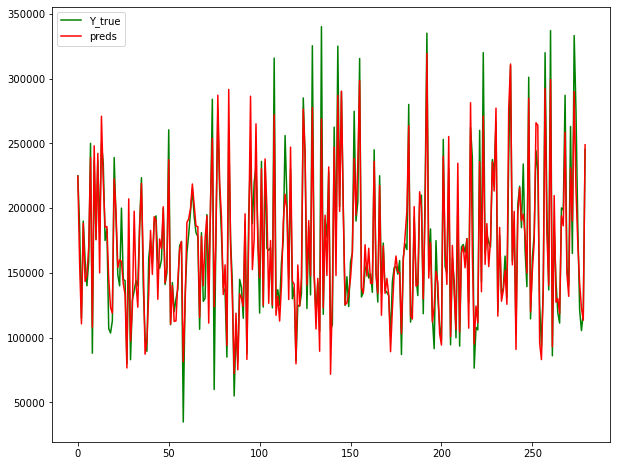

Fold = 0, RMSE = 19310.857844445643


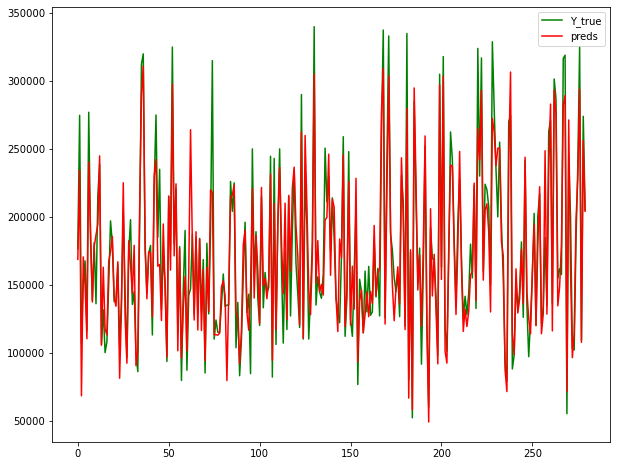

Fold = 1, RMSE = 22215.189861918356


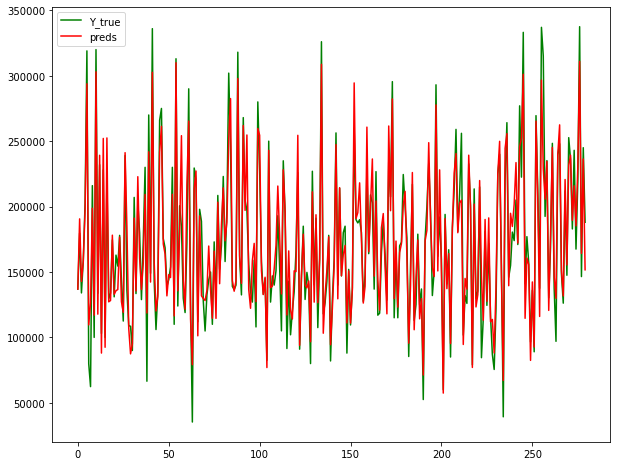

Fold = 2, RMSE = 19362.16708217977


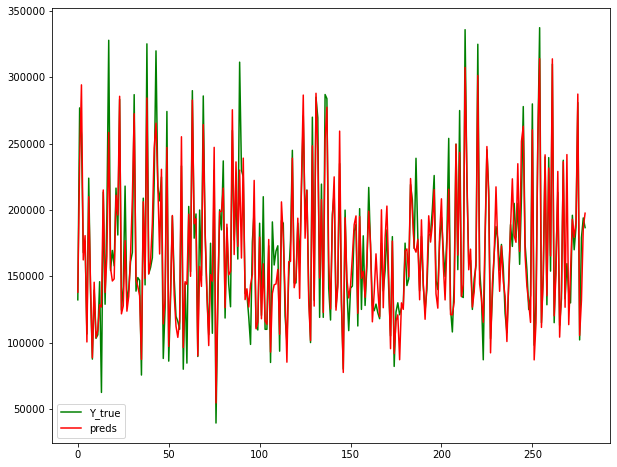

Fold = 3, RMSE = 20057.0870652403


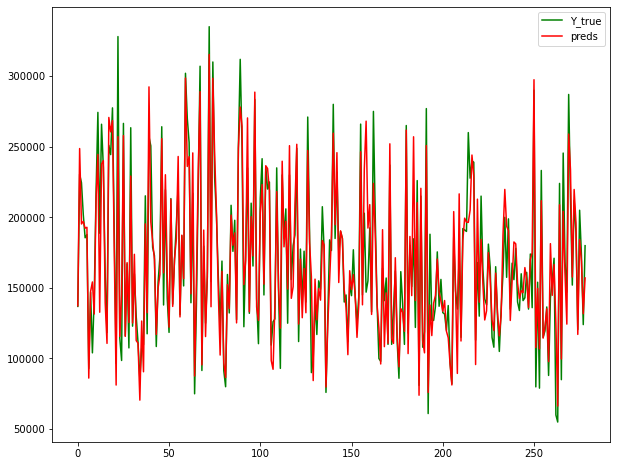

Fold = 4, RMSE = 20804.437596571934
mean_score =  20349.947890071202


In [102]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=log_no_outlier[sub1],target=target,model=rf,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

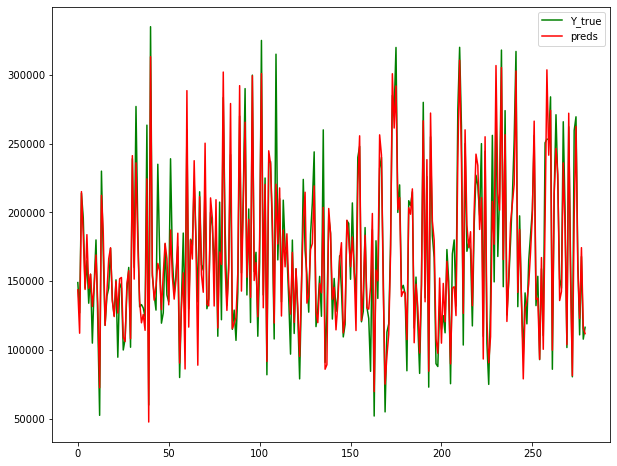

Fold = 0, RMSE = 19493.096536401485


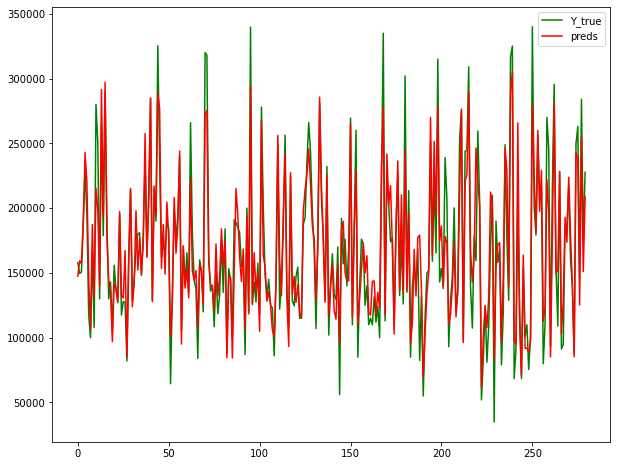

Fold = 1, RMSE = 22448.504610444656


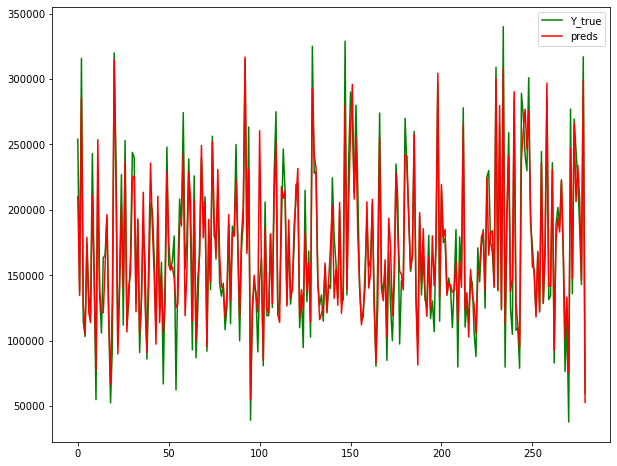

Fold = 2, RMSE = 19956.837930552032


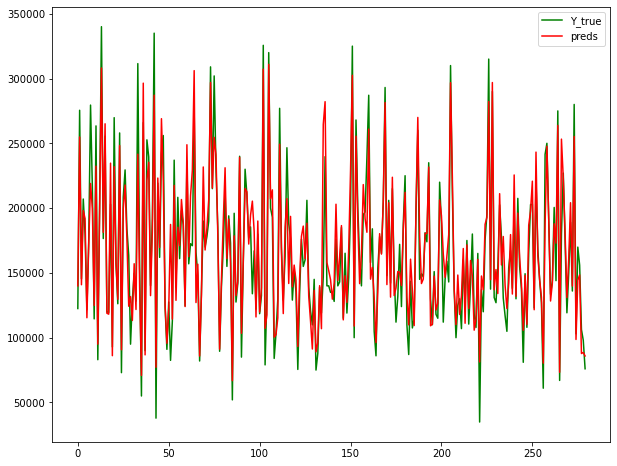

Fold = 3, RMSE = 22079.913498515663


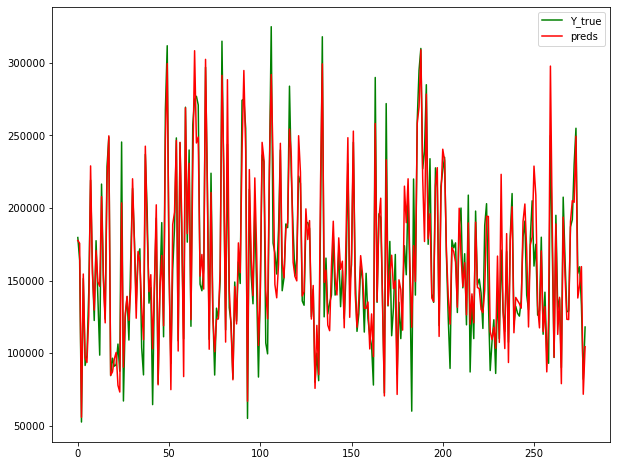

Fold = 4, RMSE = 18986.809816884714
mean_score =  20593.03247855971


In [104]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=log_no_outlier[sub1],target=target,model=baseline,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

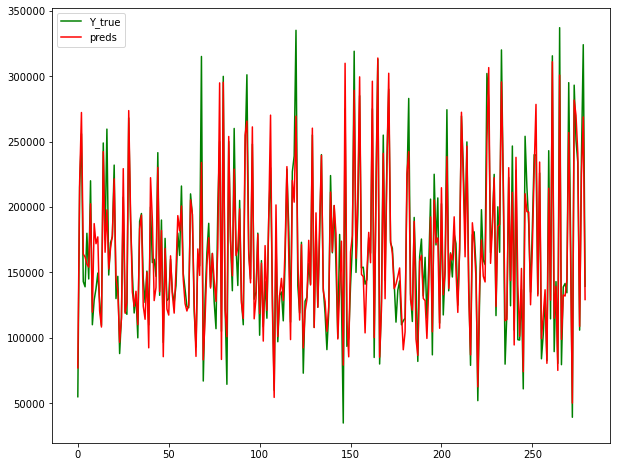

Fold = 0, RMSE = 18810.418541858187


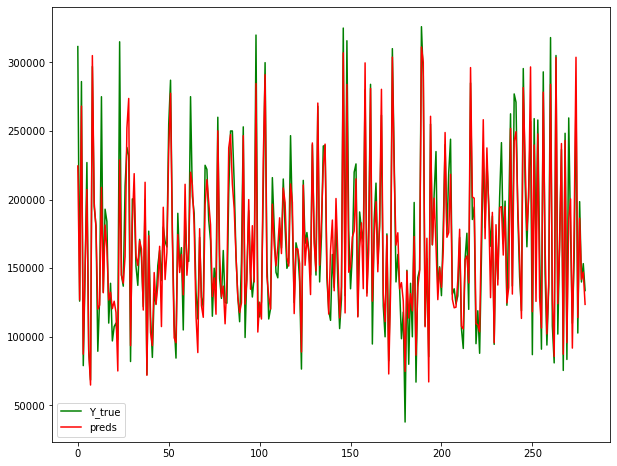

Fold = 1, RMSE = 20330.642994834492


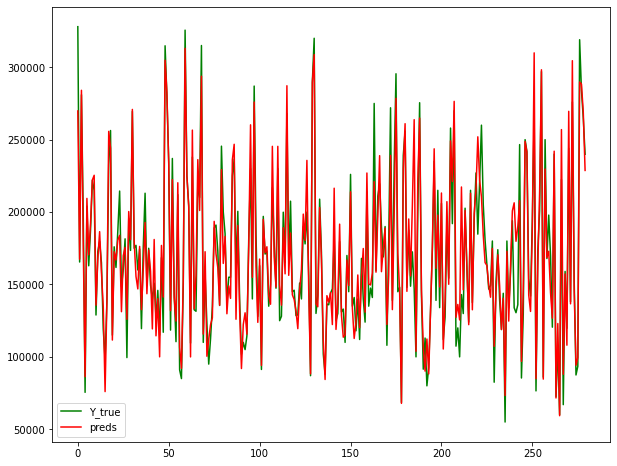

Fold = 2, RMSE = 18966.3280110719


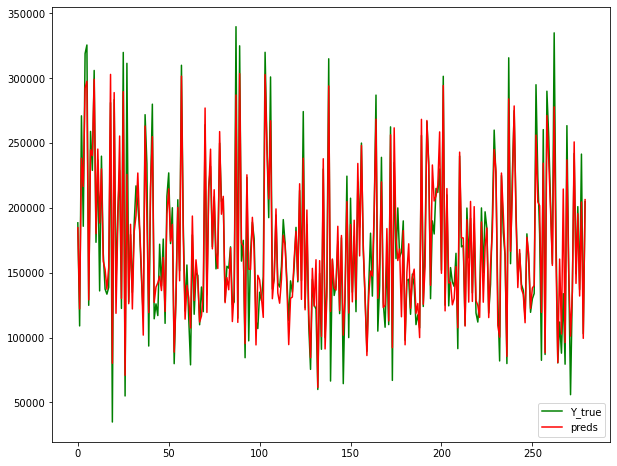

Fold = 3, RMSE = 18972.575595484002


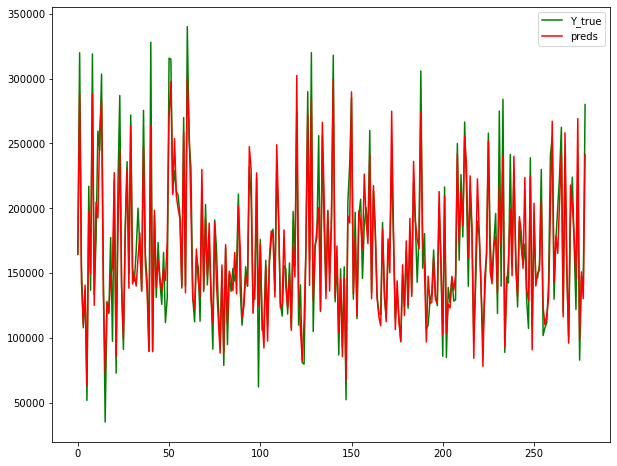

Fold = 4, RMSE = 19311.788009701017
mean_score =  19278.35063058992


In [105]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=log_no_outlier[sub1],target=target,model=et,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

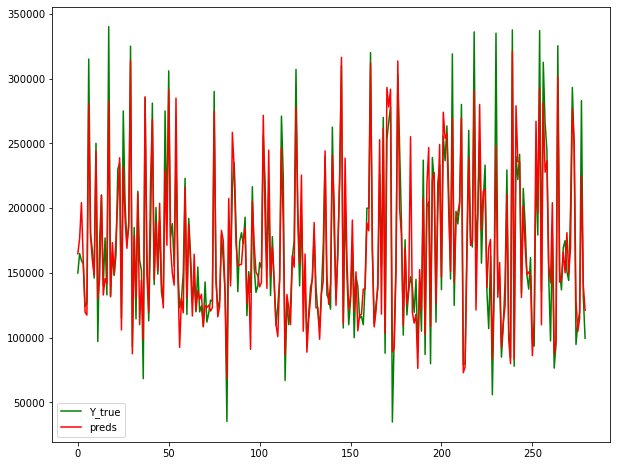

Fold = 0, RMSE = 21564.009613724862


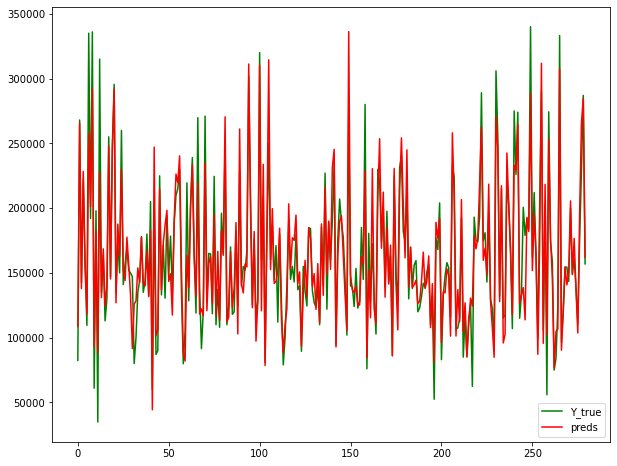

Fold = 1, RMSE = 20965.76944171875


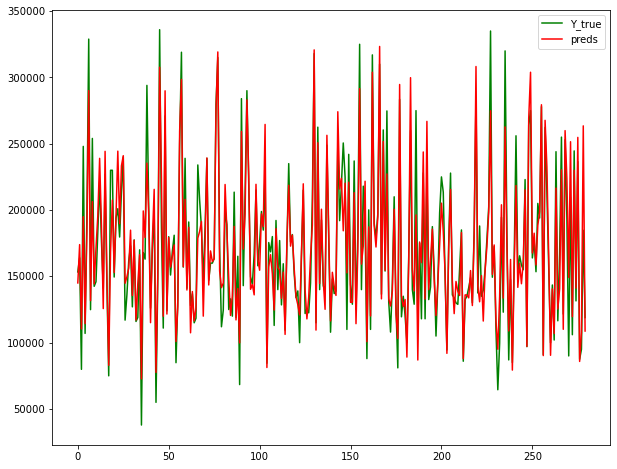

Fold = 2, RMSE = 20598.339986125135


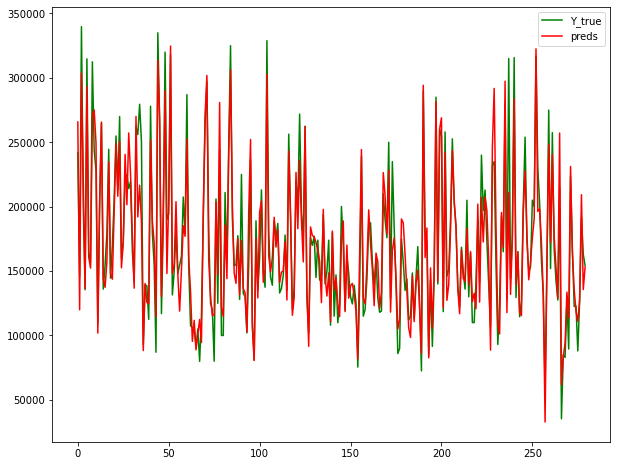

Fold = 3, RMSE = 19505.033573726323


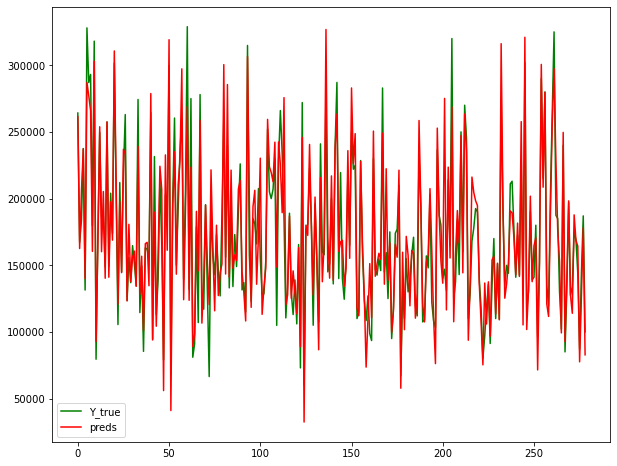

Fold = 4, RMSE = 22492.253742946737
mean_score =  21025.08127164836


In [106]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=log_no_outlier[sub1],target=target,model=xgb,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

In [27]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=LE_df[sub1],target=target,model=et,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

Fold = 0, RMSE = 24849.767141752585
Fold = 1, RMSE = 30753.950915085337
Fold = 2, RMSE = 26331.399078420956
Fold = 3, RMSE = 23912.43532259837
Fold = 4, RMSE = 27880.366850384955
mean_score =  26745.583861648443


In [28]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=LE_df[sub1],target=target,model=xgb,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

Fold = 0, RMSE = 25515.554281585028
Fold = 1, RMSE = 31892.524529606442
Fold = 2, RMSE = 31522.881928453135
Fold = 3, RMSE = 23580.629328389346
Fold = 4, RMSE = 29859.678137606472
mean_score =  28474.253641128085


# sub2

In [22]:
sub2=['TotalBsmtSF', '2ndFlrSF', 'YrSd_YrBlt', 'total_indoor_sqft', 'no_finishes', 'OverallQual', 'avg_All_Qualities', 'total_in_out_sqft',
      'total_All_Qualities', 'MasVnrArea', 'YearBuilt', 'GrLivArea', 'BsmtFinSF1', '1stFlrSF', 
      'GarageArea', 'YearBuilt_Age', 'LotFrontage','SalePrice']

In [31]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=LE_df[sub2],target=target,model=rf,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

Fold = 0, RMSE = 24546.366786418126
Fold = 1, RMSE = 30529.006483801582
Fold = 2, RMSE = 27648.397432325797
Fold = 3, RMSE = 28164.902057711537
Fold = 4, RMSE = 21352.832087145565
mean_score =  26448.30096948052


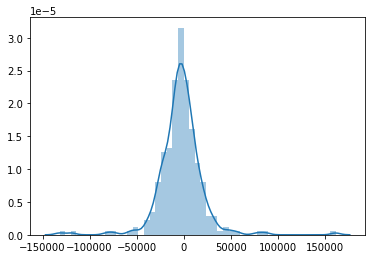

Fold = 0, RMSE = 23952.726381951838


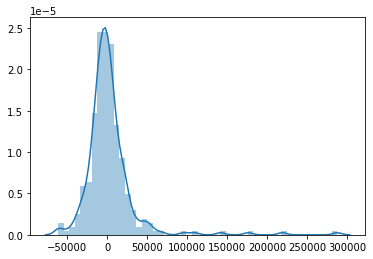

Fold = 1, RMSE = 32494.31948262736


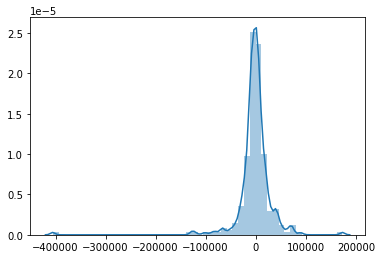

Fold = 2, RMSE = 36182.140058914825


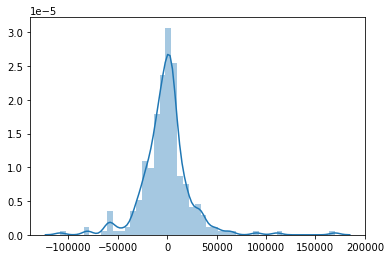

Fold = 3, RMSE = 25212.322650427355


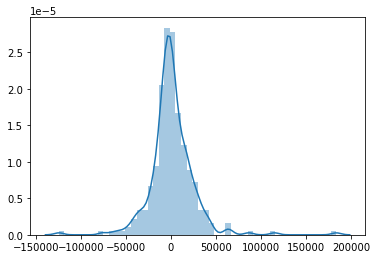

Fold = 4, RMSE = 24898.175858747072
mean_score =  28547.936886533687


In [23]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=LE_df[sub2],target=target,model=baseline,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

In [33]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=LE_df[sub2],target=target,model=et,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

Fold = 0, RMSE = 33886.59625343212
Fold = 1, RMSE = 47858.39360671792
Fold = 2, RMSE = 24689.64105474547
Fold = 3, RMSE = 25209.536755807436
Fold = 4, RMSE = 23112.35810918817
mean_score =  30951.305155978225


In [36]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=LE_df[sub2],target=target,model=xgb,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

Fold = 0, RMSE = 32896.3706347307
Fold = 1, RMSE = 30682.180630212242
Fold = 2, RMSE = 28561.798321538536
Fold = 3, RMSE = 27132.893945768697
Fold = 4, RMSE = 27245.1531019931
mean_score =  29303.67932684865


# sub 3

In [61]:
sub3= ['2ndFlrSF', 'total_Bmt_Fn_Area', 'BsmtUnfSF', 'total_All_Qualities', 'YearBuilt_Age', 'GarageCars', 
   'total_Bmt_Ql_Cd', 'TotalBsmtSF', 'BsmtQual', 'total_outdoor_sqft', 'OverallQual', 'total_in_out_sqft', 
   'GrLivArea', 'OpenPorchSF', 'YrSd_YrBlt', 'total_indoor_sqft', 'no_finishes', 'MasVnrArea', 
   'YrSd_YrRmd', 'GarageType', 'Neighborhood', 'GarageYrBlt',
   'avg_All_Qualities', 'Garage_per_Car_Cap', 'YearRemodAdd_Age', 'YearBuilt', 'BsmtFinSF1', '1stFlrSF', 
   'GarageArea', 'avg_Bmt_Qual', 'LotFrontage','SalePrice']

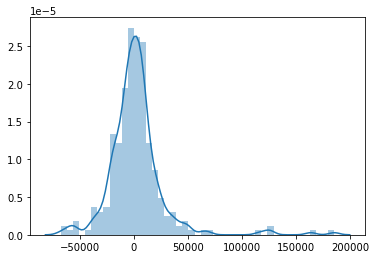

Fold = 0, RMSE = 26842.03069237196


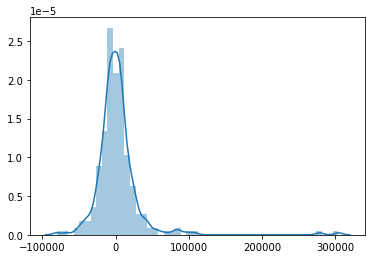

Fold = 1, RMSE = 32931.63171692738


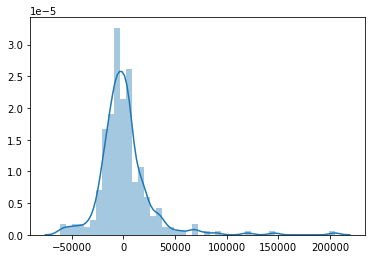

Fold = 2, RMSE = 26139.437457214917


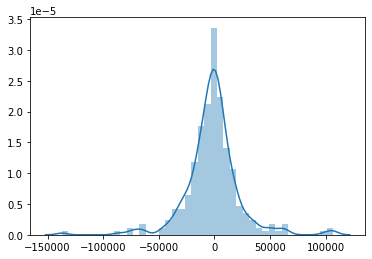

Fold = 3, RMSE = 24658.906771864014


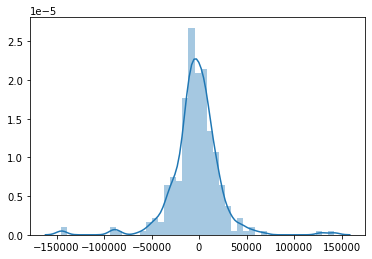

Fold = 4, RMSE = 26837.170689876908
mean_score =  27481.835465651042


In [62]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=LE_df[sub3],target=target,model=rf,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

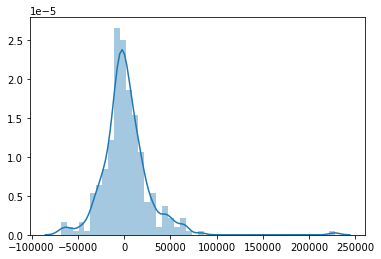

Fold = 0, RMSE = 26274.47692566582


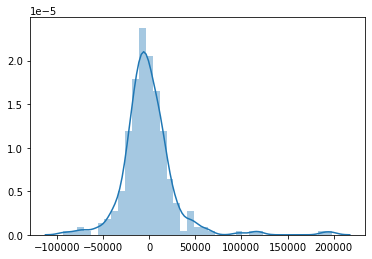

Fold = 1, RMSE = 29597.91363820343


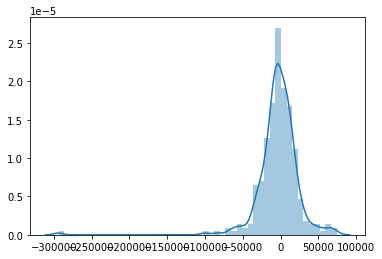

Fold = 2, RMSE = 28235.568350591115


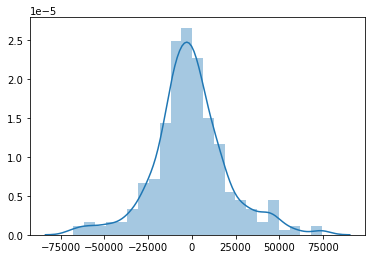

Fold = 3, RMSE = 21491.331720898637


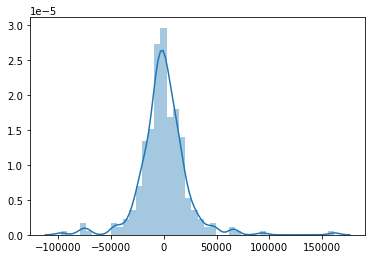

Fold = 4, RMSE = 23154.95229467098
mean_score =  25750.848586005995


In [66]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=logged[sub1],target=target,model=rf,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

In [ ]:
logged

In [60]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=LE_df[sub3],target=target,model=et,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

NameError: name 'sub3' is not defined

In [44]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=LE_df[sub3],target=target,model=xgb,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

Fold = 0, RMSE = 34804.06846738617
Fold = 1, RMSE = 31336.343300343902
Fold = 2, RMSE = 23705.83924152927
Fold = 3, RMSE = 30636.301269243875
Fold = 4, RMSE = 28580.274112474257
mean_score =  29812.565278195496


# Data visualization is a great follow-up to a utility ranking. Let's take a closer look at a couple of these.

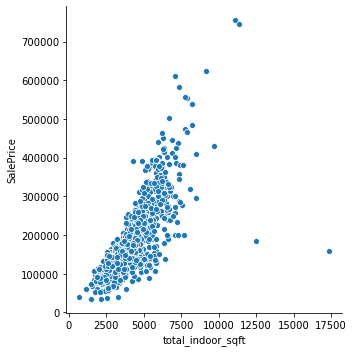

In [25]:
sns.relplot(x="total_indoor_sqft", y="SalePrice", data=LE_df);

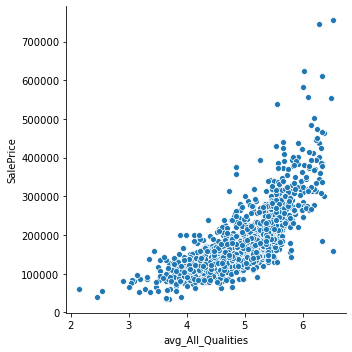

In [26]:
sns.relplot(x='avg_All_Qualities', y="SalePrice", data=LE_df);

TotalBsmtSF


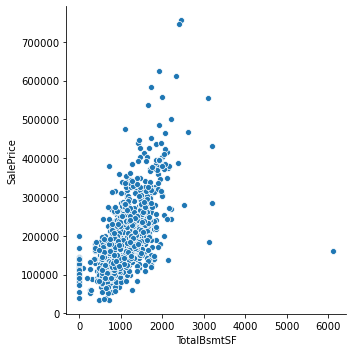

2ndFlrSF


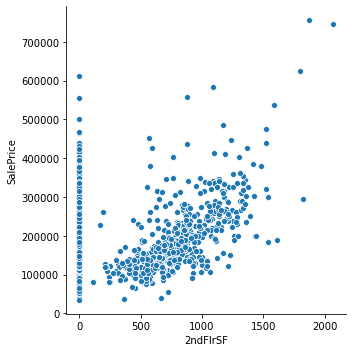

YrSd_YrBlt


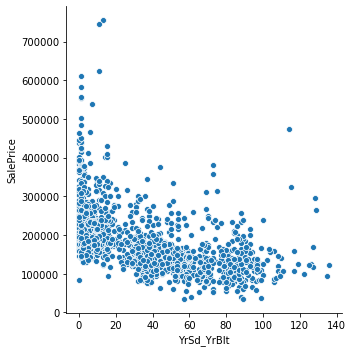

total_indoor_sqft


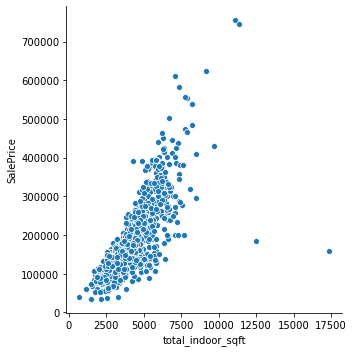

no_finishes


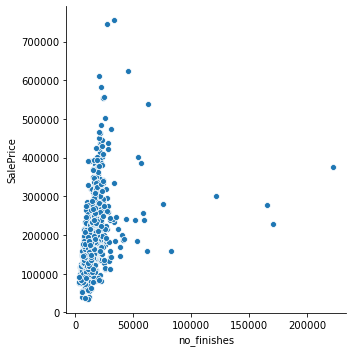

OverallQual


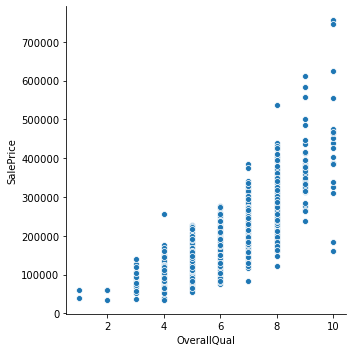

avg_All_Qualities


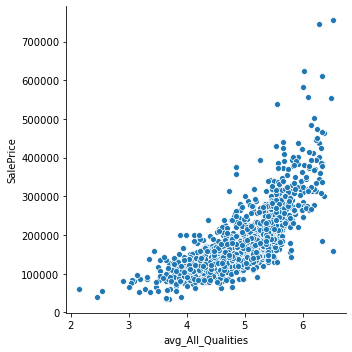

total_in_out_sqft


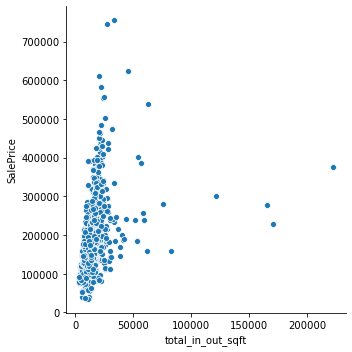

total_All_Qualities


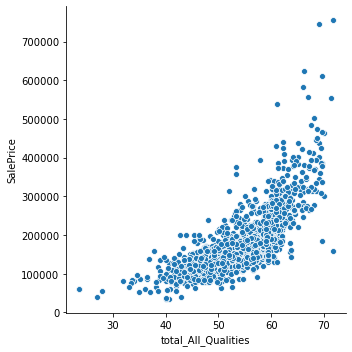

MasVnrArea


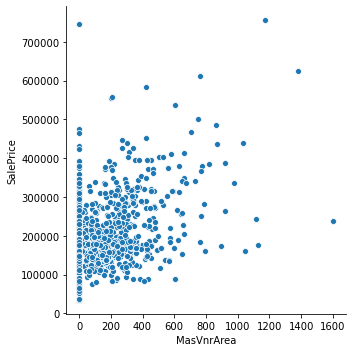

YearBuilt


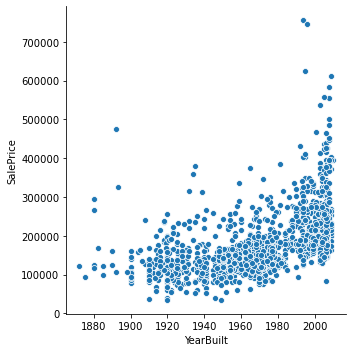

GrLivArea


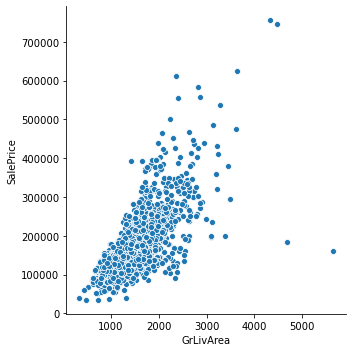

BsmtFinSF1


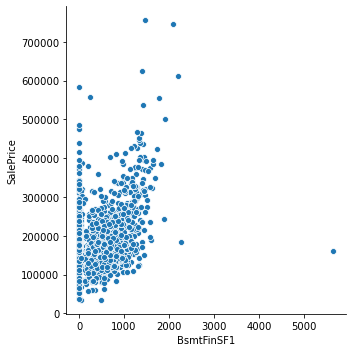

1stFlrSF


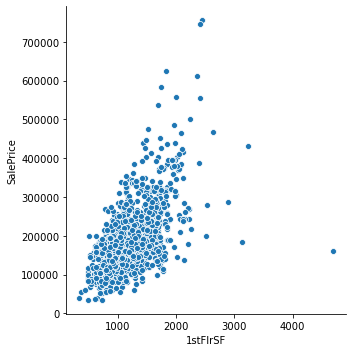

GarageArea


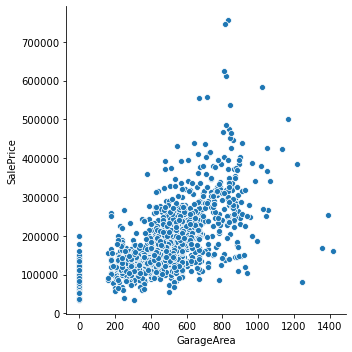

YearBuilt_Age


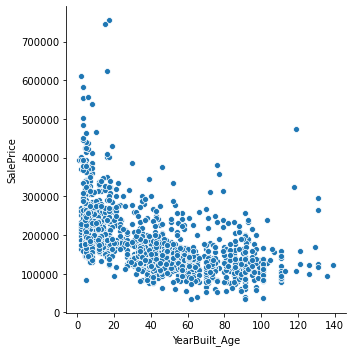

LotFrontage


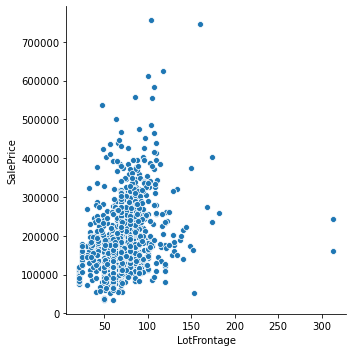

SalePrice


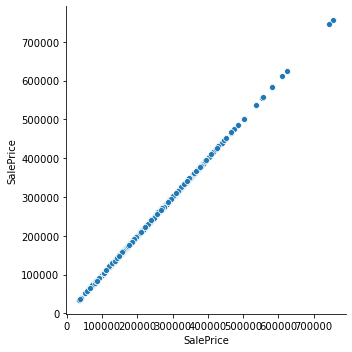

In [33]:
for col in sub1:
    sns.relplot(x=col, y="SalePrice", data=LE_df);
    print(col)
    plt.show()
   

# Mutual info

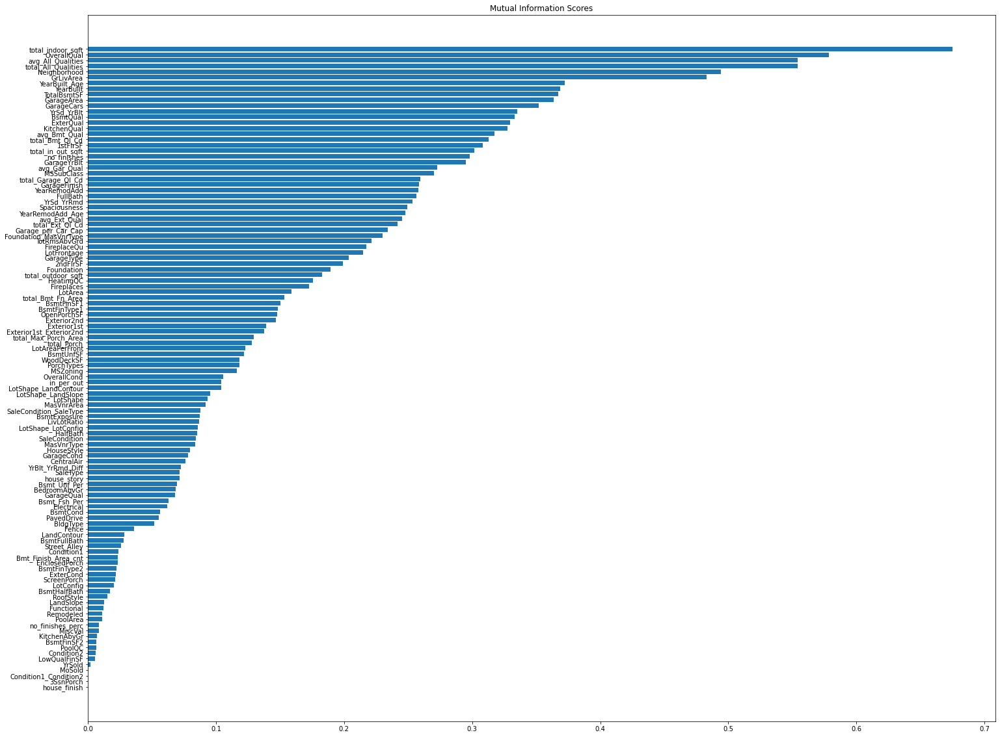

In [119]:
from sklearn.feature_selection import mutual_info_regression
def make_mi_scores_Regression(X_train, y_train):    
    discrete_features = X_train.dtypes == int
    mi_scores = mutual_info_regression(X_train, y_train, discrete_features=discrete_features)
    mi_scores = pd.Series(mi_scores, name="MI Scores", index=X_train.columns)
    mi_scores = mi_scores.sort_values(ascending=False)
    return mi_scores

scoremxLE = make_mi_scores_Regression(X_train=LE_df.drop(['SalePrice']+drops,axis=1), y_train=LE_df.SalePrice)

def plot_mi_scores(scores):
    scores = scores.sort_values(ascending=True)
    width = np.arange(len(scores))
    ticks = list(scores.index)
    plt.figure(figsize=(25,20))
    plt.barh(width, scores)
    plt.yticks(width, ticks)
    plt.title("Mutual Information Scores")
    
plot_mi_scores(scoremxLE)

In [38]:
mutual_mxLE=scoremxLE.index.to_list()

In [64]:
def make_log(df,target):
    df_log = df.copy()
    num_cols = df_log.select_dtypes(exclude='object').columns
    num_cols = num_cols.drop(target)
    numeric = df_log.select_dtypes(exclude='object')
    for col in num_cols:
        numeric[col] = np.log(numeric[col]+1)
    return numeric        

In [65]:
logged = make_log(df=LE_df,target='SalePrice')

total_indoor_sqft


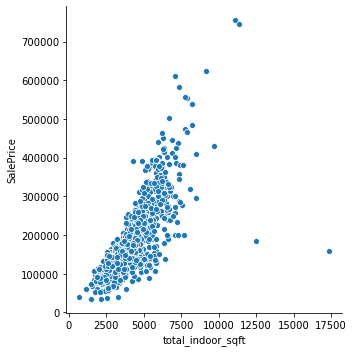

logged


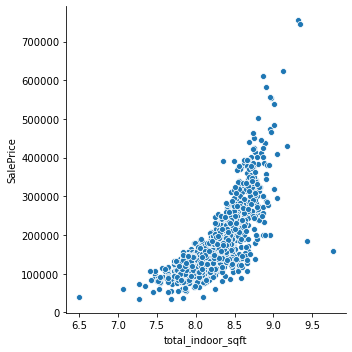

OverallQual


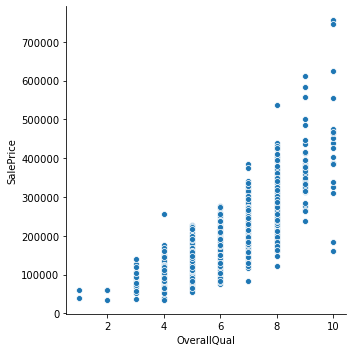

logged


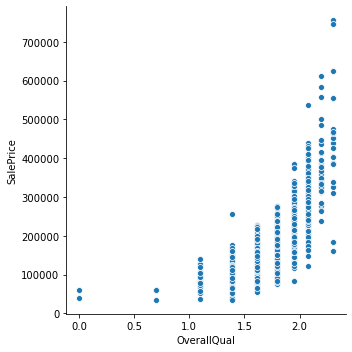

total_All_Qualities


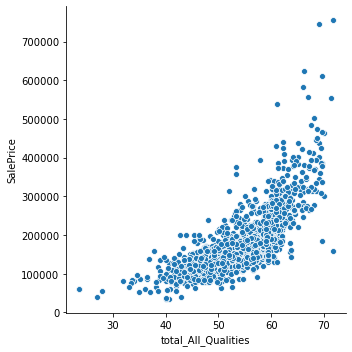

logged


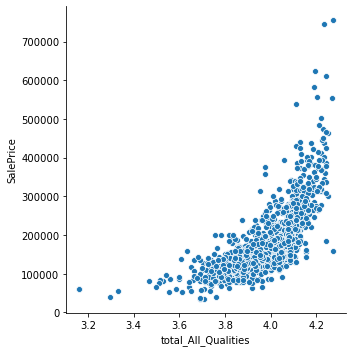

avg_All_Qualities


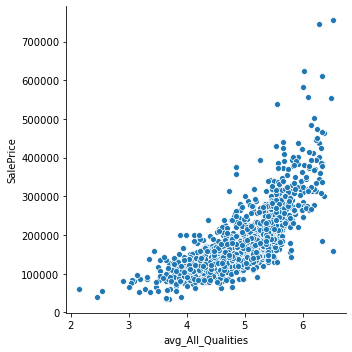

logged


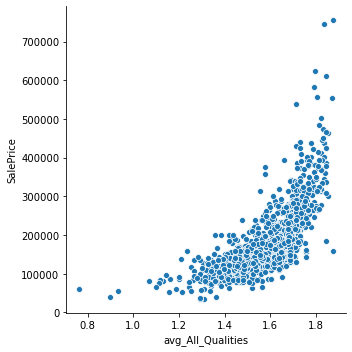

Neighborhood


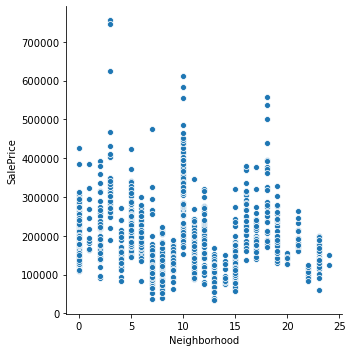

logged


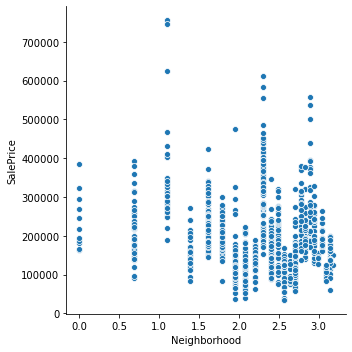

GrLivArea


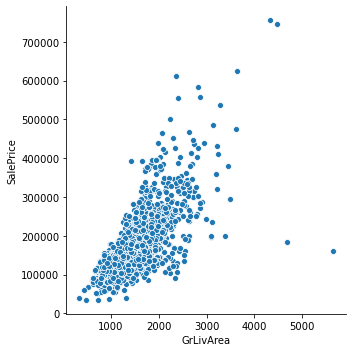

logged


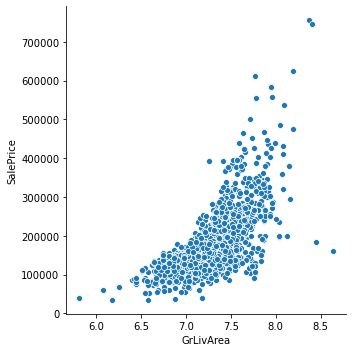

TotalBsmtSF


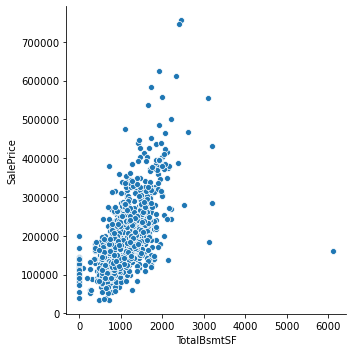

logged


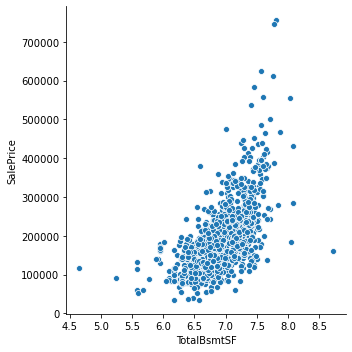

GarageArea


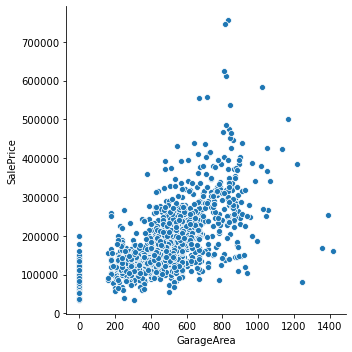

logged


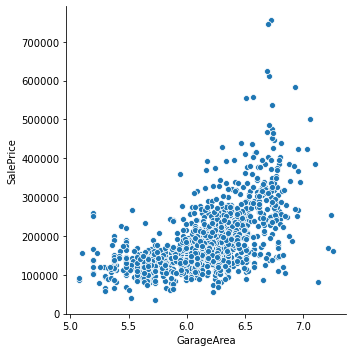

YearBuilt_Age


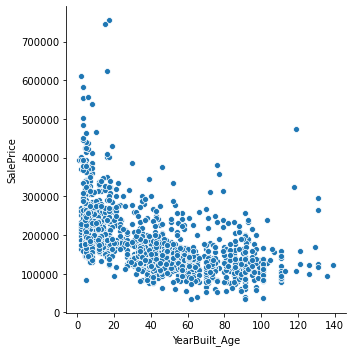

logged


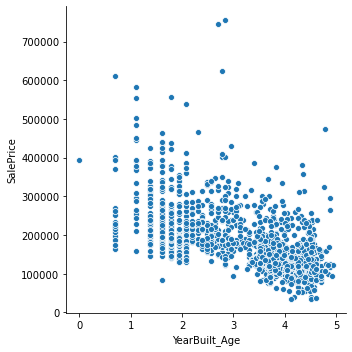

YearBuilt


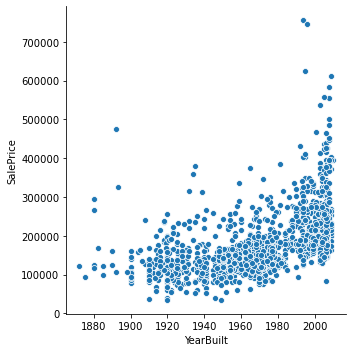

logged


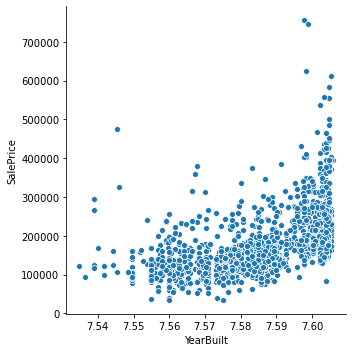

GarageCars


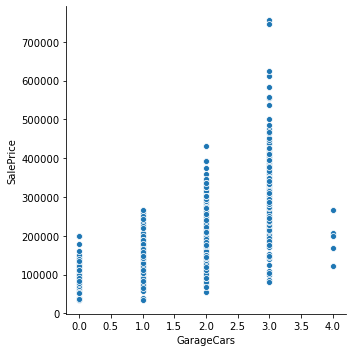

logged


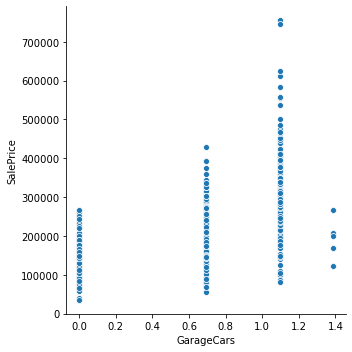

BsmtQual


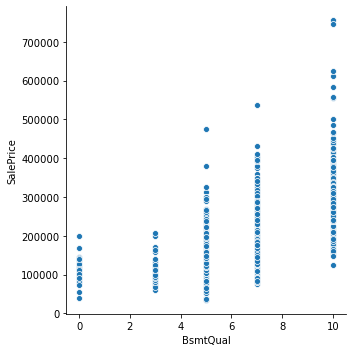

logged


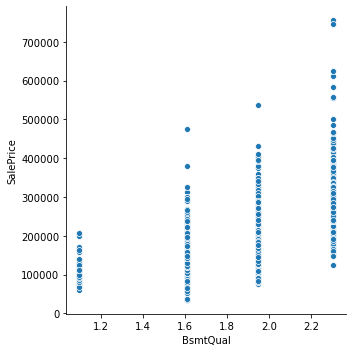

YrSd_YrBlt


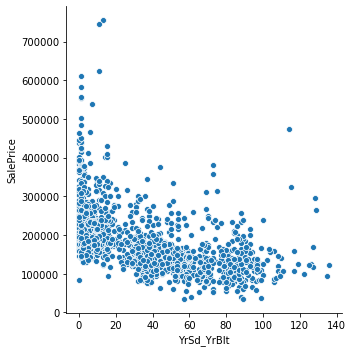

logged


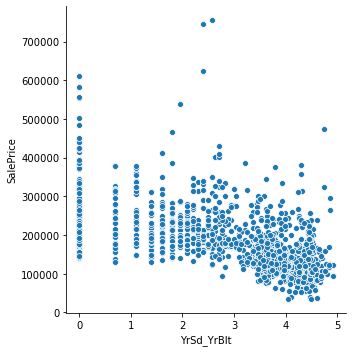

KitchenQual


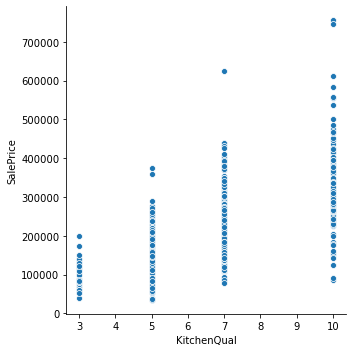

logged


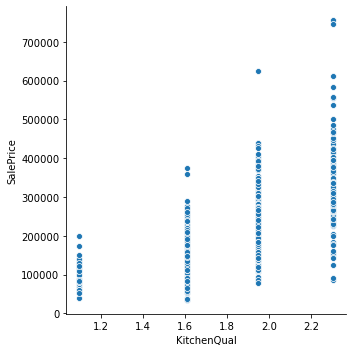

ExterQual


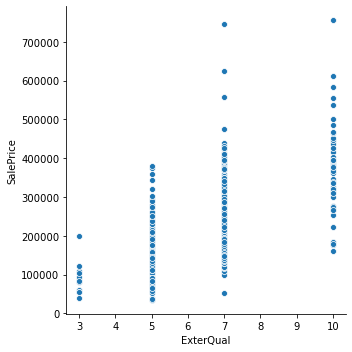

logged


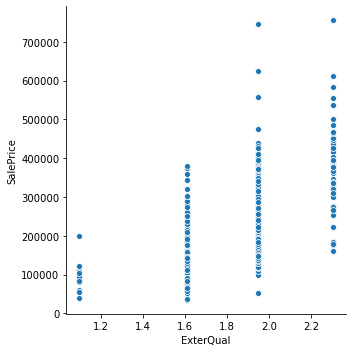

avg_Bmt_Qual


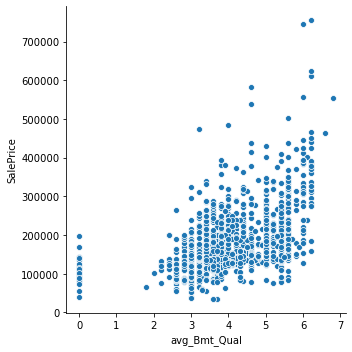

logged


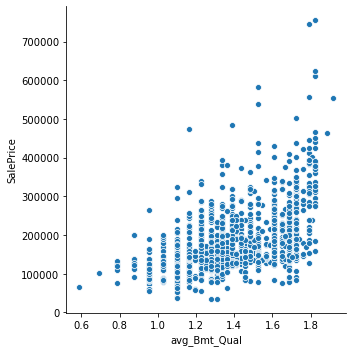

total_Bmt_Ql_Cd


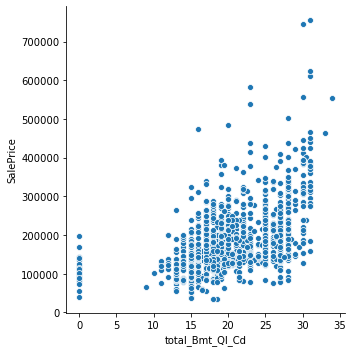

logged


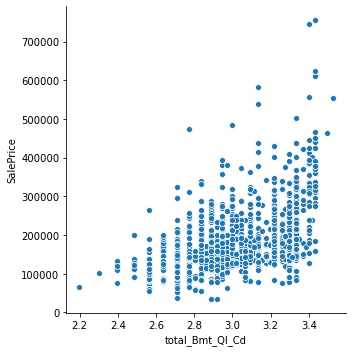

1stFlrSF


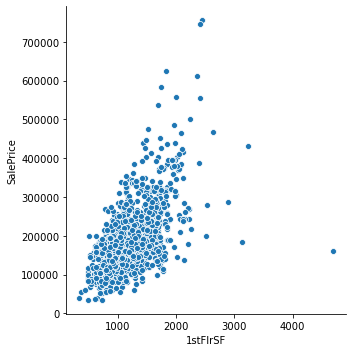

logged


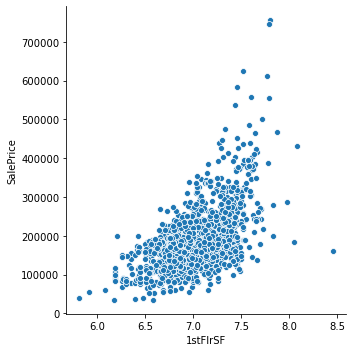

GarageYrBlt


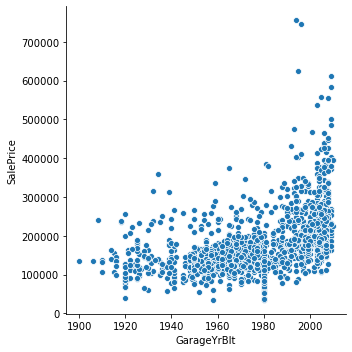

logged


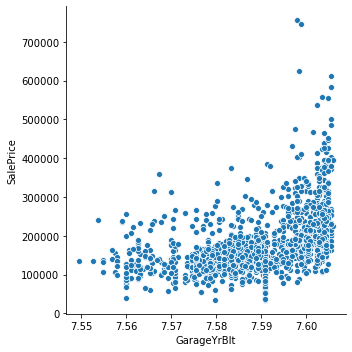

total_in_out_sqft


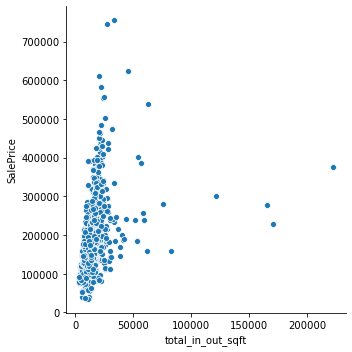

logged


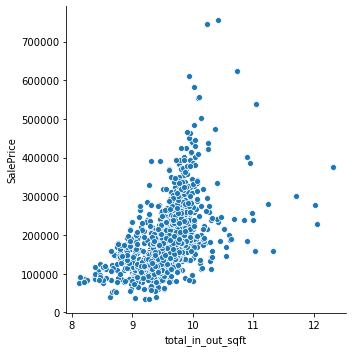

no_finishes


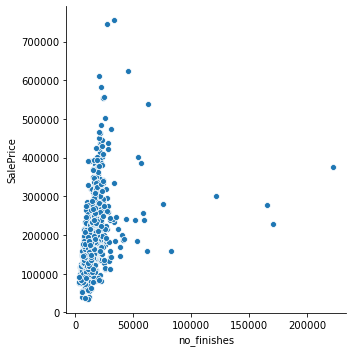

logged


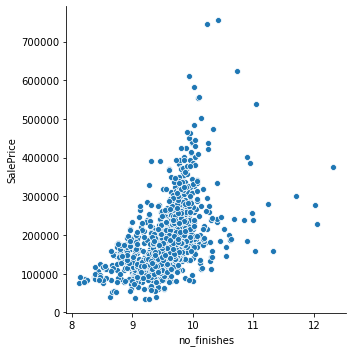

avg_Gar_Qual


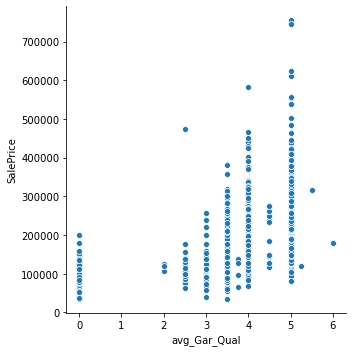

logged


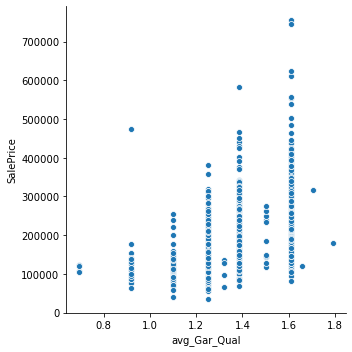

MSSubClass


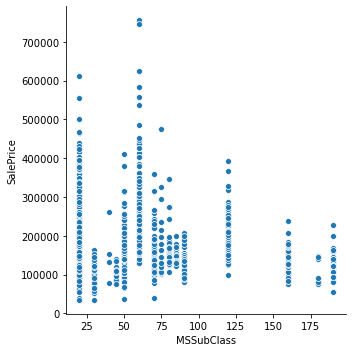

logged


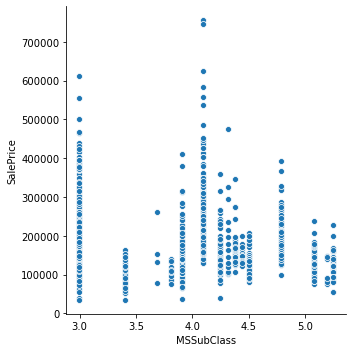

GarageFinish


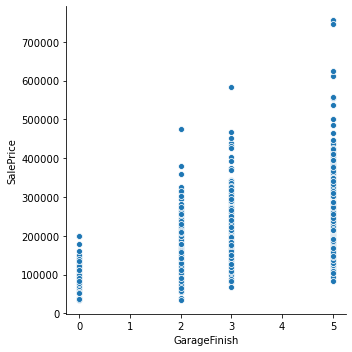

logged


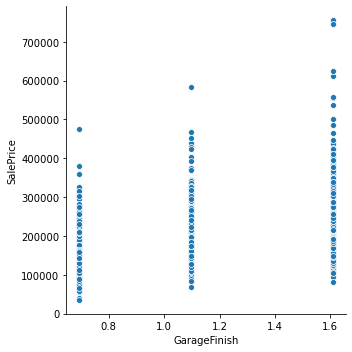

YrSd_YrRmd


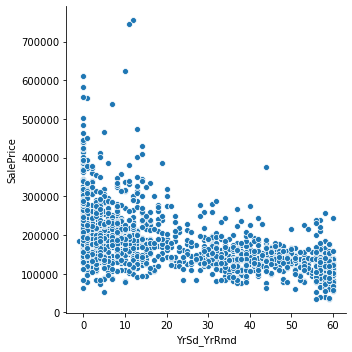

logged


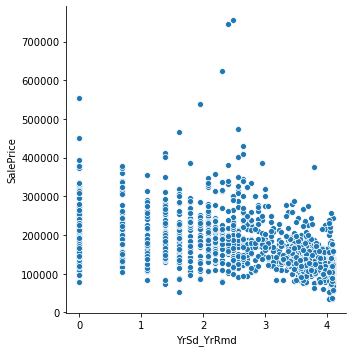

total_Garage_Ql_Cd


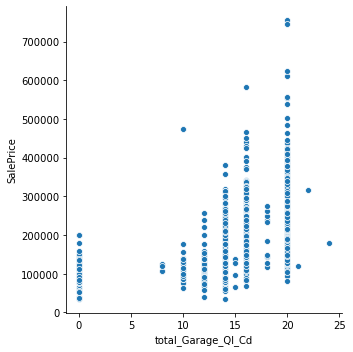

logged


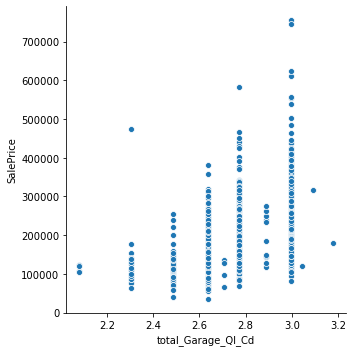

avg_Ext_Qual


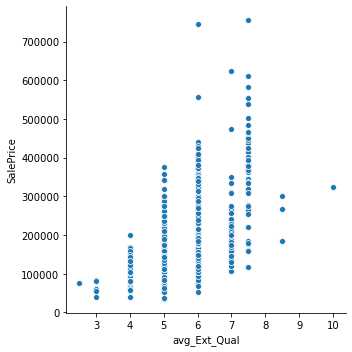

logged


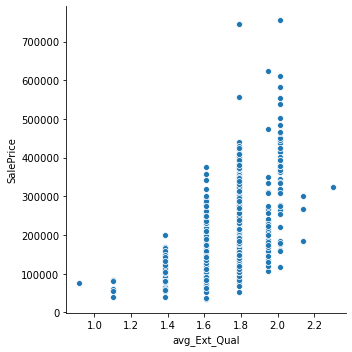

Spaciousness


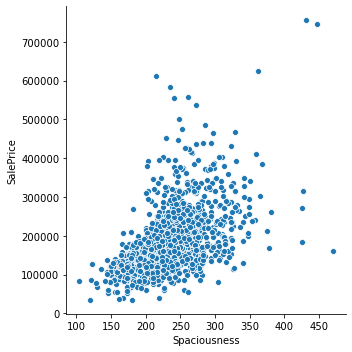

logged


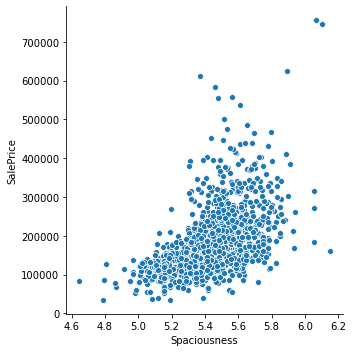

FullBath


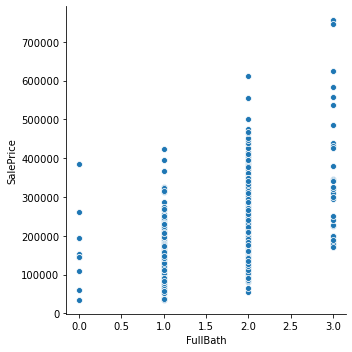

logged


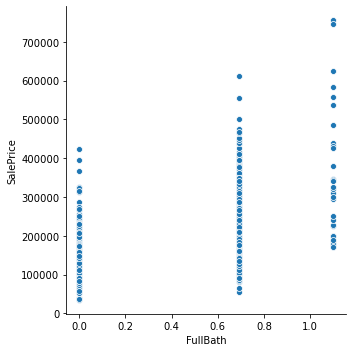

YearRemodAdd


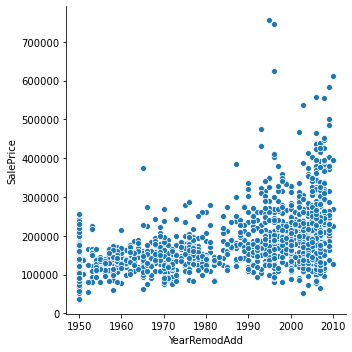

logged


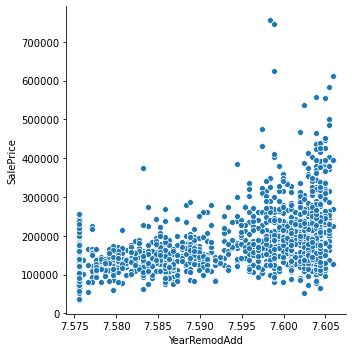

total_Ext_Ql_Cd


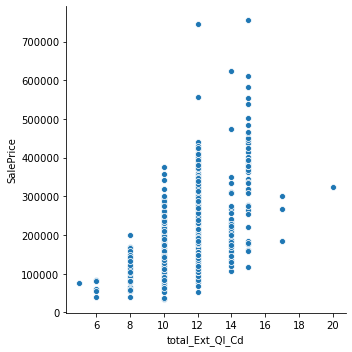

logged


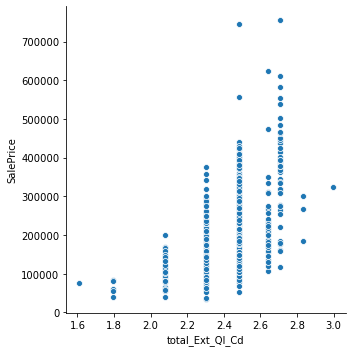

YearRemodAdd_Age


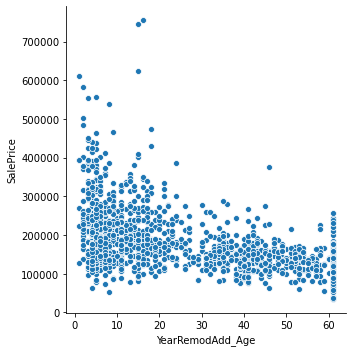

logged


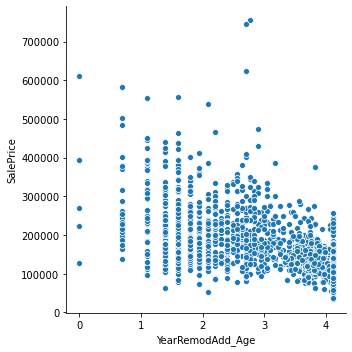

Garage_per_Car_Cap


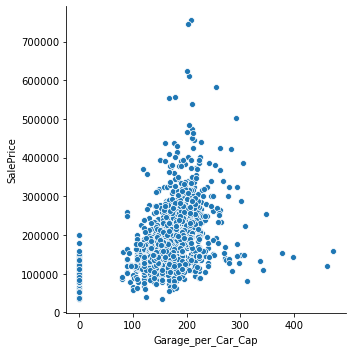

logged


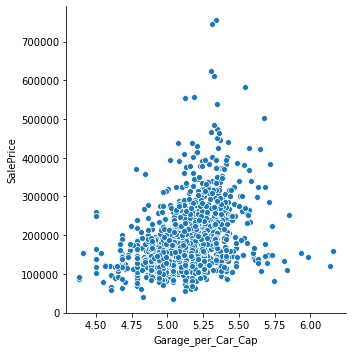

Foundation_MasVnrType


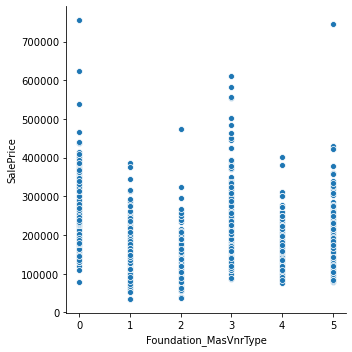

logged


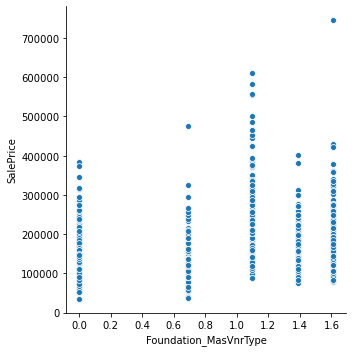

LotFrontage


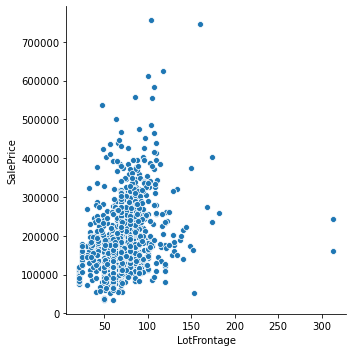

logged


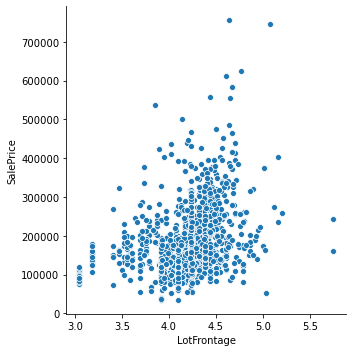

TotRmsAbvGrd


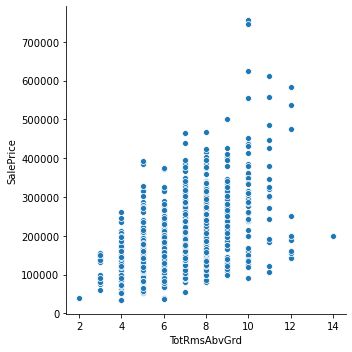

logged


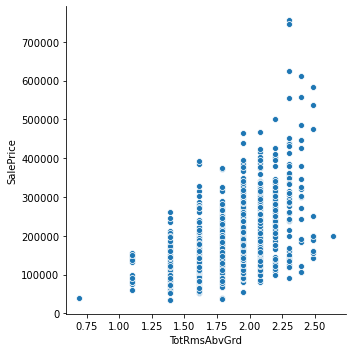

FireplaceQu


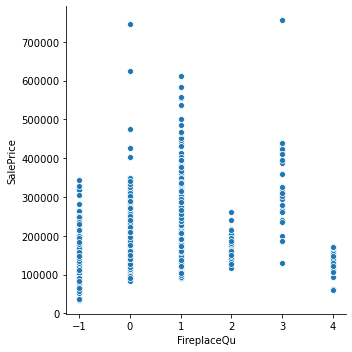

logged


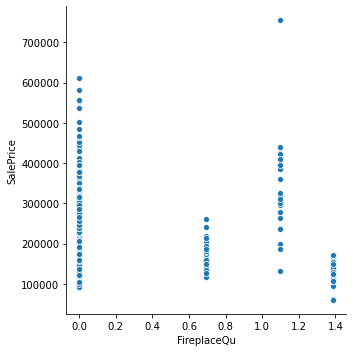

GarageType


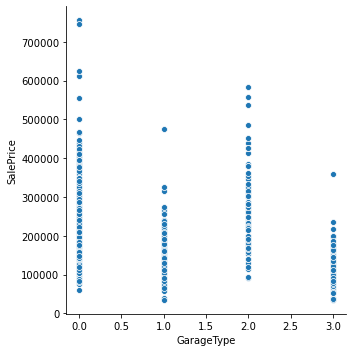

logged


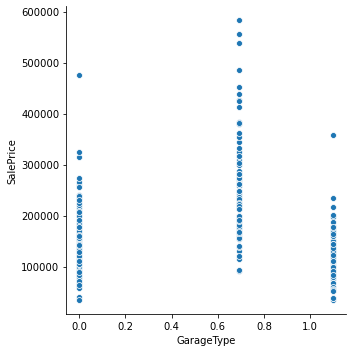

Foundation


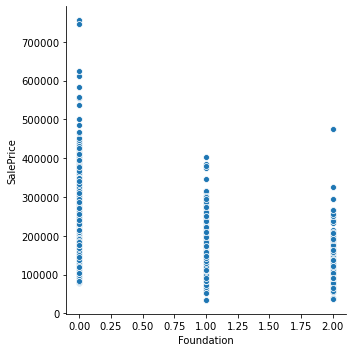

logged


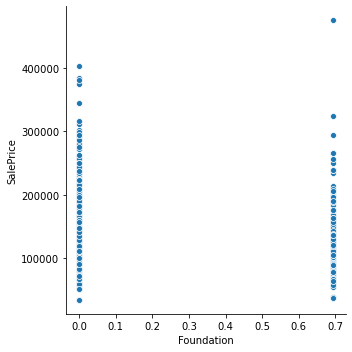

2ndFlrSF


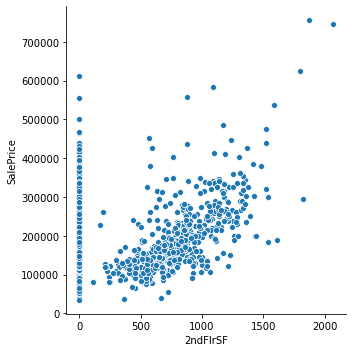

logged


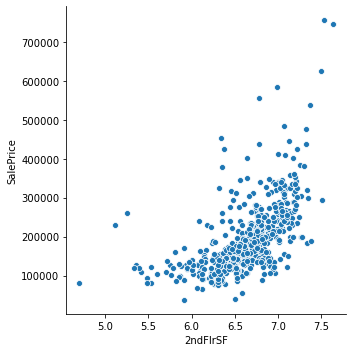

total_outdoor_sqft


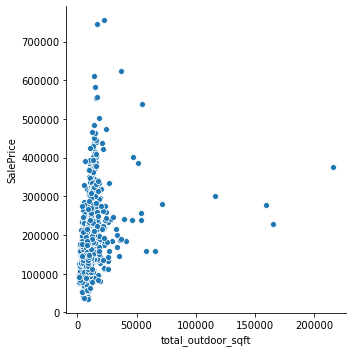

logged


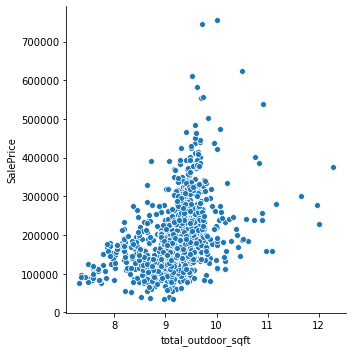

HeatingQC


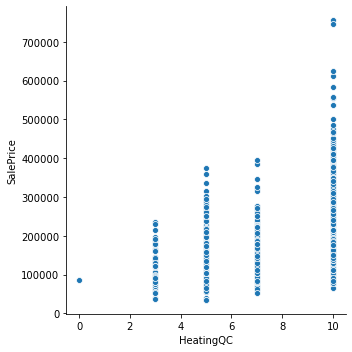

logged


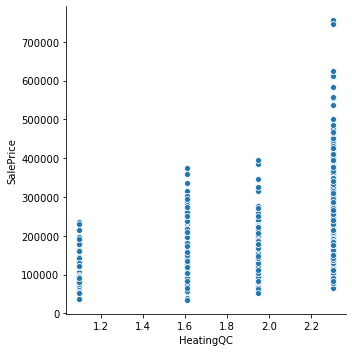

Fireplaces


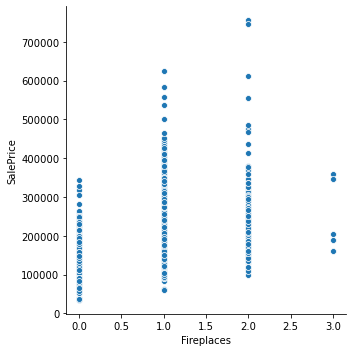

logged


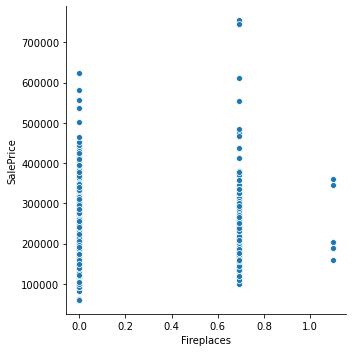

LotArea


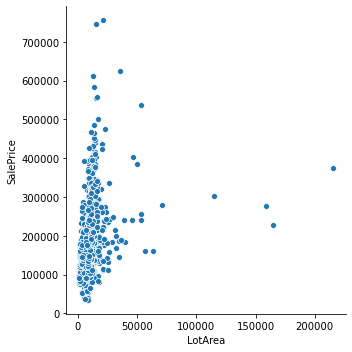

logged


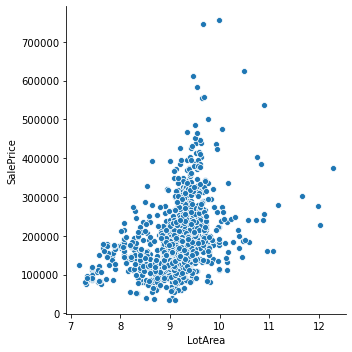

Exterior2nd


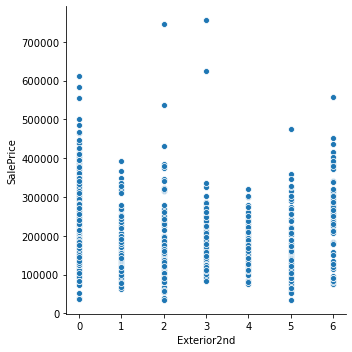

logged


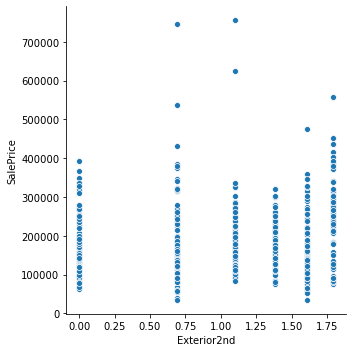

BsmtFinSF1


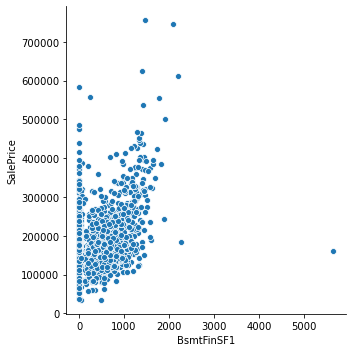

logged


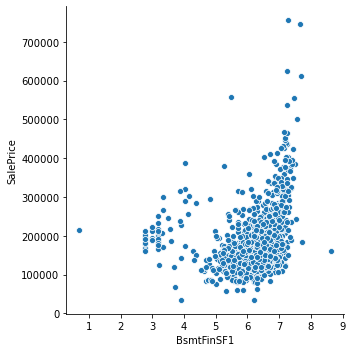

Exterior1st_Exterior2nd


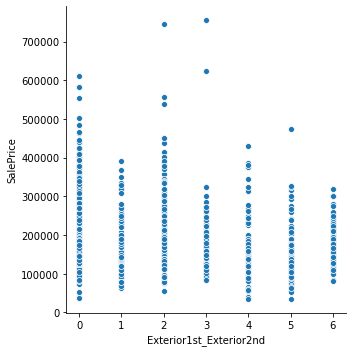

logged


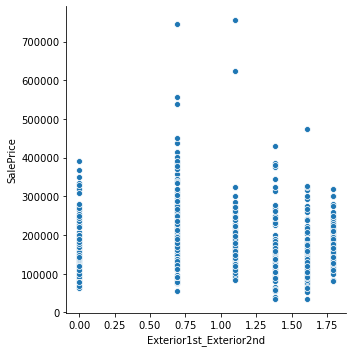

BsmtFinType1


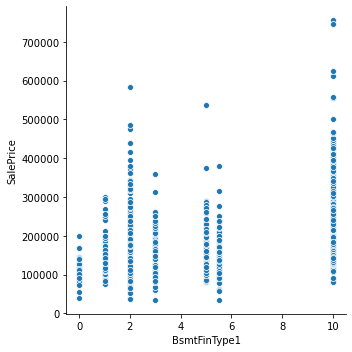

logged


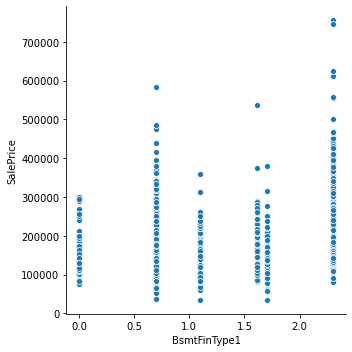

Exterior1st


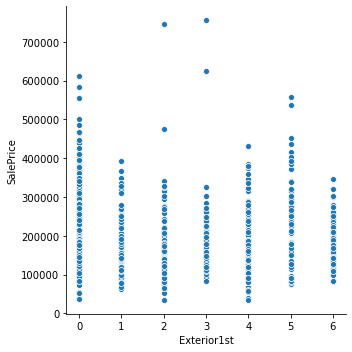

logged


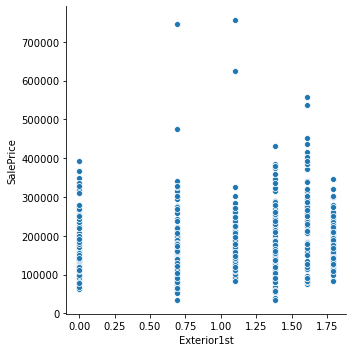

OpenPorchSF


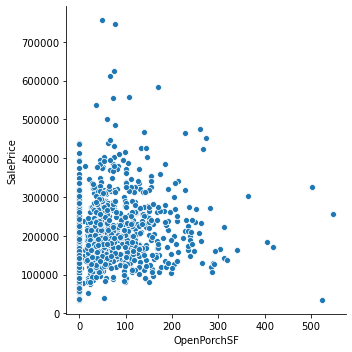

logged


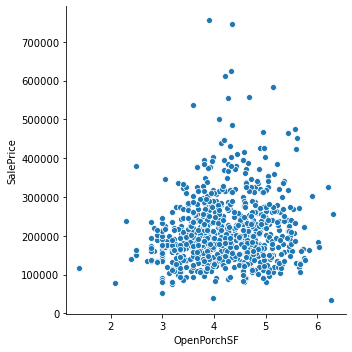

total_Bmt_Fn_Area


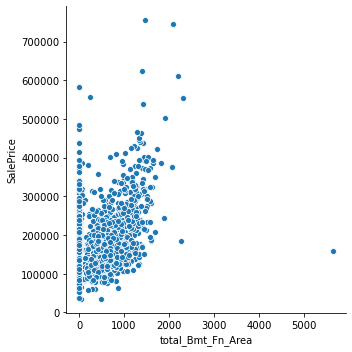

logged


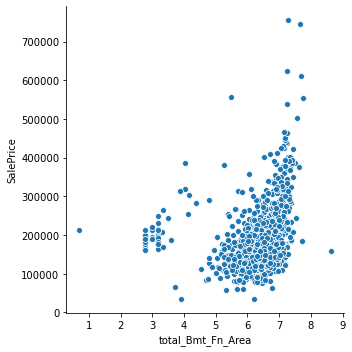

total_Porch


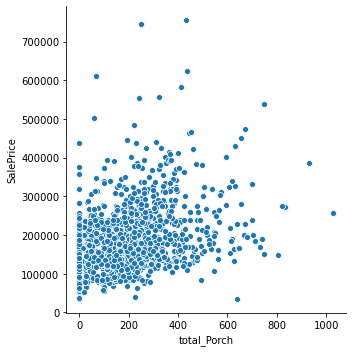

logged


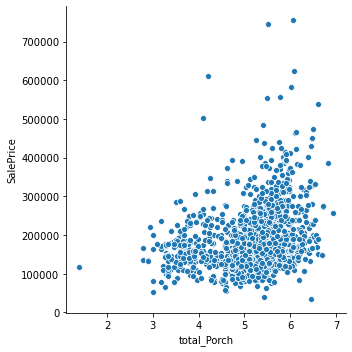

total_Max_Porch_Area


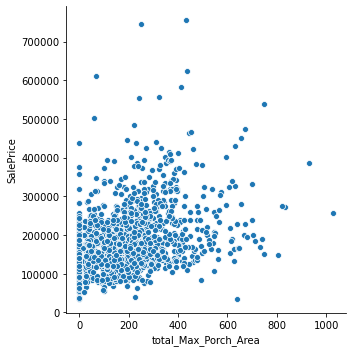

logged


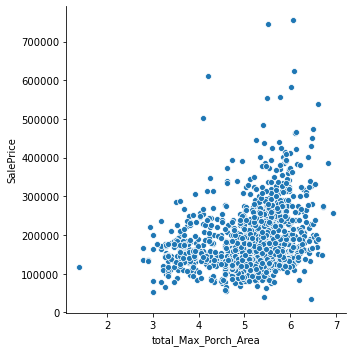

BsmtUnfSF


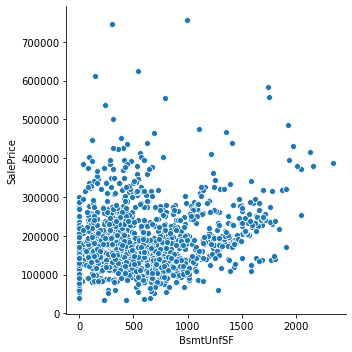

logged


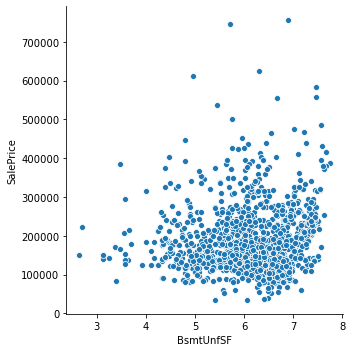

LotAreaPerFront


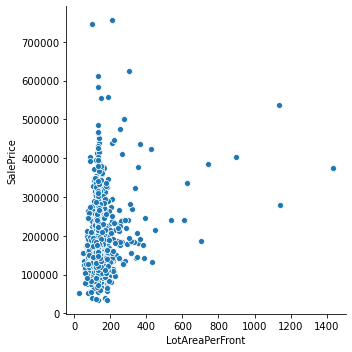

logged


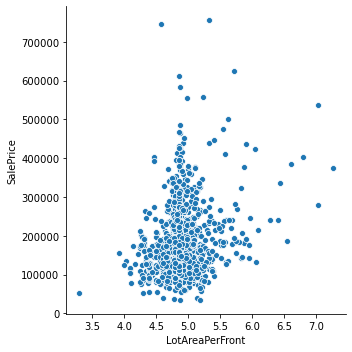

OverallCond


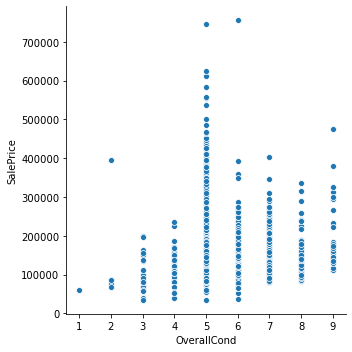

logged


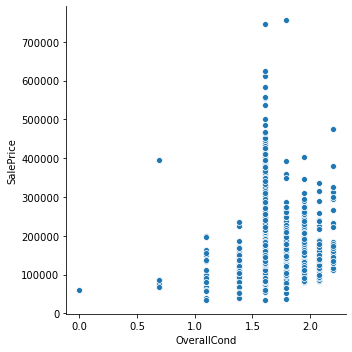

MSZoning


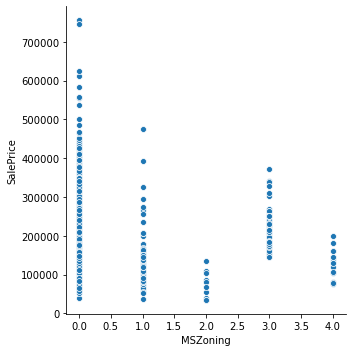

logged


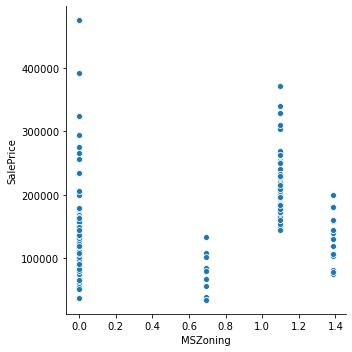

LotShape_LandContour


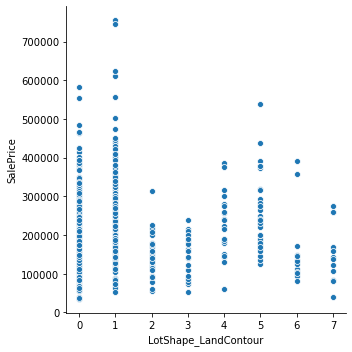

logged


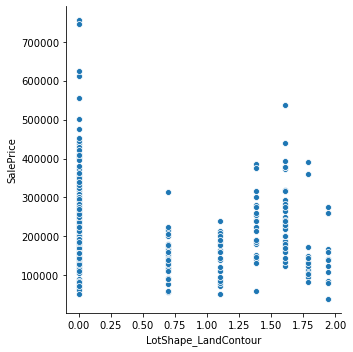

in_per_out


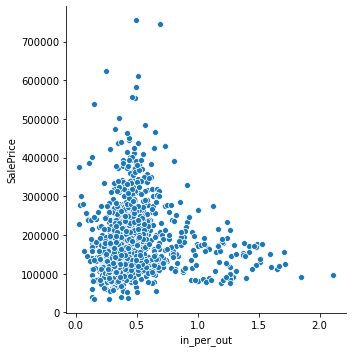

logged


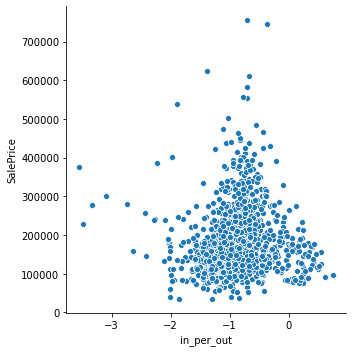

PorchTypes


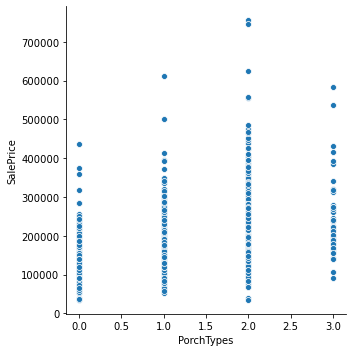

logged


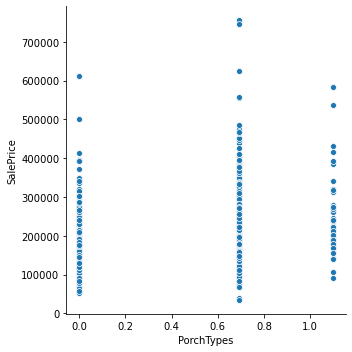

WoodDeckSF


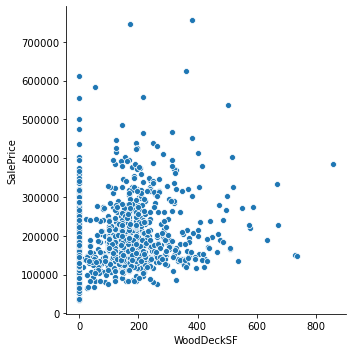

logged


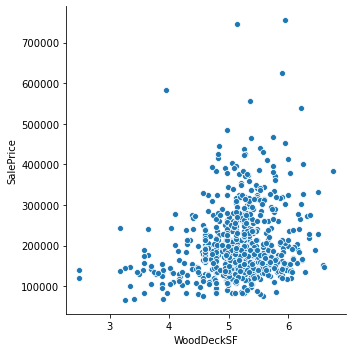

MasVnrType


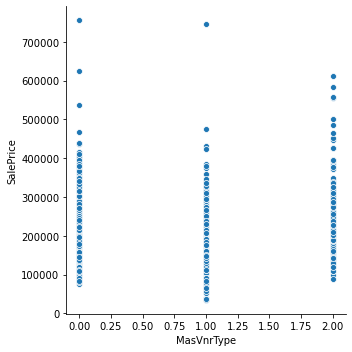

logged


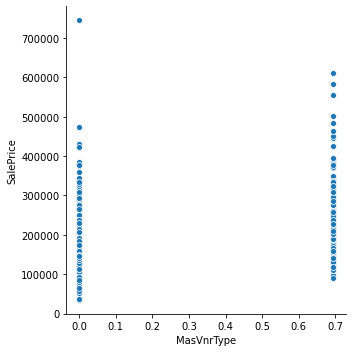

SaleCondition_SaleType


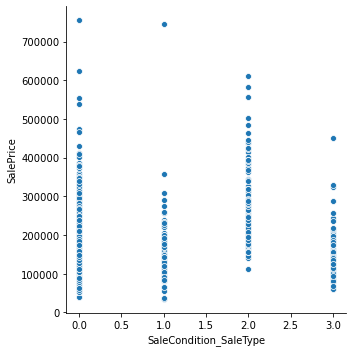

logged


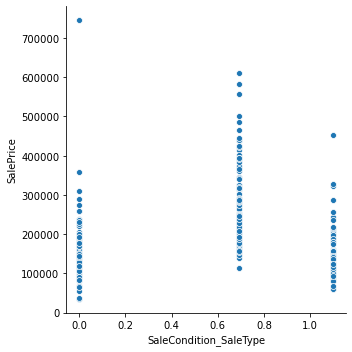

LotShape


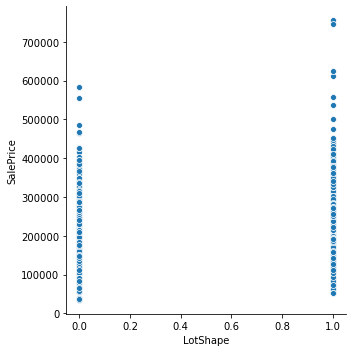

logged


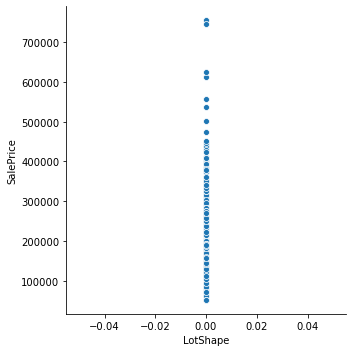

LotShape_LandSlope


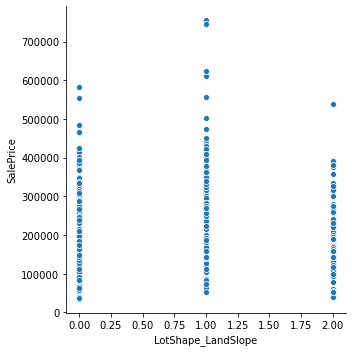

logged


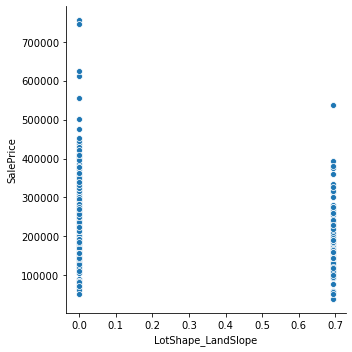

MasVnrArea


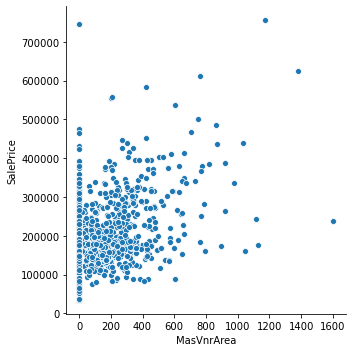

logged


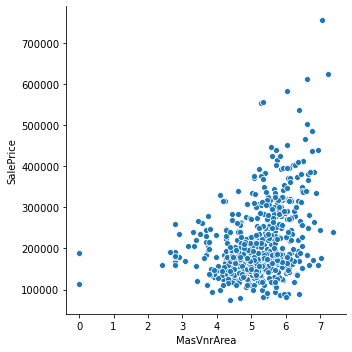

LivLotRatio


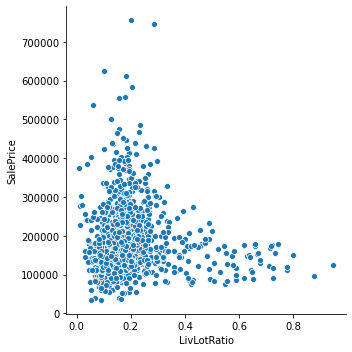

logged


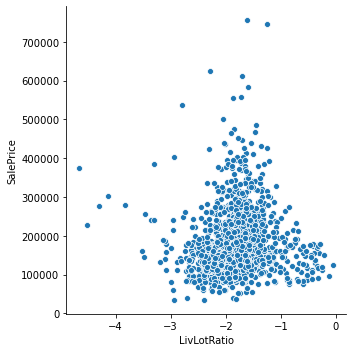

SaleType


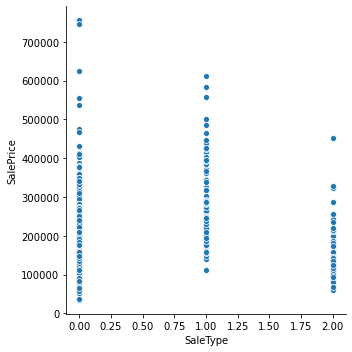

logged


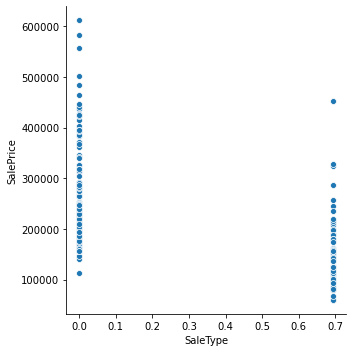

HalfBath


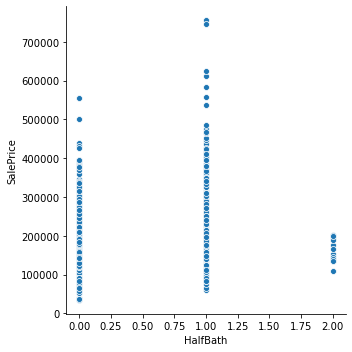

logged


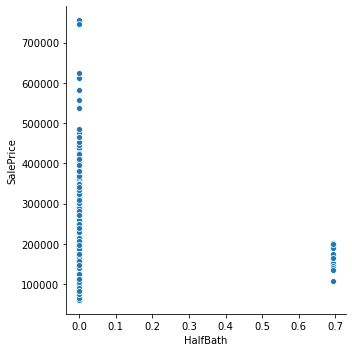

GarageCond


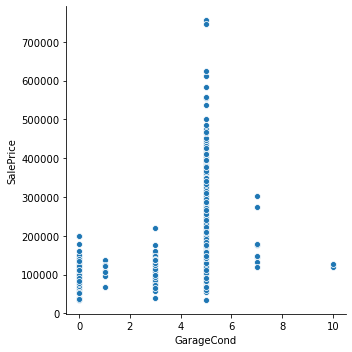

logged


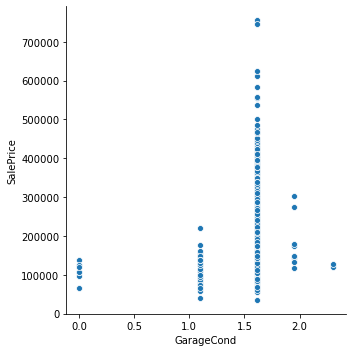

HouseStyle


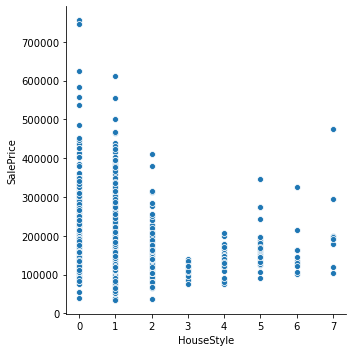

logged


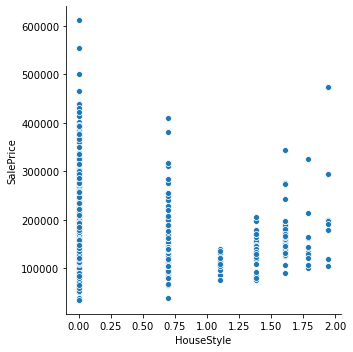

CentralAir


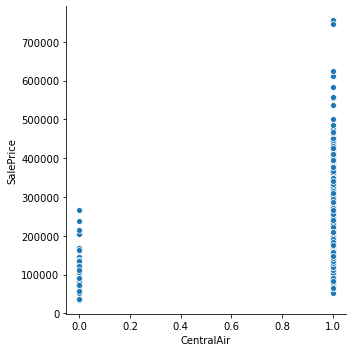

logged


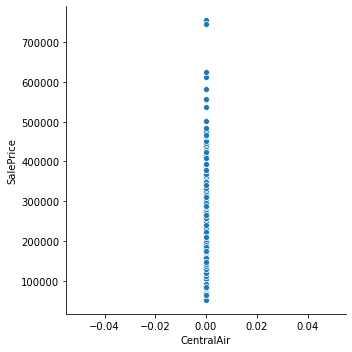

BedroomAbvGr


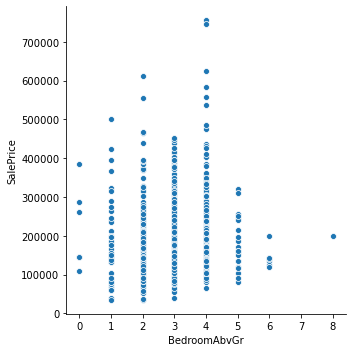

logged


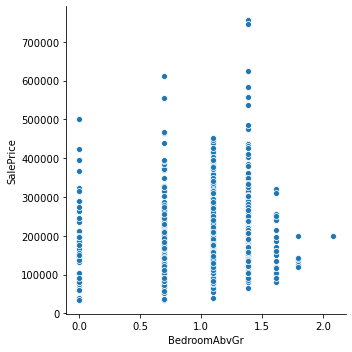

GarageQual


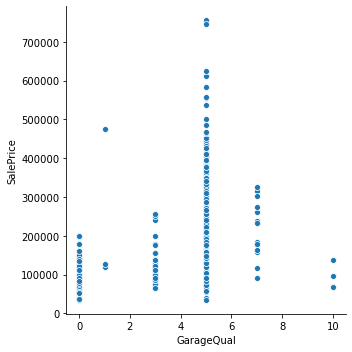

logged


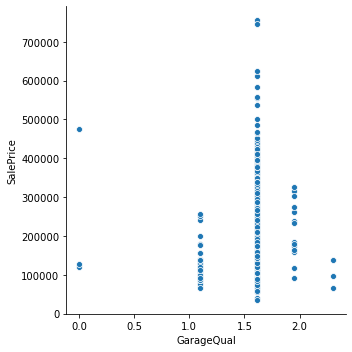

YrBlt_YrRmd_Diff


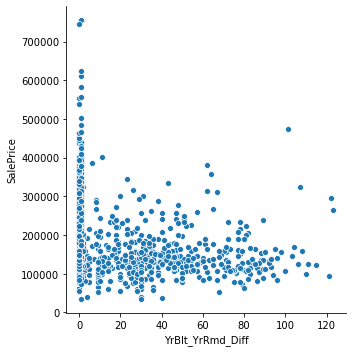

logged


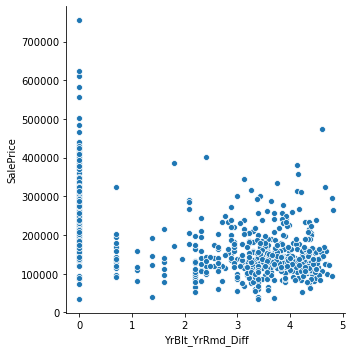

SaleCondition


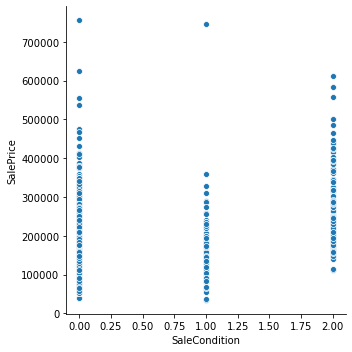

logged


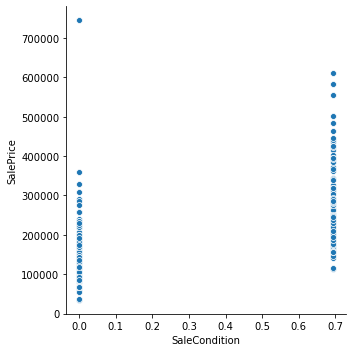

BsmtExposure


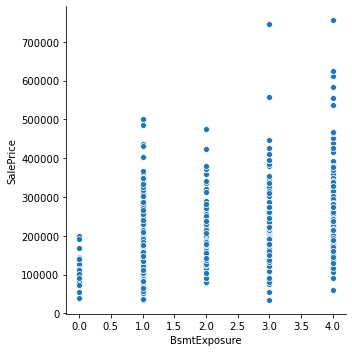

logged


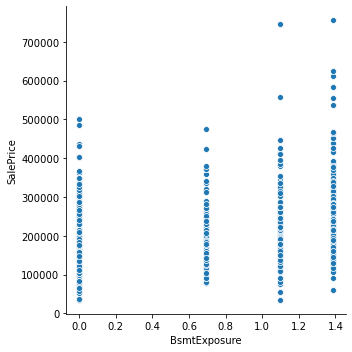

LotShape_LotConfig


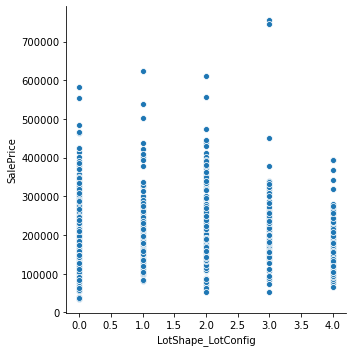

logged


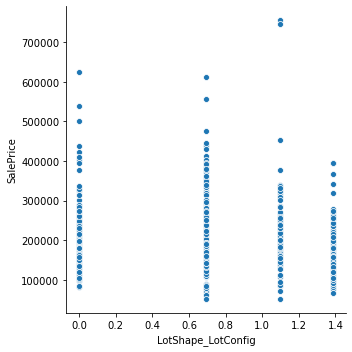

house_story


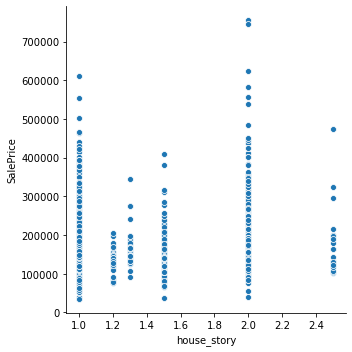

logged


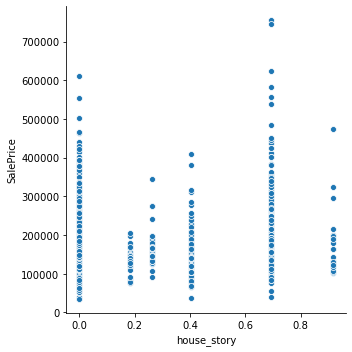

PavedDrive


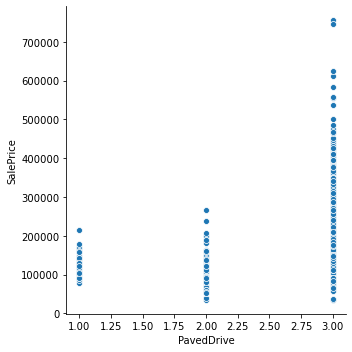

logged


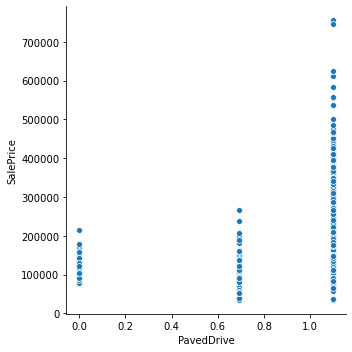

Bsmt_Unf_Per


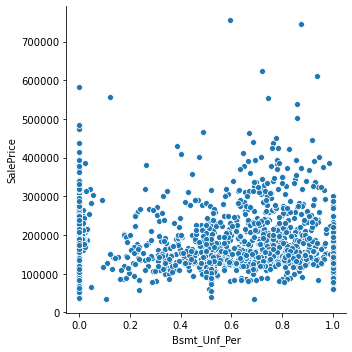

logged


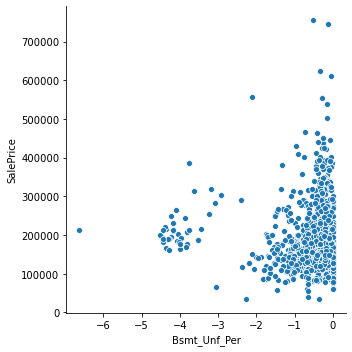

Bsmt_Fsh_Per


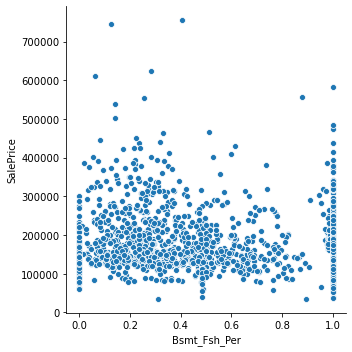

logged


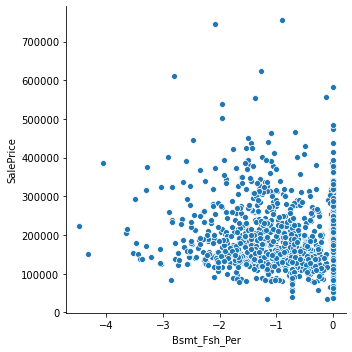

BsmtCond


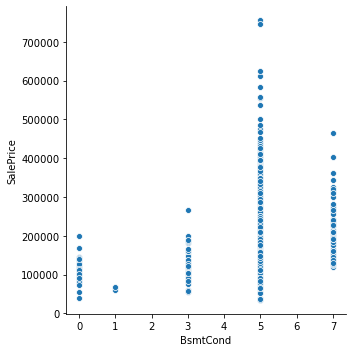

logged


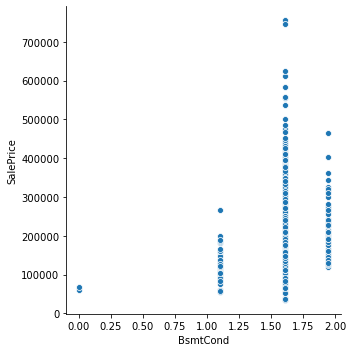

BldgType


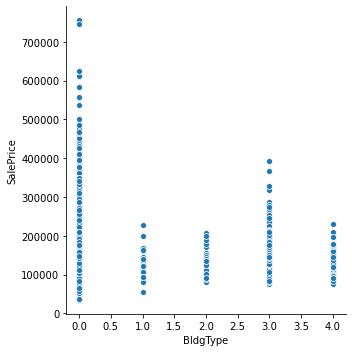

logged


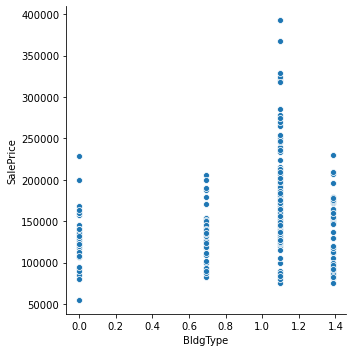

Electrical


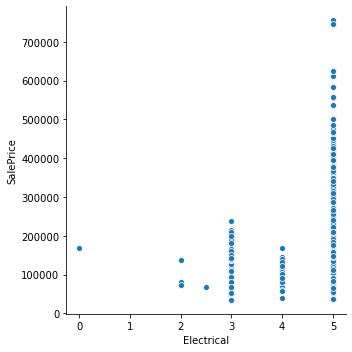

logged


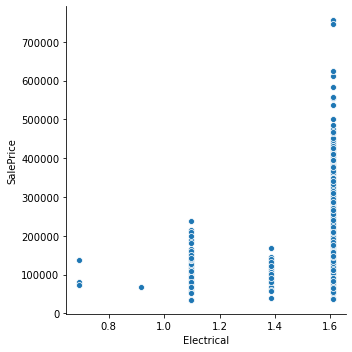

Fence


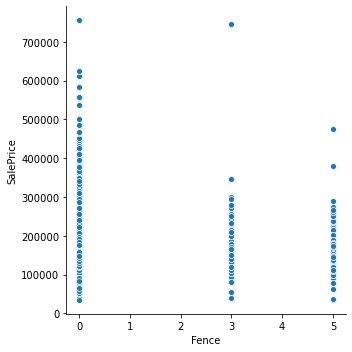

logged


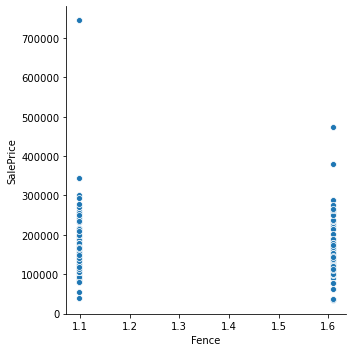

BsmtFinType2


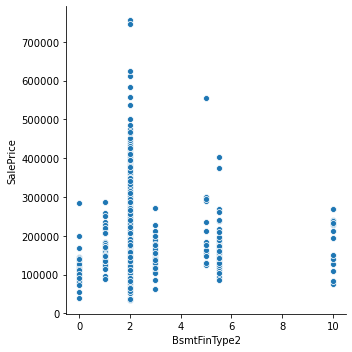

logged


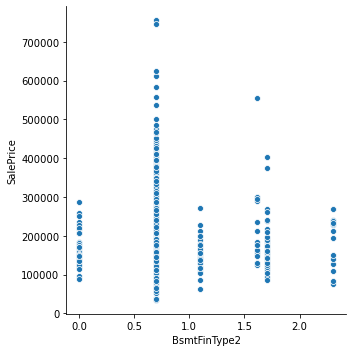

KitchenAbvGr


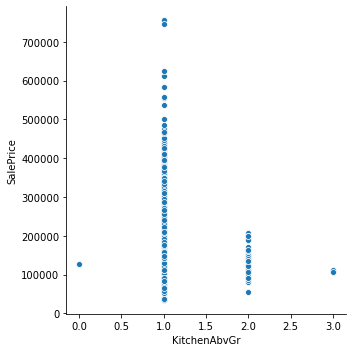

logged


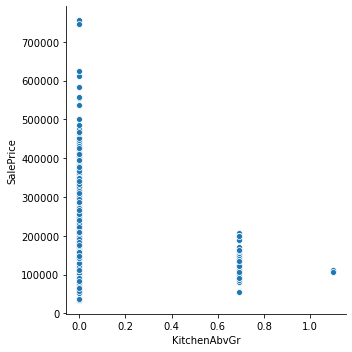

LandContour


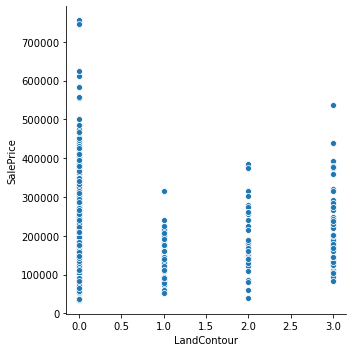

logged


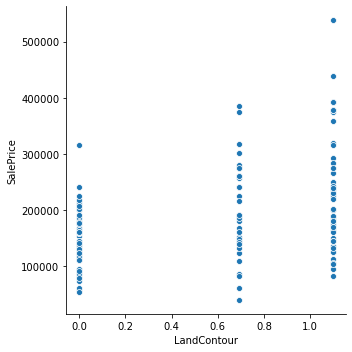

Condition1


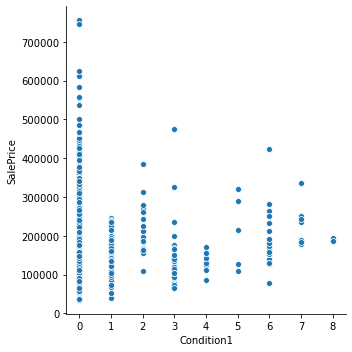

logged


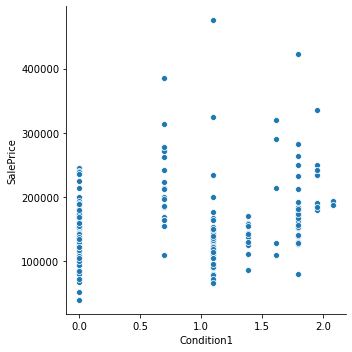

ExterCond


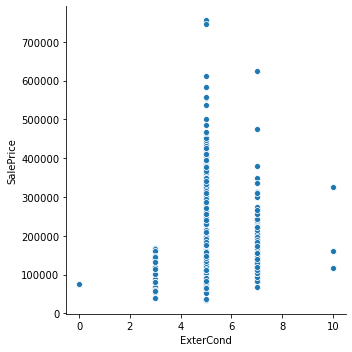

logged


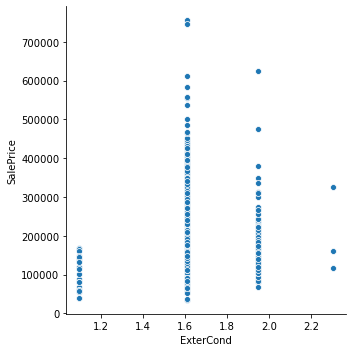

RoofStyle


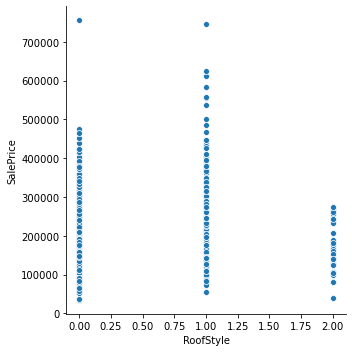

logged


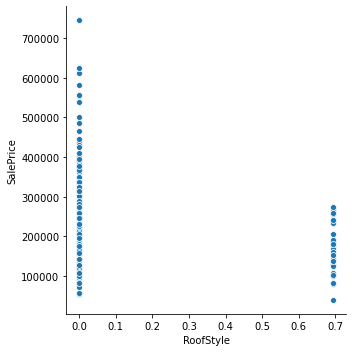

house_finish


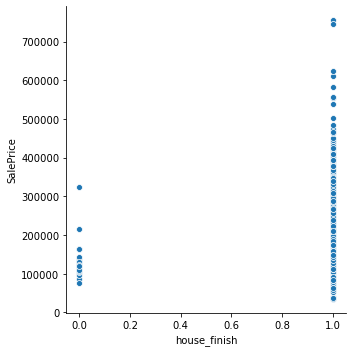

logged


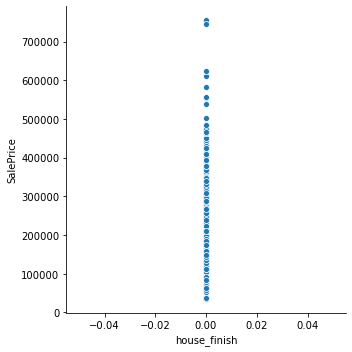

EnclosedPorch


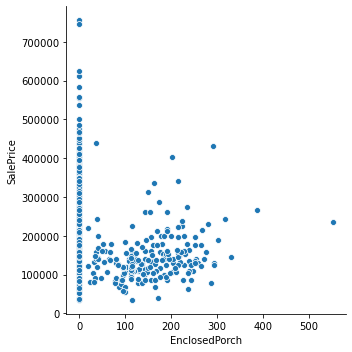

logged


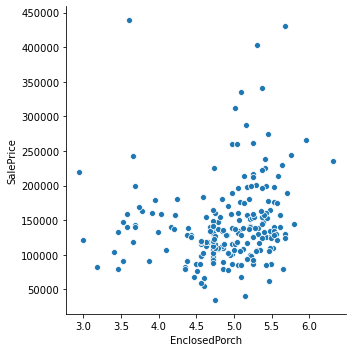

Remodeled


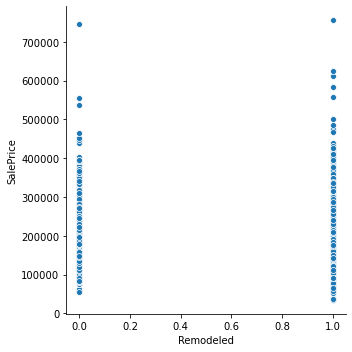

logged


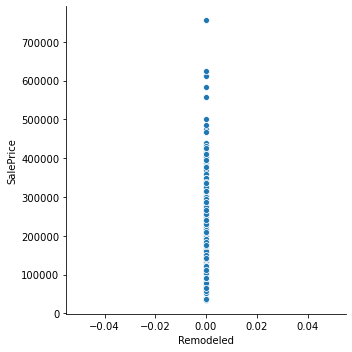

Street_Alley


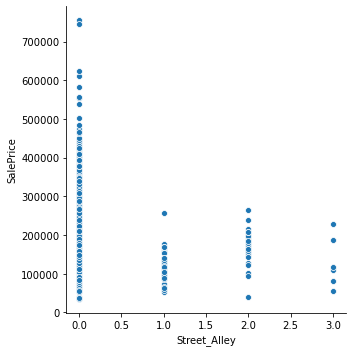

logged


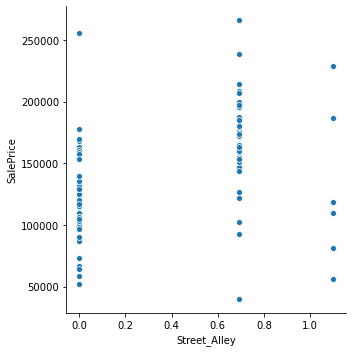

ScreenPorch


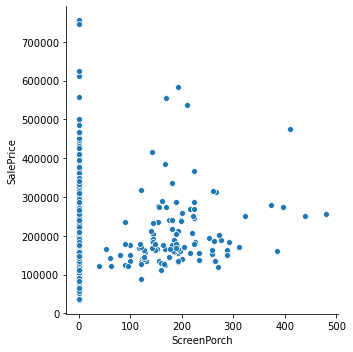

logged


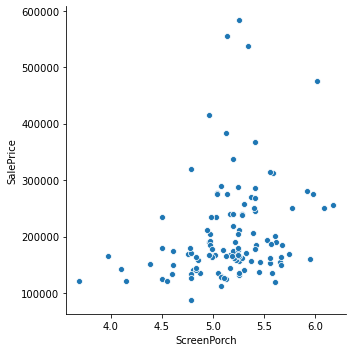

BsmtFullBath


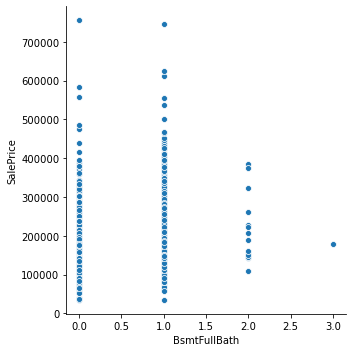

logged


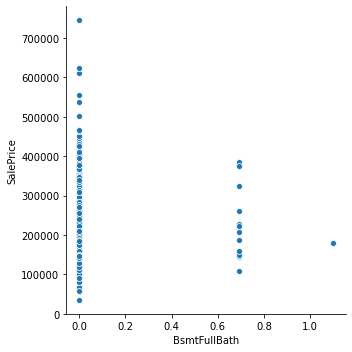

LandSlope


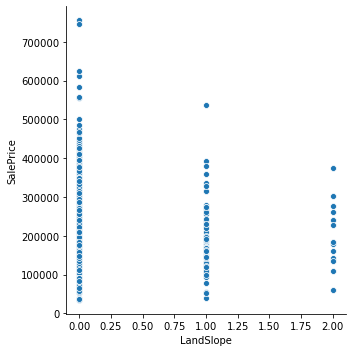

logged


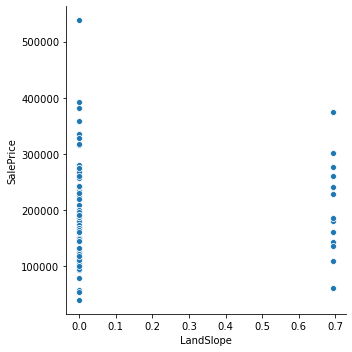

LotConfig


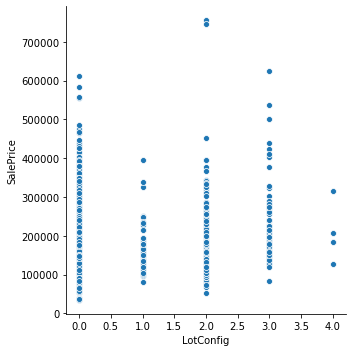

logged


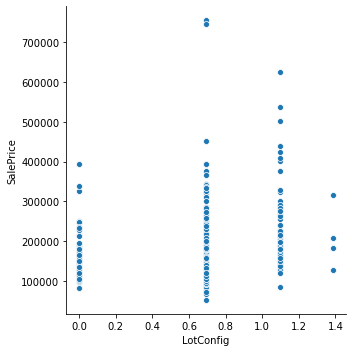

BsmtFinSF2


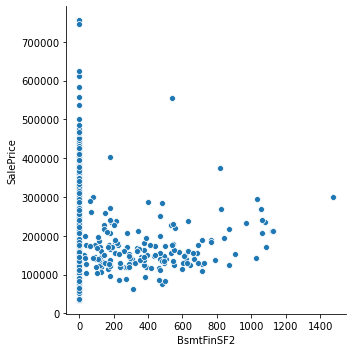

logged


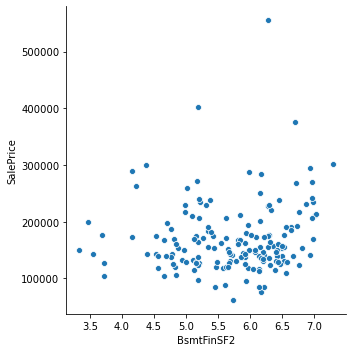

Condition1_Condition2


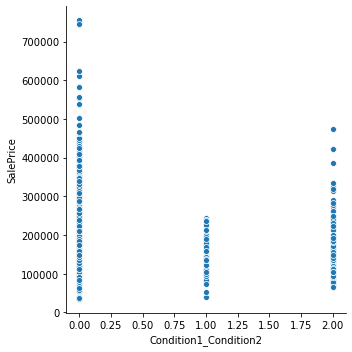

logged


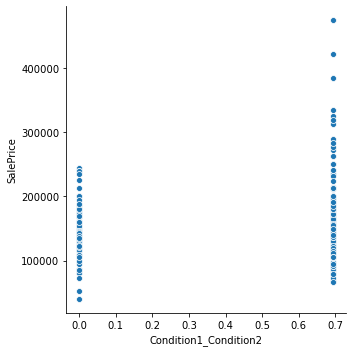

YrSold


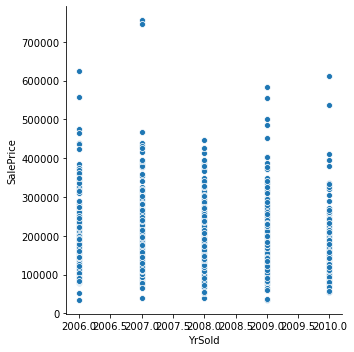

logged


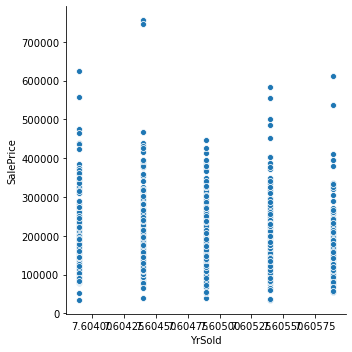

PoolArea


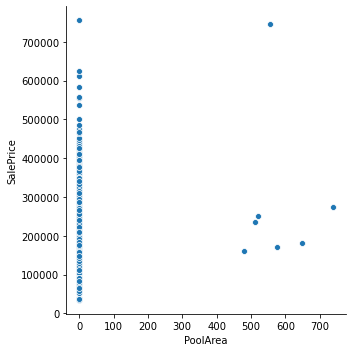

logged


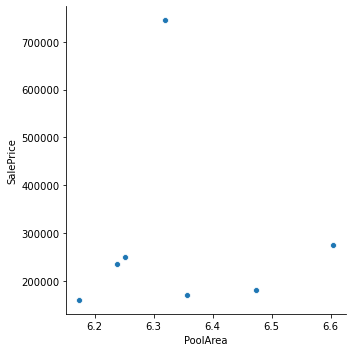

PoolQC


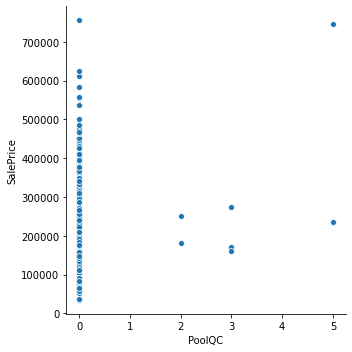

logged


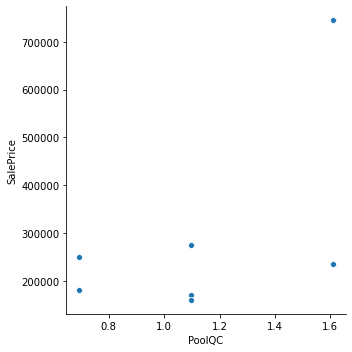

no_finishes_perc


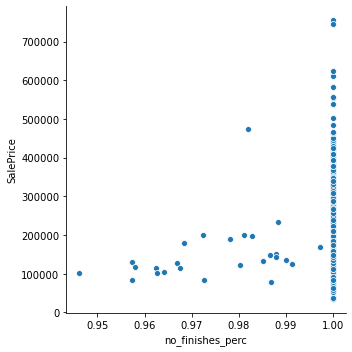

logged


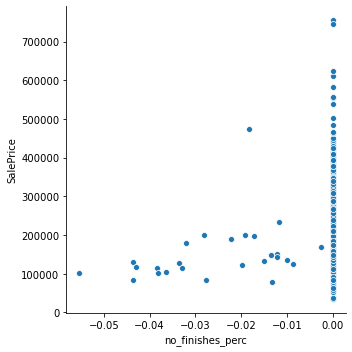

LowQualFinSF


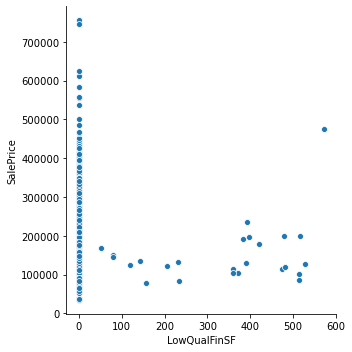

logged


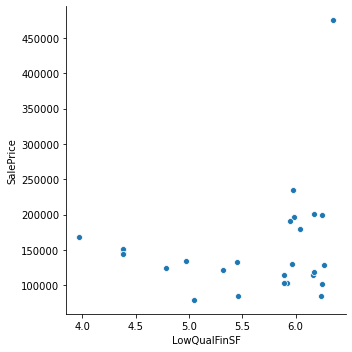

3SsnPorch


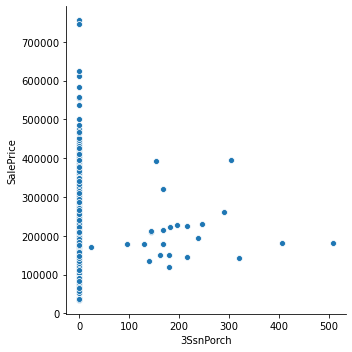

logged


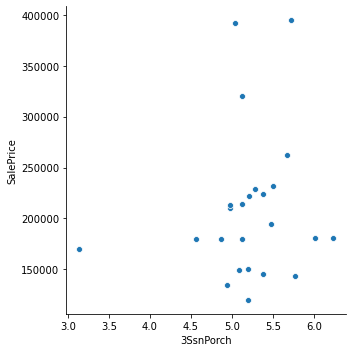

Condition2


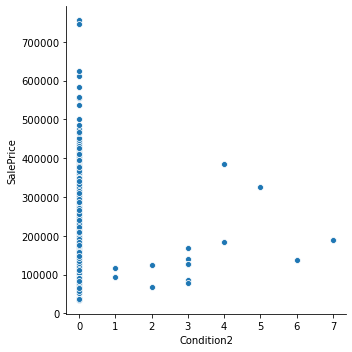

logged


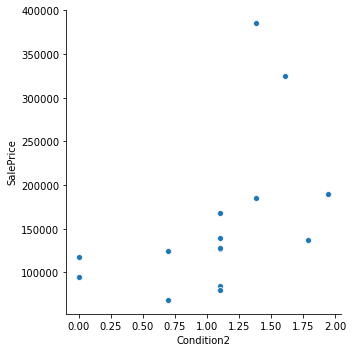

Functional


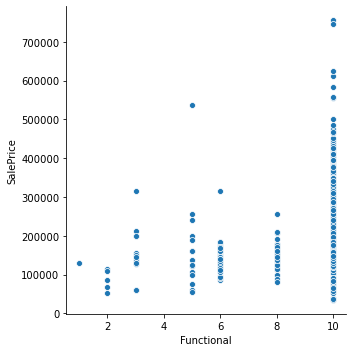

logged


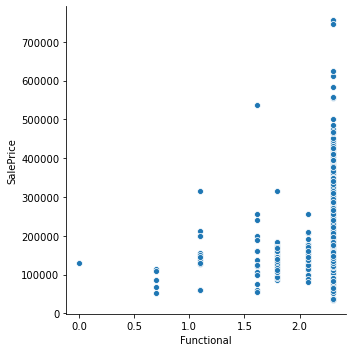

BsmtHalfBath


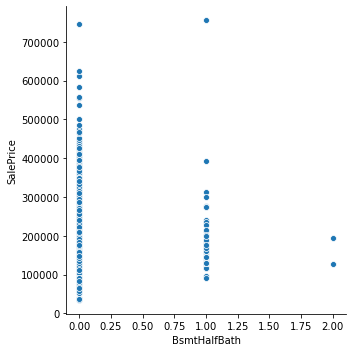

logged


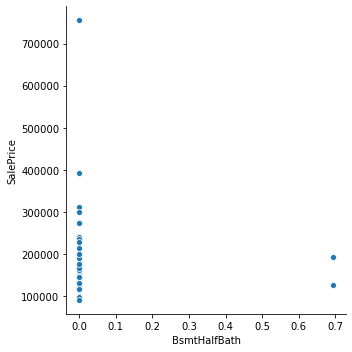

MiscVal


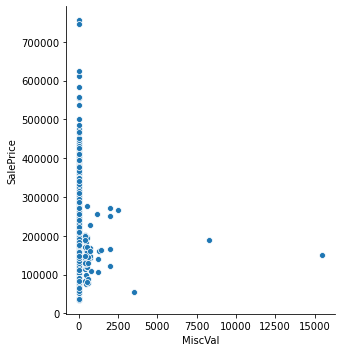

logged


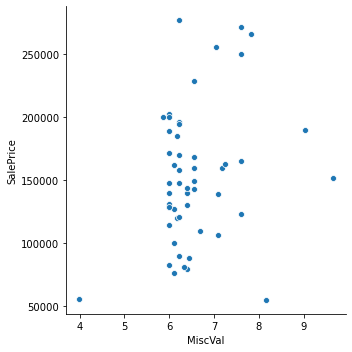

MoSold


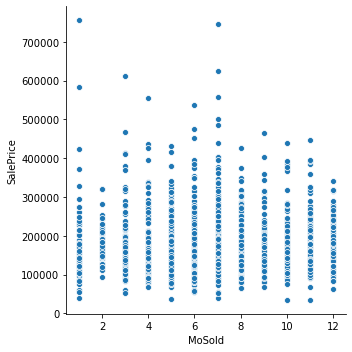

logged


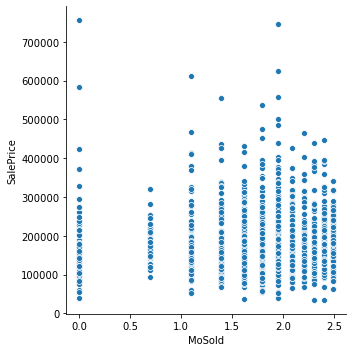

In [57]:
for col in mutual_mxLE:
    print(col)
    sns.relplot(x=col, y="SalePrice", data=LE_df,);
    plt.show()
    print("logged")
    sns.relplot(x=col, y="SalePrice", data=logged);
    plt.show()
    print("=========================")

total_indoor_sqft


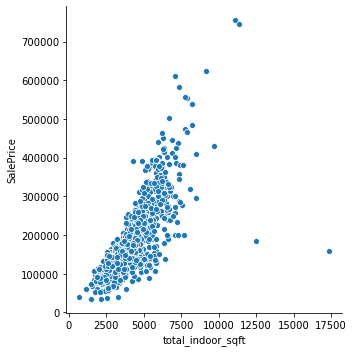

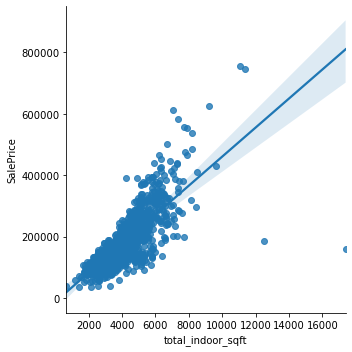

logged


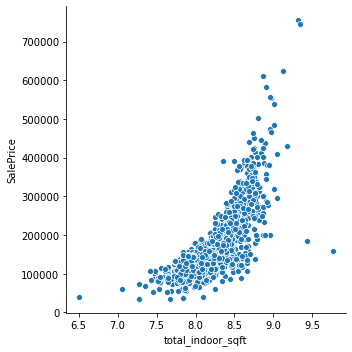

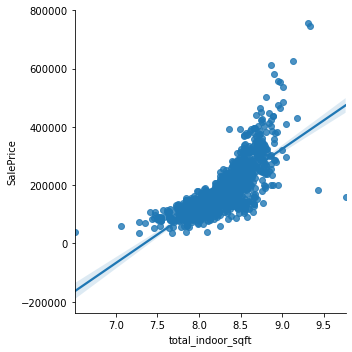

OverallQual


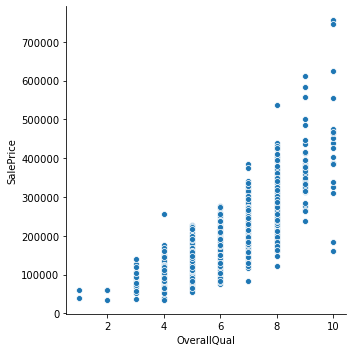

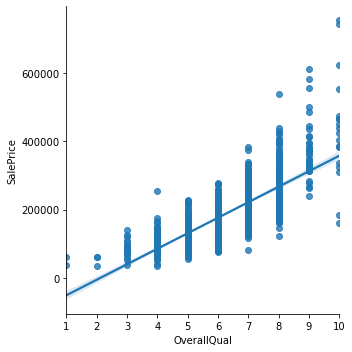

logged


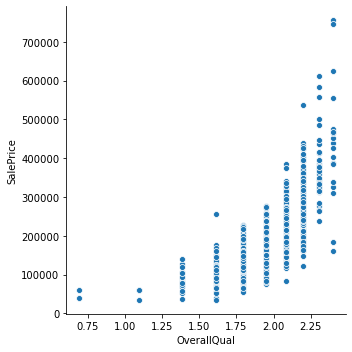

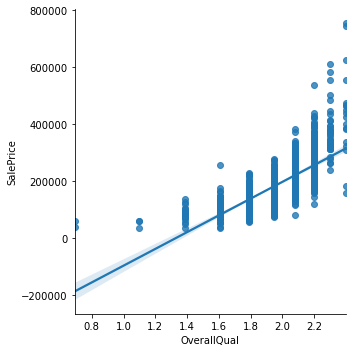

total_All_Qualities


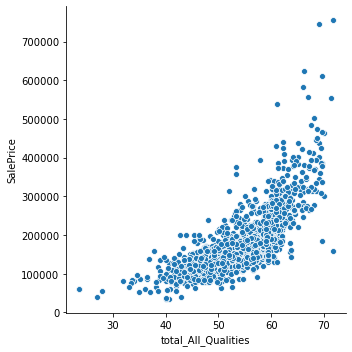

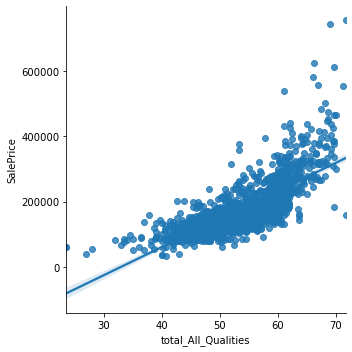

logged


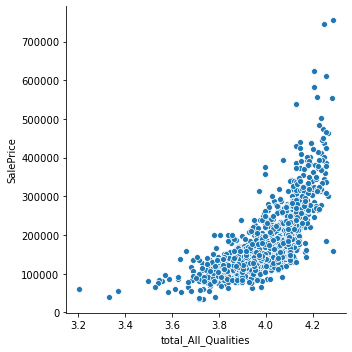

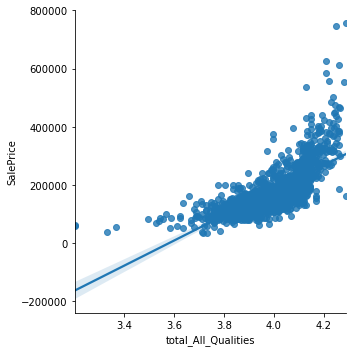

avg_All_Qualities


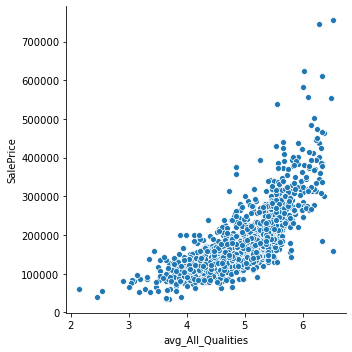

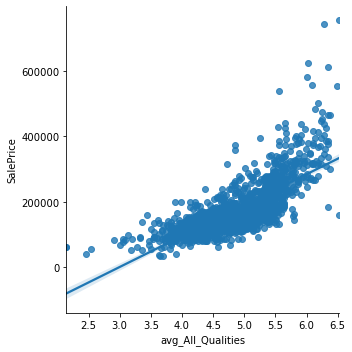

logged


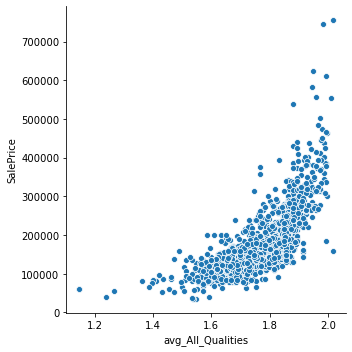

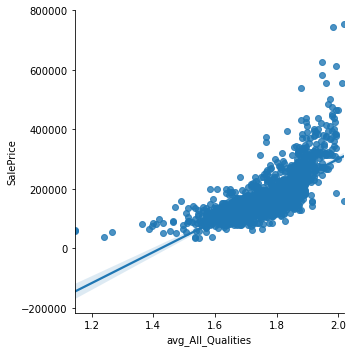

Neighborhood


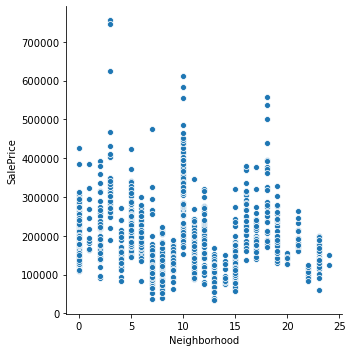

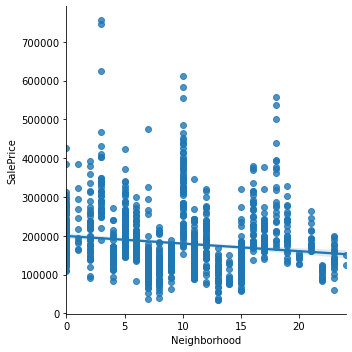

logged


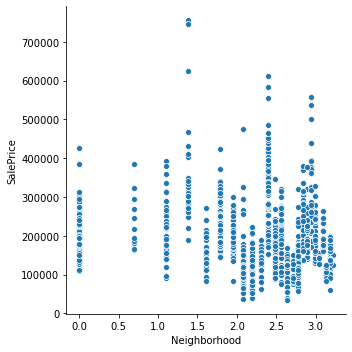

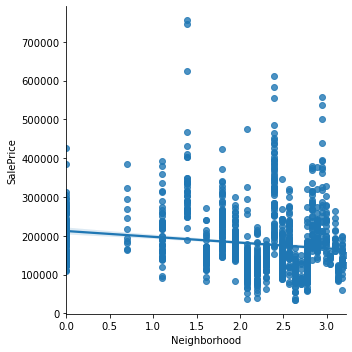

GrLivArea


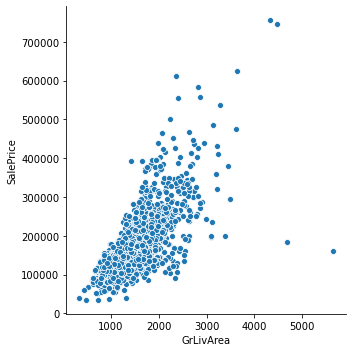

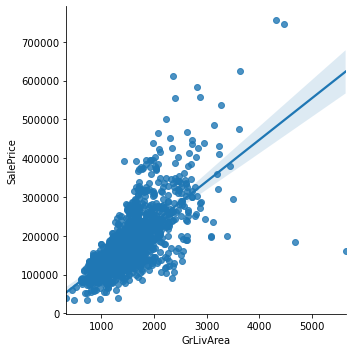

logged


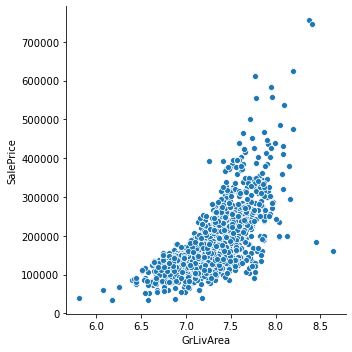

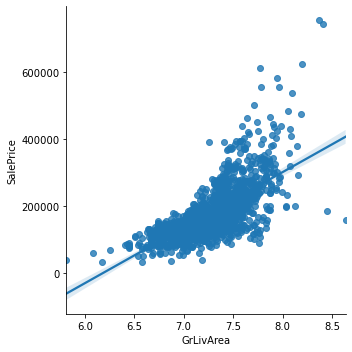

TotalBsmtSF


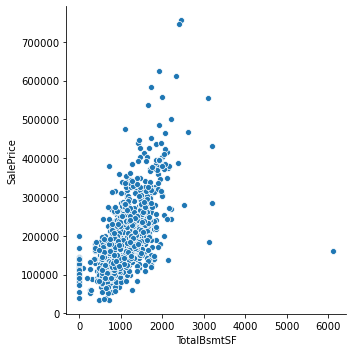

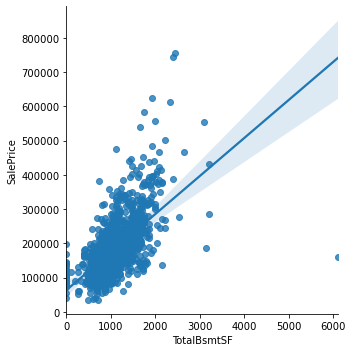

logged


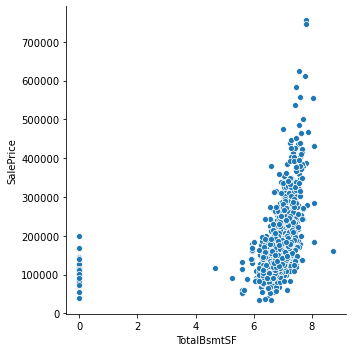

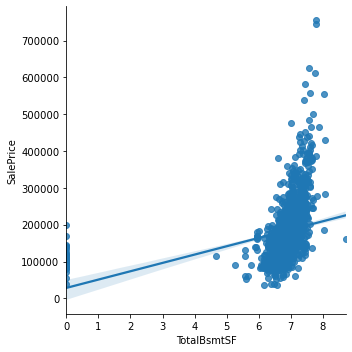

GarageArea


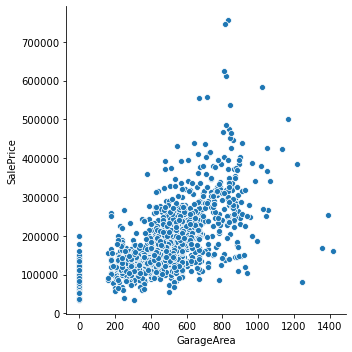

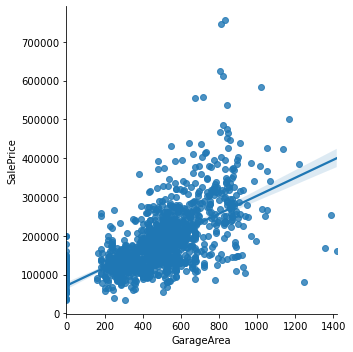

logged


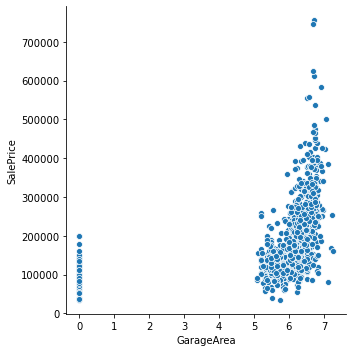

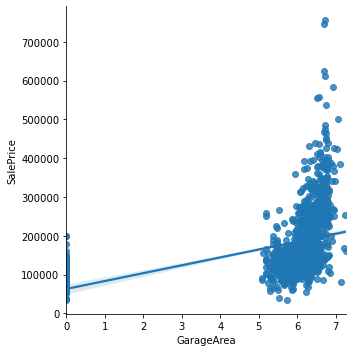

YearBuilt_Age


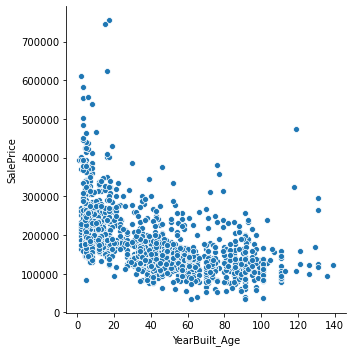

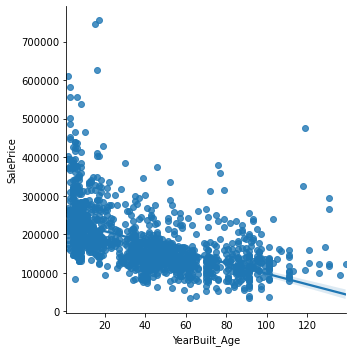

logged


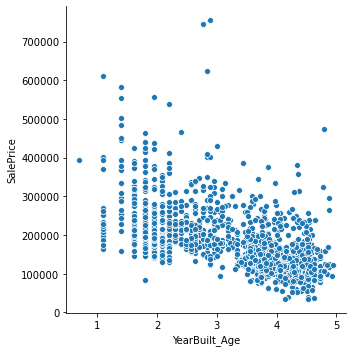

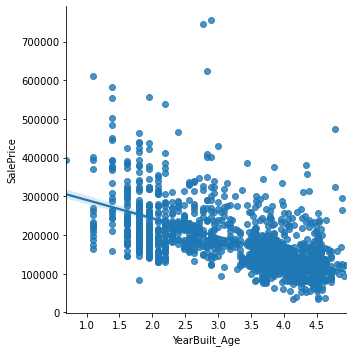

YearBuilt


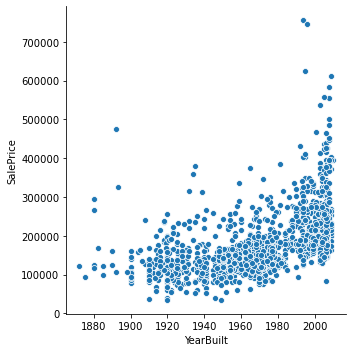

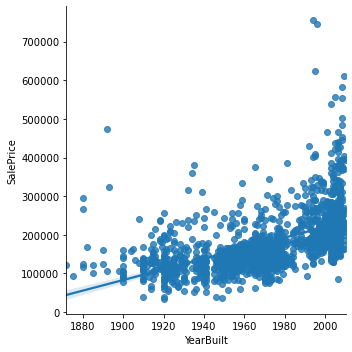

logged


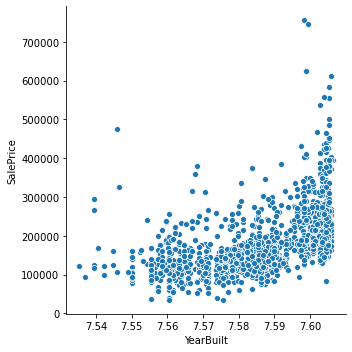

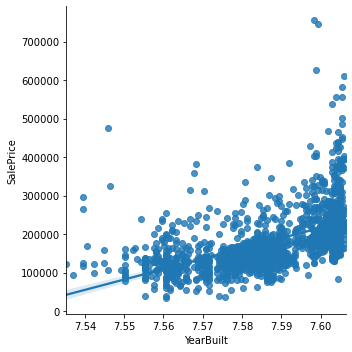

GarageCars


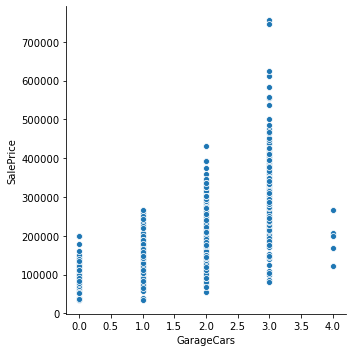

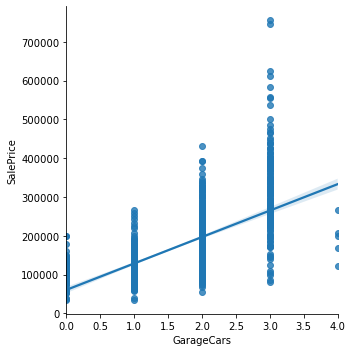

logged


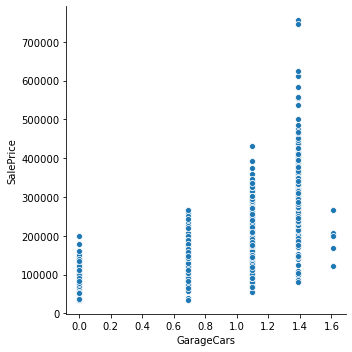

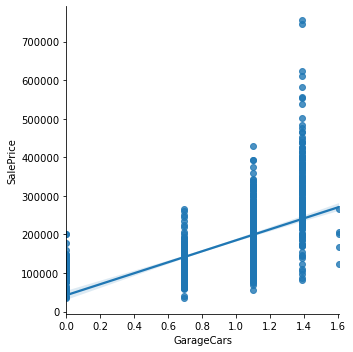

BsmtQual


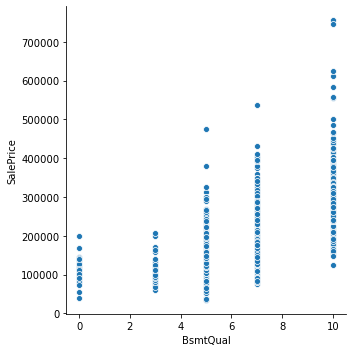

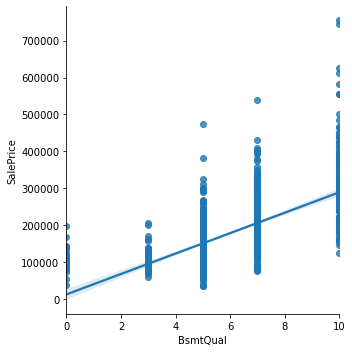

logged


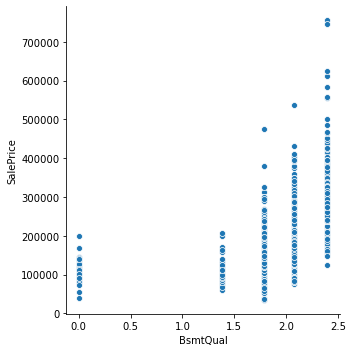

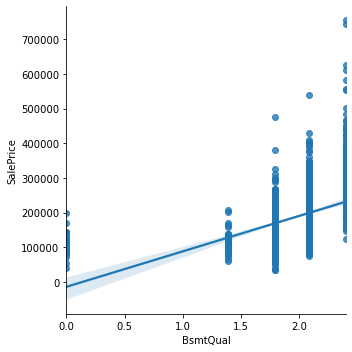

YrSd_YrBlt


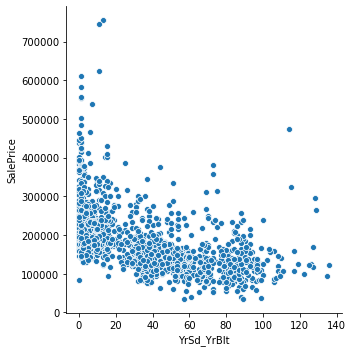

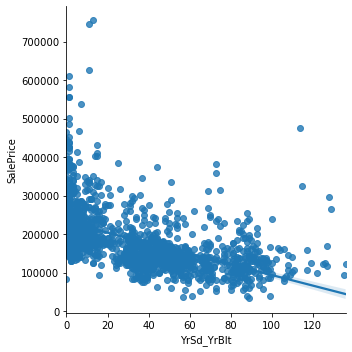

logged


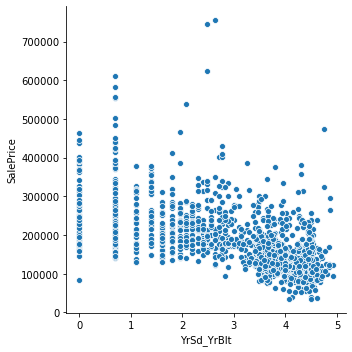

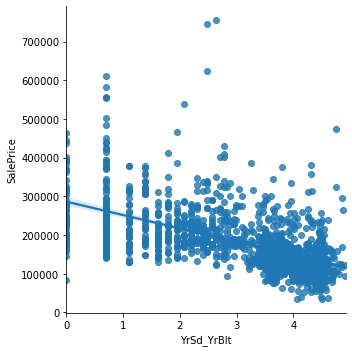

KitchenQual


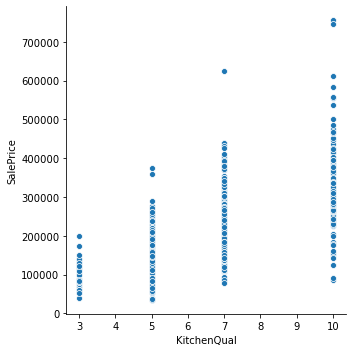

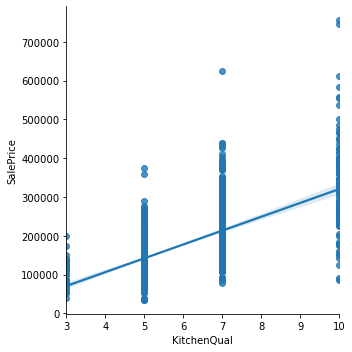

logged


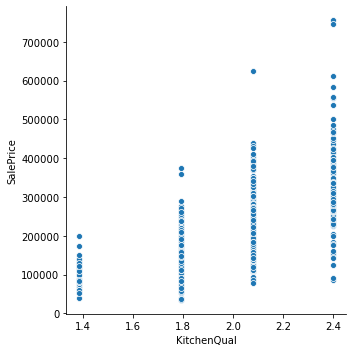

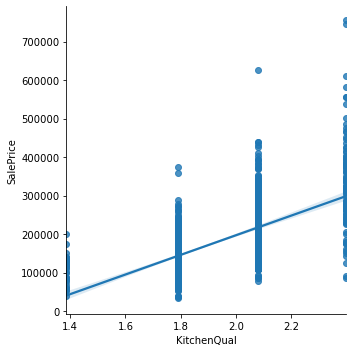

ExterQual


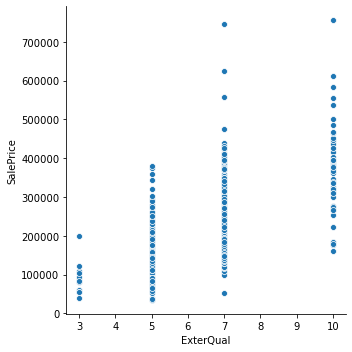

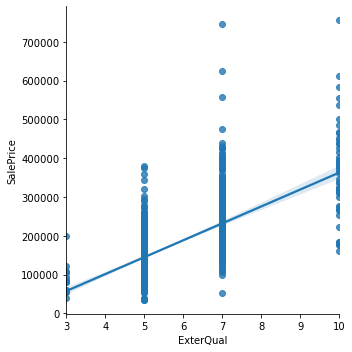

logged


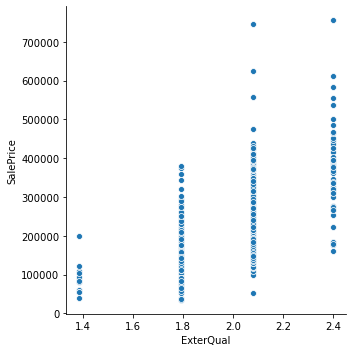

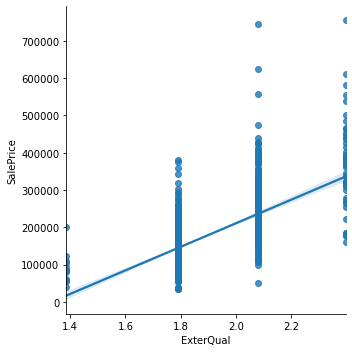

avg_Bmt_Qual


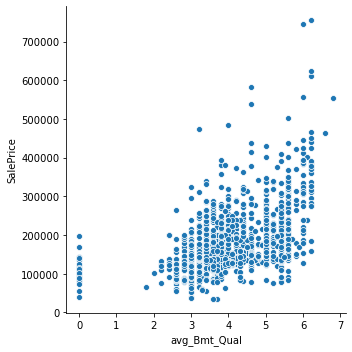

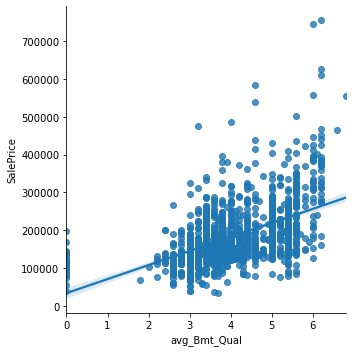

logged


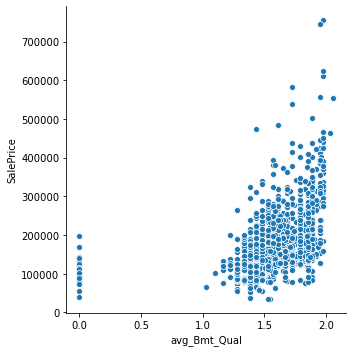

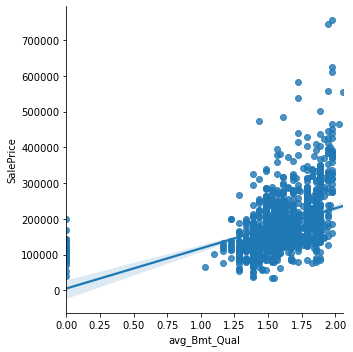

total_Bmt_Ql_Cd


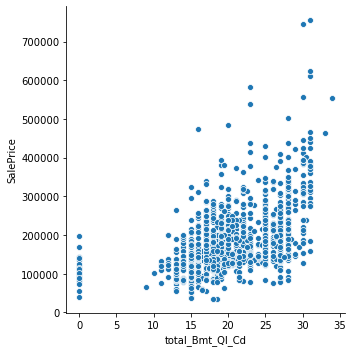

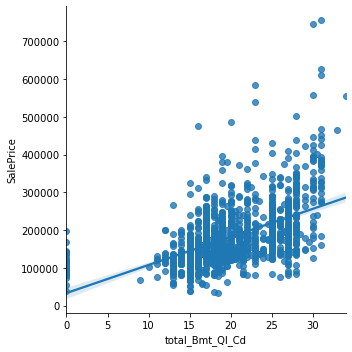

logged


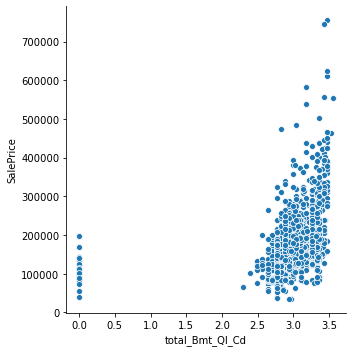

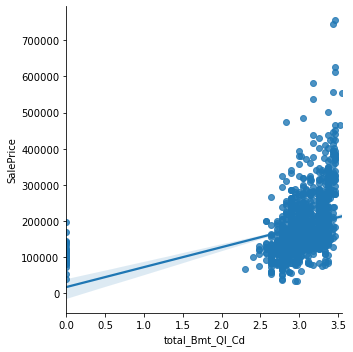

1stFlrSF


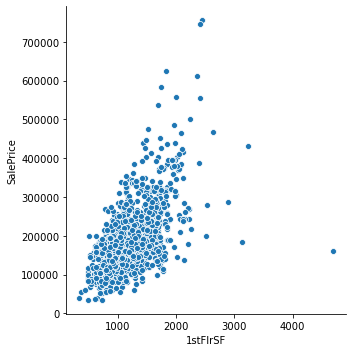

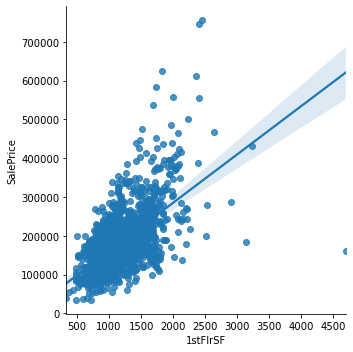

logged


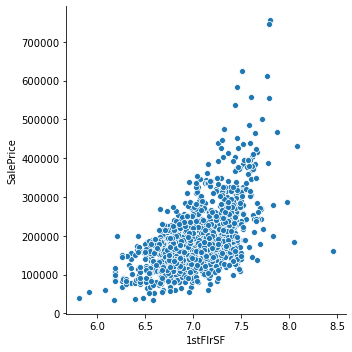

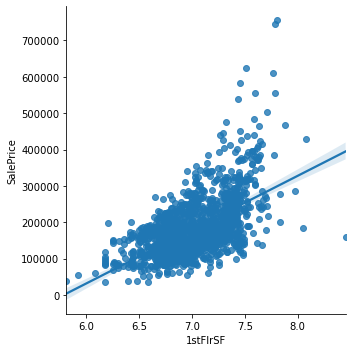

GarageYrBlt


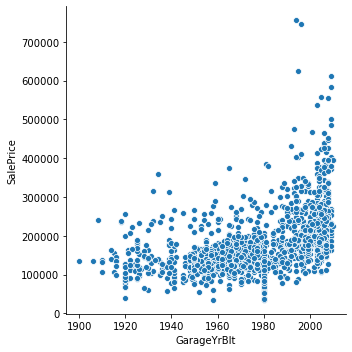

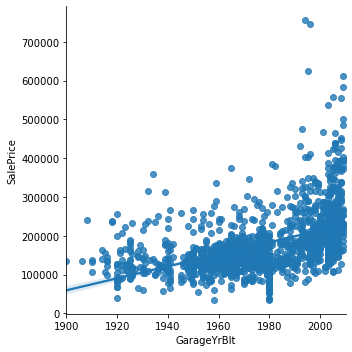

logged


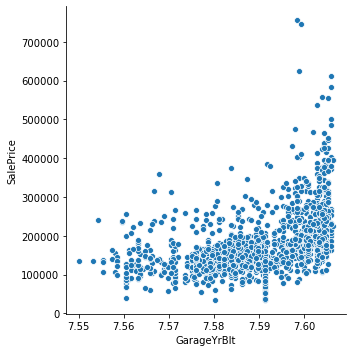

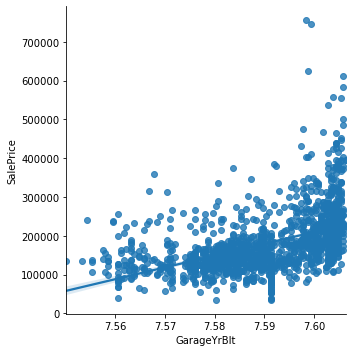

total_in_out_sqft


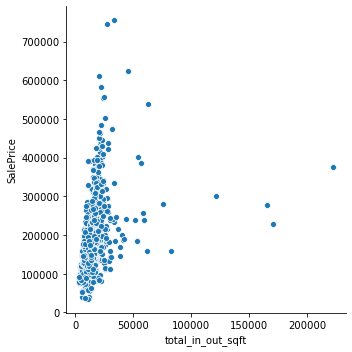

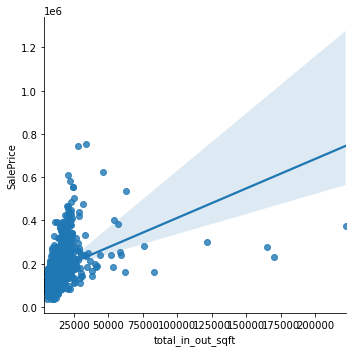

logged


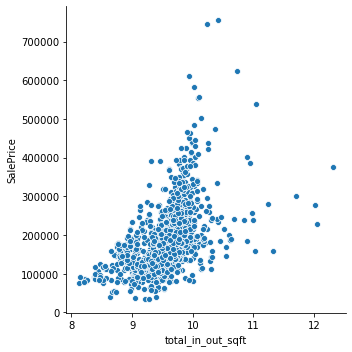

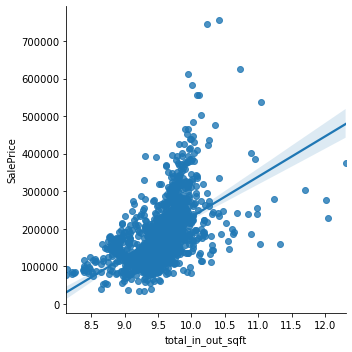

no_finishes


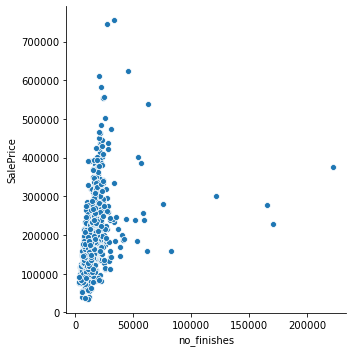

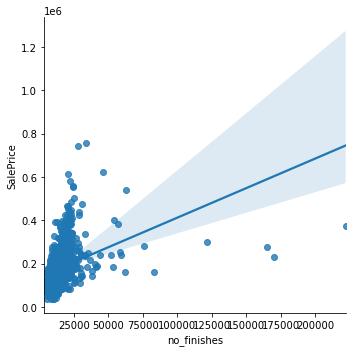

logged


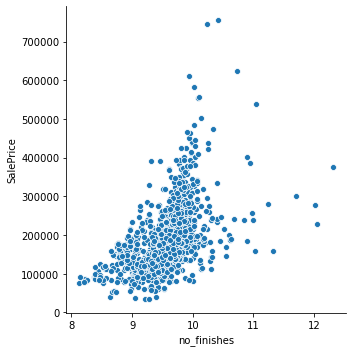

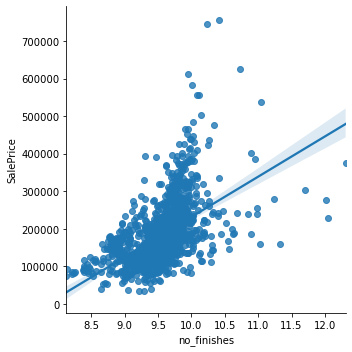

avg_Gar_Qual


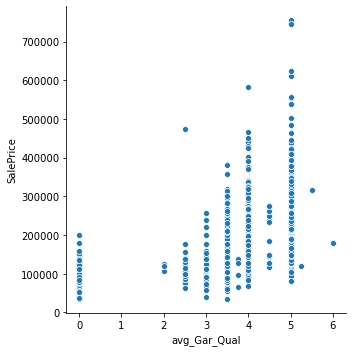

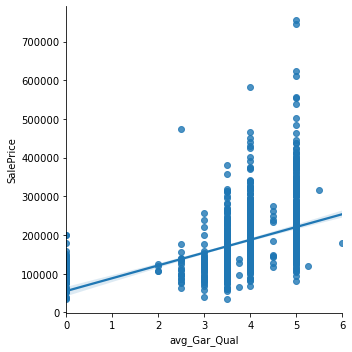

logged


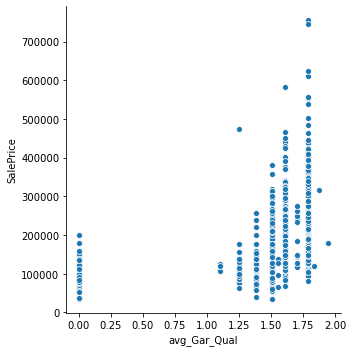

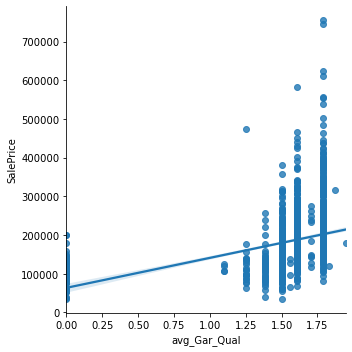

MSSubClass


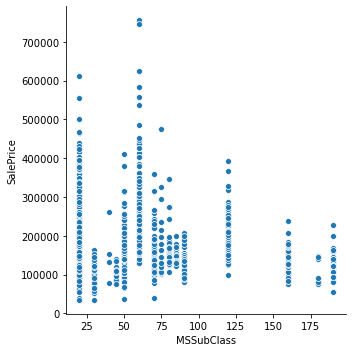

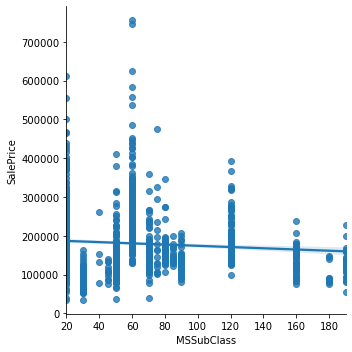

logged


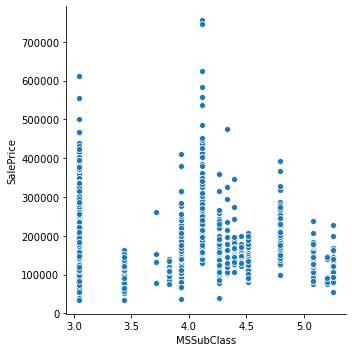

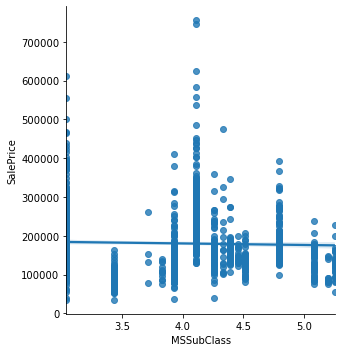

GarageFinish


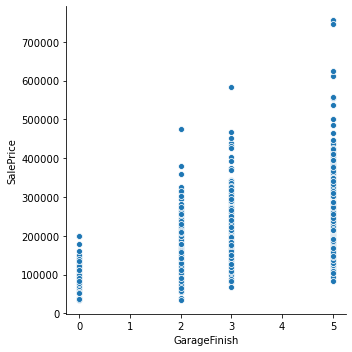

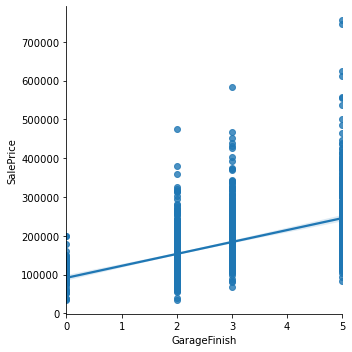

logged


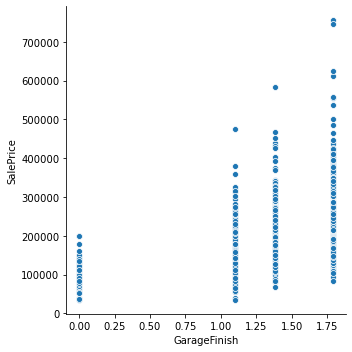

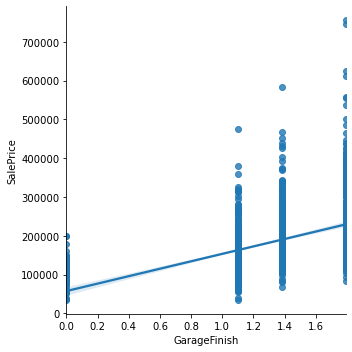

YrSd_YrRmd


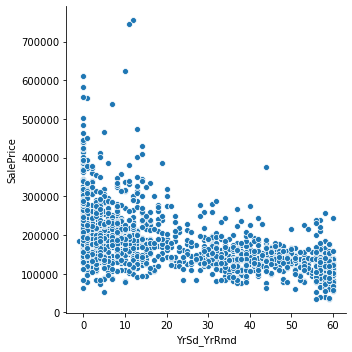

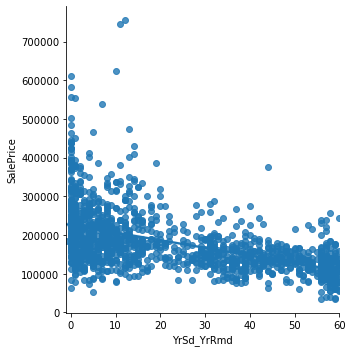

logged


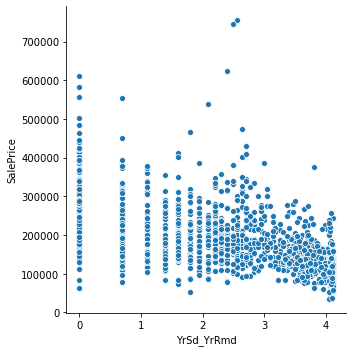

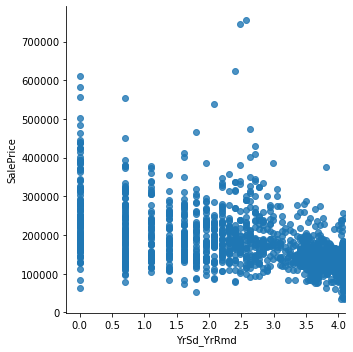

total_Garage_Ql_Cd


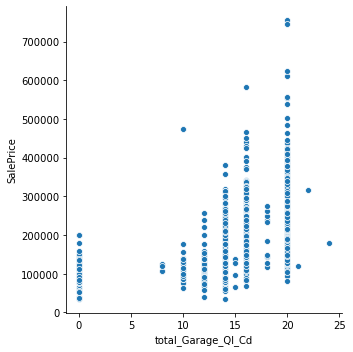

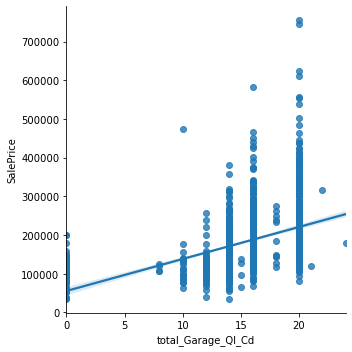

logged


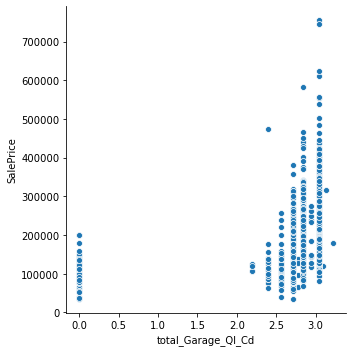

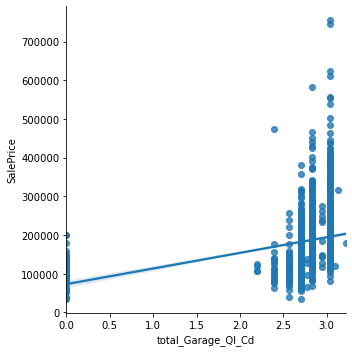

avg_Ext_Qual


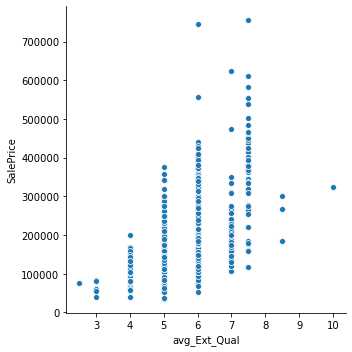

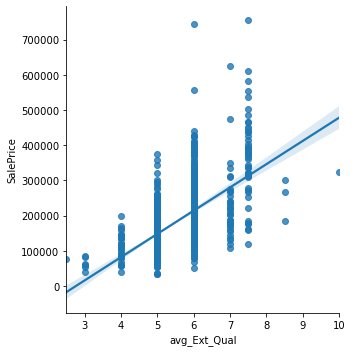

logged


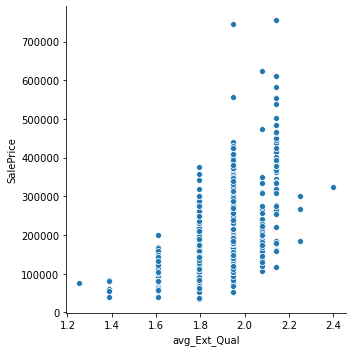

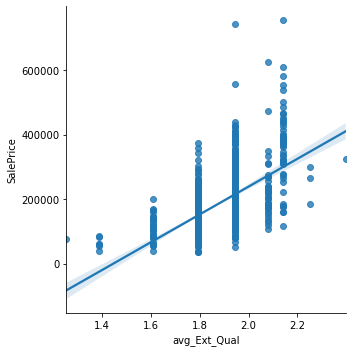

Spaciousness


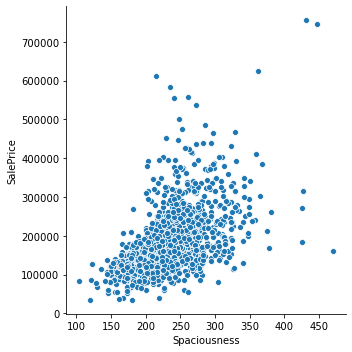

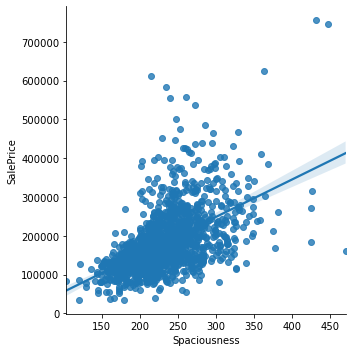

logged


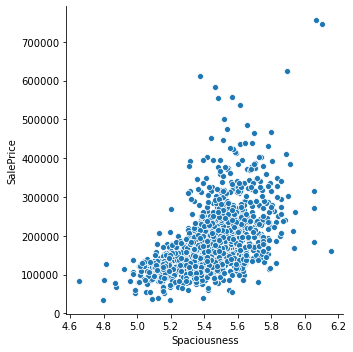

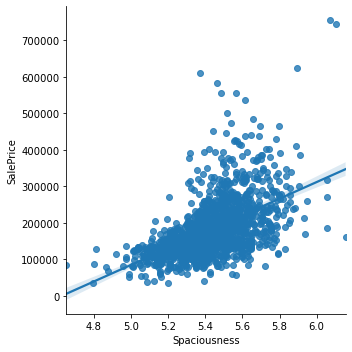

FullBath


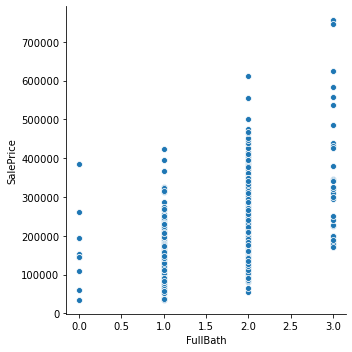

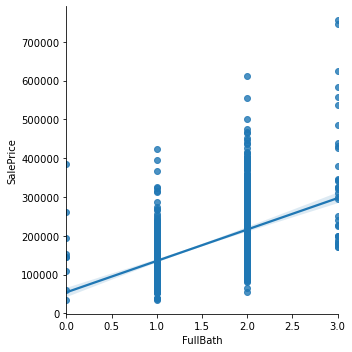

logged


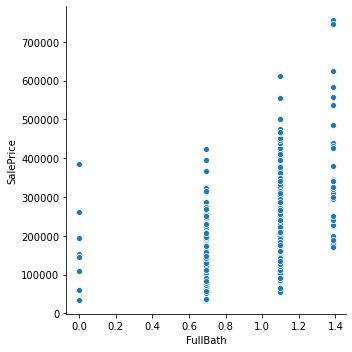

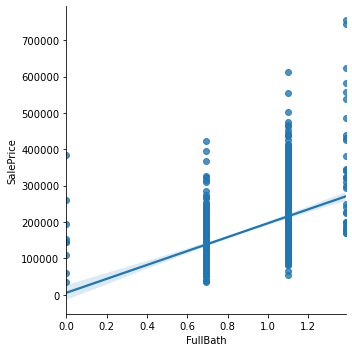

YearRemodAdd


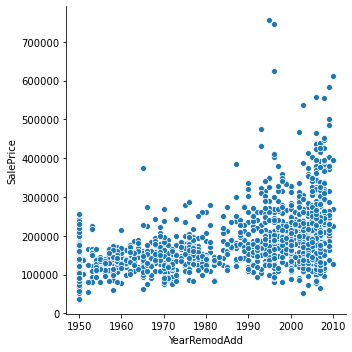

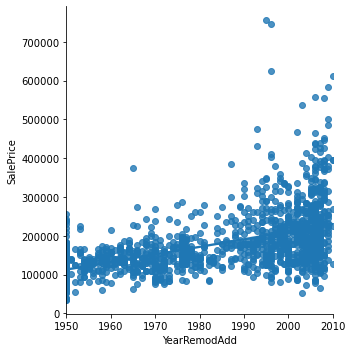

logged


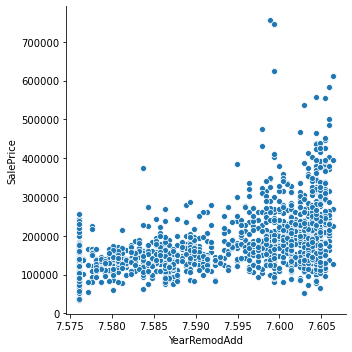

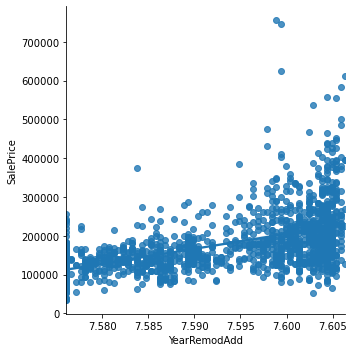

total_Ext_Ql_Cd


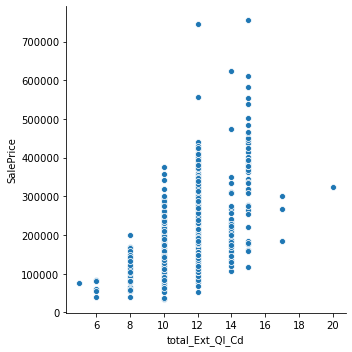

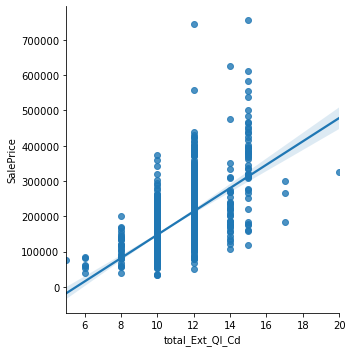

logged


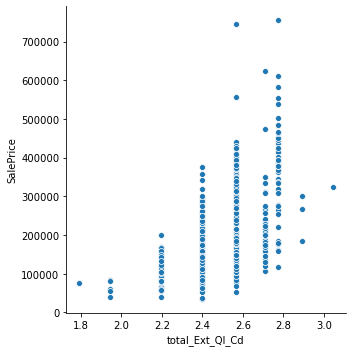

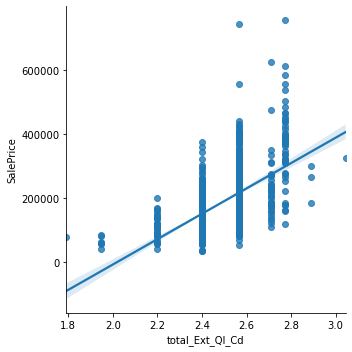

YearRemodAdd_Age


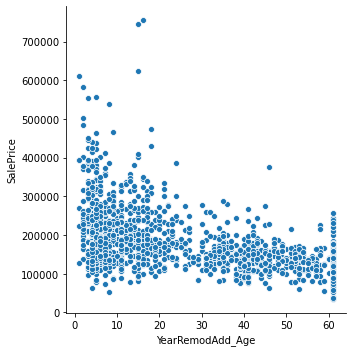

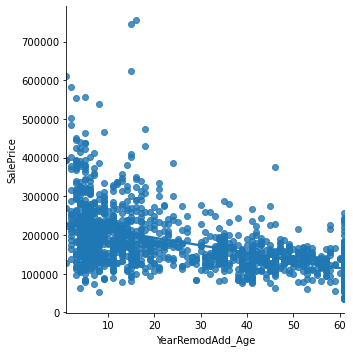

logged


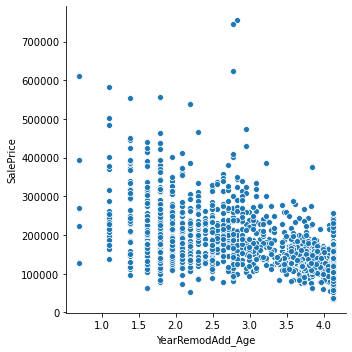

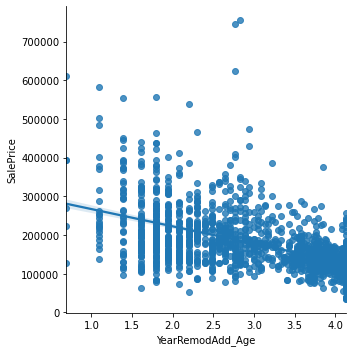

Garage_per_Car_Cap


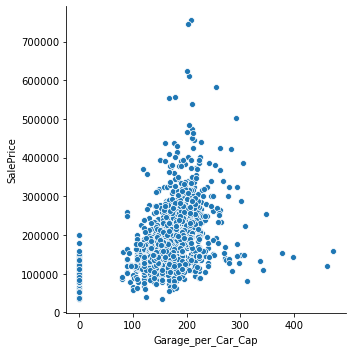

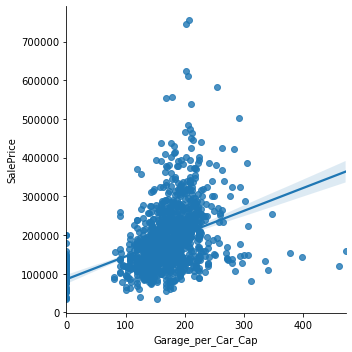

logged


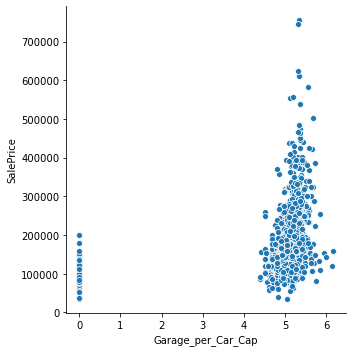

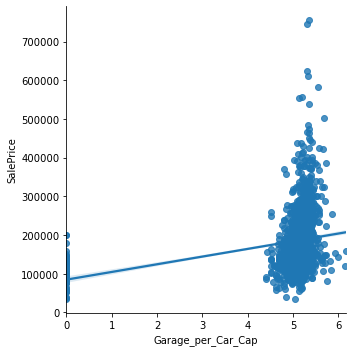

Foundation_MasVnrType


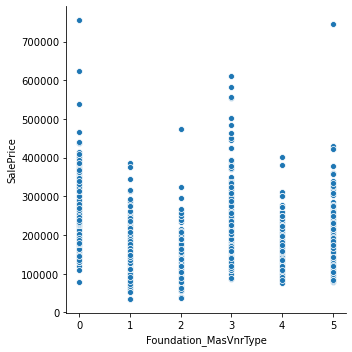

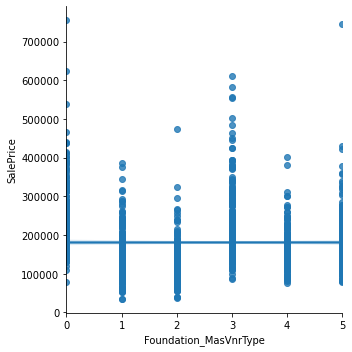

logged


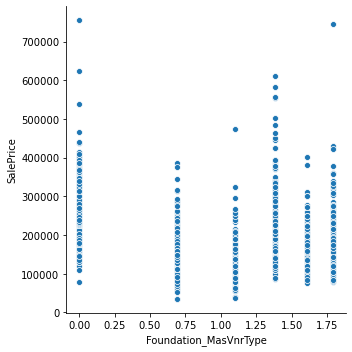

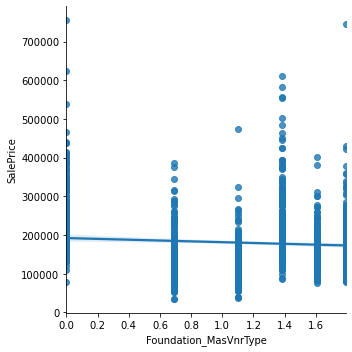

LotFrontage


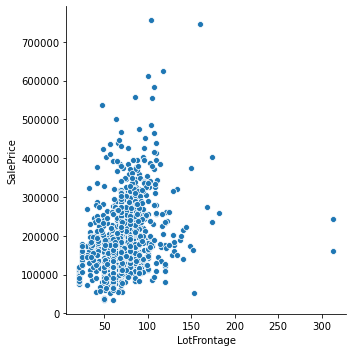

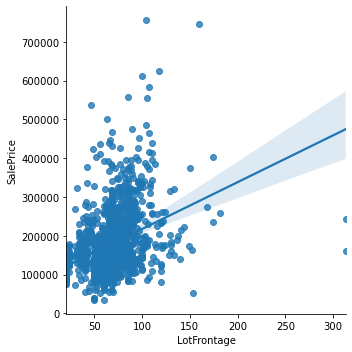

logged


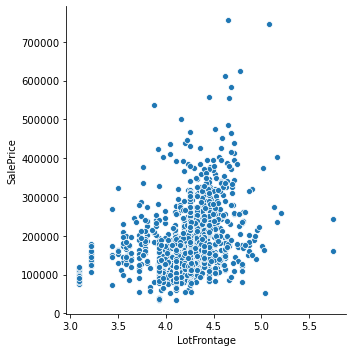

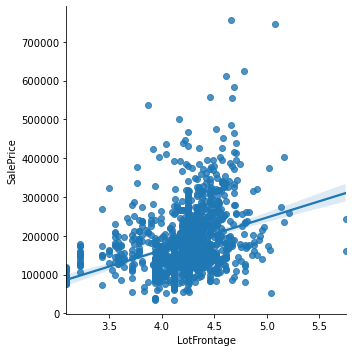

TotRmsAbvGrd


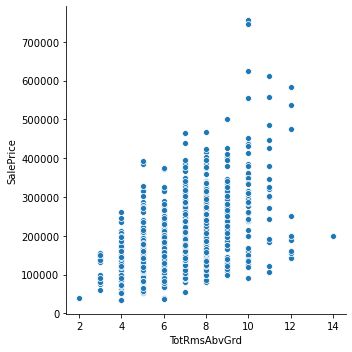

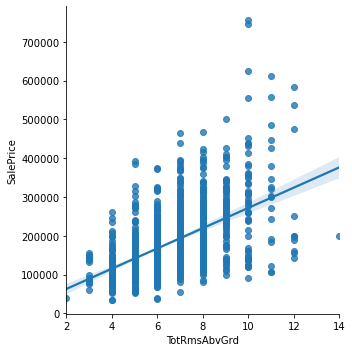

logged


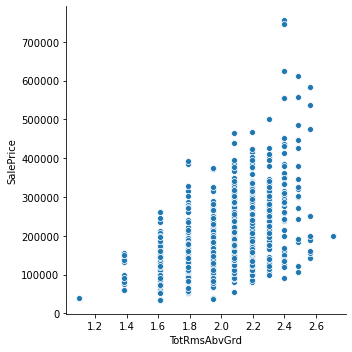

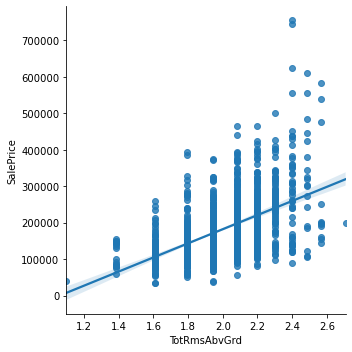

FireplaceQu


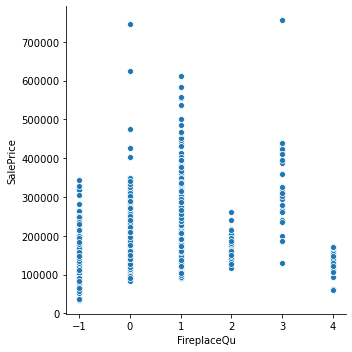

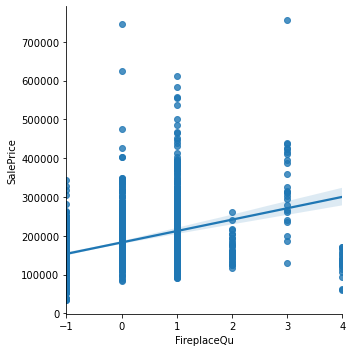

logged


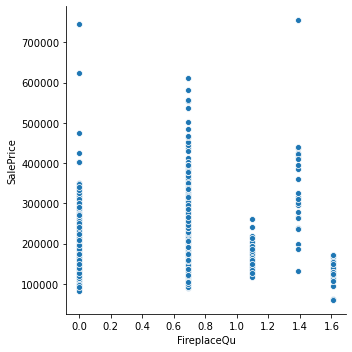

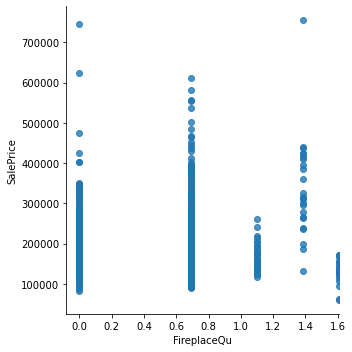

GarageType


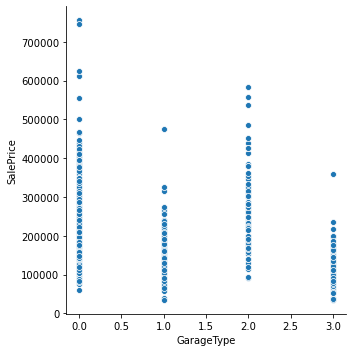

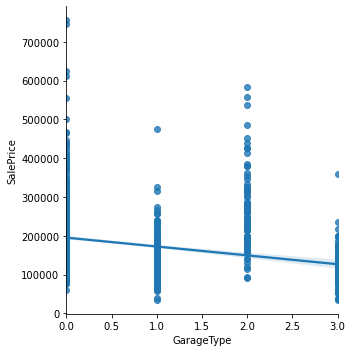

logged


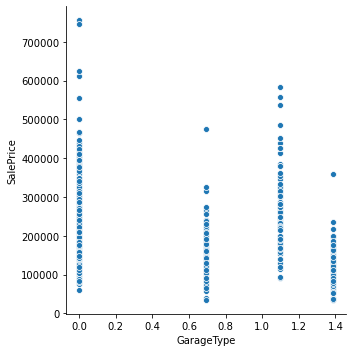

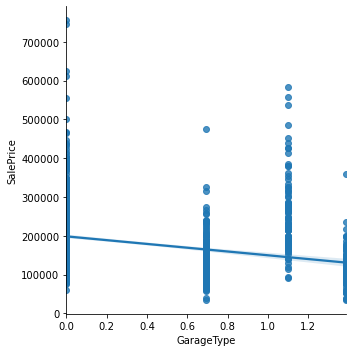

Foundation


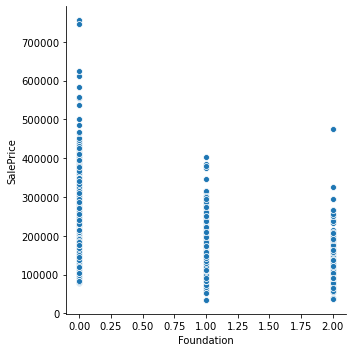

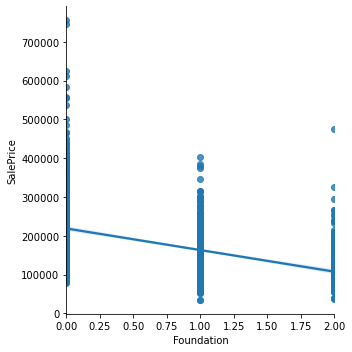

logged


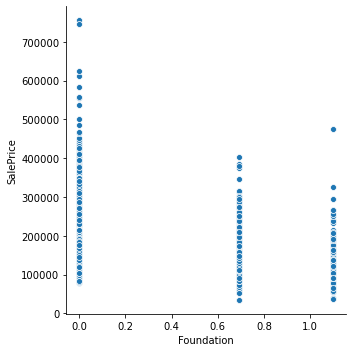

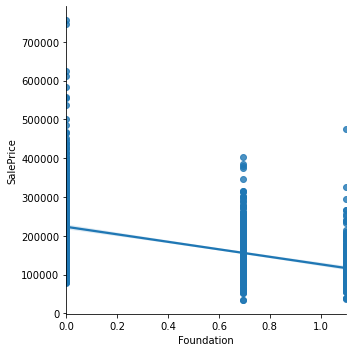

2ndFlrSF


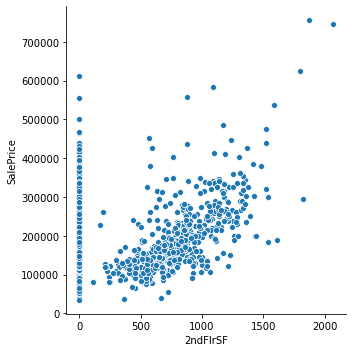

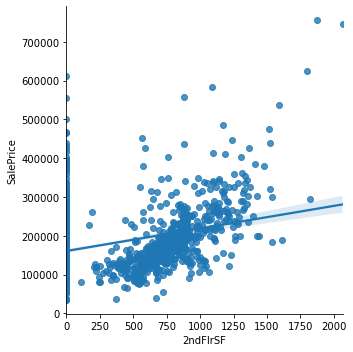

logged


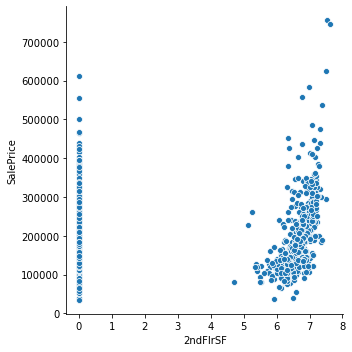

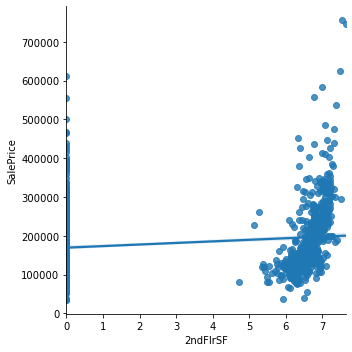

total_outdoor_sqft


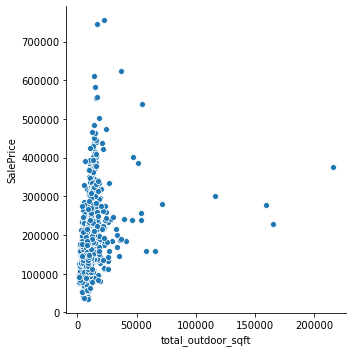

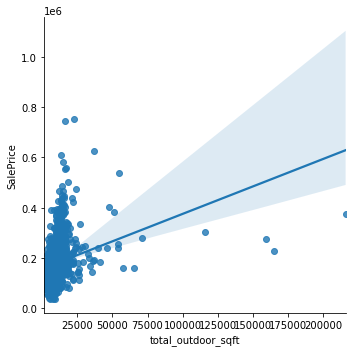

logged


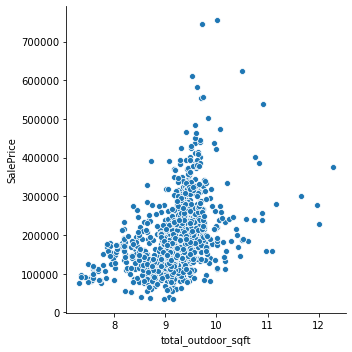

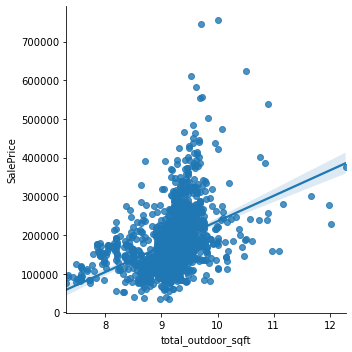

HeatingQC


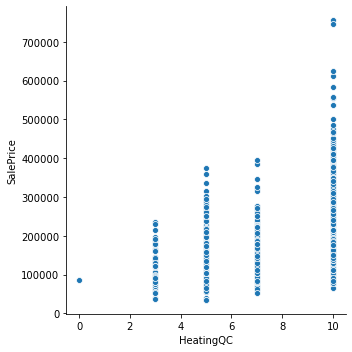

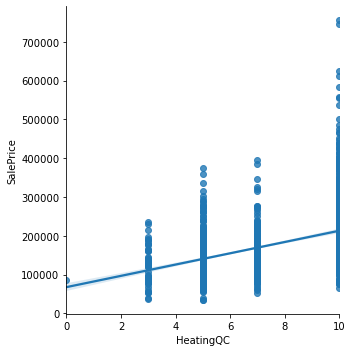

logged


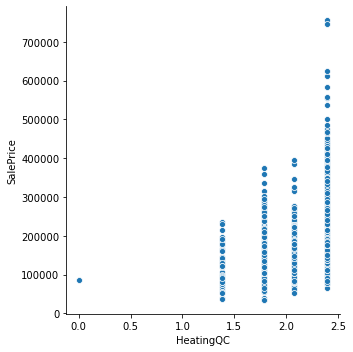

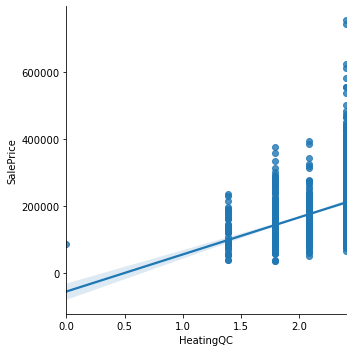

Fireplaces


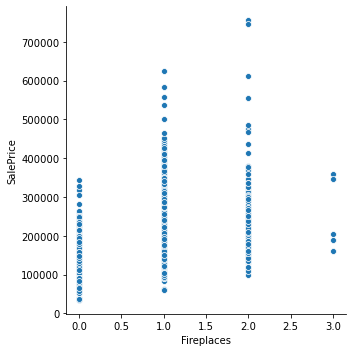

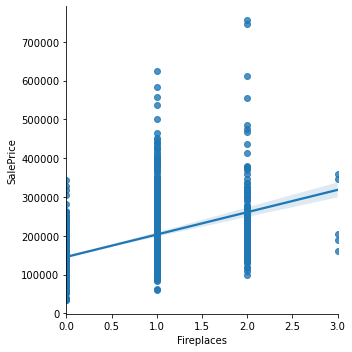

logged


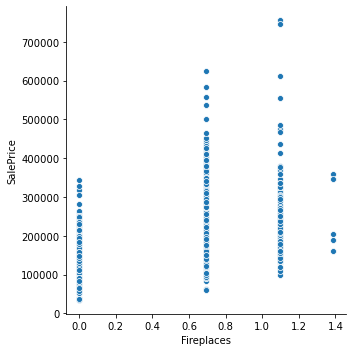

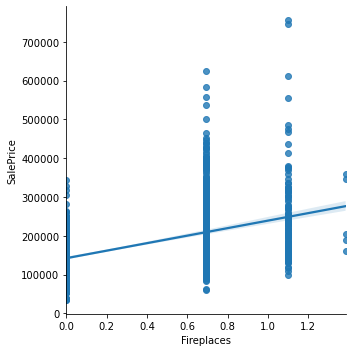

LotArea


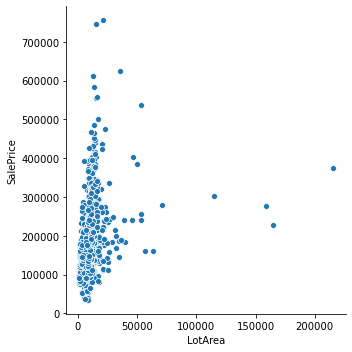

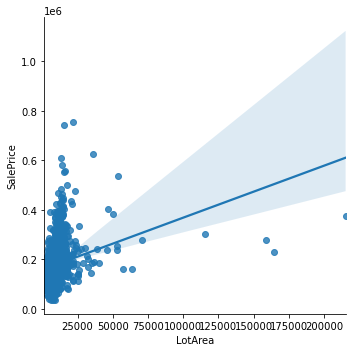

logged


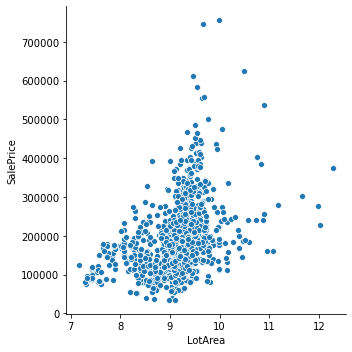

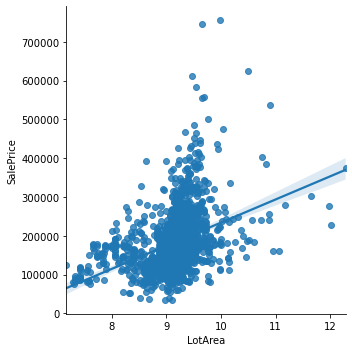

Exterior2nd


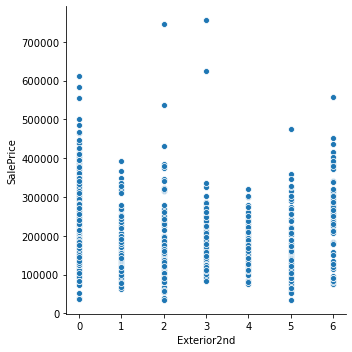

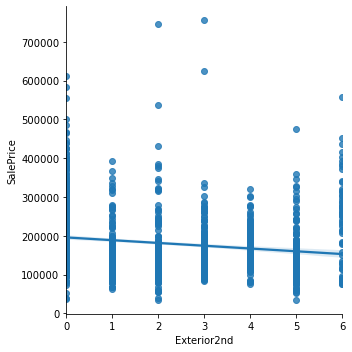

logged


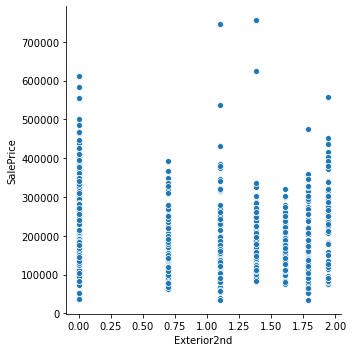

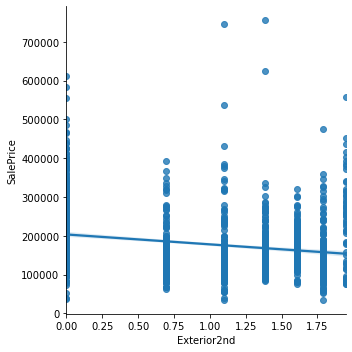

BsmtFinSF1


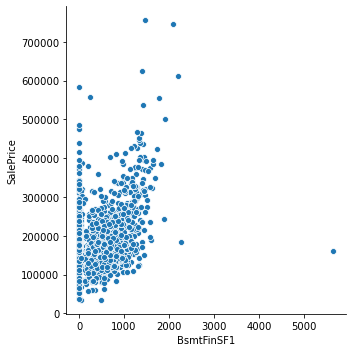

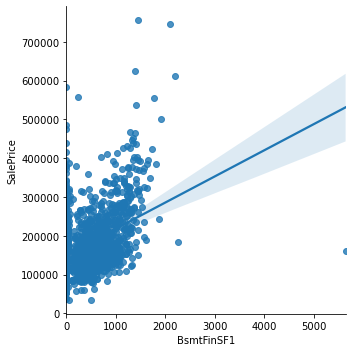

logged


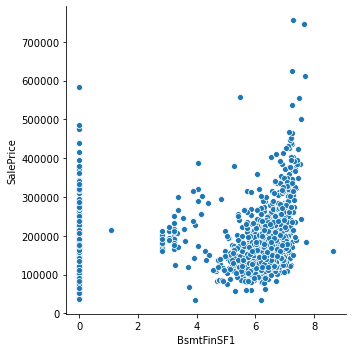

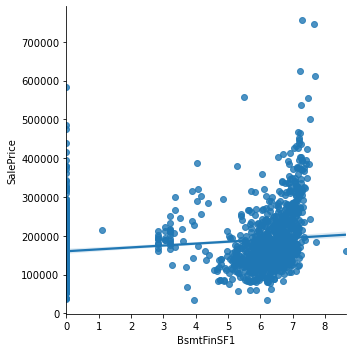

Exterior1st_Exterior2nd


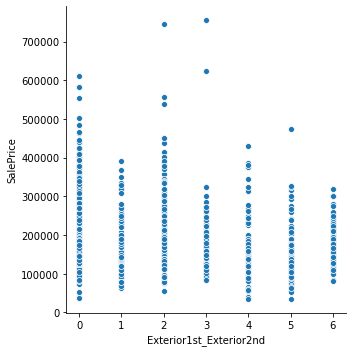

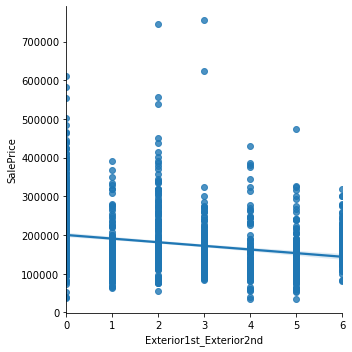

logged


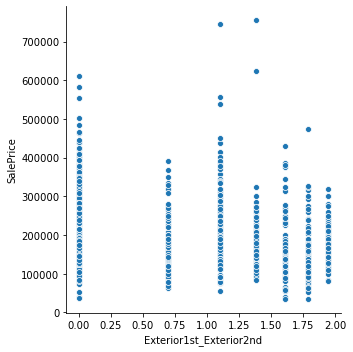

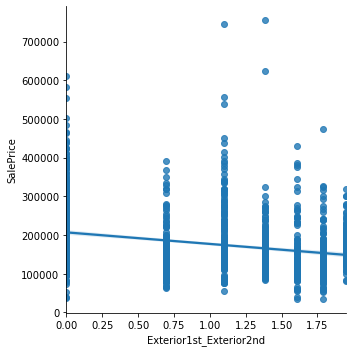

BsmtFinType1


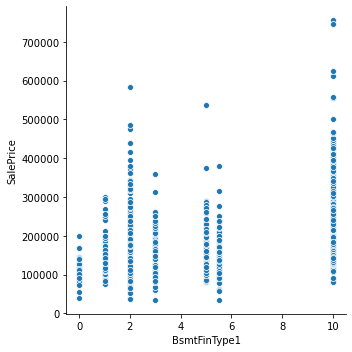

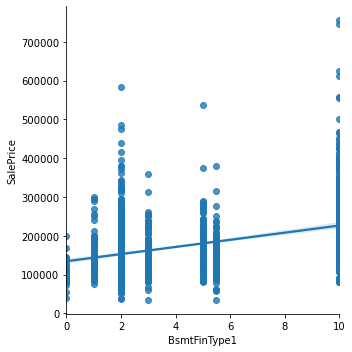

logged


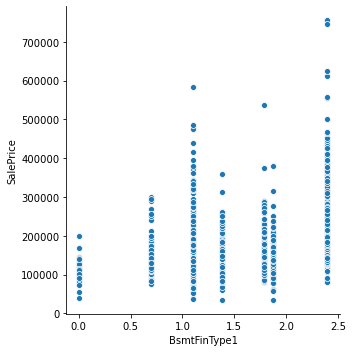

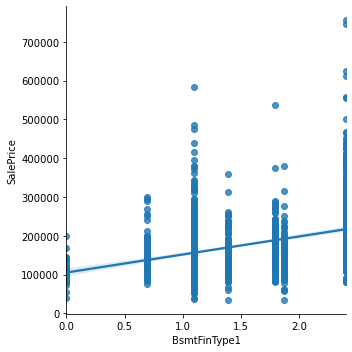

Exterior1st


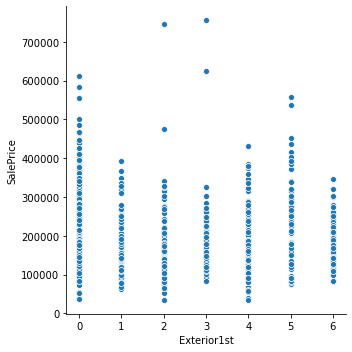

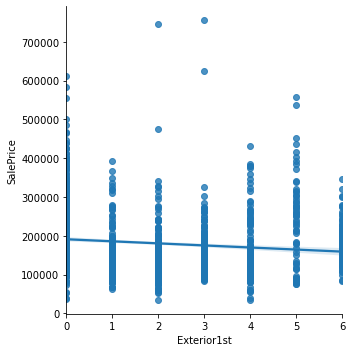

logged


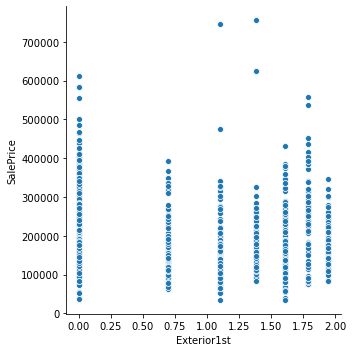

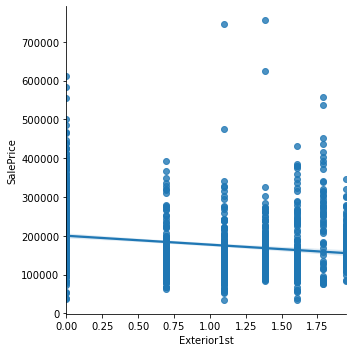

OpenPorchSF


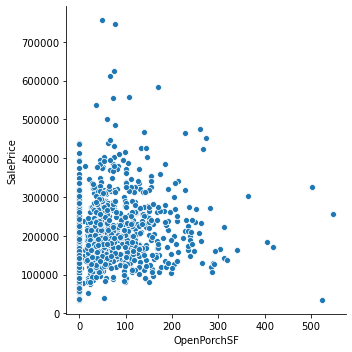

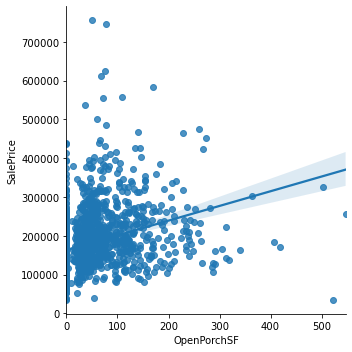

logged


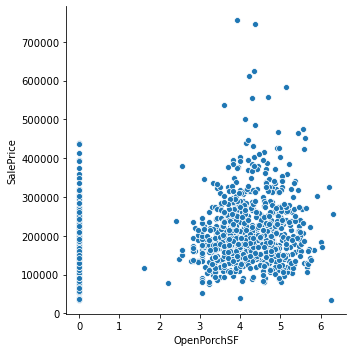

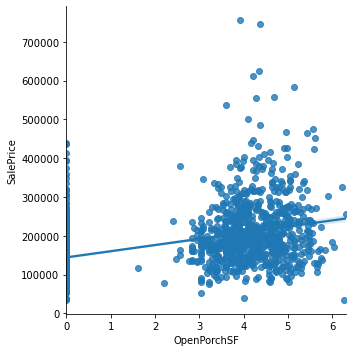

total_Bmt_Fn_Area


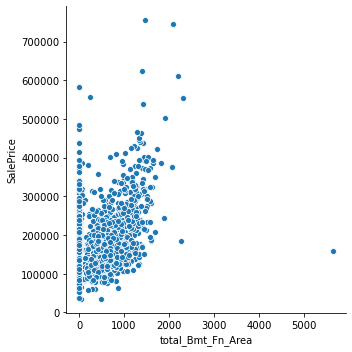

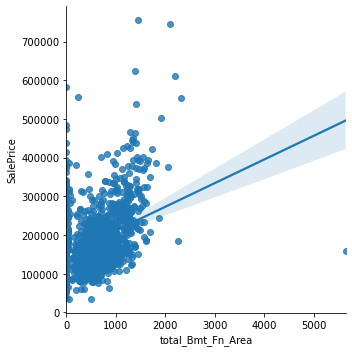

logged


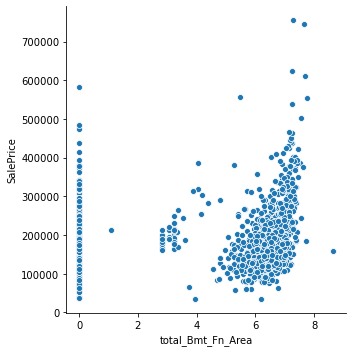

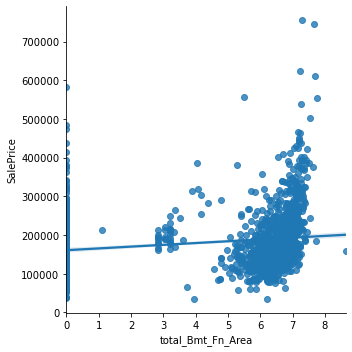

total_Porch


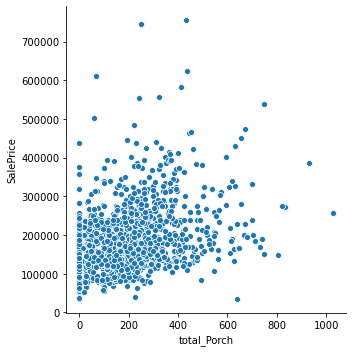

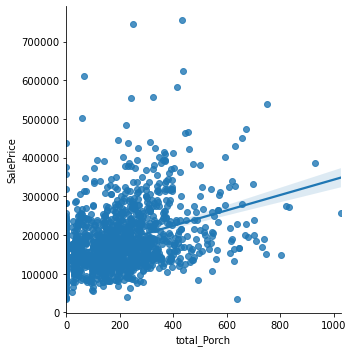

logged


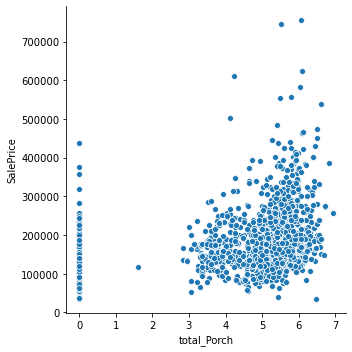

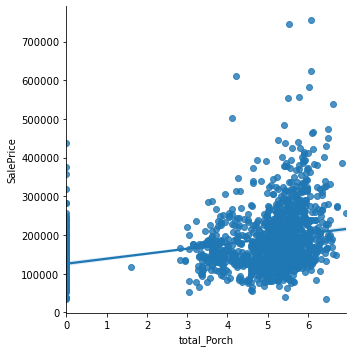

total_Max_Porch_Area


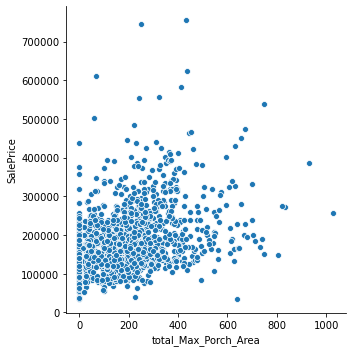

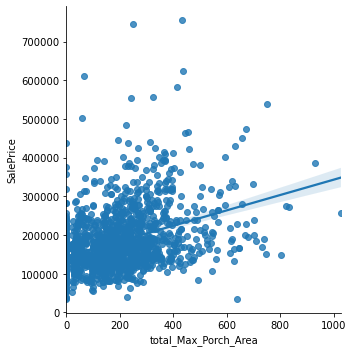

logged


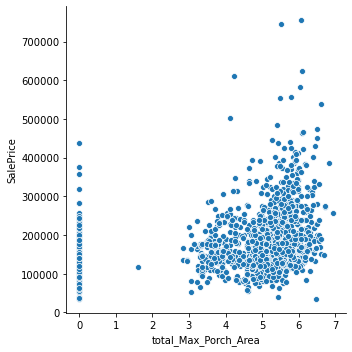

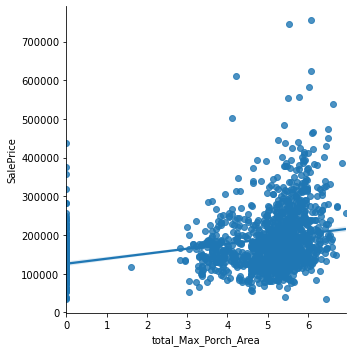

BsmtUnfSF


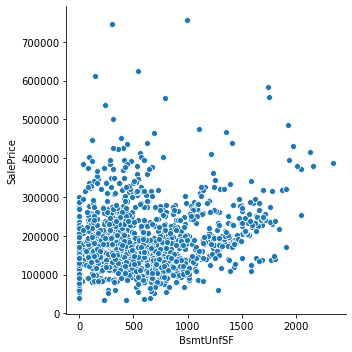

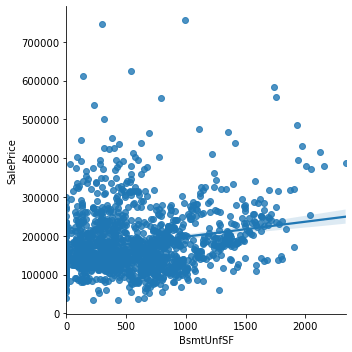

logged


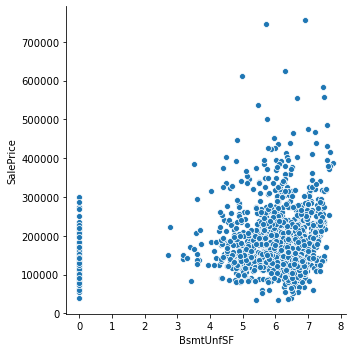

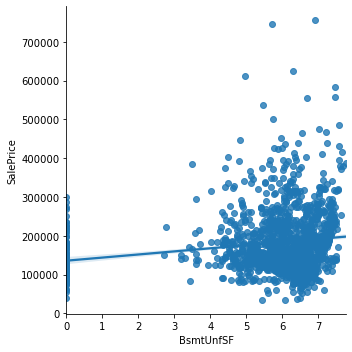

LotAreaPerFront


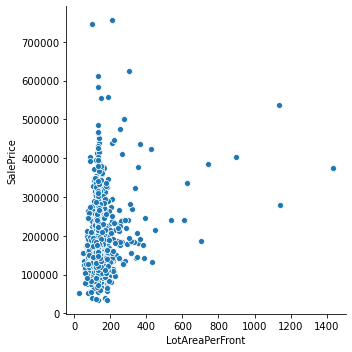

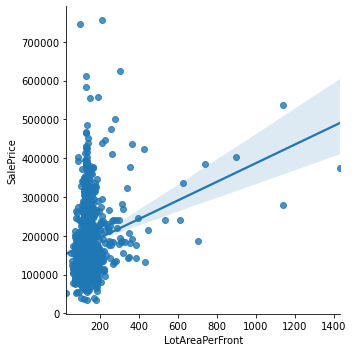

logged


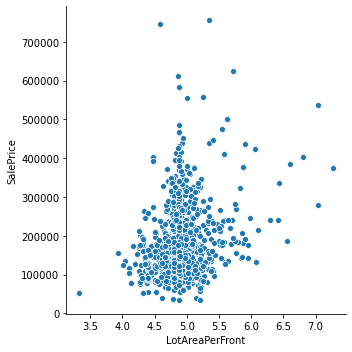

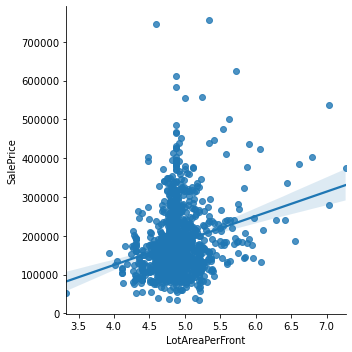

OverallCond


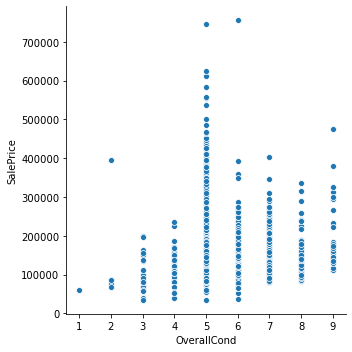

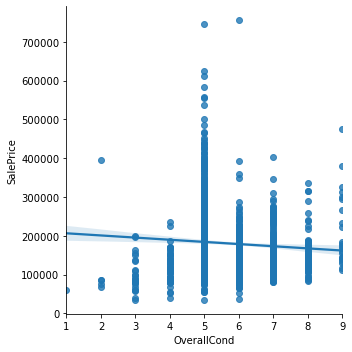

logged


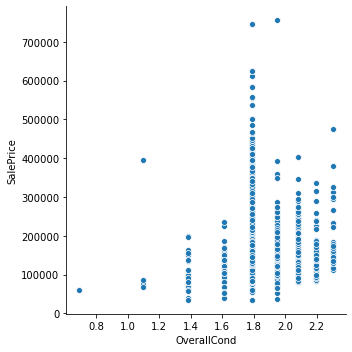

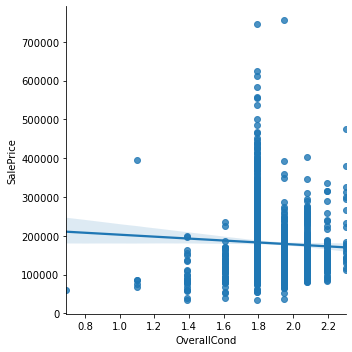

MSZoning


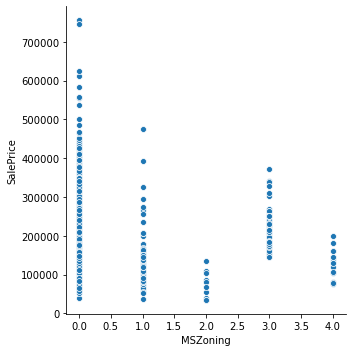

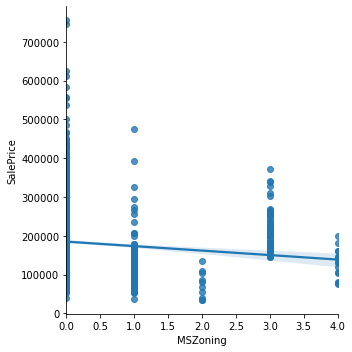

logged


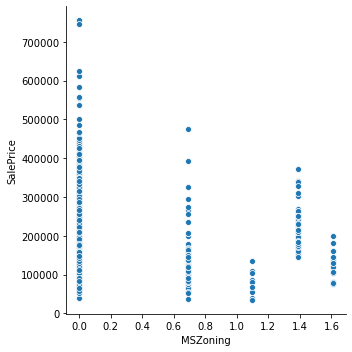

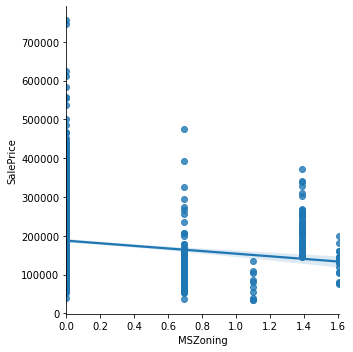

LotShape_LandContour


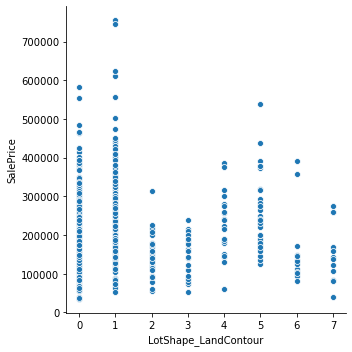

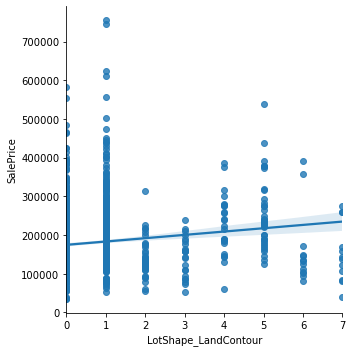

logged


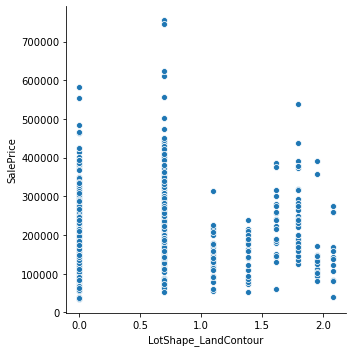

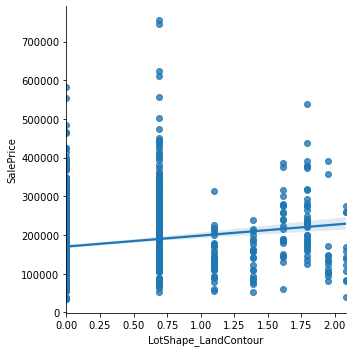

in_per_out


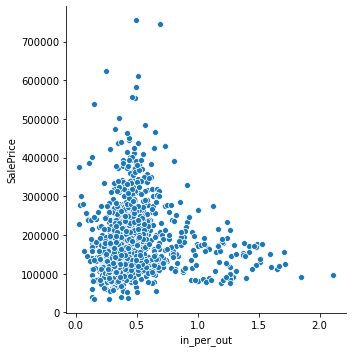

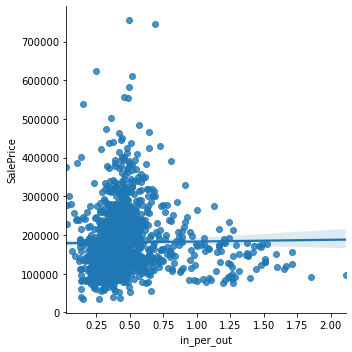

logged


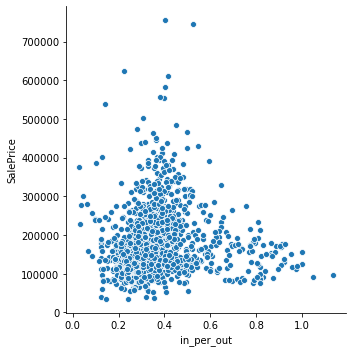

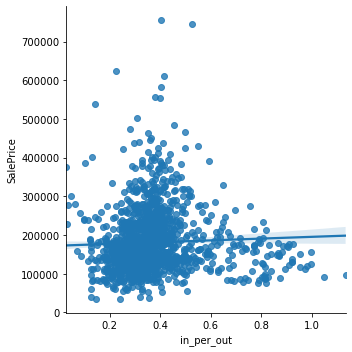

PorchTypes


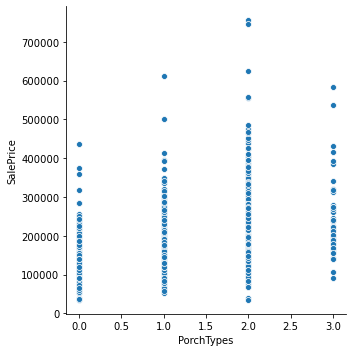

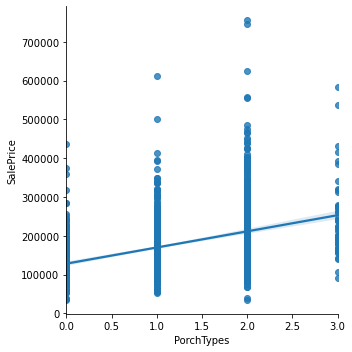

logged


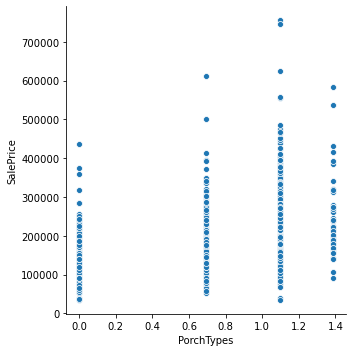

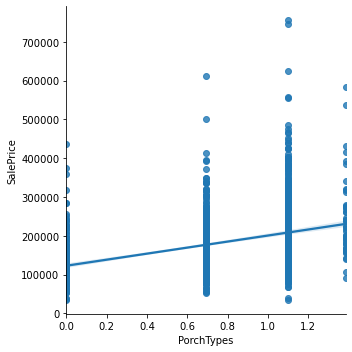

WoodDeckSF


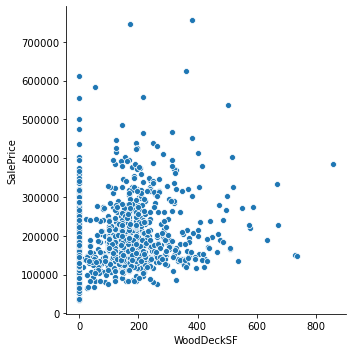

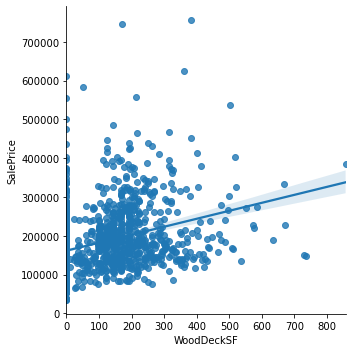

logged


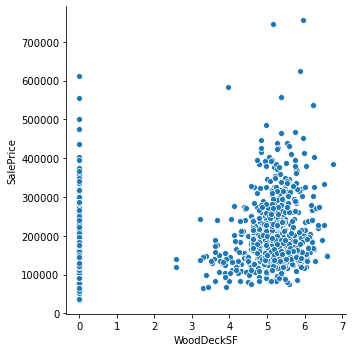

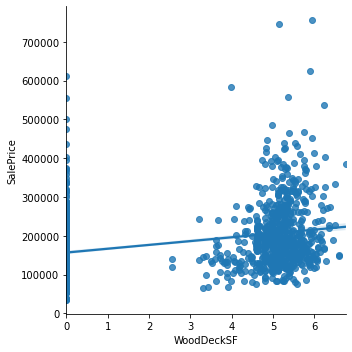

MasVnrType


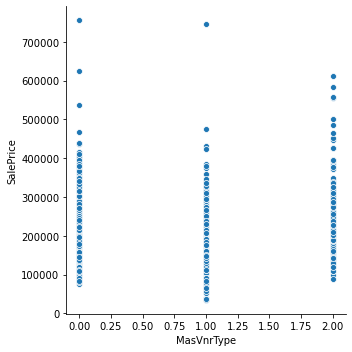

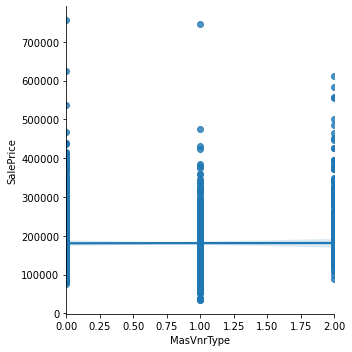

logged


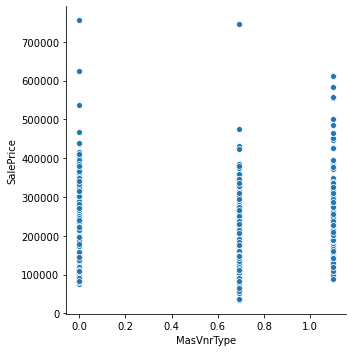

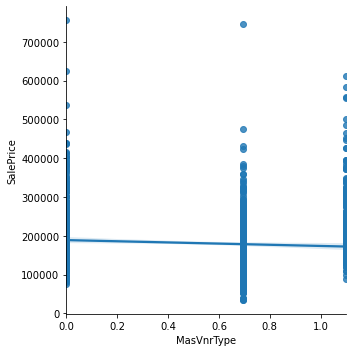

SaleCondition_SaleType


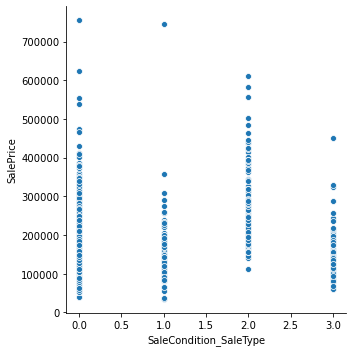

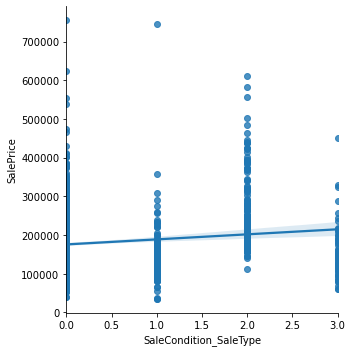

logged


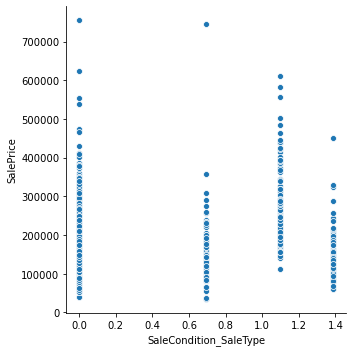

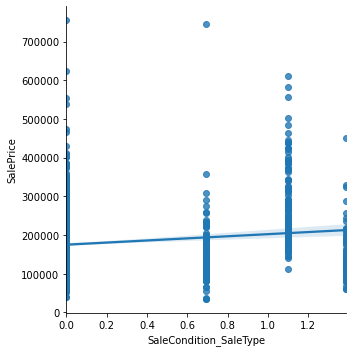

LotShape


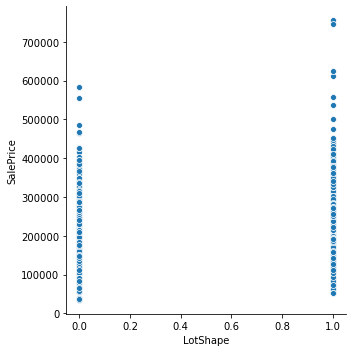

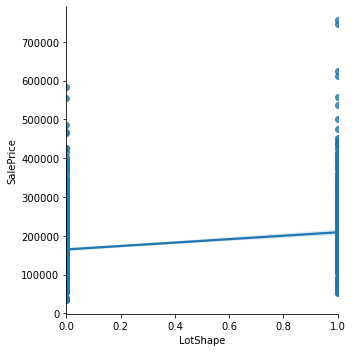

logged


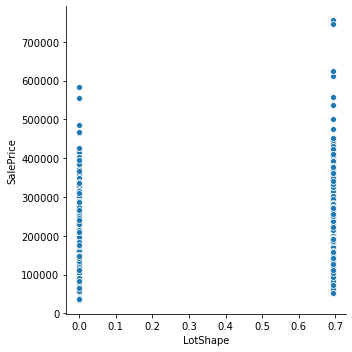

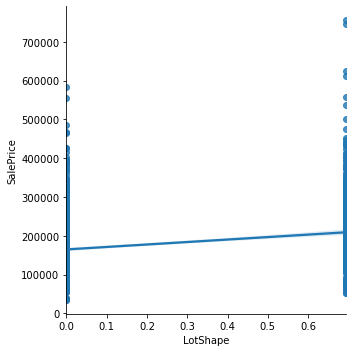

LotShape_LandSlope


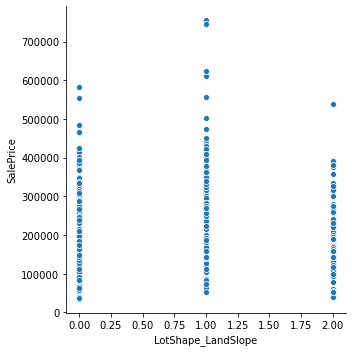

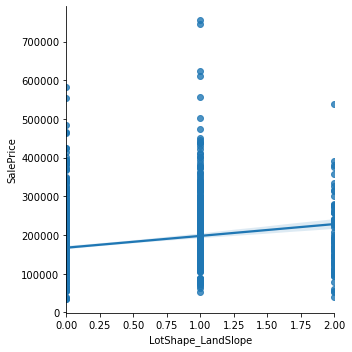

logged


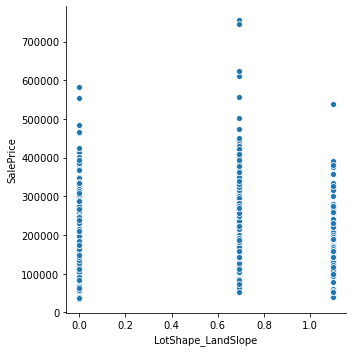

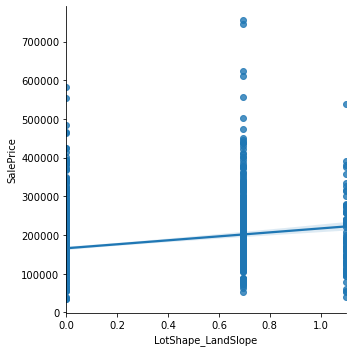

MasVnrArea


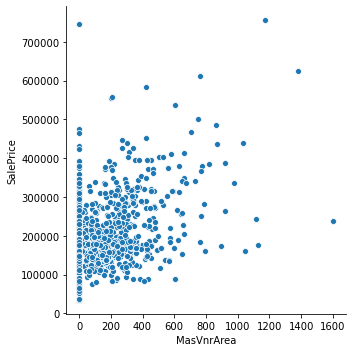

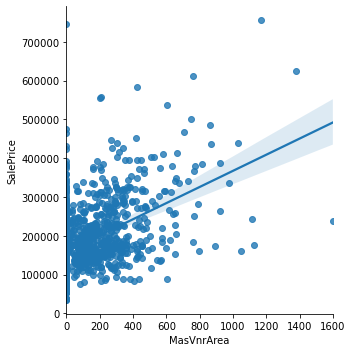

logged


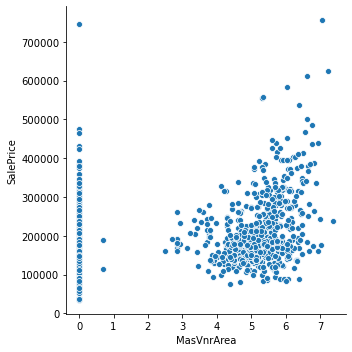

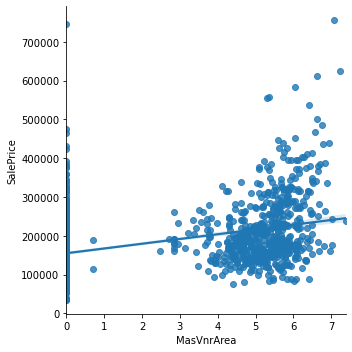

LivLotRatio


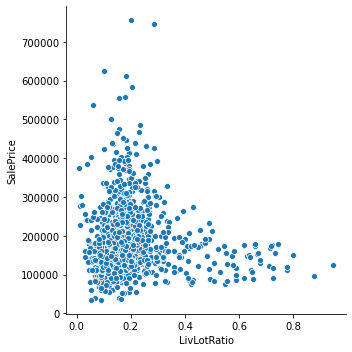

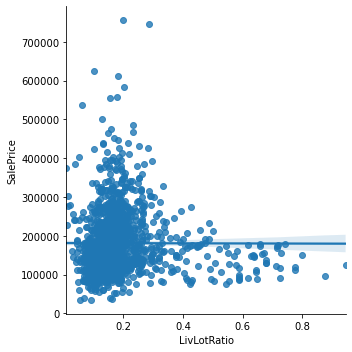

logged


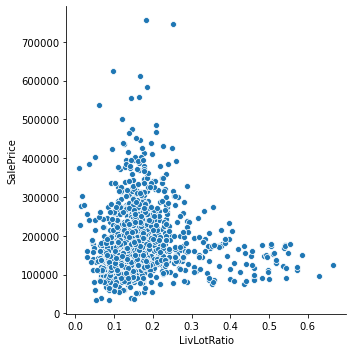

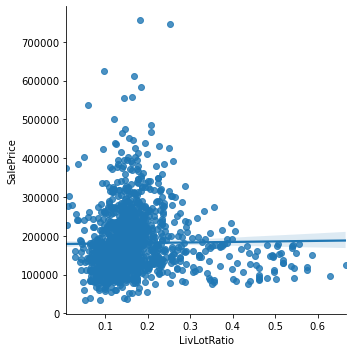

SaleType


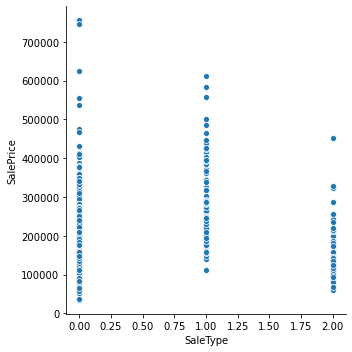

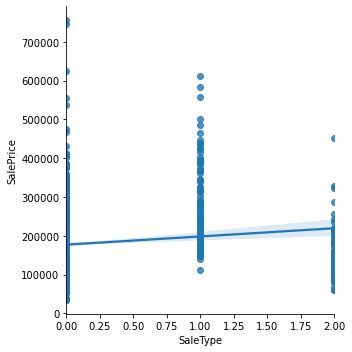

logged


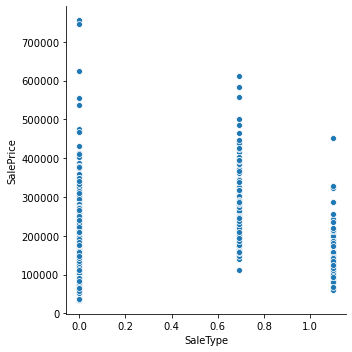

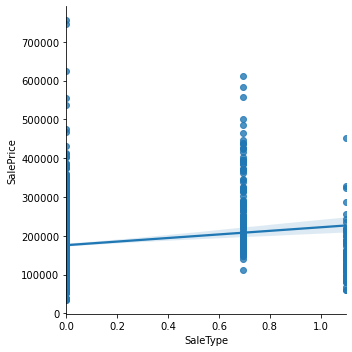

HalfBath


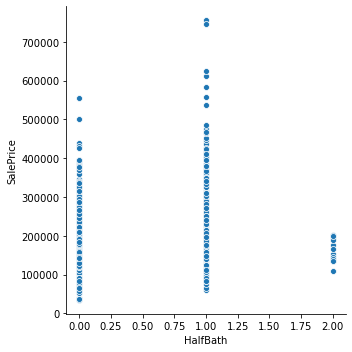

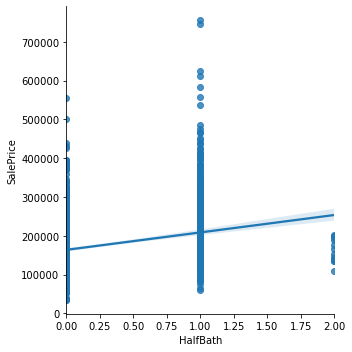

logged


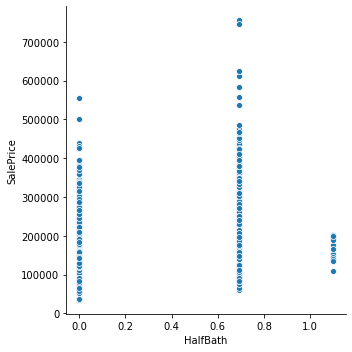

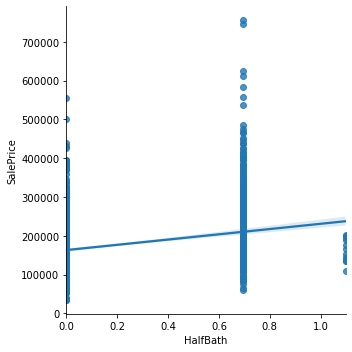

GarageCond


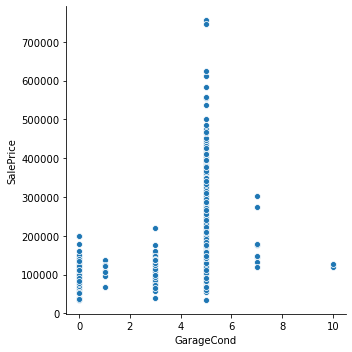

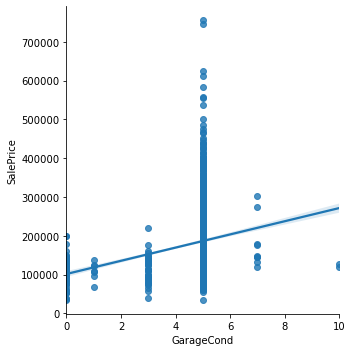

logged


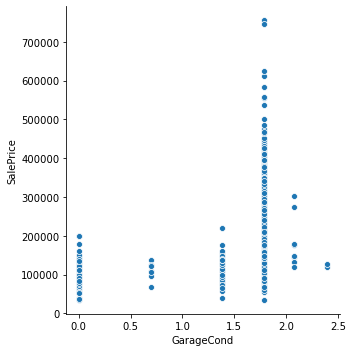

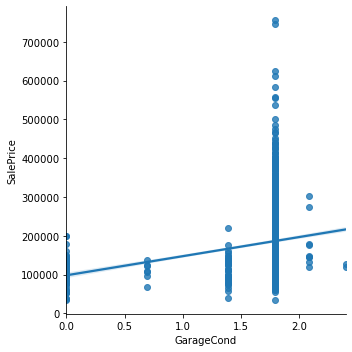

HouseStyle


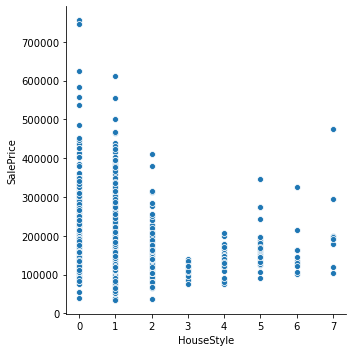

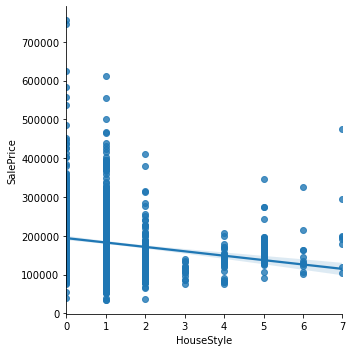

logged


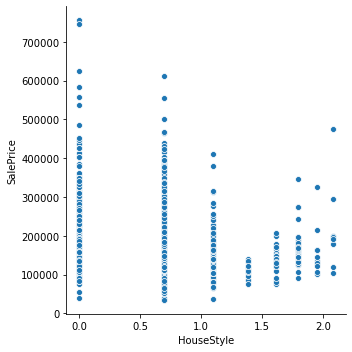

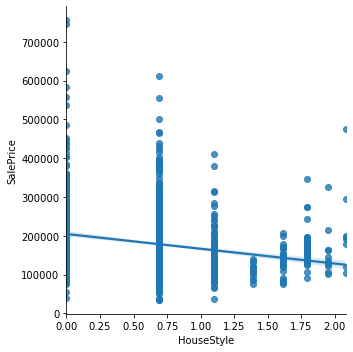

CentralAir


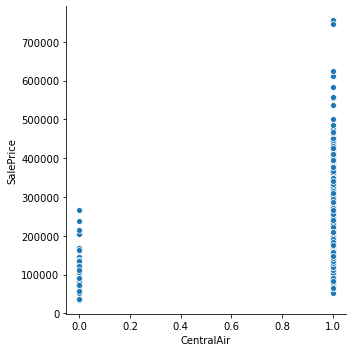

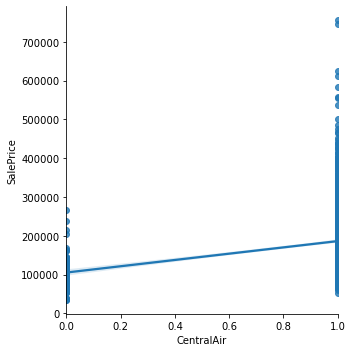

logged


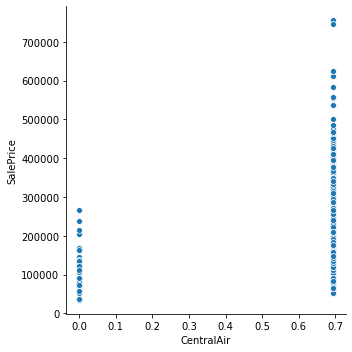

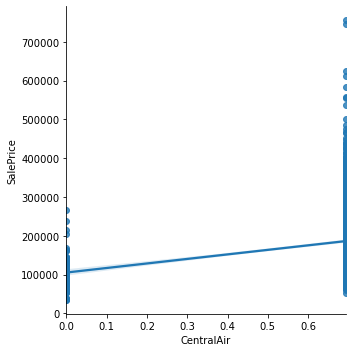

BedroomAbvGr


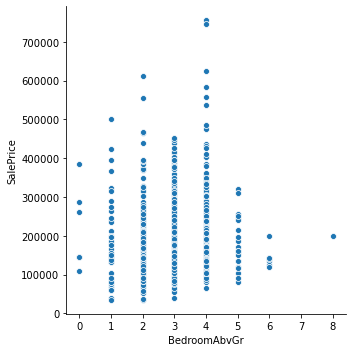

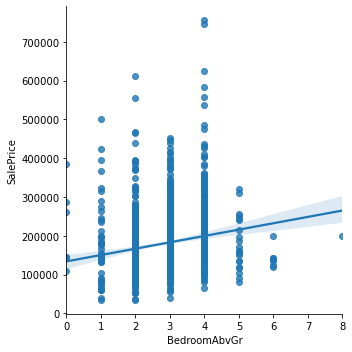

logged


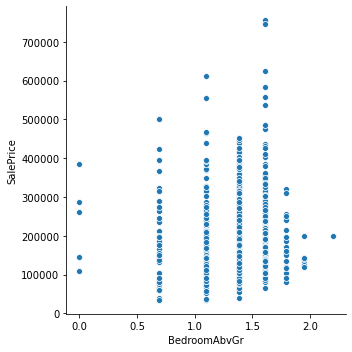

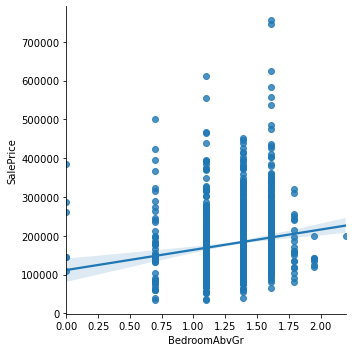

GarageQual


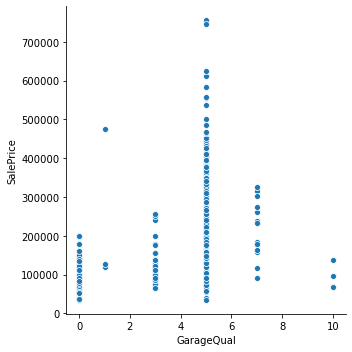

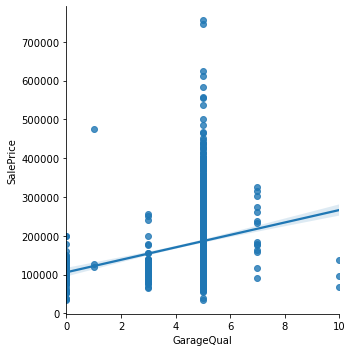

logged


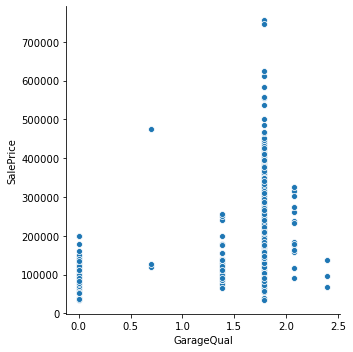

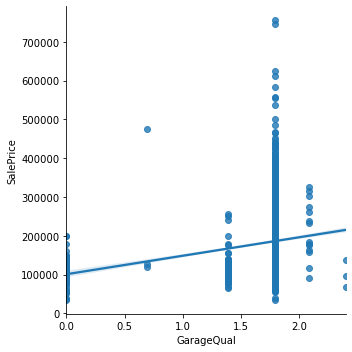

YrBlt_YrRmd_Diff


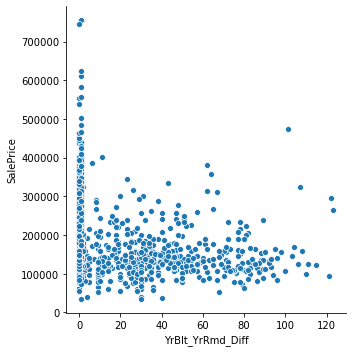

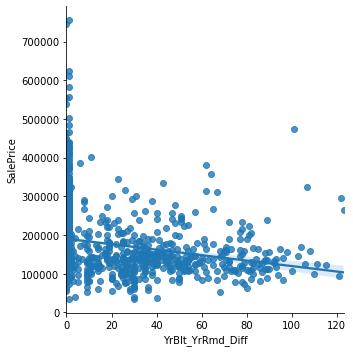

logged


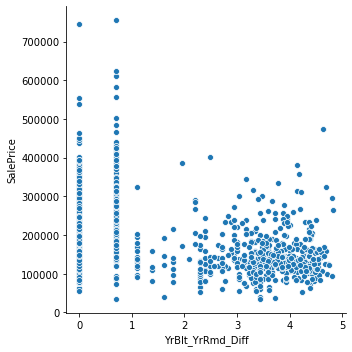

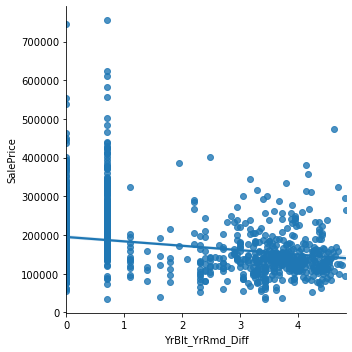

SaleCondition


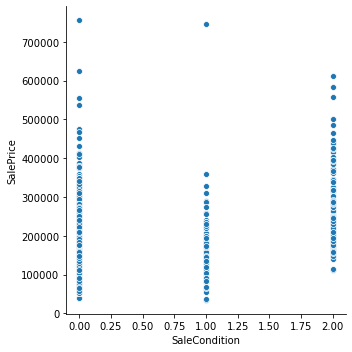

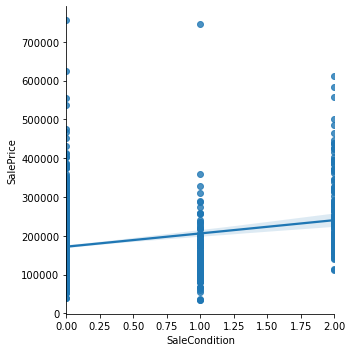

logged


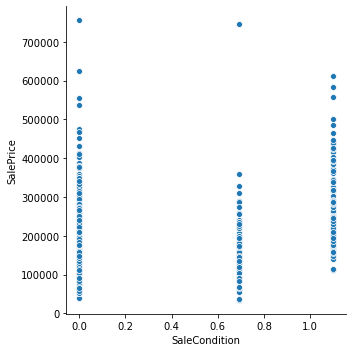

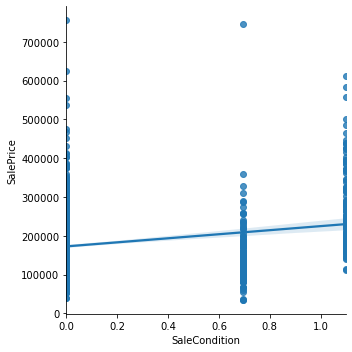

BsmtExposure


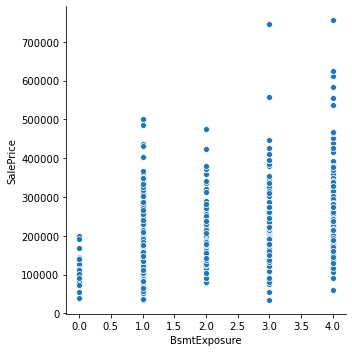

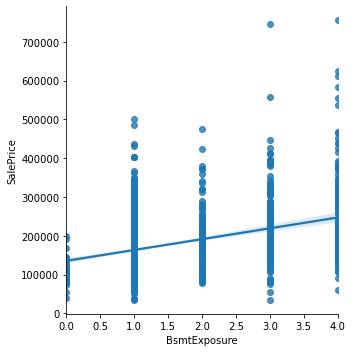

logged


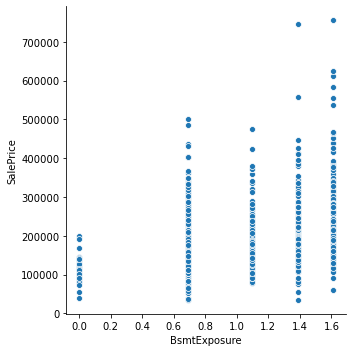

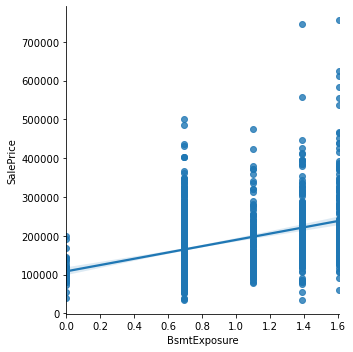

LotShape_LotConfig


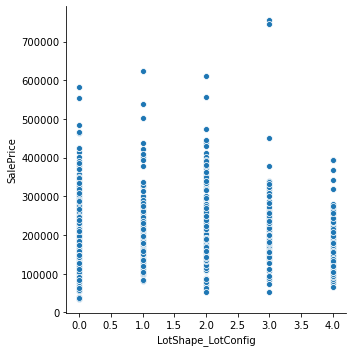

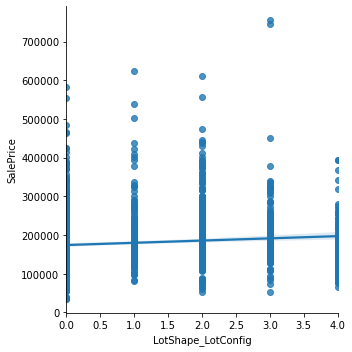

logged


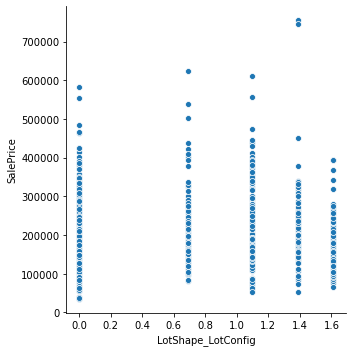

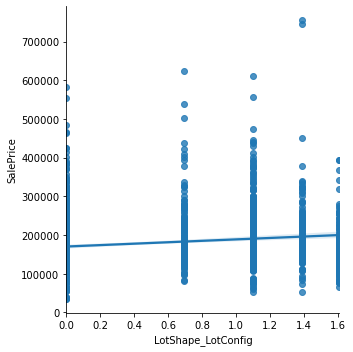

house_story


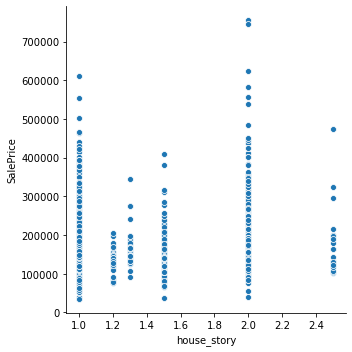

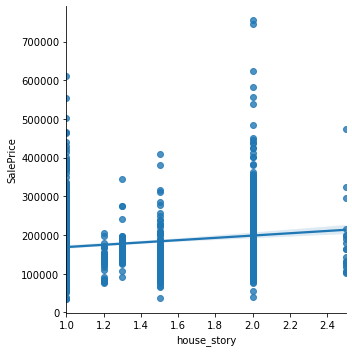

logged


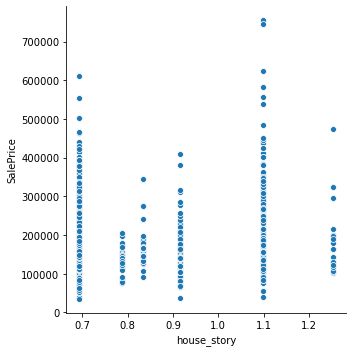

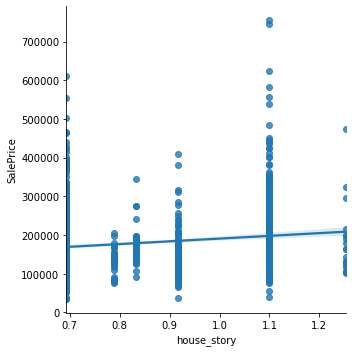

PavedDrive


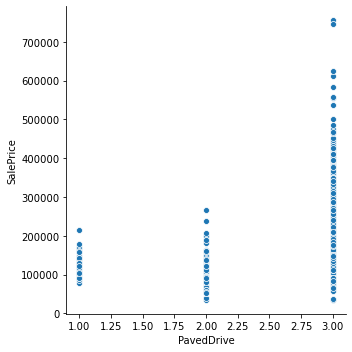

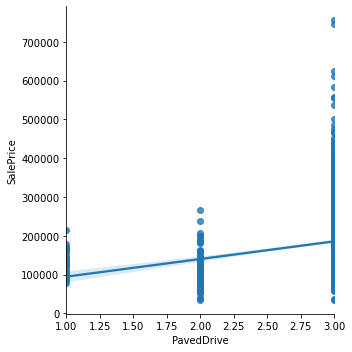

logged


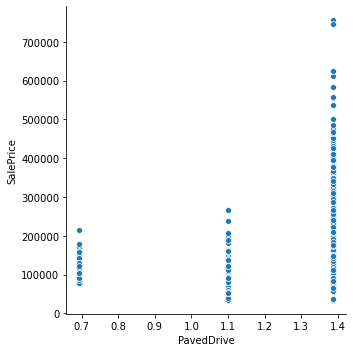

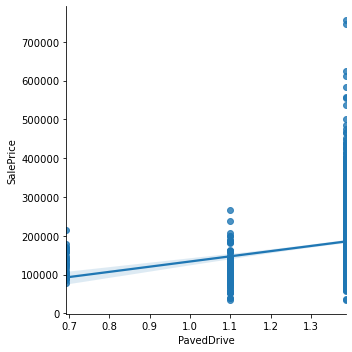

Bsmt_Unf_Per


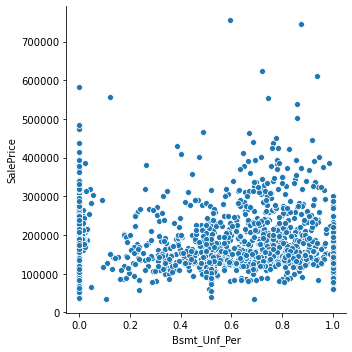

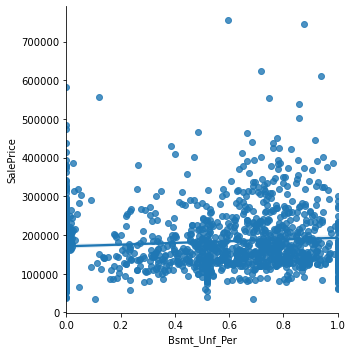

logged


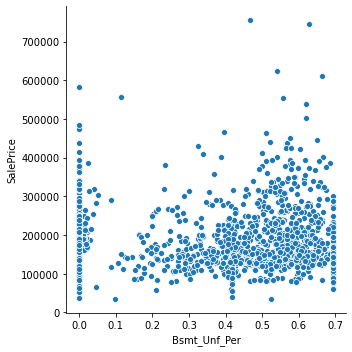

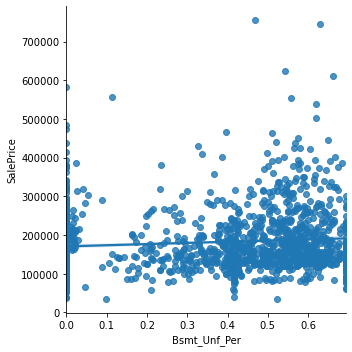

Bsmt_Fsh_Per


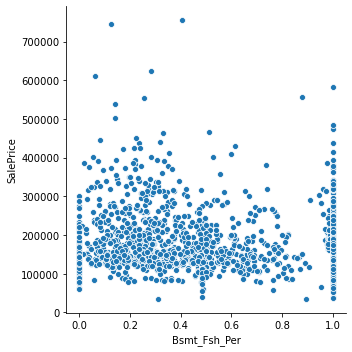

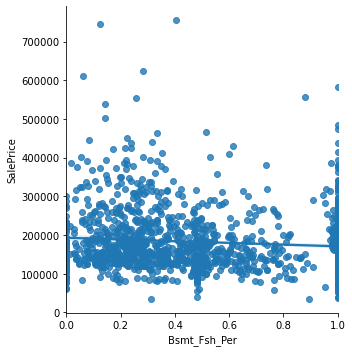

logged


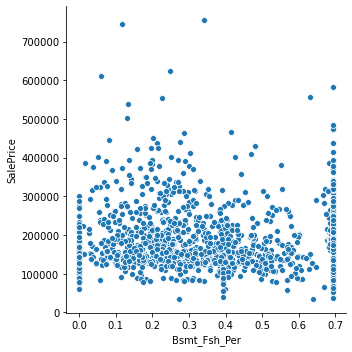

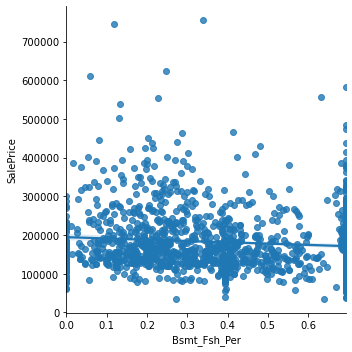

BsmtCond


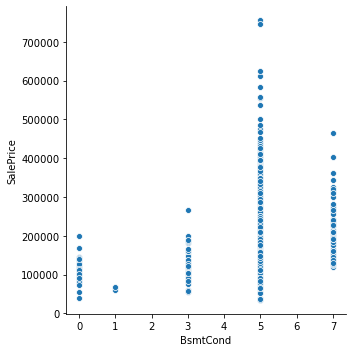

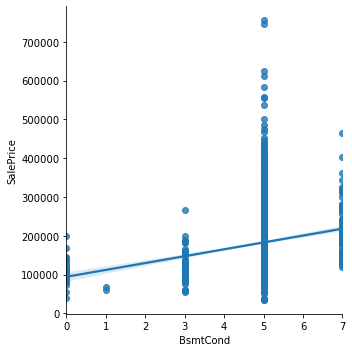

logged


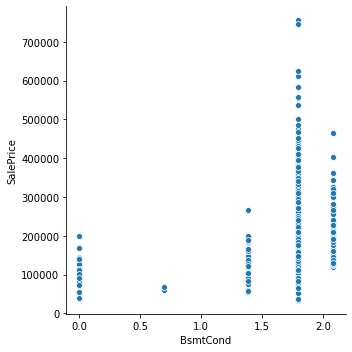

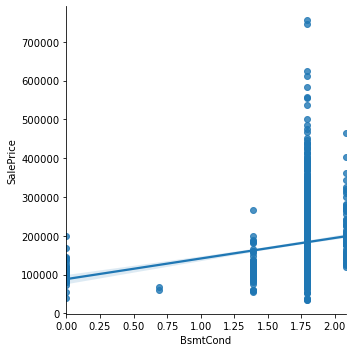

BldgType


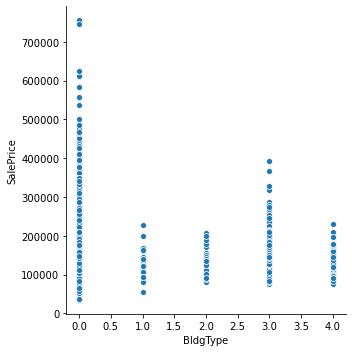

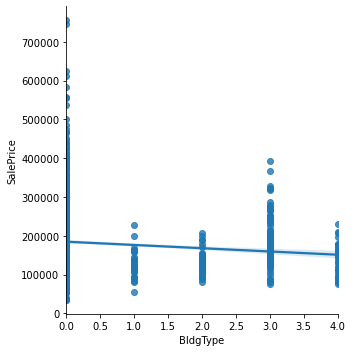

logged


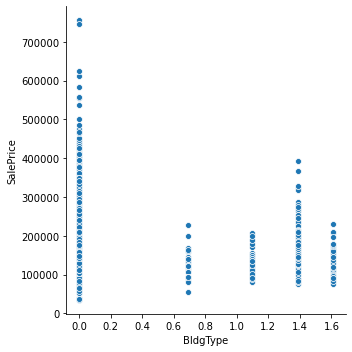

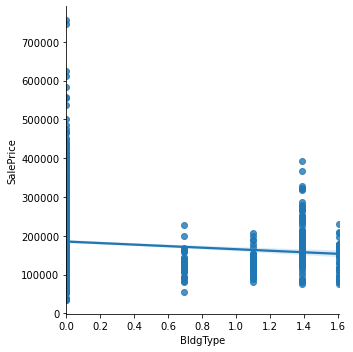

Electrical


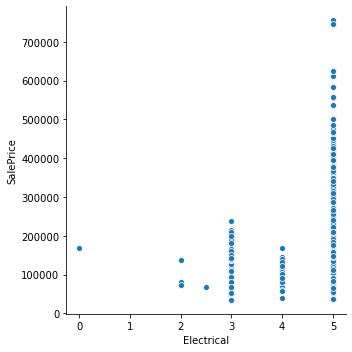

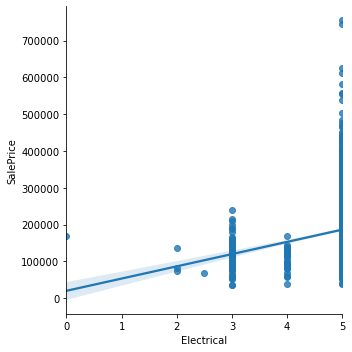

logged


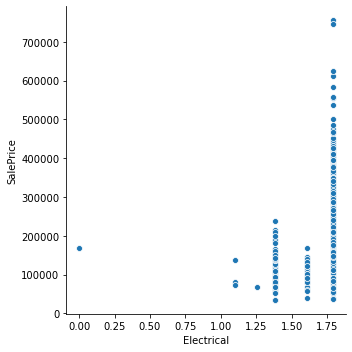

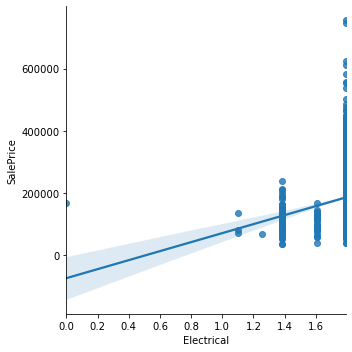

Fence


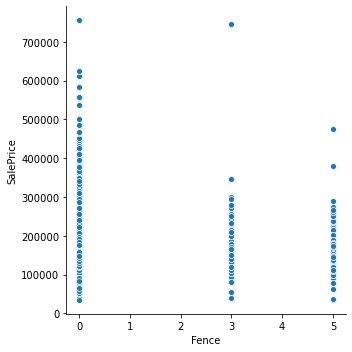

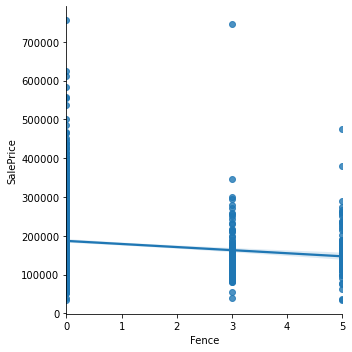

logged


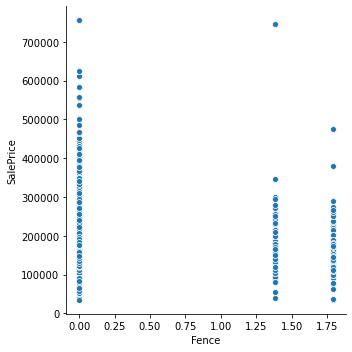

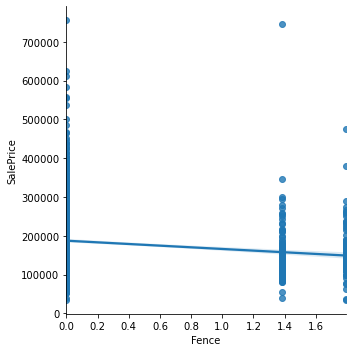

BsmtFinType2


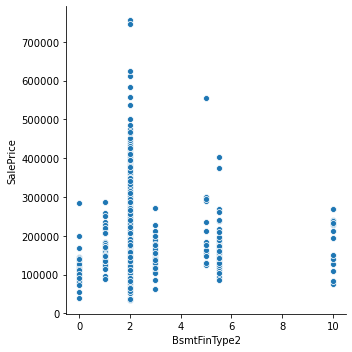

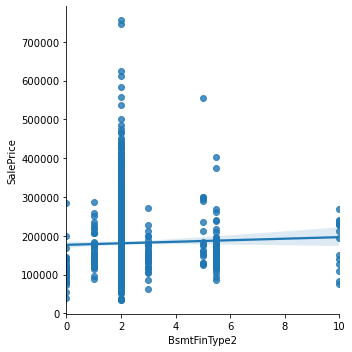

logged


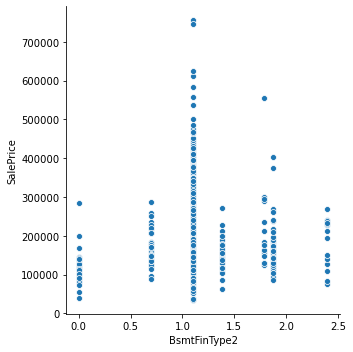

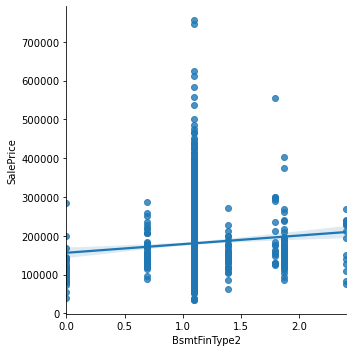

KitchenAbvGr


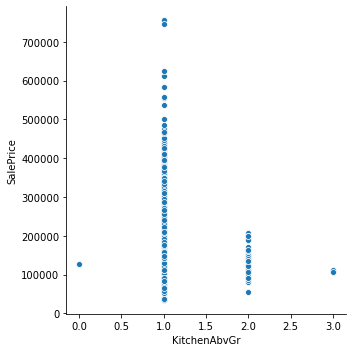

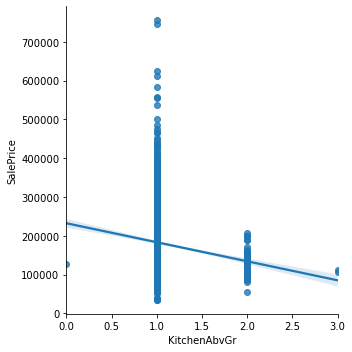

logged


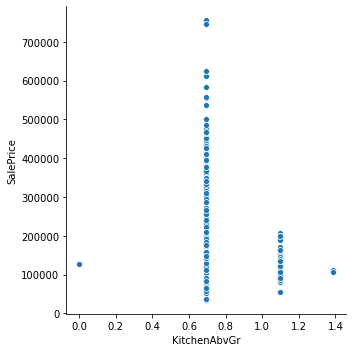

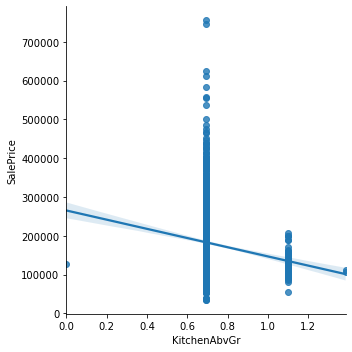

LandContour


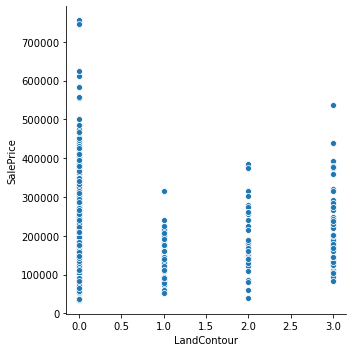

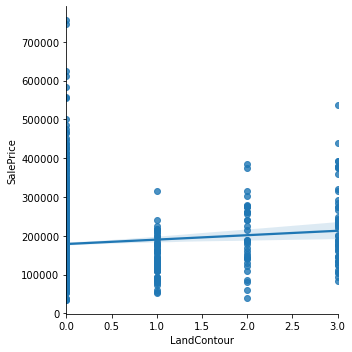

logged


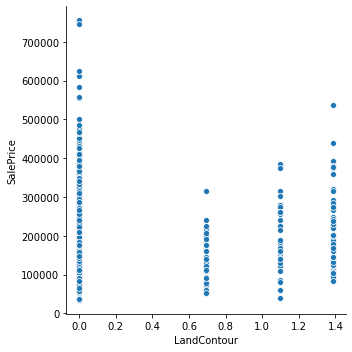

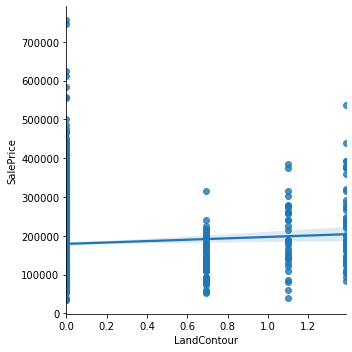

Condition1


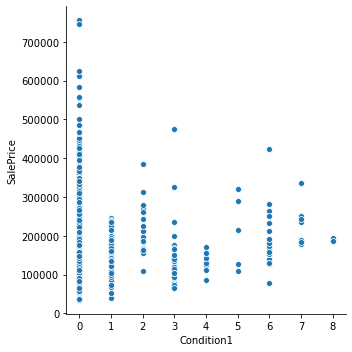

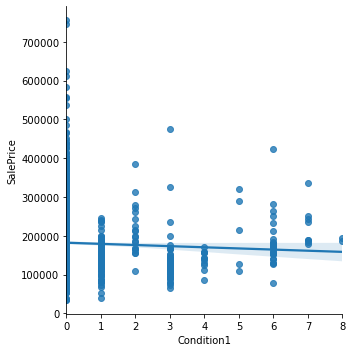

logged


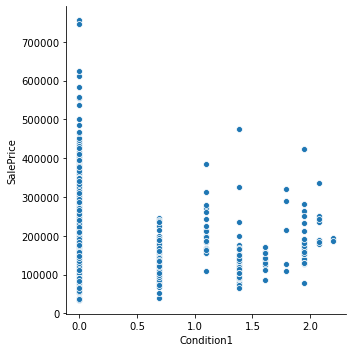

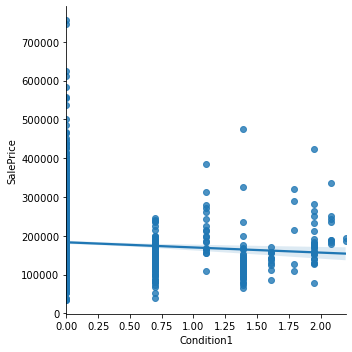

ExterCond


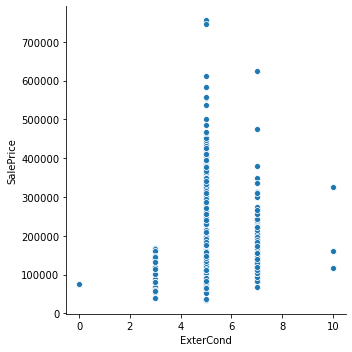

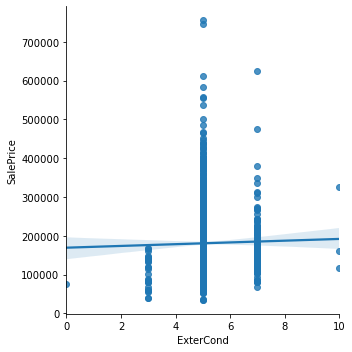

logged


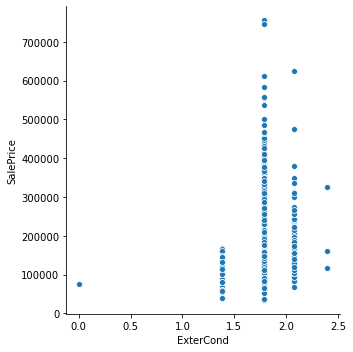

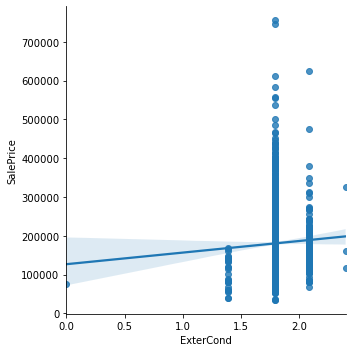

RoofStyle


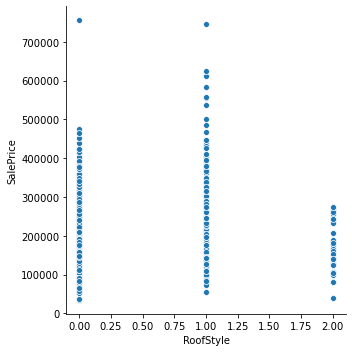

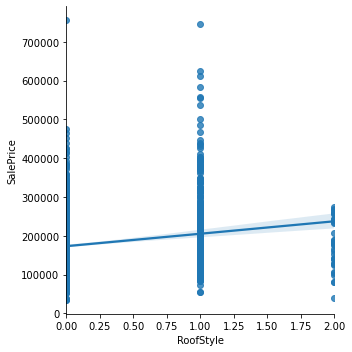

logged


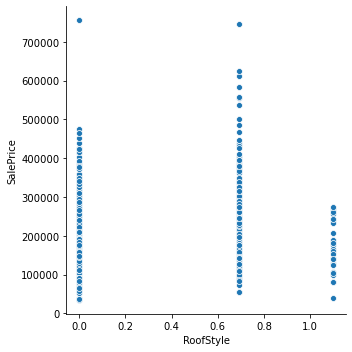

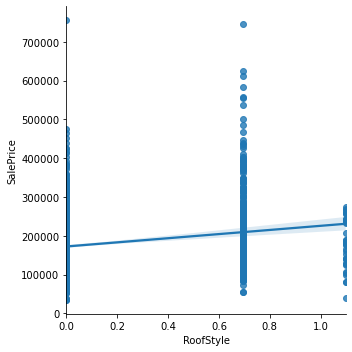

house_finish


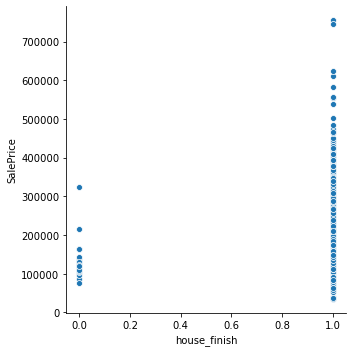

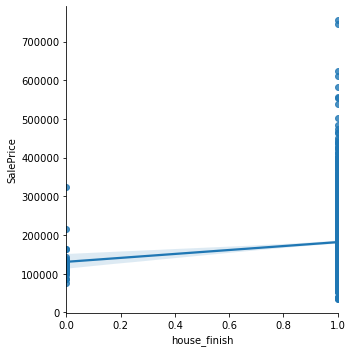

logged


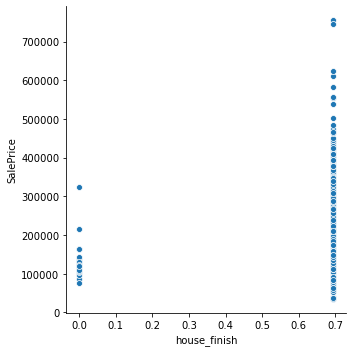

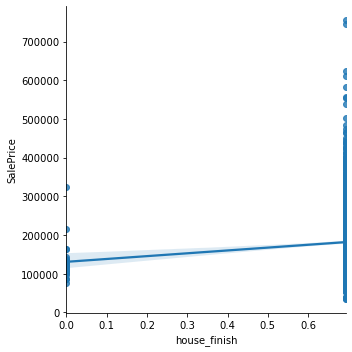

EnclosedPorch


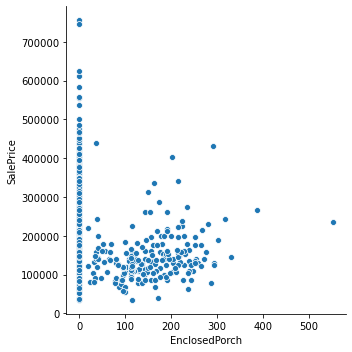

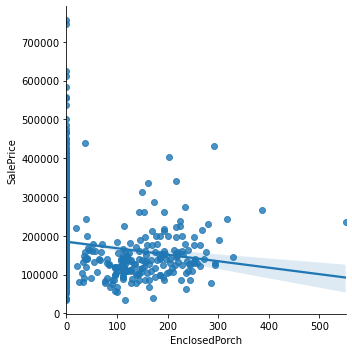

logged


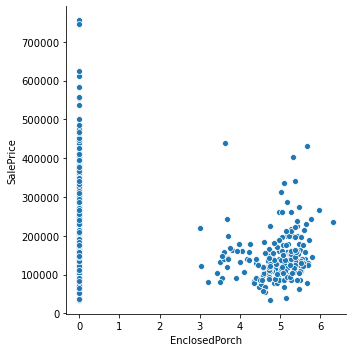

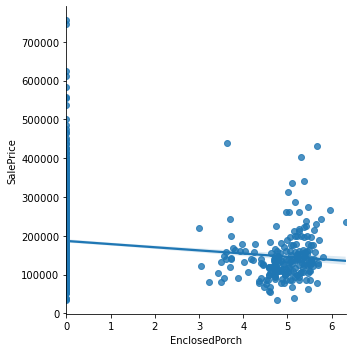

Remodeled


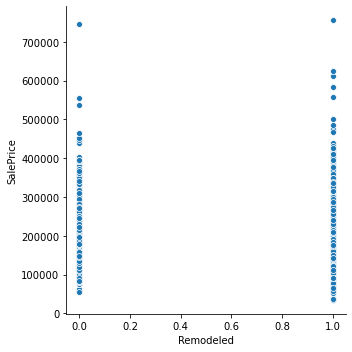

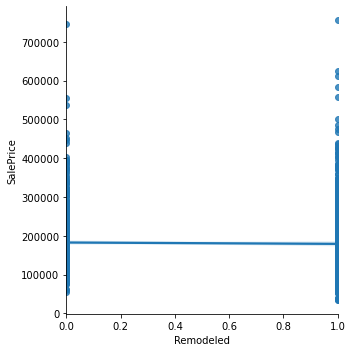

logged


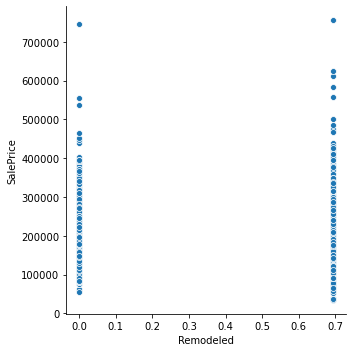

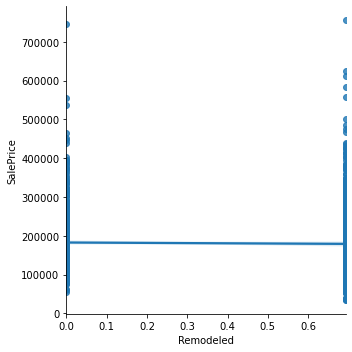

Street_Alley


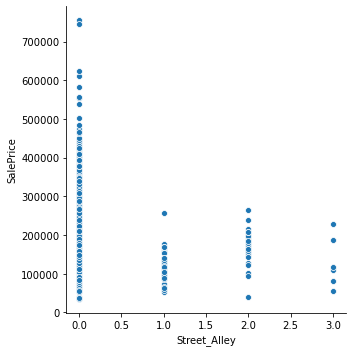

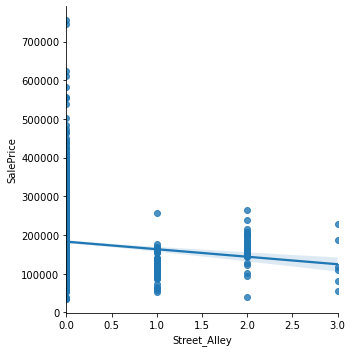

logged


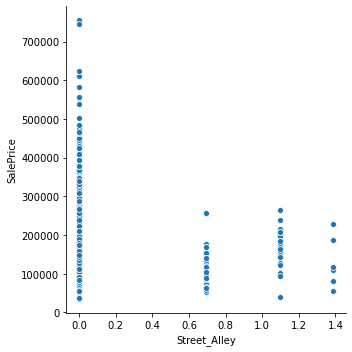

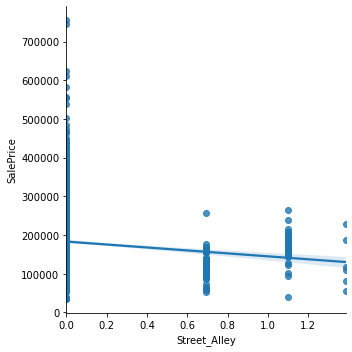

ScreenPorch


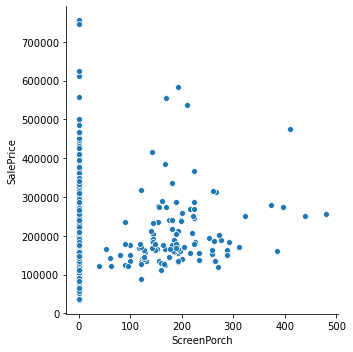

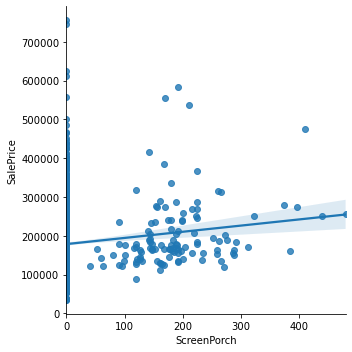

logged


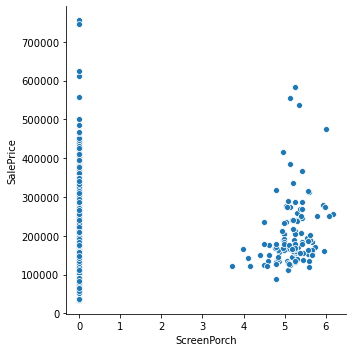

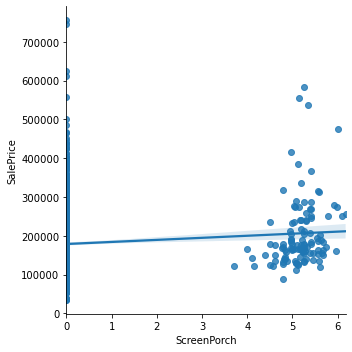

BsmtFullBath


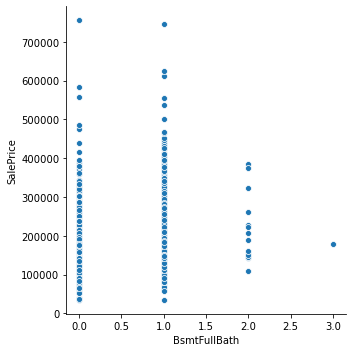

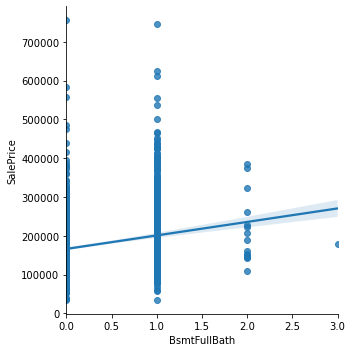

logged


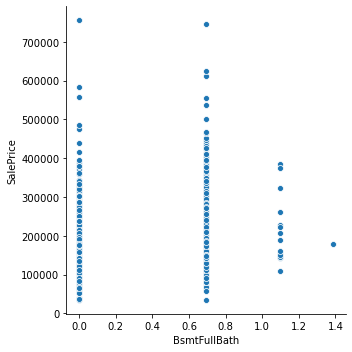

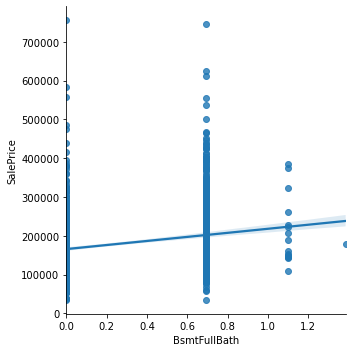

LandSlope


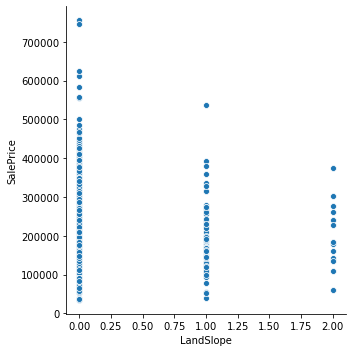

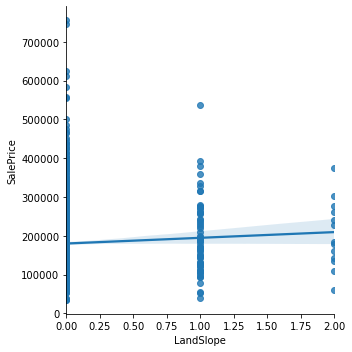

logged


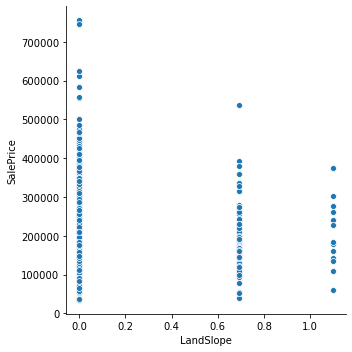

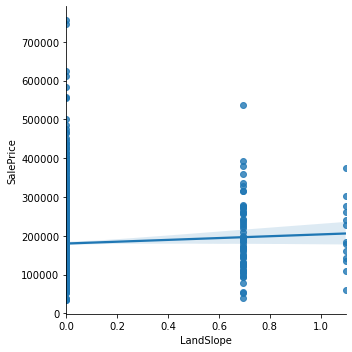

LotConfig


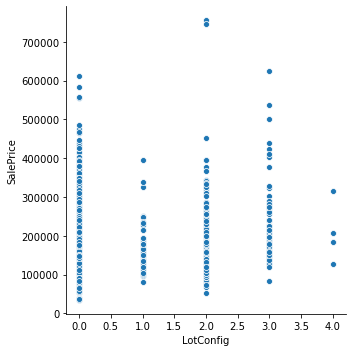

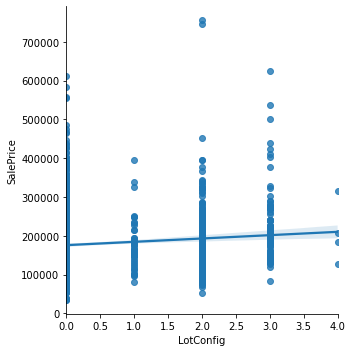

logged


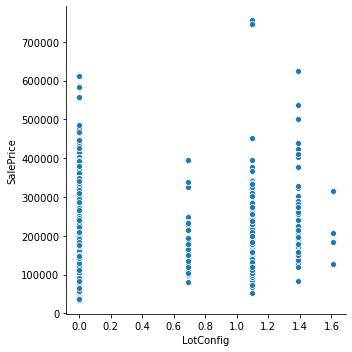

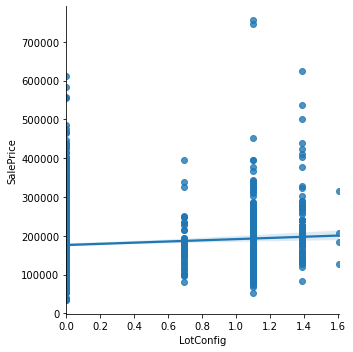

BsmtFinSF2


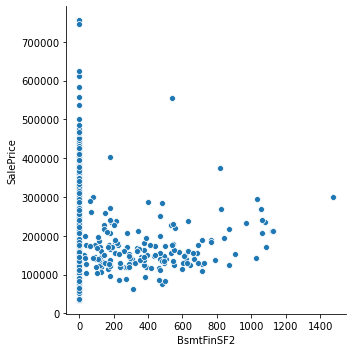

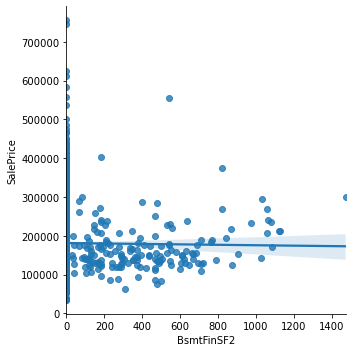

logged


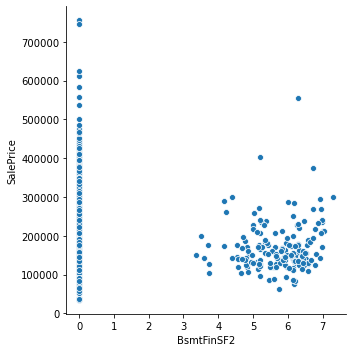

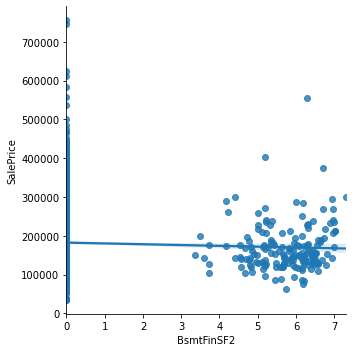

Condition1_Condition2


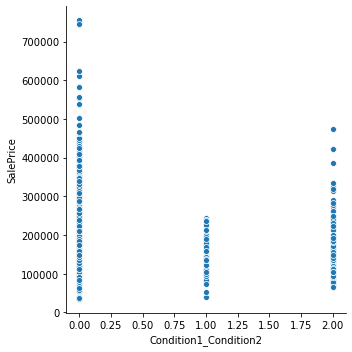

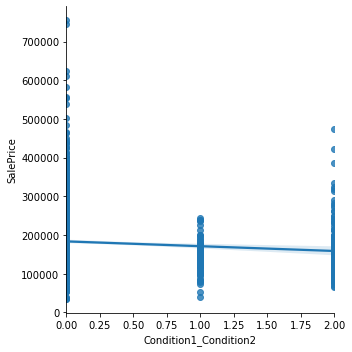

logged


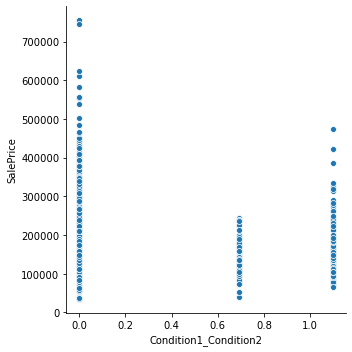

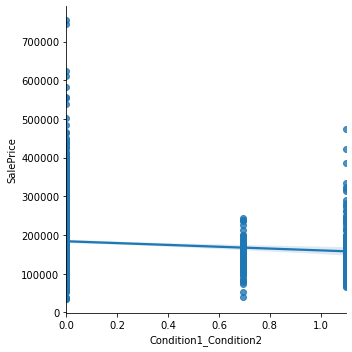

YrSold


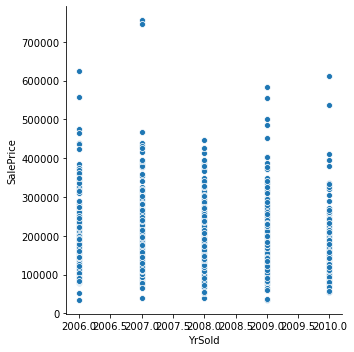

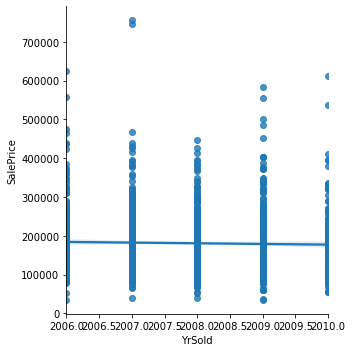

logged


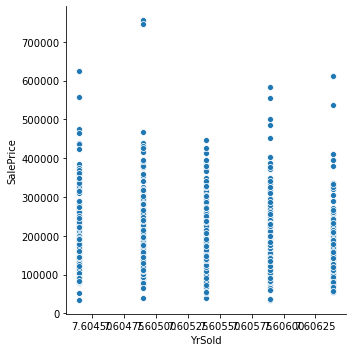

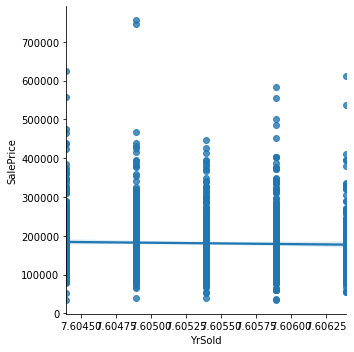

PoolArea


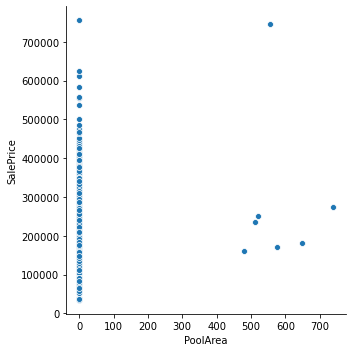

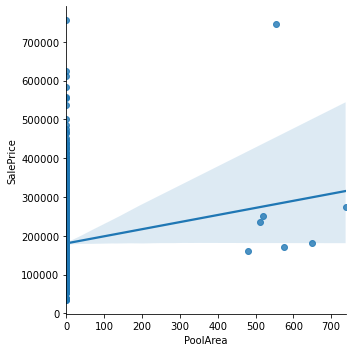

logged


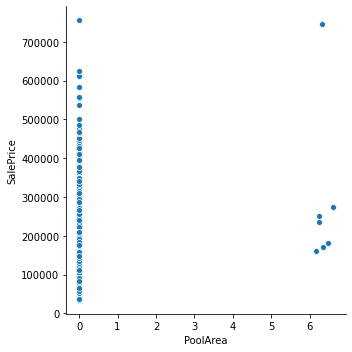

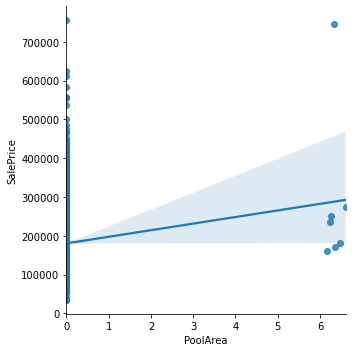

PoolQC


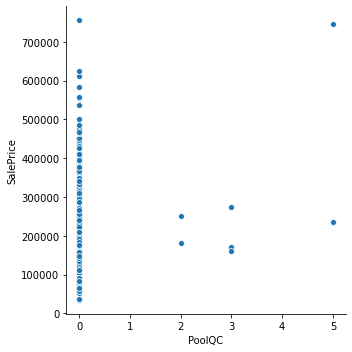

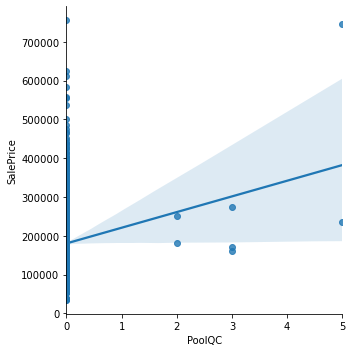

logged


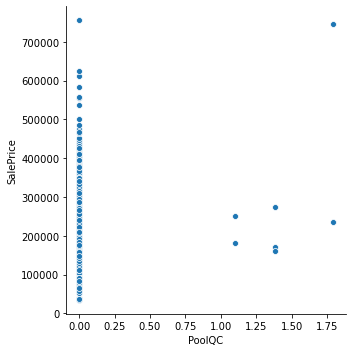

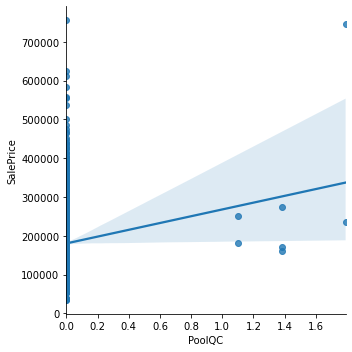

no_finishes_perc


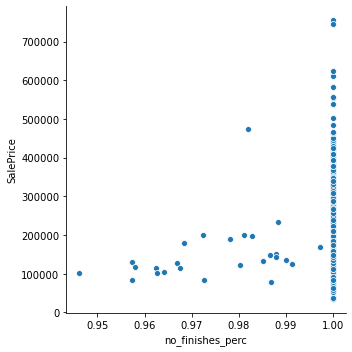

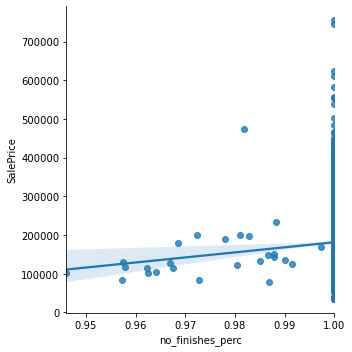

logged


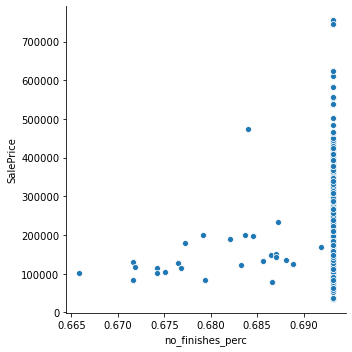

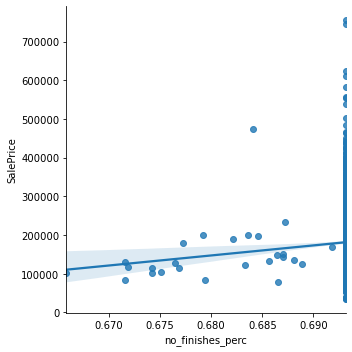

LowQualFinSF


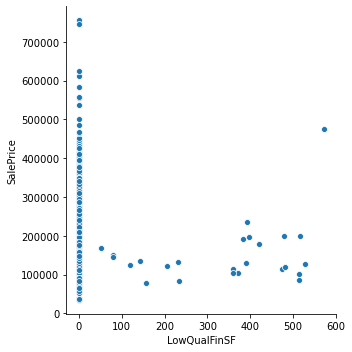

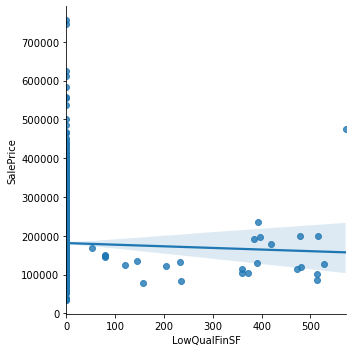

logged


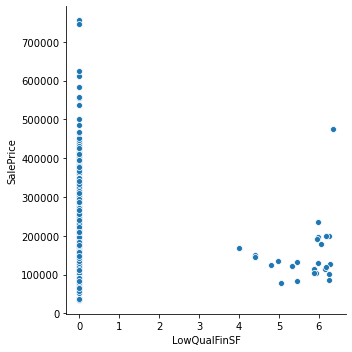

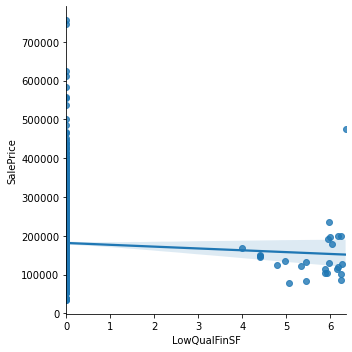

3SsnPorch


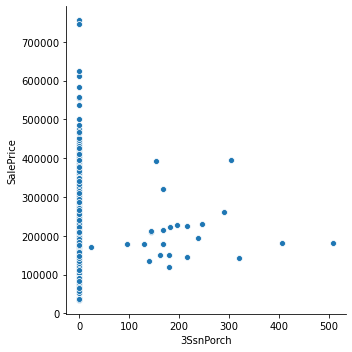

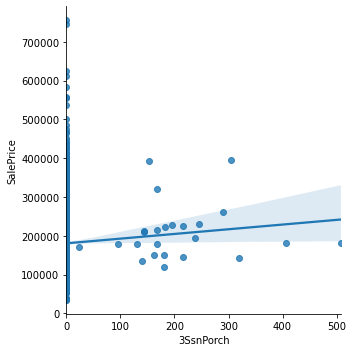

logged


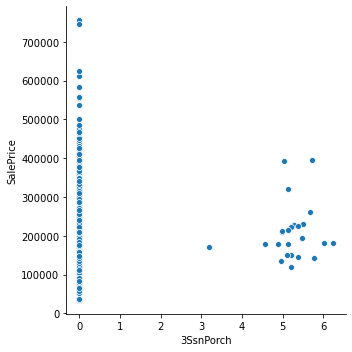

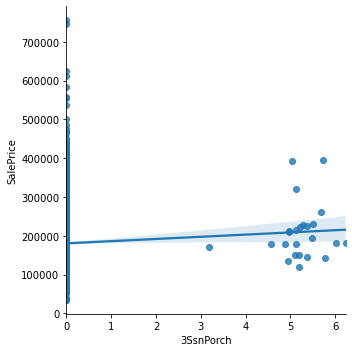

Condition2


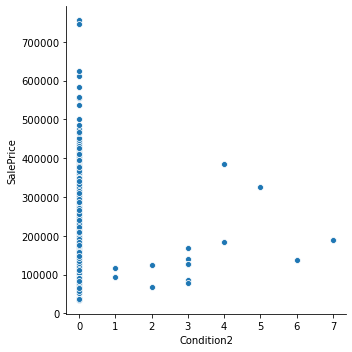

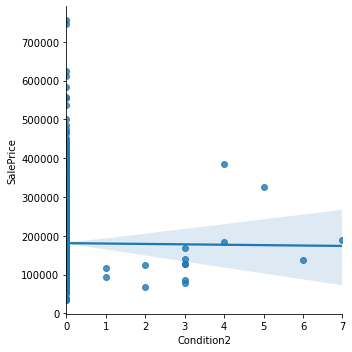

logged


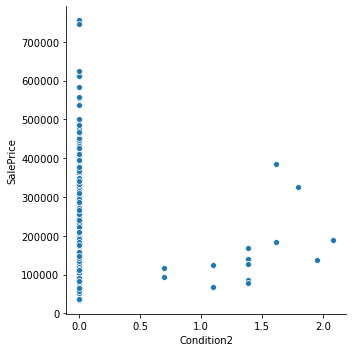

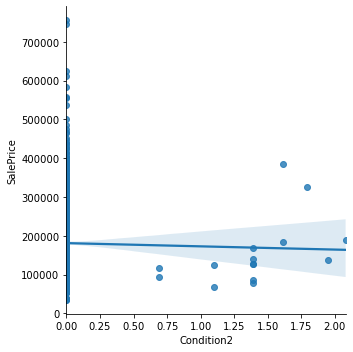

Functional


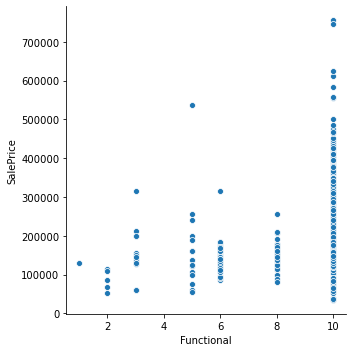

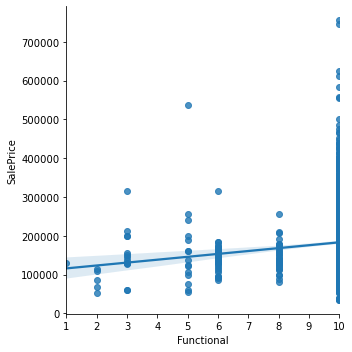

logged


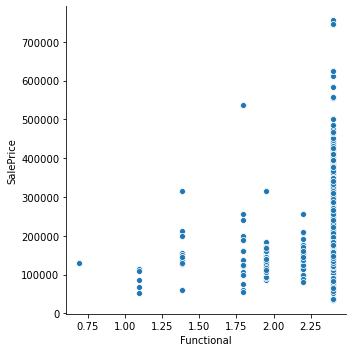

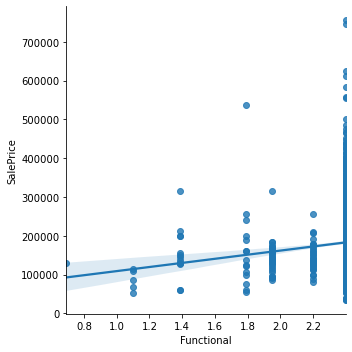

BsmtHalfBath


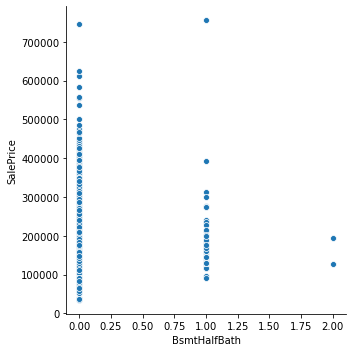

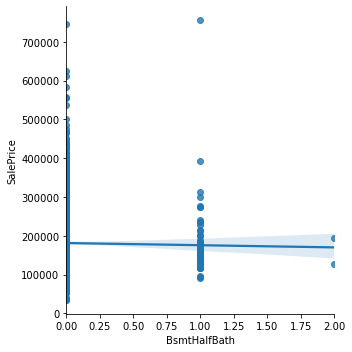

logged


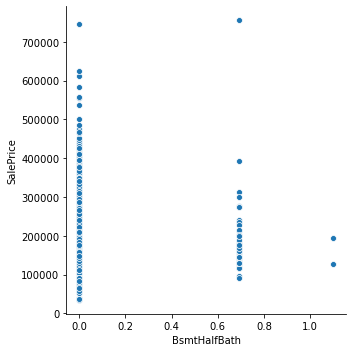

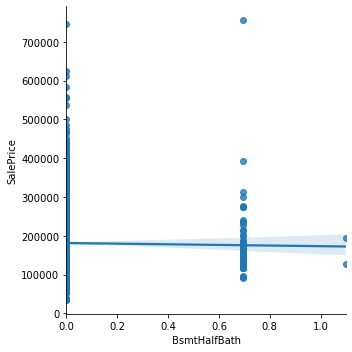

MiscVal


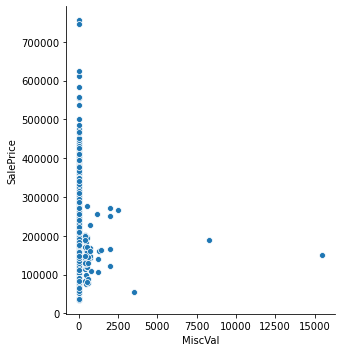

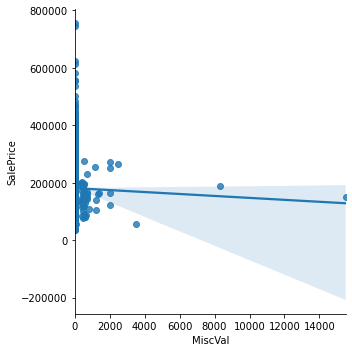

logged


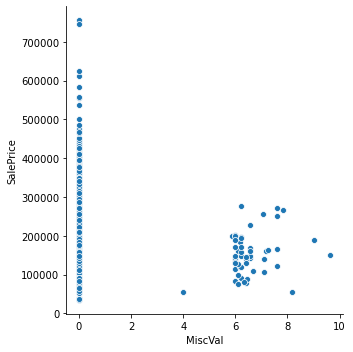

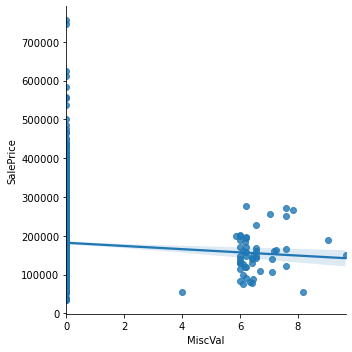

MoSold


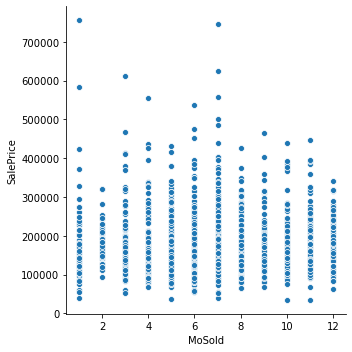

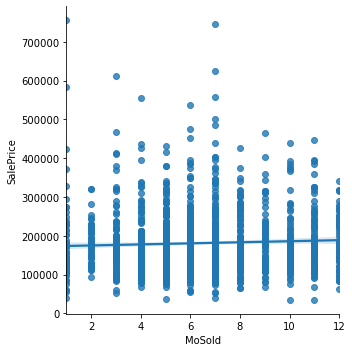

logged


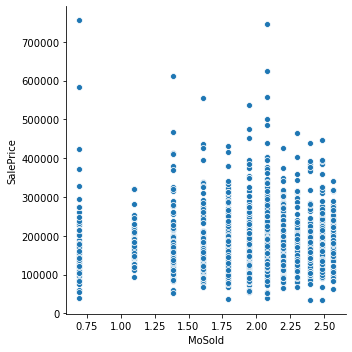

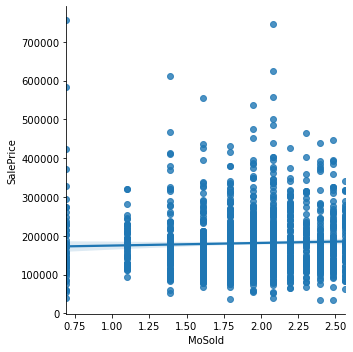

In [130]:
#sns.lmplot(x="horsepower", y="price", hue="fuel_type", data=df);
for col in mutual_mxLE:
    print(col)
    sns.relplot(x=col, y="SalePrice", data=LE_df,);
    sns.lmplot(x=col, y="SalePrice", data=LE_df,);
    plt.show()
    print("logged")
    sns.relplot(x=col, y="SalePrice", data=logged);
    sns.lmplot(x=col, y="SalePrice", data=logged);
    plt.show()
    print("=========================")

In [ ]:
'total_indoor_sqft' > 11000
'GrLivArea' > 4000
'TotalBsmtSF' > 4000
'GarageCars' > 3
'1stFlrSF' >3000
'no_finishes' >100000
'TotalBsmtSF' >4000

In [42]:
# GarageCars
LE_df[LE_df['GarageCars']==4]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,Bsmt_Fsh_Per,avg_Ext_Qual,avg_Bmt_Qual,avg_Gar_Qual,total_All_Qualities,avg_All_Qualities,kfold,LivLotRatio,Spaciousness,PorchTypes
420,421,90,1,78.0,7060,0,-1,0,0,0,...,0.026042,6.0,6.0,5.0,59.0,5.363636,-1,0.190368,168.000000,0
747,748,70,1,65.0,11700,0,1,1,0,0,...,1.000000,6.0,2.6,3.5,54.1,4.918182,-1,0.225641,330.000000,2
1190,1191,190,0,69.0,32463,0,-1,0,2,0,...,0.072058,6.0,3.6,5.0,53.6,4.872727,-1,0.049965,231.714286,1
1340,1341,20,0,70.0,8294,0,-1,0,0,0,...,1.000000,5.0,3.0,3.5,45.5,4.136364,-1,0.105136,174.400000,0
1350,1351,90,0,91.0,11643,0,-1,0,0,0,...,0.599359,5.0,2.8,3.5,46.3,4.209091,-1,0.226230,219.500000,0


In [43]:
# avg_Bmt_Qual
LE_df[LE_df['avg_Bmt_Qual']==0]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,Bsmt_Fsh_Per,avg_Ext_Qual,avg_Bmt_Qual,avg_Gar_Qual,total_All_Qualities,avg_All_Qualities,kfold,LivLotRatio,Spaciousness,PorchTypes
17,18,90,0,72.0,10791,0,-1,0,0,0,...,0.48227,5.0,0.0,3.5,42.5,3.863636,-1,0.120100,216.000000,0
39,40,90,0,65.0,6040,0,-1,0,0,0,...,0.48227,5.0,0.0,0.0,34.0,3.090909,-1,0.190728,192.000000,0
90,91,20,0,60.0,7200,0,-1,0,0,0,...,0.48227,5.0,0.0,3.5,40.5,3.681818,-1,0.144444,260.000000,1
102,103,90,0,64.0,7018,0,-1,0,1,0,...,0.48227,4.0,0.0,3.5,42.5,3.863636,-1,0.218723,191.875000,0
156,157,20,0,60.0,7200,0,-1,0,0,0,...,0.48227,5.0,0.0,3.5,44.5,4.045455,-1,0.144444,208.000000,0
182,183,20,0,60.0,9060,0,-1,0,0,0,...,0.48227,5.0,0.0,4.0,51.0,4.636364,-1,0.147903,191.428571,2
259,260,20,1,70.0,12702,0,-1,0,0,0,...,0.48227,5.0,0.0,3.5,43.5,3.954545,-1,0.069438,220.500000,1
342,343,90,0,69.0,8544,0,-1,0,0,0,...,0.48227,5.0,0.0,3.5,36.5,3.318182,-1,0.121723,173.333333,0
362,363,85,0,64.0,7301,0,-1,0,0,0,...,0.48227,6.0,0.0,4.0,55.0,5.000000,-1,0.263252,274.571429,1
371,372,50,0,80.0,17120,0,-1,0,0,0,...,0.48227,5.0,0.0,5.0,40.0,3.636364,-1,0.092757,226.857143,1


In [31]:
LE_df[LE_df['GarageArea']==0]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,Bsmt_Fsh_Per,avg_Ext_Qual,avg_Bmt_Qual,avg_Gar_Qual,total_All_Qualities,avg_All_Qualities,kfold,LivLotRatio,Spaciousness,PorchTypes
39,40,90,0,65.0,6040,0,-1,0,0,0,...,0.482270,5.0,0.0,0.0,34.0,3.090909,-1,0.190728,192.000000,0
48,49,190,1,33.0,4456,0,-1,0,0,0,...,1.000000,5.0,3.0,0.0,44.0,4.000000,-1,0.325853,181.500000,1
78,79,90,0,72.0,10778,0,-1,0,0,0,...,1.000000,5.0,3.0,0.0,42.0,3.818182,-1,0.164038,221.000000,0
88,89,50,2,105.0,8470,0,-1,1,0,0,...,1.000000,3.0,2.6,0.0,33.6,3.054545,-1,0.180165,168.833333,1
89,90,20,0,60.0,8070,0,-1,0,0,0,...,0.406061,5.0,5.0,0.0,49.0,4.454545,-1,0.122677,198.000000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1349,1350,70,1,50.0,5250,0,1,0,0,0,...,0.621345,6.0,2.4,0.0,44.4,4.036364,-1,0.449143,269.125000,2
1407,1408,20,0,69.0,8780,0,-1,1,0,0,...,0.249700,5.0,3.6,0.0,48.6,4.418182,-1,0.094875,166.600000,0
1449,1450,180,1,21.0,1533,0,-1,0,0,0,...,0.122222,5.0,5.4,0.0,57.4,5.218182,-1,0.410959,210.000000,0
1450,1451,90,0,60.0,9000,0,-1,0,0,0,...,1.000000,5.0,3.4,0.0,43.4,3.945455,-1,0.199111,224.000000,2


In [44]:
def box_swarm_plot(data,categorical,numerical):
    print(categorical)
    plt.figure(figsize=(10,6))
    ax=sns.boxplot(x=categorical,y= numerical,data=data,dodge=False)
    #ax=sns.swarmplot(x=categorical,y=numerical,data=train_df,dodge=False,color='0.25')
    plt.show()

total_indoor_sqft


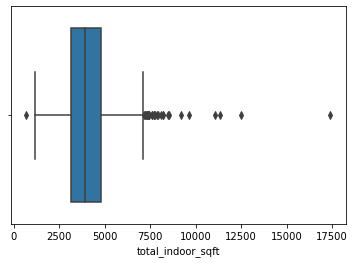

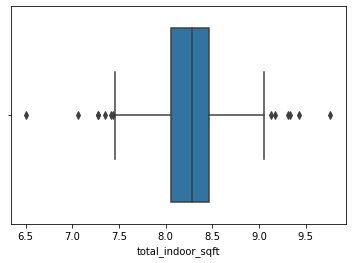

OverallQual


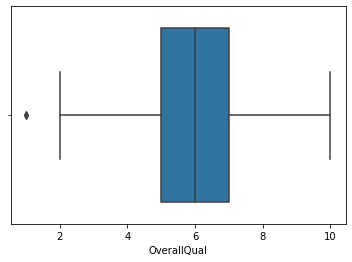

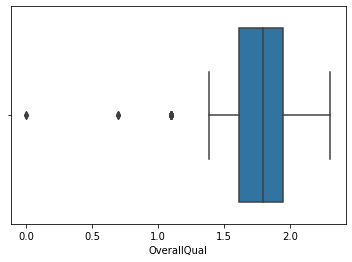

total_All_Qualities


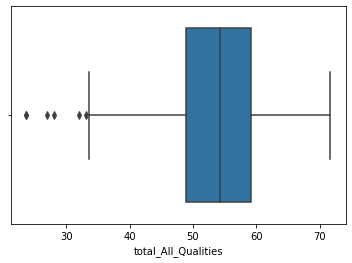

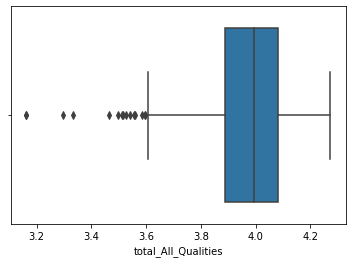

avg_All_Qualities


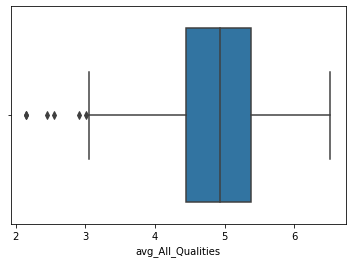

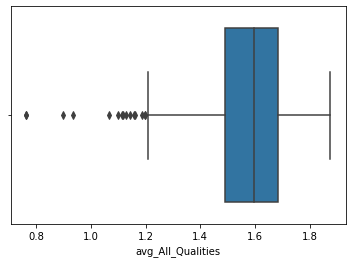

Neighborhood


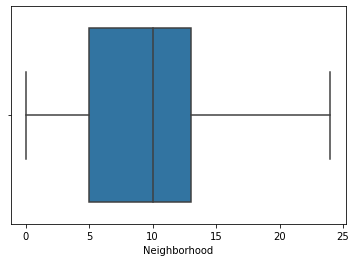

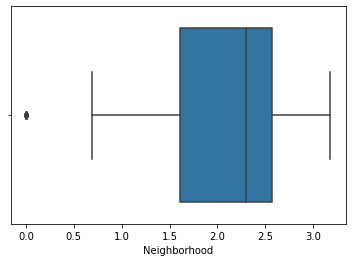

GrLivArea


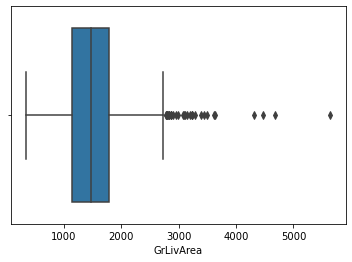

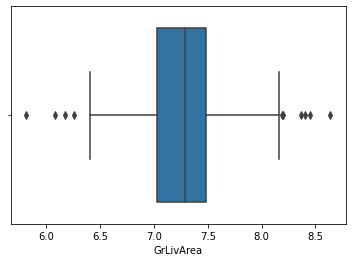

TotalBsmtSF


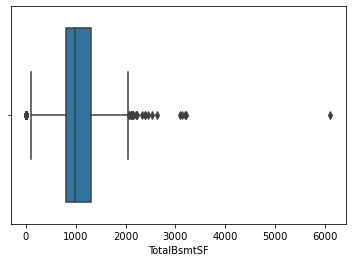

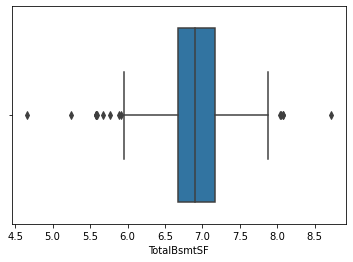

GarageArea


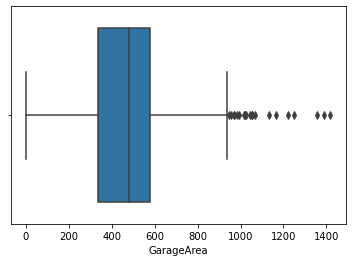

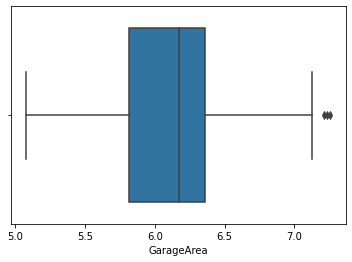

YearBuilt_Age


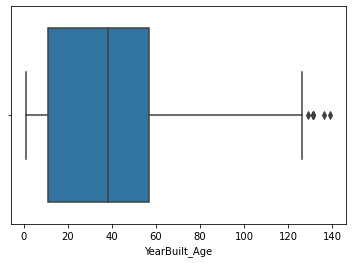

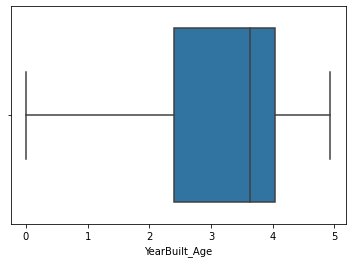

YearBuilt


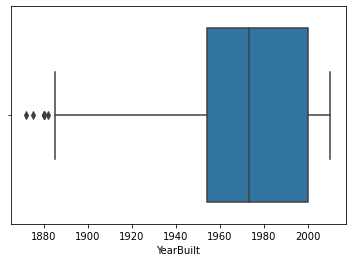

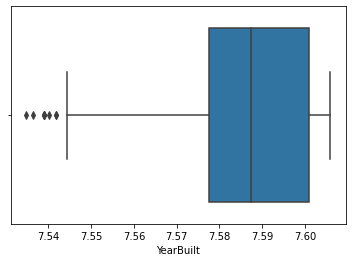

GarageCars


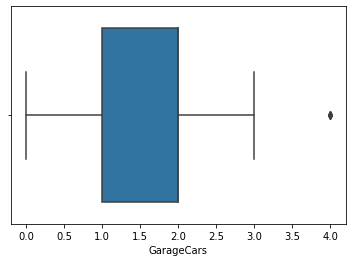

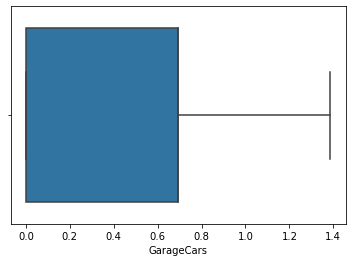

BsmtQual


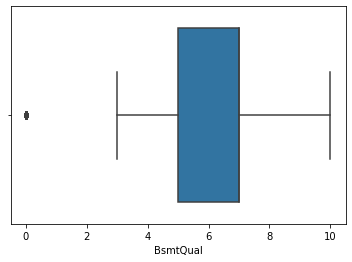

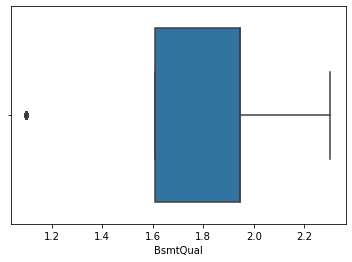

YrSd_YrBlt


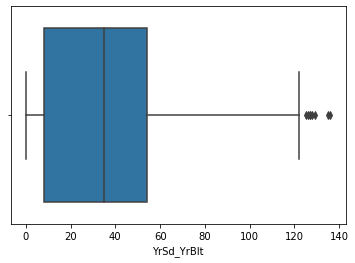

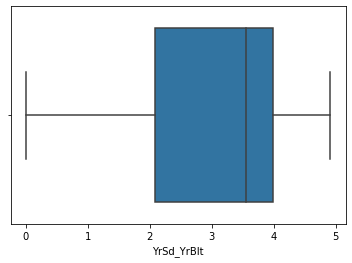

KitchenQual


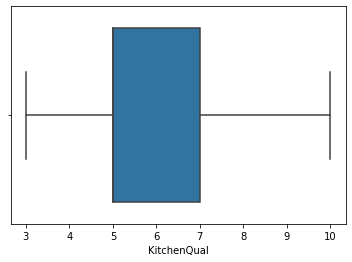

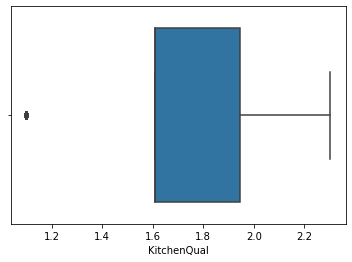

ExterQual


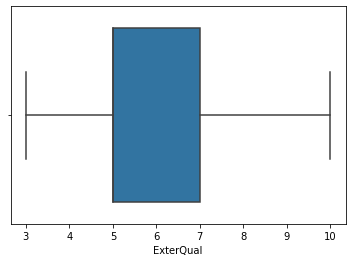

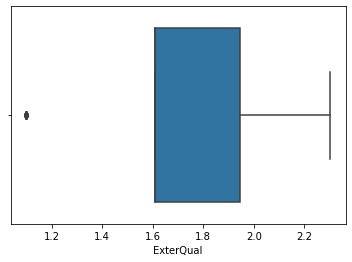

avg_Bmt_Qual


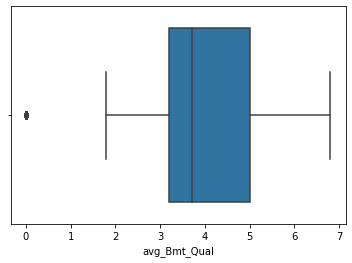

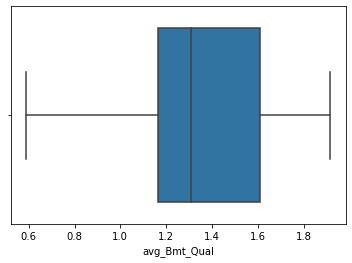

total_Bmt_Ql_Cd


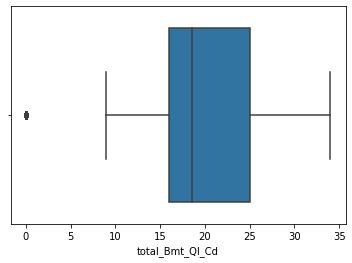

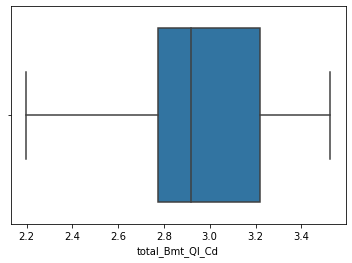

1stFlrSF


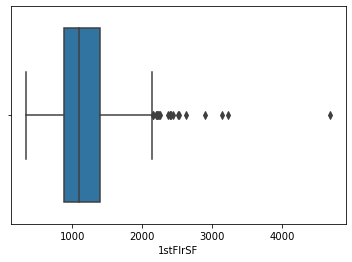

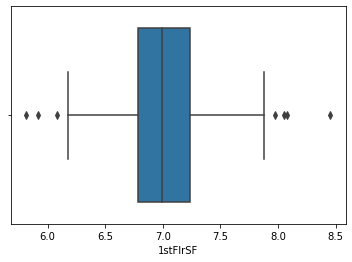

GarageYrBlt


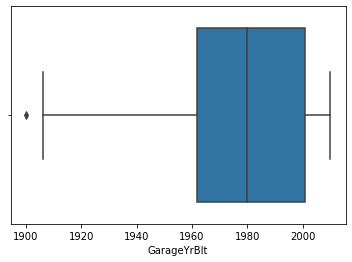

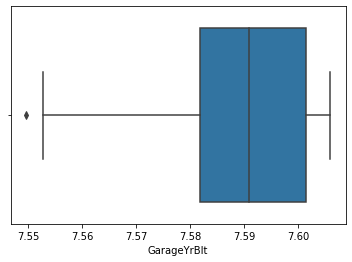

total_in_out_sqft


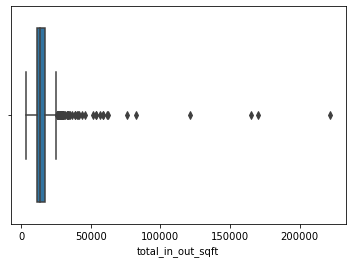

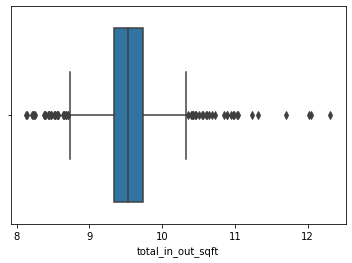

no_finishes


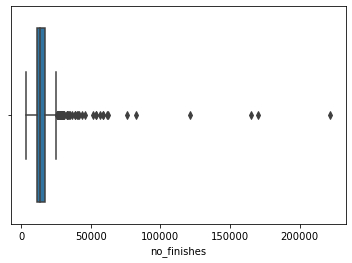

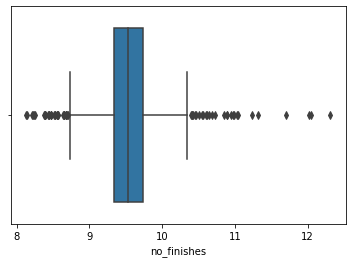

avg_Gar_Qual


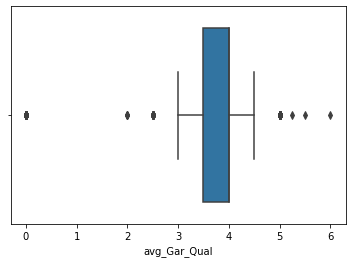

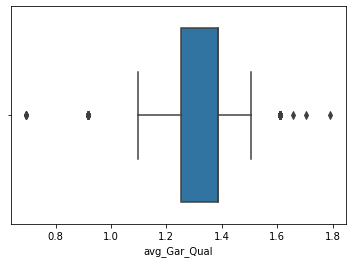

MSSubClass


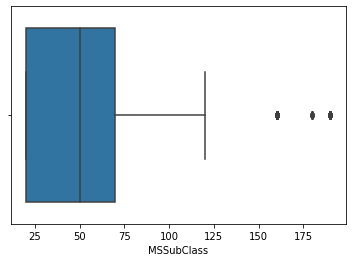

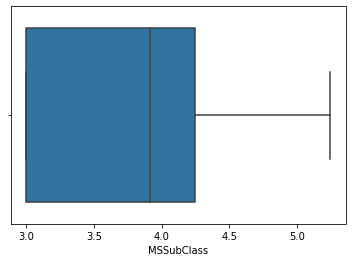

GarageFinish


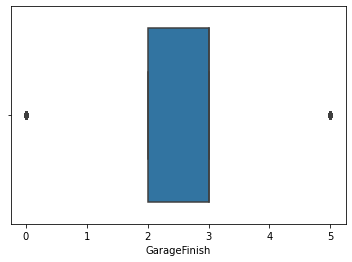

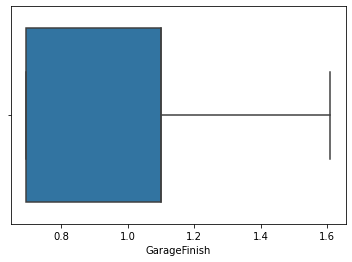

YrSd_YrRmd


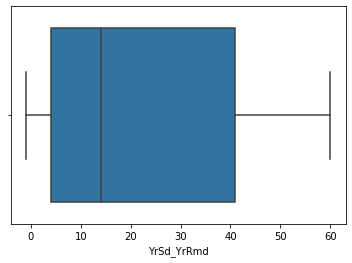

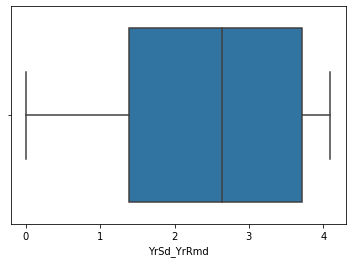

total_Garage_Ql_Cd


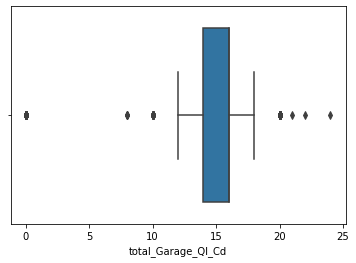

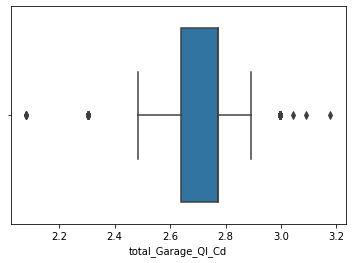

avg_Ext_Qual


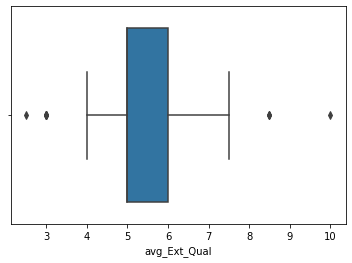

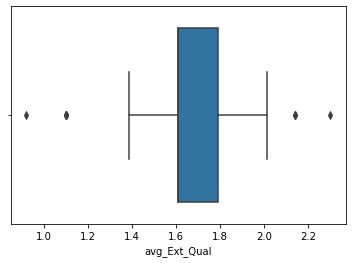

Spaciousness


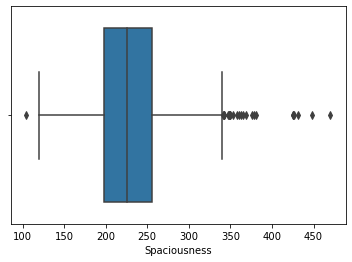

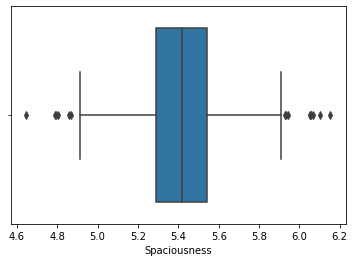

FullBath


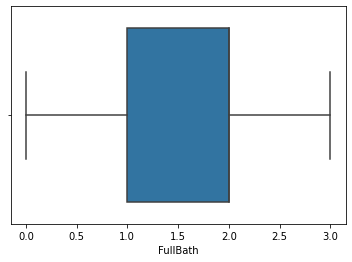

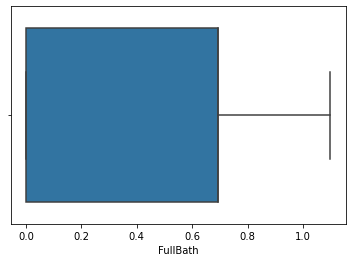

YearRemodAdd


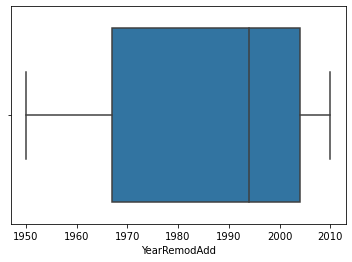

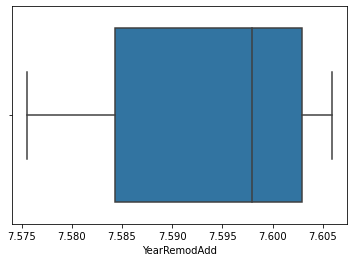

total_Ext_Ql_Cd


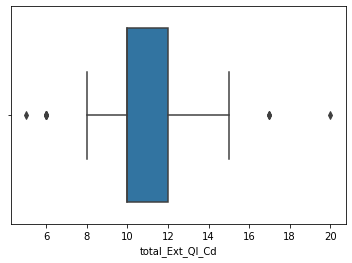

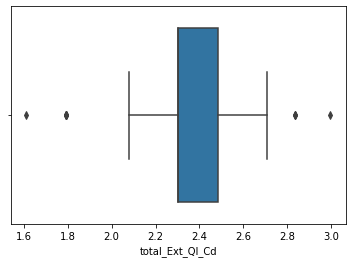

YearRemodAdd_Age


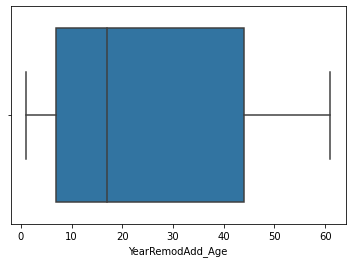

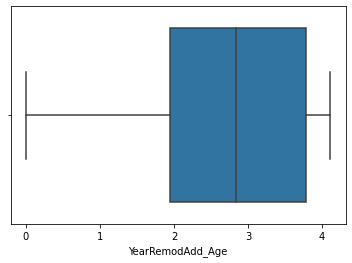

Garage_per_Car_Cap


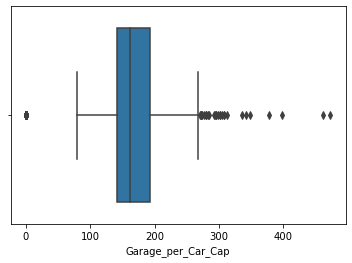

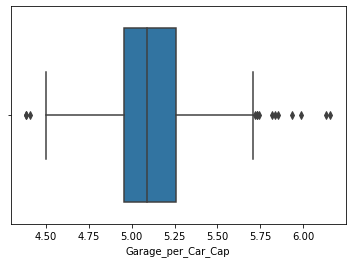

Foundation_MasVnrType


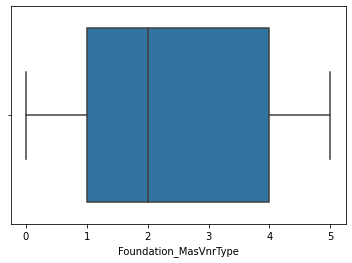

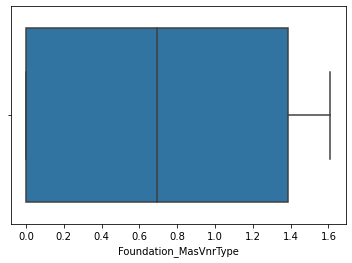

LotFrontage


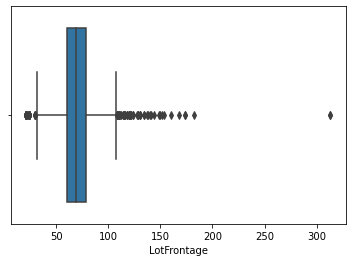

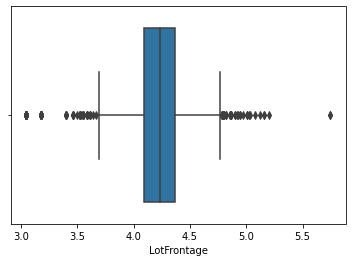

TotRmsAbvGrd


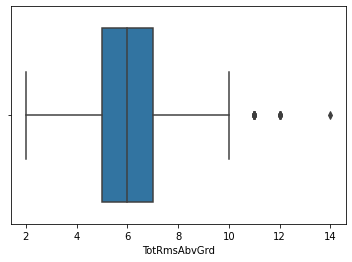

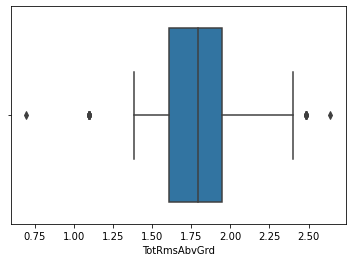

FireplaceQu


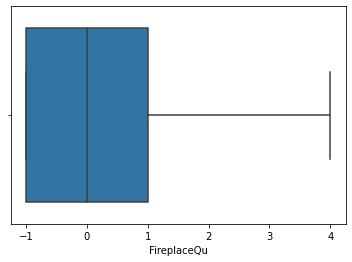

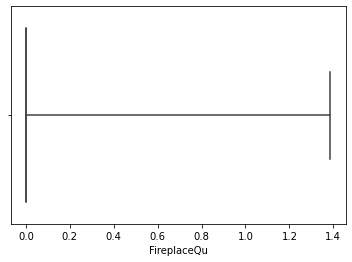

GarageType


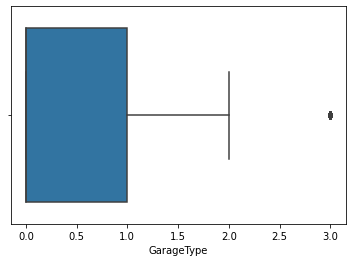

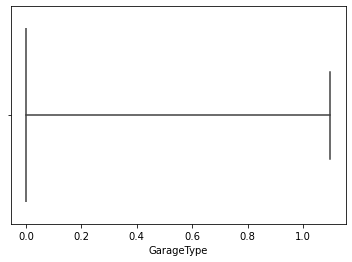

Foundation


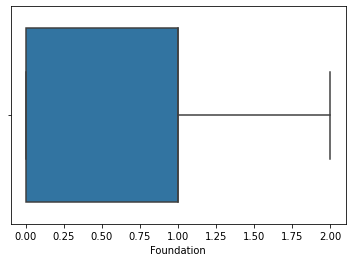

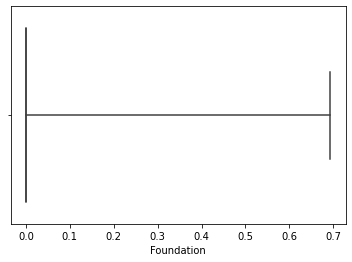

2ndFlrSF


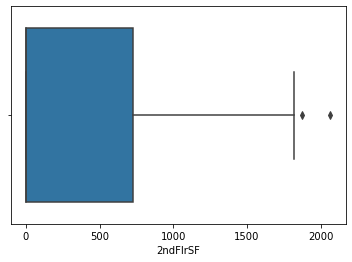

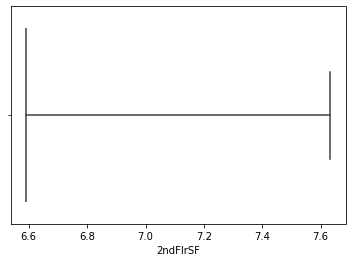

In [49]:
for col in mutual_mxLE[:40]:  
    print(col)
    sns.boxplot(LE_df[col])
    plt.show()
    sns.boxplot(np.log(LE_df[col]))
    plt.show()
    print('===============================')

total_indoor_sqft


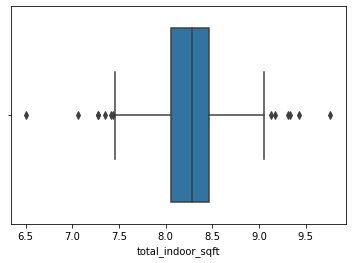

OverallQual


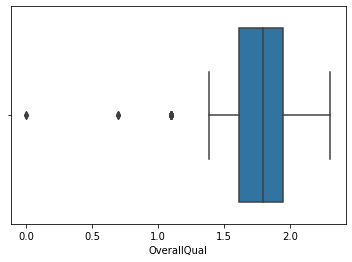

total_All_Qualities


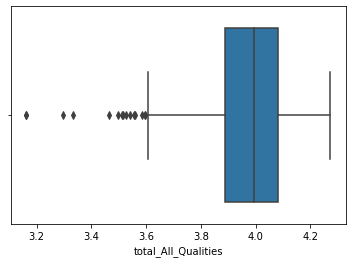

avg_All_Qualities


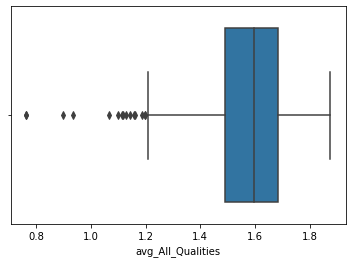

Neighborhood


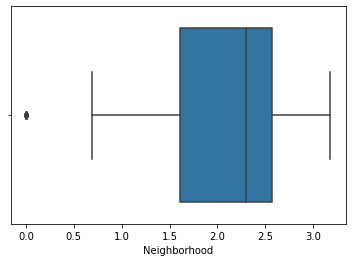

GrLivArea


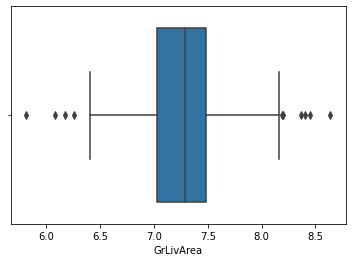

TotalBsmtSF


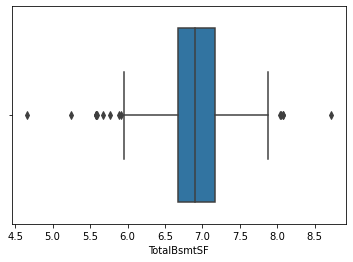

GarageArea


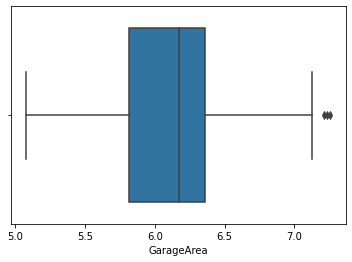

YearBuilt_Age


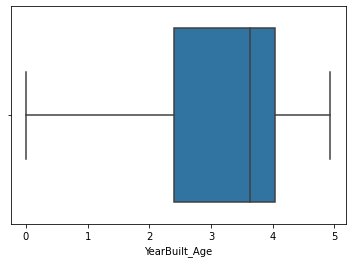

YearBuilt


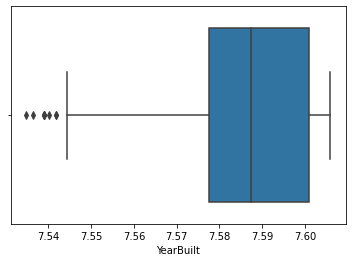

GarageCars


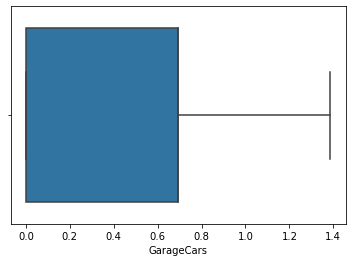

BsmtQual


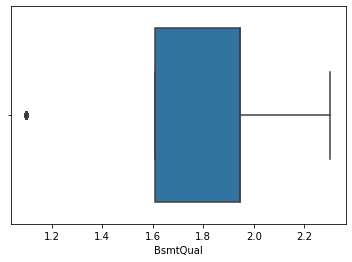

YrSd_YrBlt


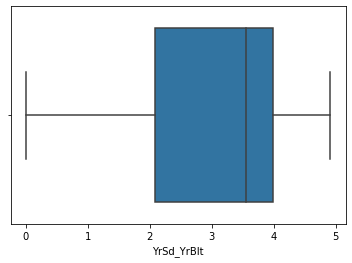

KitchenQual


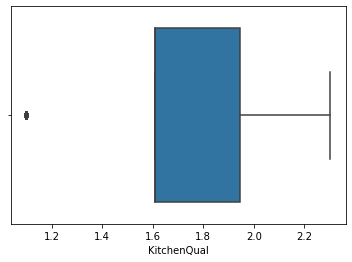

ExterQual


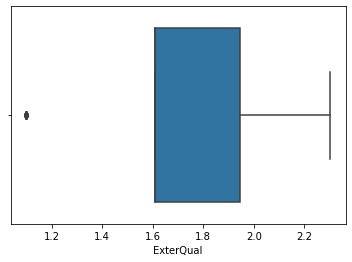

avg_Bmt_Qual


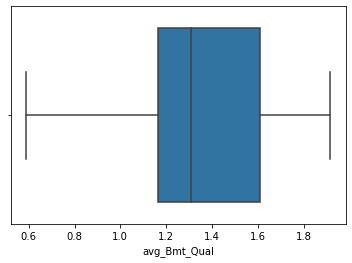

total_Bmt_Ql_Cd


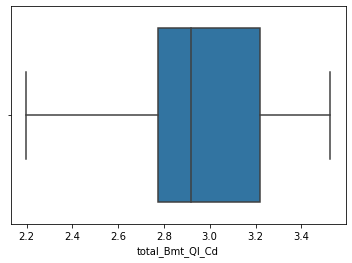

1stFlrSF


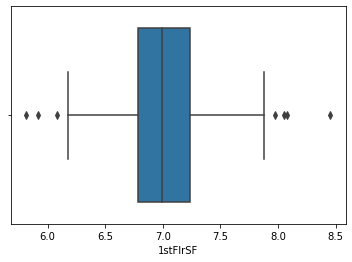

GarageYrBlt


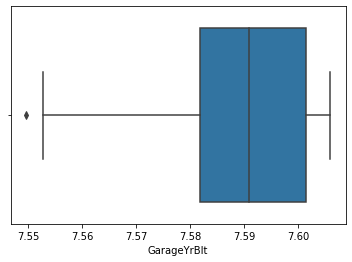

total_in_out_sqft


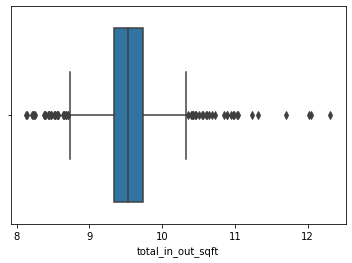

no_finishes


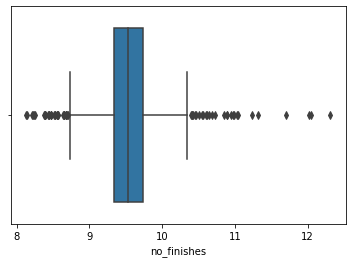

avg_Gar_Qual


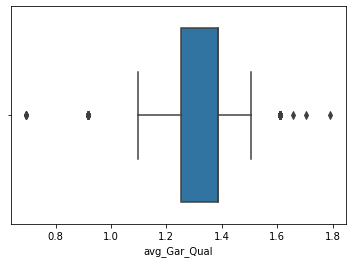

MSSubClass


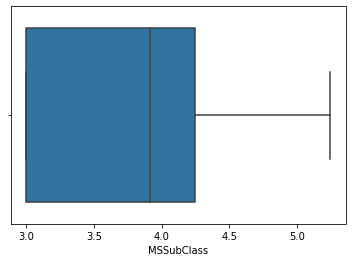

GarageFinish


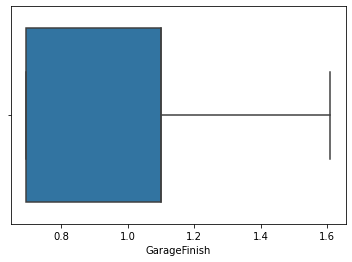

YrSd_YrRmd


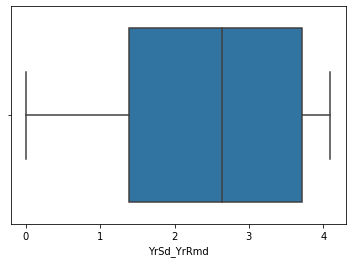

total_Garage_Ql_Cd


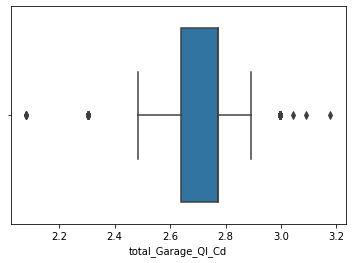

avg_Ext_Qual


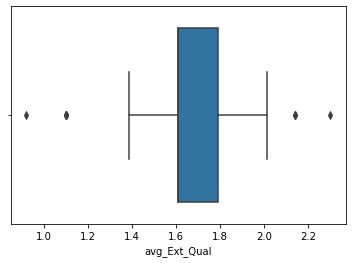

Spaciousness


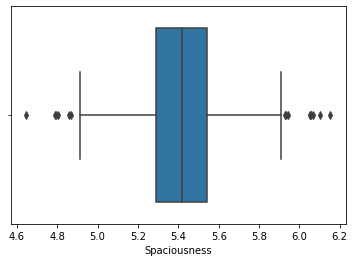

FullBath


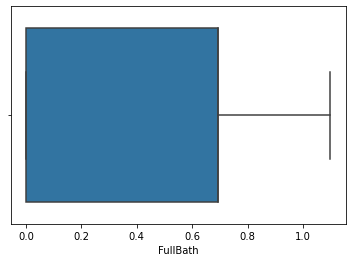

YearRemodAdd


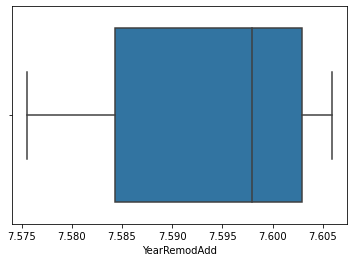

total_Ext_Ql_Cd


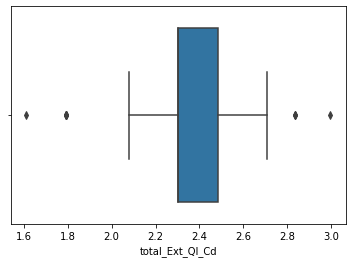

YearRemodAdd_Age


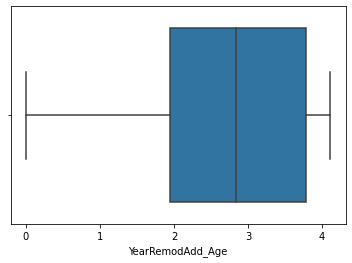

Garage_per_Car_Cap


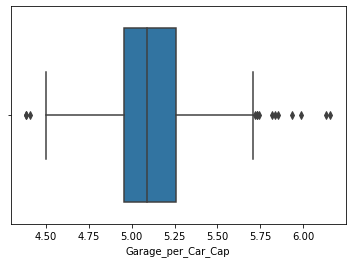

Foundation_MasVnrType


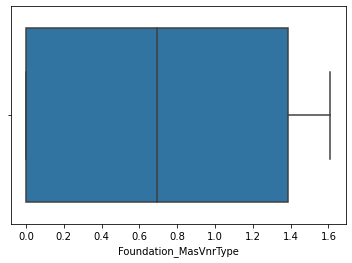

LotFrontage


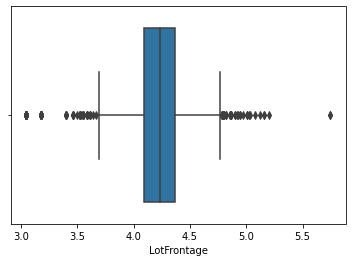

TotRmsAbvGrd


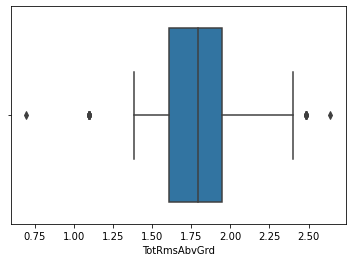

FireplaceQu


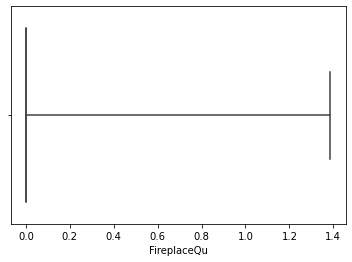

GarageType


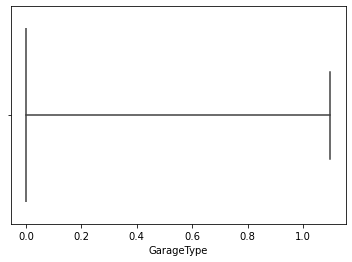

Foundation


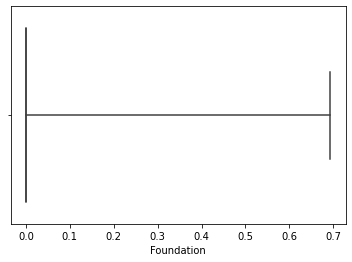

2ndFlrSF


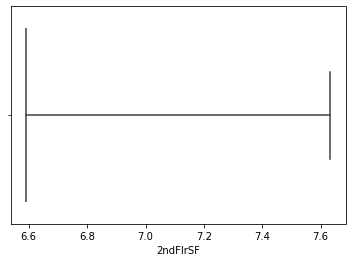

total_outdoor_sqft


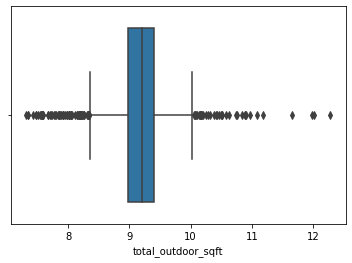

HeatingQC


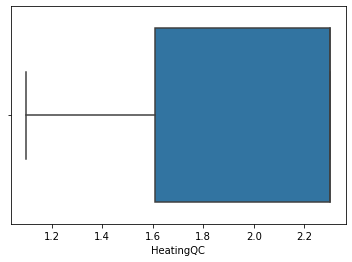

Fireplaces


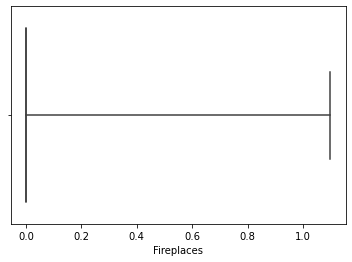

LotArea


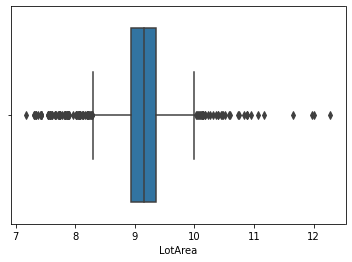

Exterior2nd


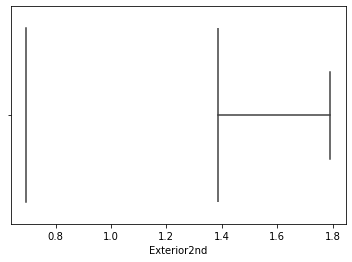

BsmtFinSF1


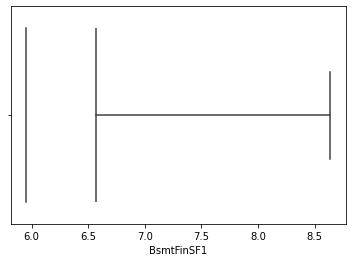

Exterior1st_Exterior2nd


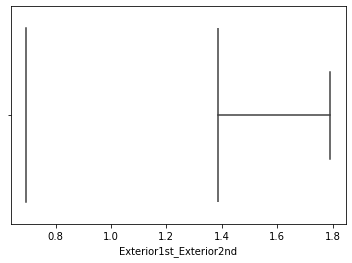

BsmtFinType1


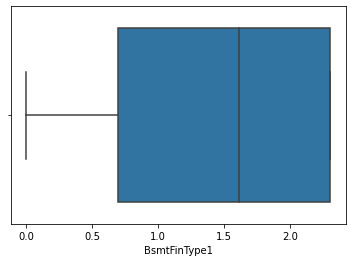

Exterior1st


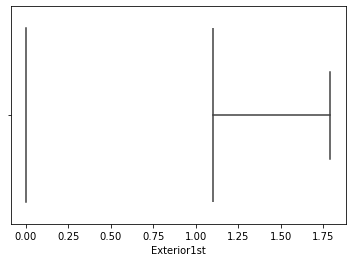

OpenPorchSF


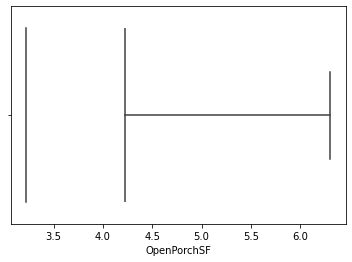

total_Bmt_Fn_Area


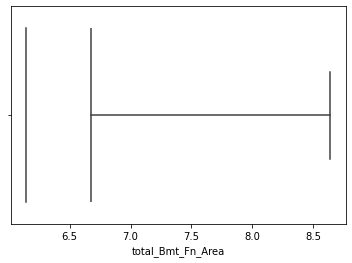

total_Porch


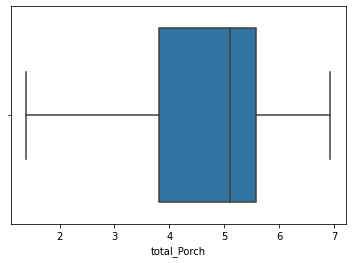

total_Max_Porch_Area


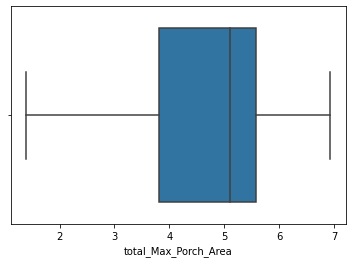

BsmtUnfSF


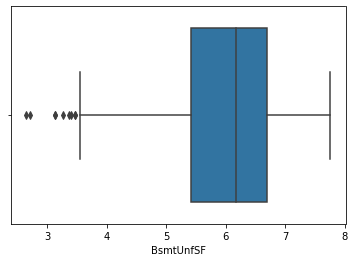

LotAreaPerFront


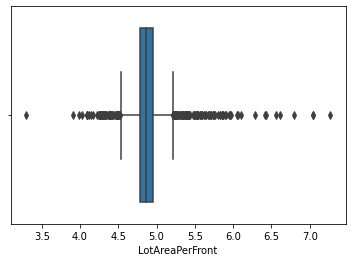

OverallCond


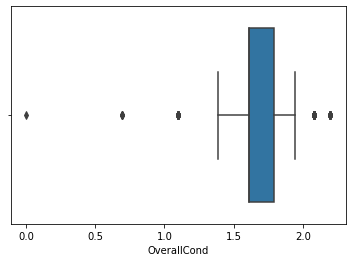

MSZoning


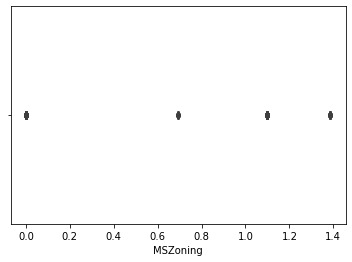

LotShape_LandContour


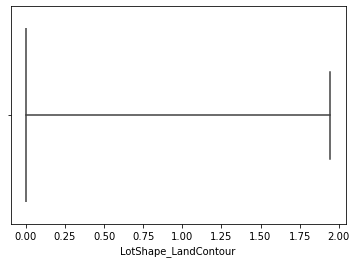

in_per_out


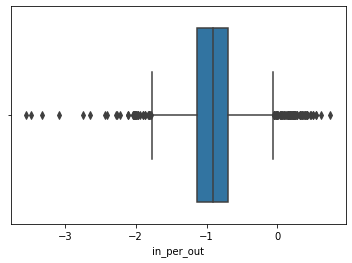

PorchTypes


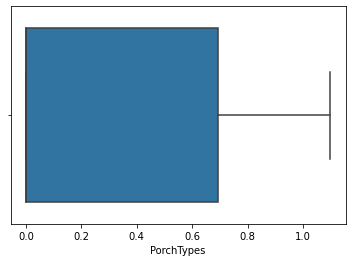

WoodDeckSF


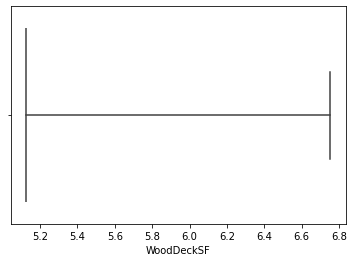

MasVnrType


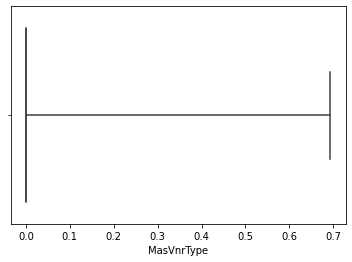

SaleCondition_SaleType


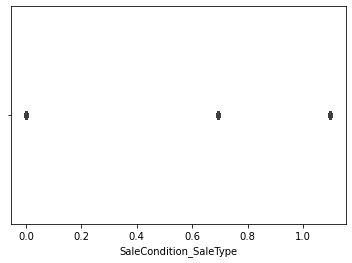

LotShape


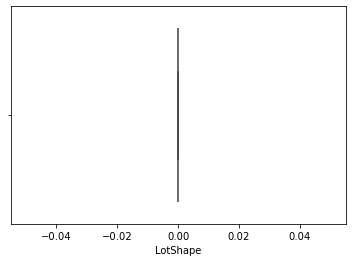

LotShape_LandSlope


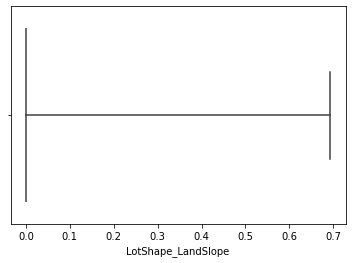

MasVnrArea


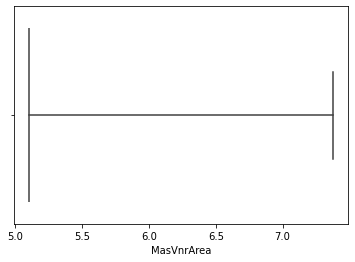

LivLotRatio


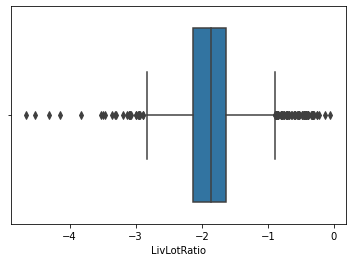

SaleType


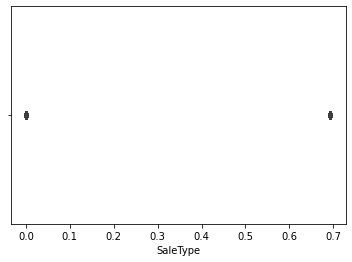

HalfBath


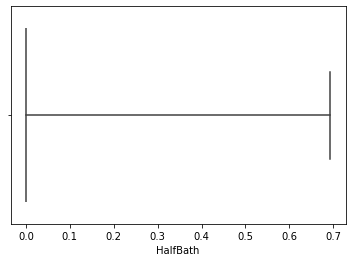

GarageCond


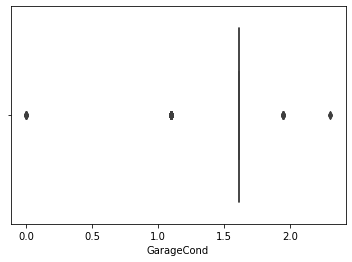

HouseStyle


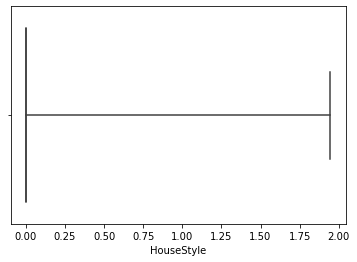

CentralAir


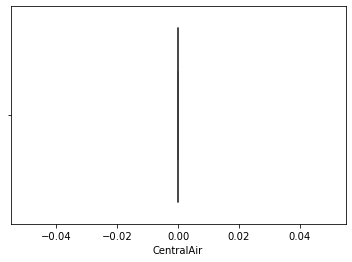

BedroomAbvGr


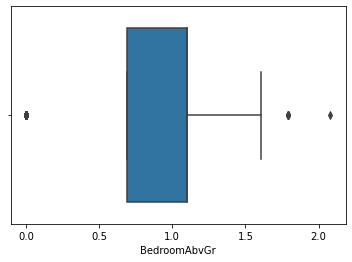

GarageQual


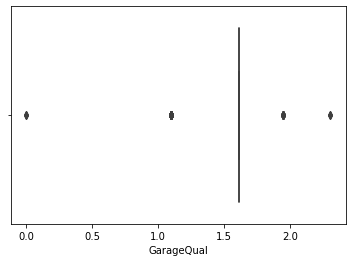

YrBlt_YrRmd_Diff


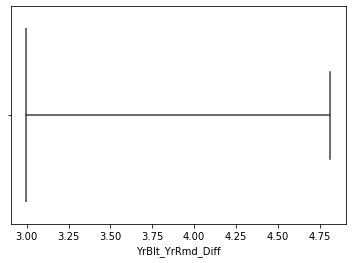

SaleCondition


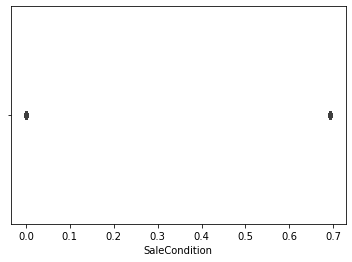

BsmtExposure


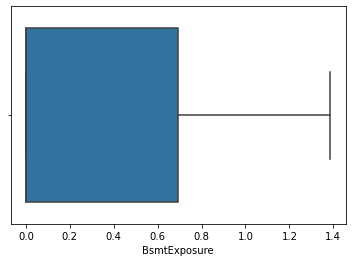

LotShape_LotConfig


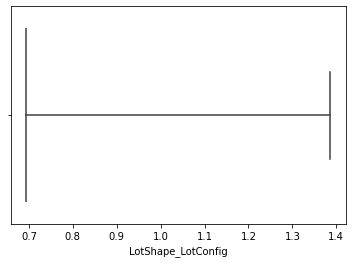

house_story


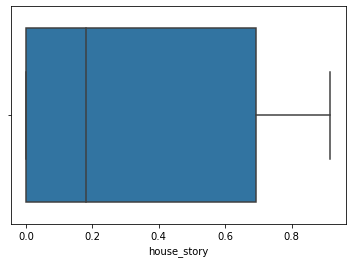

PavedDrive


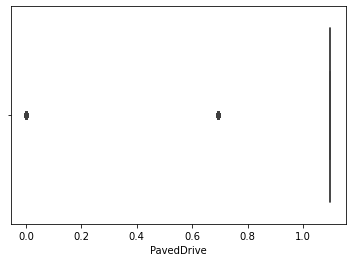

Bsmt_Unf_Per


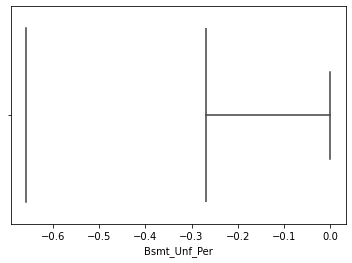

Bsmt_Fsh_Per


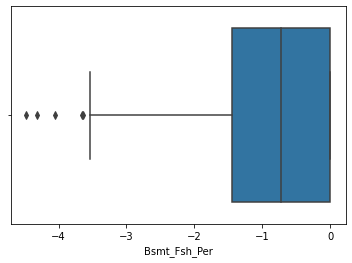

BsmtCond


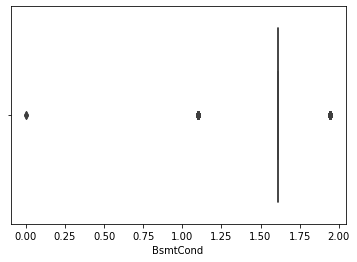

BldgType


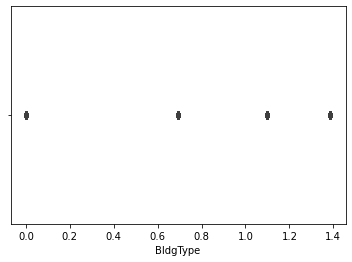

Electrical


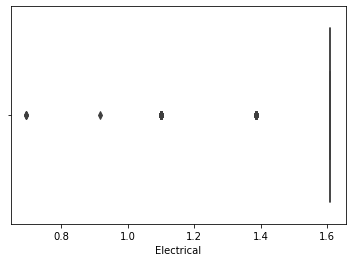

Fence


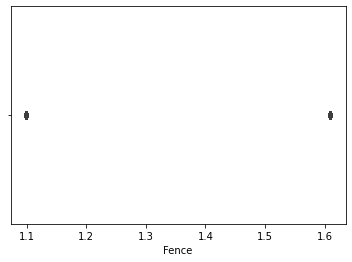

BsmtFinType2


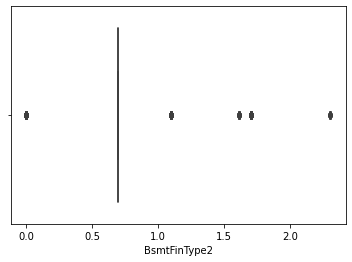

KitchenAbvGr


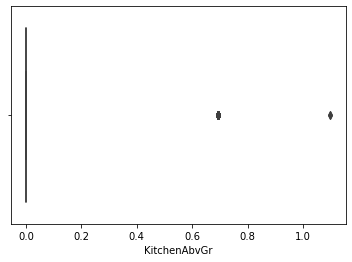

LandContour


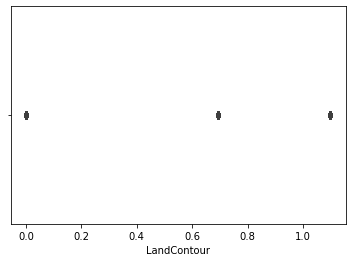

Condition1


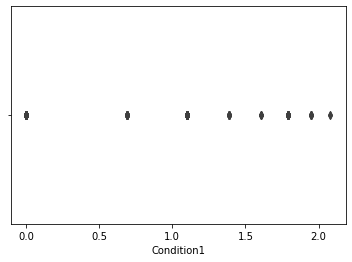

ExterCond


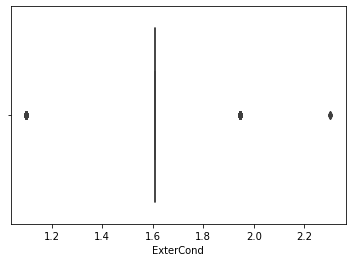

RoofStyle


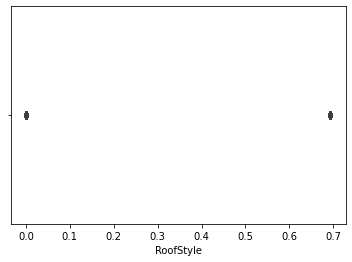

house_finish


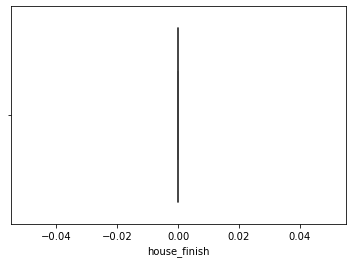

EnclosedPorch


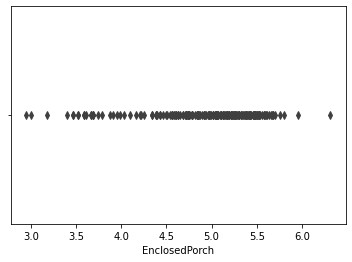

Remodeled


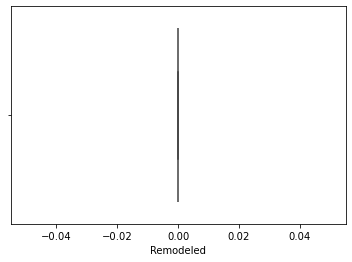

Street_Alley


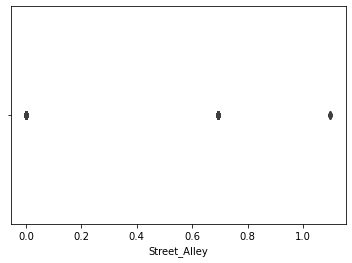

ScreenPorch


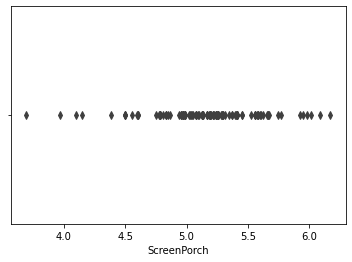

BsmtFullBath


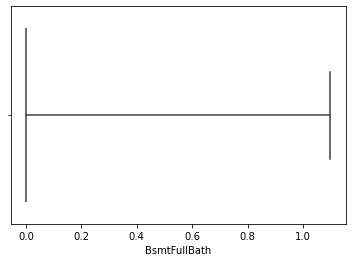

LandSlope


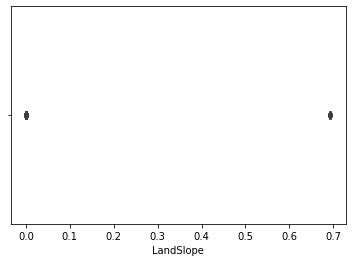

LotConfig


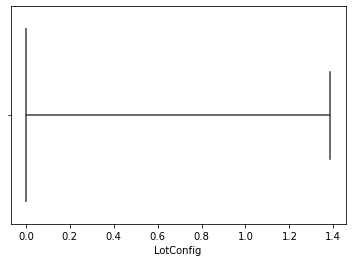

BsmtFinSF2


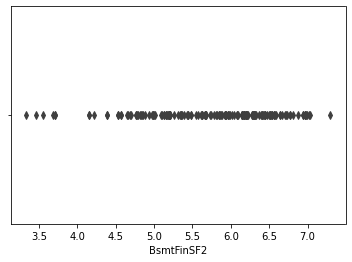

Condition1_Condition2


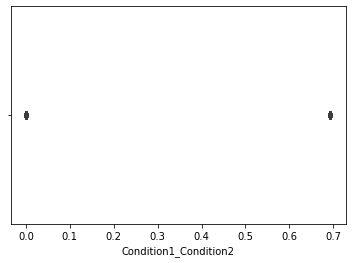

YrSold


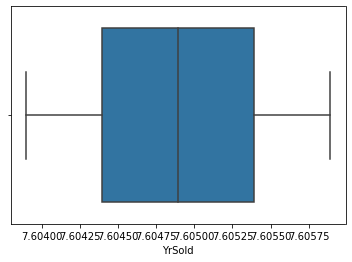

PoolArea


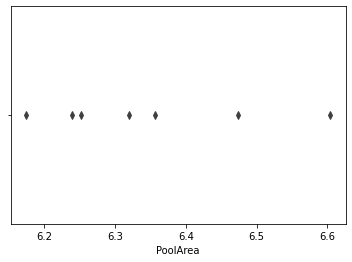

PoolQC


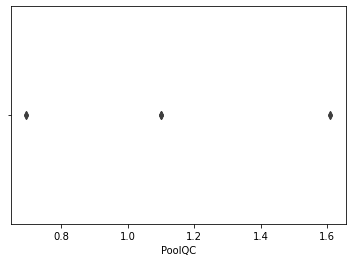

no_finishes_perc


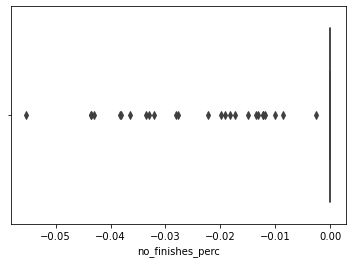

LowQualFinSF


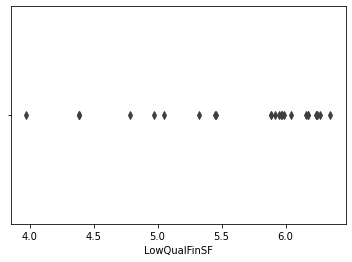

3SsnPorch


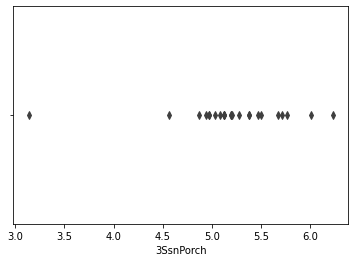

Condition2


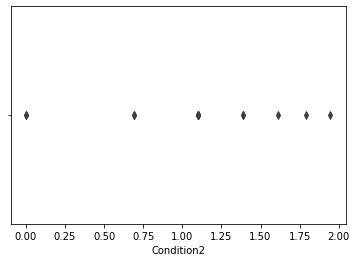

Functional


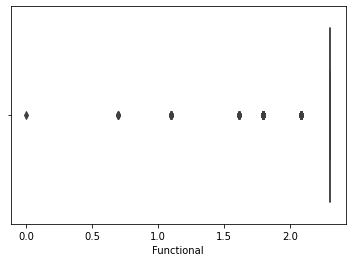

BsmtHalfBath


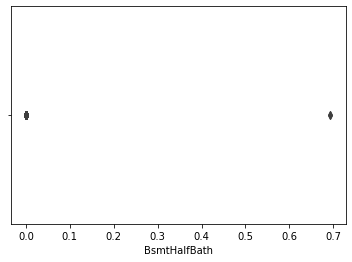

MiscVal


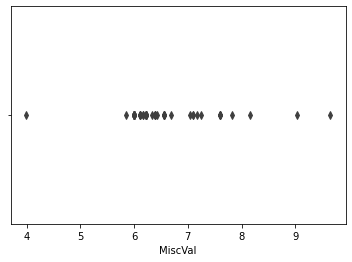

MoSold


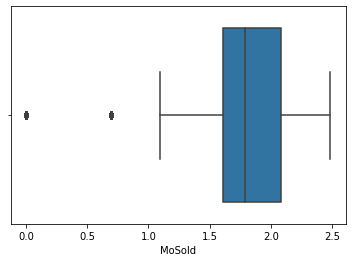

In [55]:
for col in mutual_mxLE:  
    print(col)
    sns.boxplot(logged[col])
    plt.show()
    print('===============================')

In [ ]:
sns.lmplot(x="horsepower", y="price", hue="fuel_type", data=df);

# removing possible outlier fom relplot

In [ ]:
'total_indoor_sqft' > 11000
'GrLivArea' > 4000
'TotalBsmtSF' > 4000
'GarageCars' > 3
'1stFlrSF' >3000
'no_finishes' >100000
'TotalBsmtSF' >4000

In [ ]:
null_df_out = null_df.query(' total_indoor_sqft < 11000 and train_null > 0 and test_null> 0 and merge_perc> 0 and train_perc> 0 and test_perc > 0' )

In [120]:
LE_df[LE_df['total_indoor_sqft'] > 11000]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,avg_Ext_Qual,avg_Bmt_Qual,avg_Gar_Qual,total_All_Qualities,avg_All_Qualities,kfold,LivLotRatio,Spaciousness,PorchTypes,Bmt_Finish_Area_cnt
523,524,60,0,130.0,40094,0,-1,1,1,0,...,7.5,6.2,5.0,69.7,6.336364,-1,0.116626,425.090909,2,1
691,692,60,0,104.0,21535,0,-1,1,0,0,...,7.5,6.2,5.0,71.7,6.518182,-1,0.200418,431.600000,2,1
1182,1183,60,0,160.0,15623,0,-1,1,0,0,...,6.0,6.0,5.0,69.0,6.272727,-1,0.286501,447.600000,2,1
1298,1299,60,0,313.0,63887,0,-1,1,1,0,...,7.5,6.2,5.0,71.7,6.518182,-1,0.088312,470.166667,2,1


In [121]:
LE_df[LE_df['total_indoor_sqft'] > 11000].shape[0]

4

In [125]:
out_cols= ['total_indoor_sqft' ,'GrLivArea','TotalBsmtSF','GarageCars','1stFlrSF','no_finishes','TotalBsmtSF',
           'LotFrontage','total_outdoor_sqft','LotArea','BsmtFinSF1','OpenPorchSF','total_Bmt_Fn_Area',
          'LotAreaPerFront','MasVnrArea','EnclosedPorch']
threshs = [11000,4000,4000,3,3000,100000,4000,250,150000,100000,4000,500,3000,800,1200,350]
for col,thresh in zip(out_cols,threshs):
    n_rows=LE_df[LE_df[col] > thresh].shape[0]
    print(' = ',col,' = ',n_rows)
    print('========================')

 =  total_indoor_sqft  =  4
 =  GrLivArea  =  4
 =  TotalBsmtSF  =  1
 =  GarageCars  =  5
 =  1stFlrSF  =  3
 =  no_finishes  =  4
 =  TotalBsmtSF  =  1
 =  LotFrontage  =  2
 =  total_outdoor_sqft  =  3
 =  LotArea  =  4
 =  BsmtFinSF1  =  1
 =  OpenPorchSF  =  3
 =  total_Bmt_Fn_Area  =  1
 =  LotAreaPerFront  =  4
 =  MasVnrArea  =  2
 =  EnclosedPorch  =  2


In [126]:
for col,thresh in zip(out_cols,threshs):
    n_rows=no_outlier[no_outlier[col] > thresh].shape[0]
    print(' = ',col,' = ',n_rows)
    print('========================')

 =  total_indoor_sqft  =  2
 =  GrLivArea  =  2
 =  TotalBsmtSF  =  1
 =  GarageCars  =  5
 =  1stFlrSF  =  2
 =  no_finishes  =  3
 =  TotalBsmtSF  =  1
 =  LotFrontage  =  2
 =  total_outdoor_sqft  =  2
 =  LotArea  =  3
 =  BsmtFinSF1  =  1
 =  OpenPorchSF  =  3
 =  total_Bmt_Fn_Area  =  1
 =  LotAreaPerFront  =  1
 =  MasVnrArea  =  1
 =  EnclosedPorch  =  2


In [127]:
sub1= ['TotalBsmtSF', '2ndFlrSF', 'YrSd_YrBlt', 'total_indoor_sqft', 'no_finishes', 'OverallQual', 'avg_All_Qualities', 'total_in_out_sqft', 'total_All_Qualities', 'MasVnrArea',
       'YearBuilt', 'GrLivArea', 'BsmtFinSF1', '1stFlrSF', 'GarageArea', 'YearBuilt_Age', 'LotFrontage','SalePrice']

In [152]:
cols_in_sub1 =[]
cols_sub1=[]
for col,thresh in zip(out_cols,threshs):
    if col in sub1:
        cols_sub1.append(col)
        cols_in_sub1.append((col,thresh))
cols_in_sub1
cols_sub1

['total_indoor_sqft',
 'GrLivArea',
 'TotalBsmtSF',
 '1stFlrSF',
 'no_finishes',
 'TotalBsmtSF',
 'LotFrontage',
 'BsmtFinSF1',
 'MasVnrArea']

In [131]:
cols_better_with_log = ['total_in_out_sqft','LotArea']

# removing extra outlier from features 

In [135]:
and 1stFlrSF <= 300
and BsmtFinSF1 <= 4000 

SyntaxError: invalid syntax (<ipython-input-135-e1c6171cb8e6>, line 1)

In [136]:
null_df_out = no_outlier.query(' total_indoor_sqft <= 11000 and GrLivArea <= 400 and TotalBsmtSF <= 4000  and no_finishes <= 100000  and LotFrontage <= 250 and MasVnrArea <= 1200 ' )

In [137]:
no_outlier.shape[0]

1399

In [ ]:
[('total_indoor_sqft', 11000),
 ('GrLivArea', 4000),
 ('TotalBsmtSF', 4000),
 ('1stFlrSF', 3000),
 ('no_finishes', 100000),
 ('TotalBsmtSF', 4000),
 ('LotFrontage', 250),
 ('BsmtFinSF1', 4000),
 ('MasVnrArea', 1200)]

In [143]:
LE_df.shape

(1460, 124)

In [147]:
out_df_no_outlier = pd.DataFrame()
for col_thresh in cols_in_sub1:
    out_df_no_outlier = no_outlier[no_outlier[col_thresh[0]] <= col_thresh[1]]

In [157]:
def get_no_outlier(df_in):
    df = df_in.copy()
    df= df[df['total_indoor_sqft']<= 11000]
    df = df[df['GrLivArea'] <= 4000]
    df = df[df['TotalBsmtSF'] <= 4000]
    df = df[df['1stFlrSF'] <= 3000]
    df = df[df['no_finishes'] <= 100000]
    df = df[df['TotalBsmtSF'] <= 4000]
    df = df[df['LotFrontage'] <= 250]
    df = df[df['BsmtFinSF1'] <= 4000]
    df = df[df['MasVnrArea'] <=1200]
    return df

In [158]:
LE_df_no_outlier= get_no_outlier(LE_df)
LE_df_no_outlier

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,avg_Ext_Qual,avg_Bmt_Qual,avg_Gar_Qual,total_All_Qualities,avg_All_Qualities,kfold,LivLotRatio,Spaciousness,PorchTypes,Bmt_Finish_Area_cnt
0,1,60,0,65.0,8450,0,-1,0,0,0,...,6.0,5.0,4.0,59.0,5.363636,-1,0.202367,213.750000,1,1
1,2,20,0,80.0,9600,0,-1,0,0,0,...,5.0,4.6,4.0,58.6,5.327273,-1,0.131458,210.333333,1,1
2,3,60,0,68.0,11250,0,-1,1,0,0,...,6.0,5.2,4.0,60.2,5.472727,-1,0.158756,297.666667,1,1
3,4,70,0,60.0,9550,0,-1,1,0,0,...,5.0,4.0,3.5,54.5,4.954545,-1,0.179791,245.285714,2,1
4,5,60,0,84.0,14260,0,-1,1,0,0,...,6.0,5.4,4.0,61.4,5.581818,-1,0.154137,244.222222,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1455,1456,60,0,62.0,7917,0,-1,0,0,0,...,5.0,3.4,4.0,54.4,4.945455,-1,0.208033,235.285714,1,0
1456,1457,20,0,85.0,13175,0,-1,0,0,0,...,5.0,4.7,3.5,50.2,4.563636,-1,0.157343,296.142857,1,2
1457,1458,70,0,66.0,9042,0,-1,0,0,0,...,8.5,5.0,4.0,67.5,6.136364,-1,0.258792,260.000000,1,1
1458,1459,20,0,68.0,9717,0,-1,0,0,0,...,5.0,5.5,3.5,52.0,4.727273,-1,0.110940,215.600000,2,2


In [166]:
for col,thresh in zip(out_cols,threshs):
    n_rows=LE_df_no_outlier[LE_df_no_outlier[col] > thresh].shape[0]
    print(' = ',col,' = ',n_rows)
    print('========================')

 =  total_indoor_sqft  =  0
 =  GrLivArea  =  0
 =  TotalBsmtSF  =  0
 =  GarageCars  =  5
 =  1stFlrSF  =  0
 =  no_finishes  =  0
 =  TotalBsmtSF  =  0
 =  LotFrontage  =  0
 =  total_outdoor_sqft  =  0
 =  LotArea  =  0
 =  BsmtFinSF1  =  0
 =  OpenPorchSF  =  3
 =  total_Bmt_Fn_Area  =  0
 =  LotAreaPerFront  =  3
 =  MasVnrArea  =  0
 =  EnclosedPorch  =  2


In [160]:
NO_no_outlier= get_no_outlier(no_outlier)
NO_no_outlier

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,Bsmt_Fsh_Per,avg_Ext_Qual,avg_Bmt_Qual,avg_Gar_Qual,total_All_Qualities,avg_All_Qualities,kfold,LivLotRatio,Spaciousness,PorchTypes
0,1,60,0,65.0,8450,0,-1,0,0,0,...,0.175234,6.0,5.0,4.0,59.0,5.363636,-1,0.202367,213.750000,1
1,2,20,0,80.0,9600,0,-1,0,0,0,...,0.225040,5.0,4.6,4.0,58.6,5.327273,-1,0.131458,210.333333,1
2,3,60,0,68.0,11250,0,-1,1,0,0,...,0.471739,6.0,5.2,4.0,60.2,5.472727,-1,0.158756,297.666667,1
3,4,70,0,60.0,9550,0,-1,1,0,0,...,0.714286,5.0,4.0,3.5,54.5,4.954545,-1,0.179791,245.285714,2
4,5,60,0,84.0,14260,0,-1,1,0,0,...,0.427948,6.0,5.4,4.0,61.4,5.581818,-1,0.154137,244.222222,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1455,1456,60,0,62.0,7917,0,-1,0,0,0,...,1.000000,5.0,3.4,4.0,54.4,4.945455,-1,0.208033,235.285714,1
1456,1457,20,0,85.0,13175,0,-1,0,0,0,...,0.381971,5.0,4.7,3.5,50.2,4.563636,-1,0.157343,296.142857,1
1457,1458,70,0,66.0,9042,0,-1,0,0,0,...,0.761285,8.5,5.0,4.0,67.5,6.136364,-1,0.258792,260.000000,1
1458,1459,20,0,68.0,9717,0,-1,0,0,0,...,0.000000,5.0,5.5,3.5,52.0,4.727273,-1,0.110940,215.600000,2


In [167]:
for col,thresh in zip(out_cols,threshs):
    n_rows=NO_no_outlier[NO_no_outlier[col] > thresh].shape[0]
    print(' = ',col,' = ',n_rows)
    print('========================')

 =  total_indoor_sqft  =  0
 =  GrLivArea  =  0
 =  TotalBsmtSF  =  0
 =  GarageCars  =  5
 =  1stFlrSF  =  0
 =  no_finishes  =  0
 =  TotalBsmtSF  =  0
 =  LotFrontage  =  0
 =  total_outdoor_sqft  =  0
 =  LotArea  =  0
 =  BsmtFinSF1  =  0
 =  OpenPorchSF  =  3
 =  total_Bmt_Fn_Area  =  0
 =  LotAreaPerFront  =  1
 =  MasVnrArea  =  0
 =  EnclosedPorch  =  2


# training LE_df no outlier

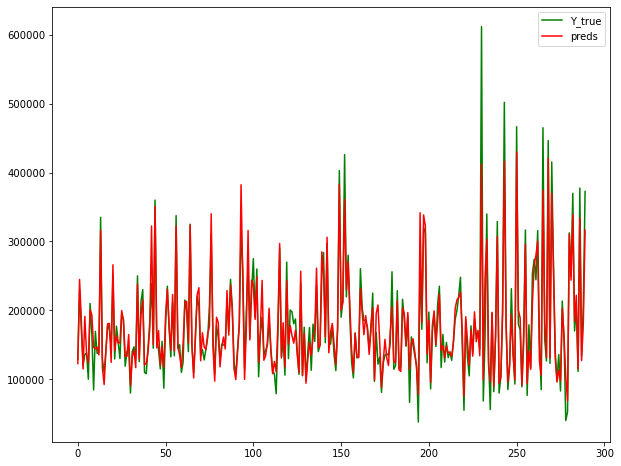

Fold = 0, RMSE = 25308.78961857429


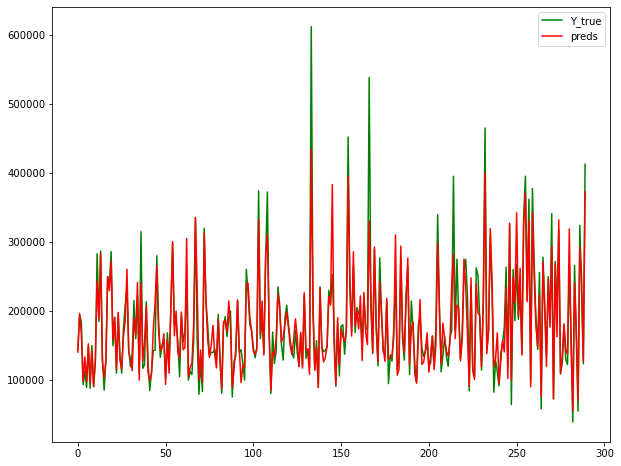

Fold = 1, RMSE = 28717.580562259882


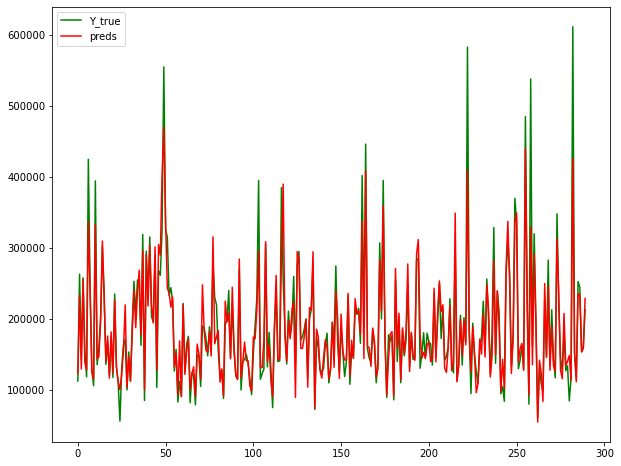

Fold = 2, RMSE = 30872.305006207996


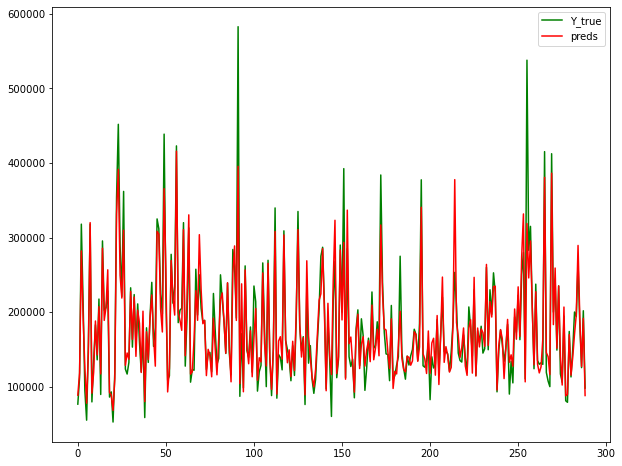

Fold = 3, RMSE = 28543.606976785017


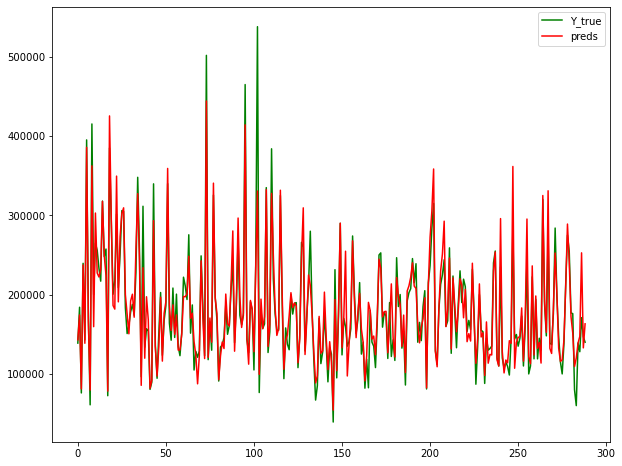

Fold = 4, RMSE = 26172.442983280376
mean_score =  27922.945029421513


In [159]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=LE_df_no_outlier[sub1],target=target,model=baseline,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

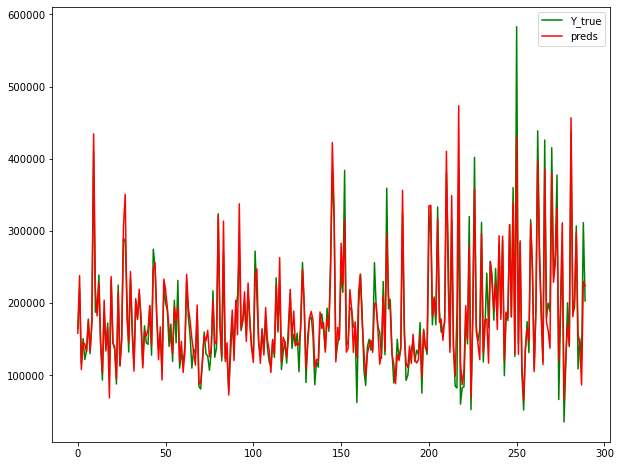

Fold = 0, RMSE = 24619.395097795626


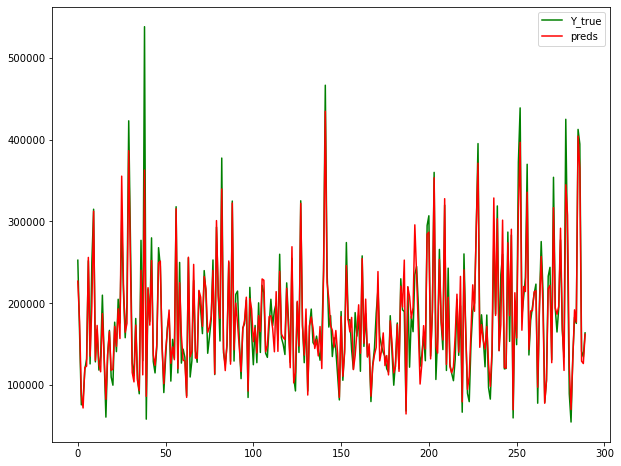

Fold = 1, RMSE = 22638.69666946712


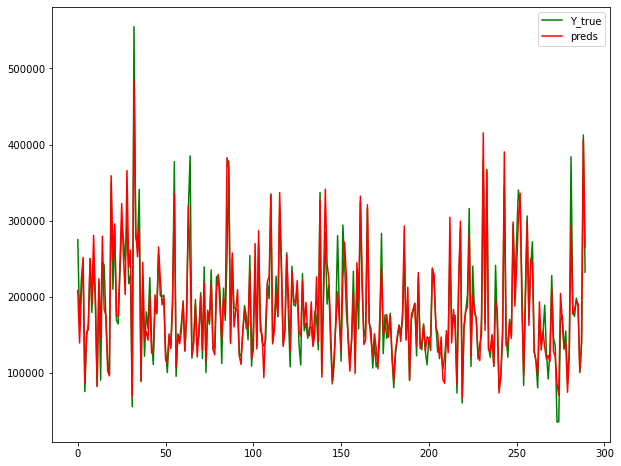

Fold = 2, RMSE = 24858.140628264533


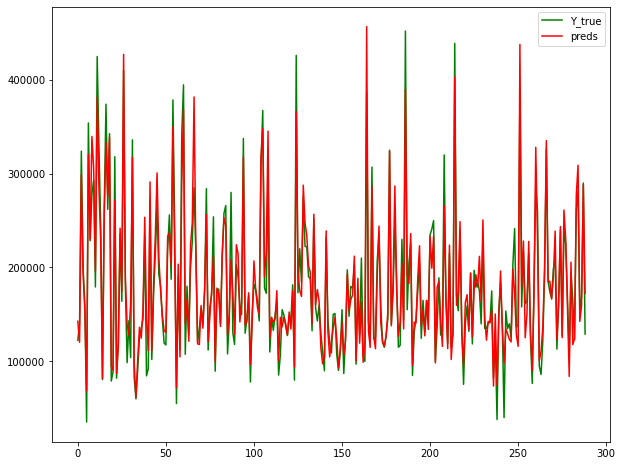

Fold = 3, RMSE = 22357.953301868005


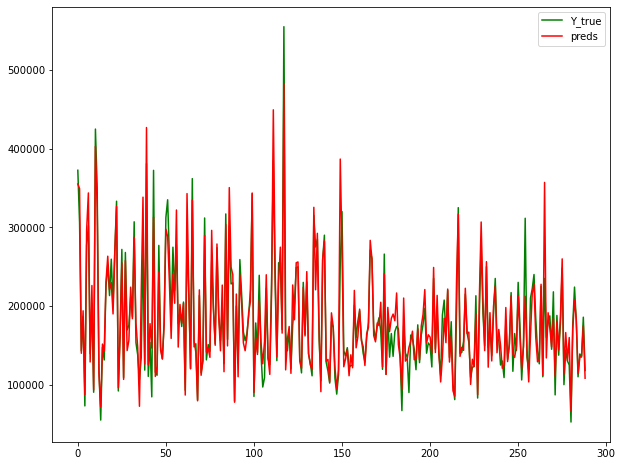

Fold = 4, RMSE = 24099.877611843713
mean_score =  23714.812661847798


In [162]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=LE_df_no_outlier[sub1],target=target,model=rf,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

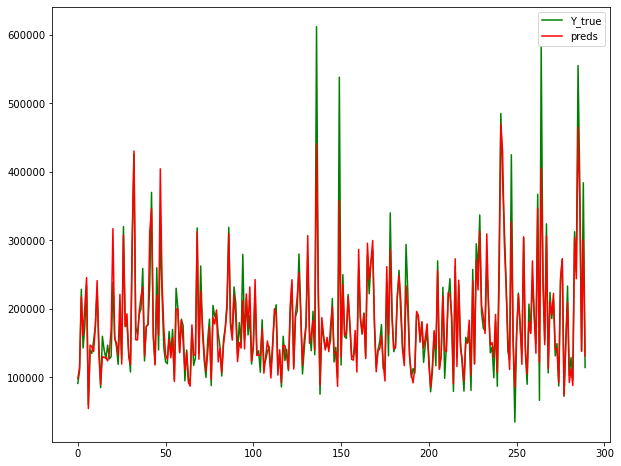

Fold = 0, RMSE = 27462.143044472472


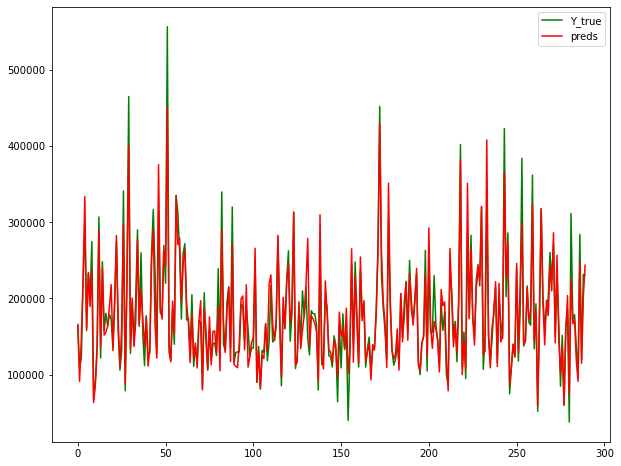

Fold = 1, RMSE = 23998.136932984246


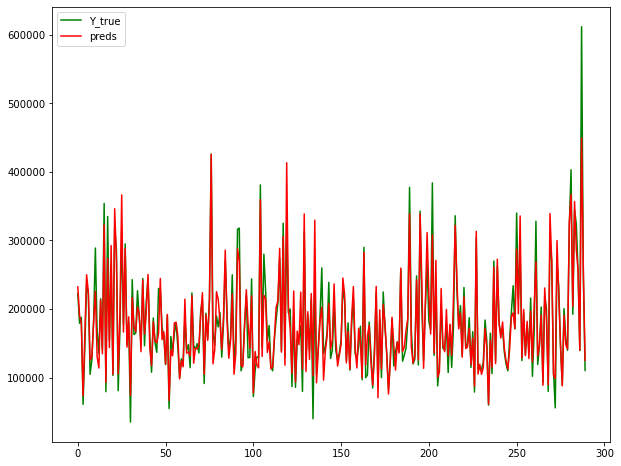

Fold = 2, RMSE = 23960.760956925133


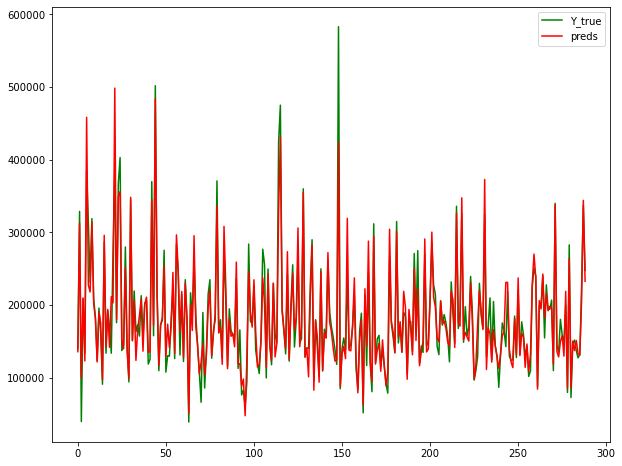

Fold = 3, RMSE = 24439.04454032307


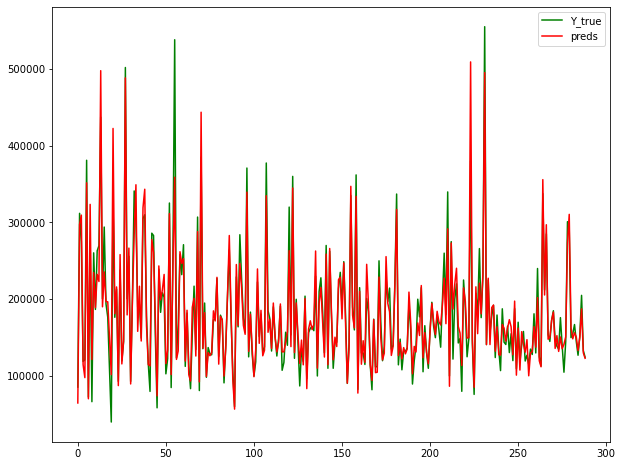

Fold = 4, RMSE = 23767.493255729758
mean_score =  24725.515746086934


In [163]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=LE_df_no_outlier[sub1],target=target,model=et,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

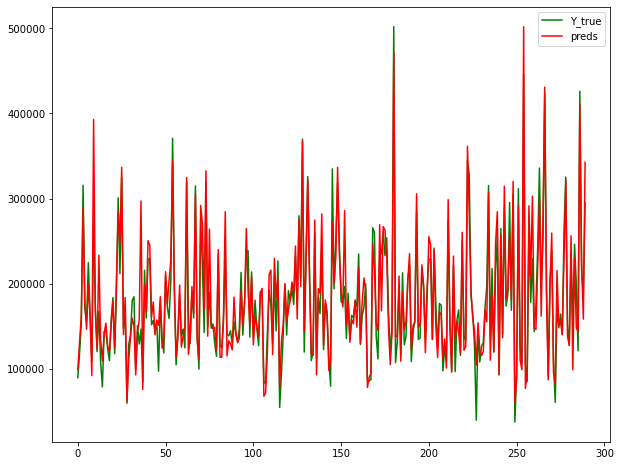

Fold = 0, RMSE = 24864.09958849574


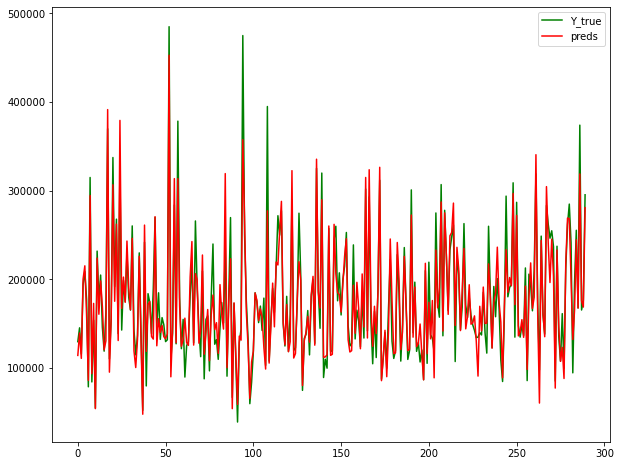

Fold = 1, RMSE = 23777.432713272457


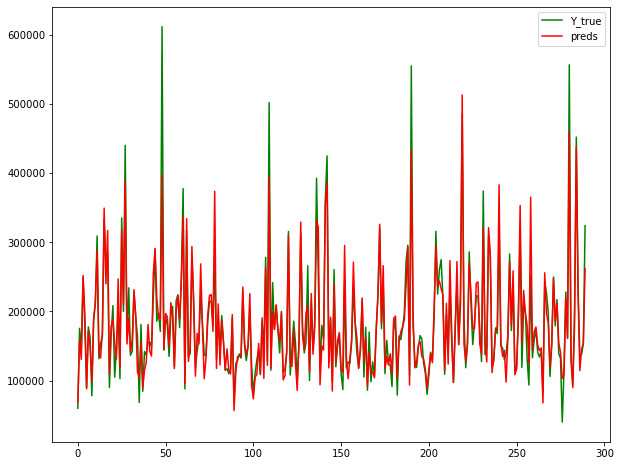

Fold = 2, RMSE = 27568.398930302716


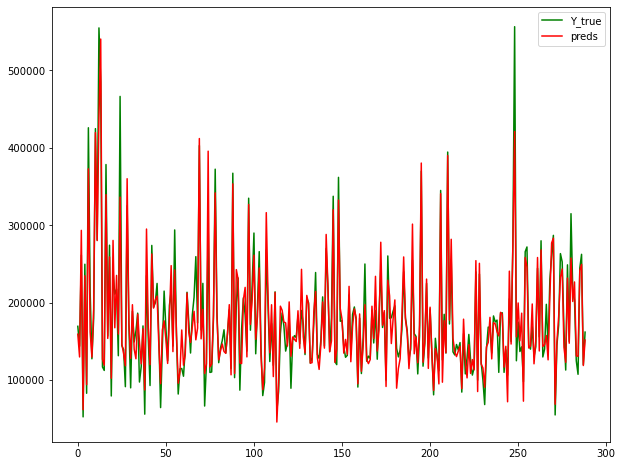

Fold = 3, RMSE = 25593.064288366095


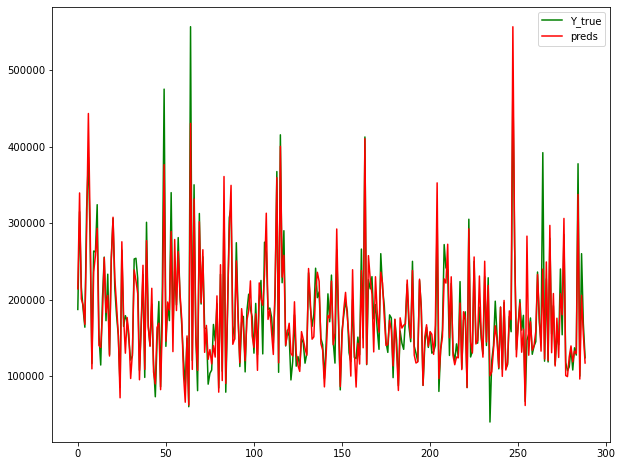

Fold = 4, RMSE = 24990.473173988907
mean_score =  25358.693738885184


In [164]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=LE_df_no_outlier[sub1],target=target,model=xgb,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

# training NO_no_outlier

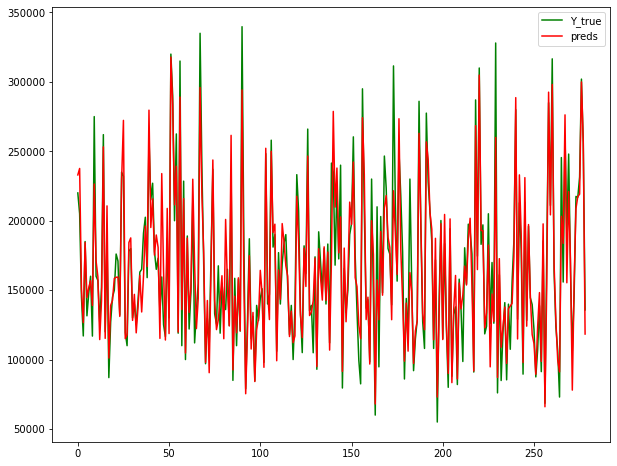

Fold = 0, RMSE = 20047.180748538343


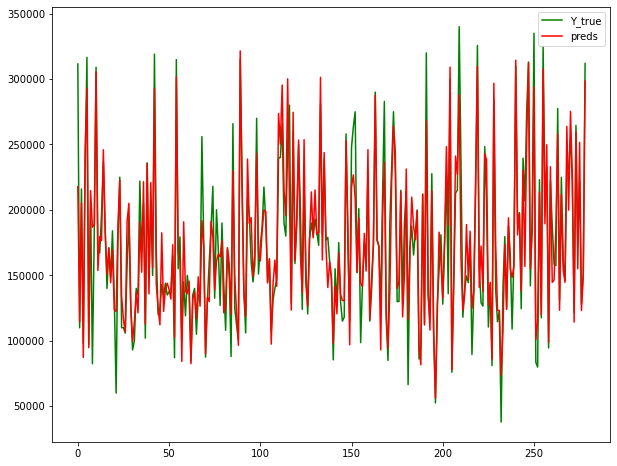

Fold = 1, RMSE = 22564.92545813935


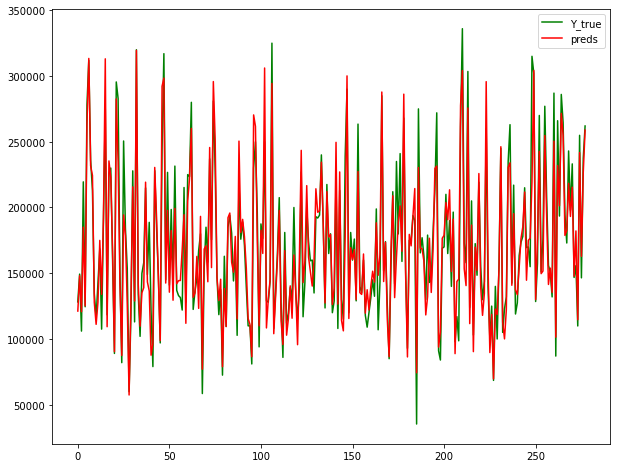

Fold = 2, RMSE = 19673.44644975937


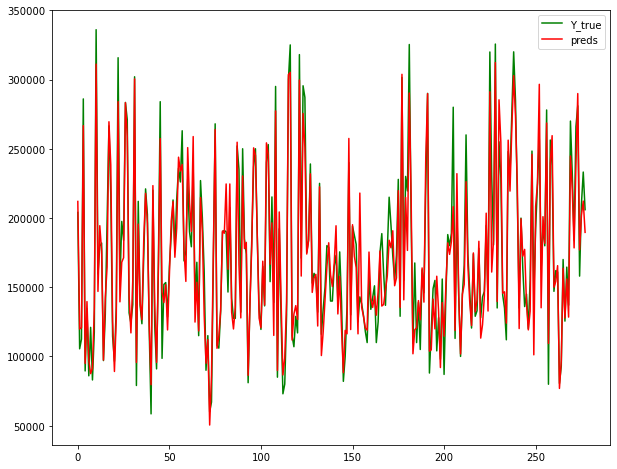

Fold = 3, RMSE = 18134.904886949636


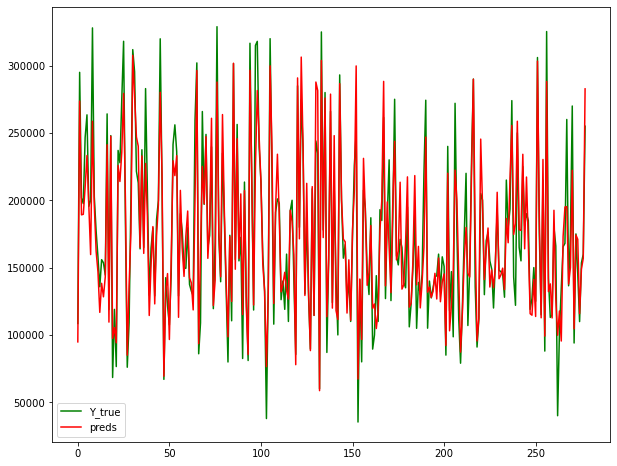

Fold = 4, RMSE = 22631.0041333564
mean_score =  20610.29233534862


In [165]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=NO_no_outlier[sub1],target=target,model=rf,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

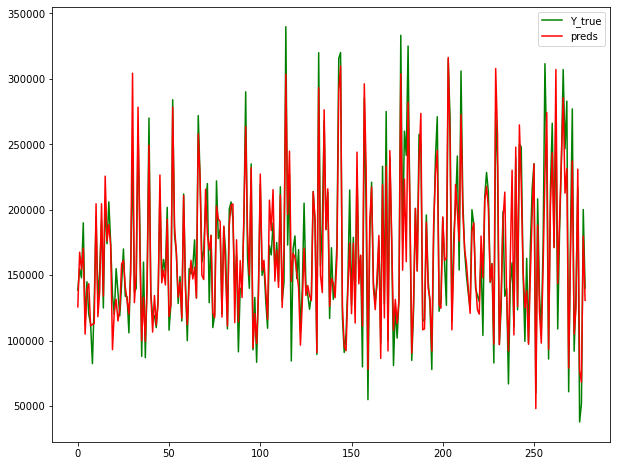

Fold = 0, RMSE = 20002.169101282096


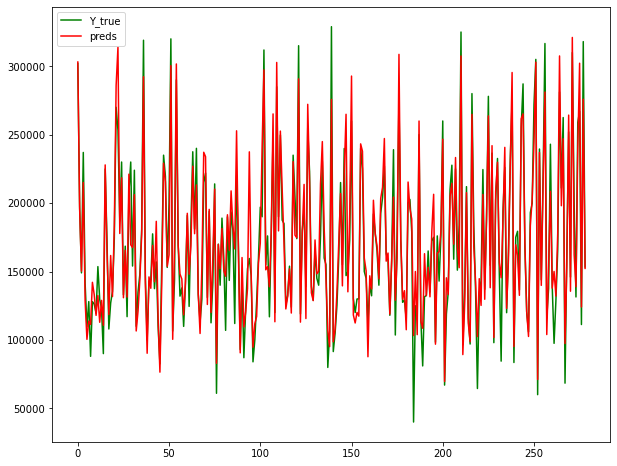

Fold = 1, RMSE = 19715.95391249338


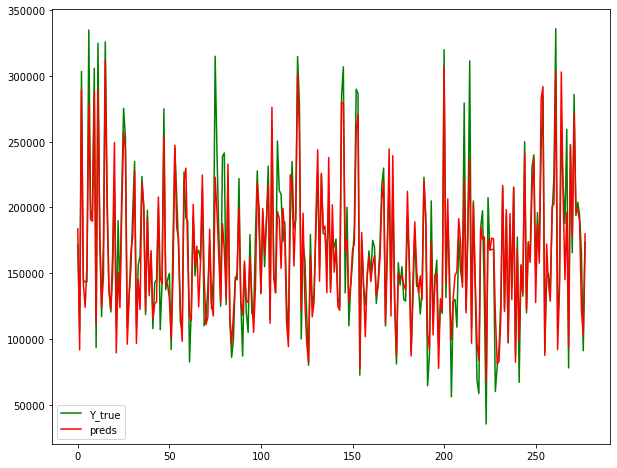

Fold = 2, RMSE = 21113.325982088987


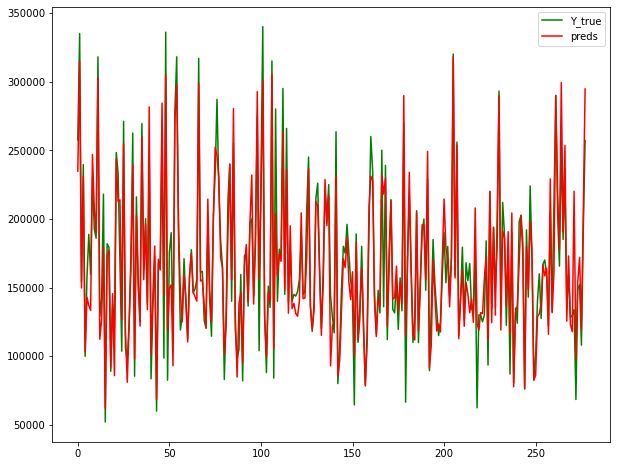

Fold = 3, RMSE = 19368.385685969584


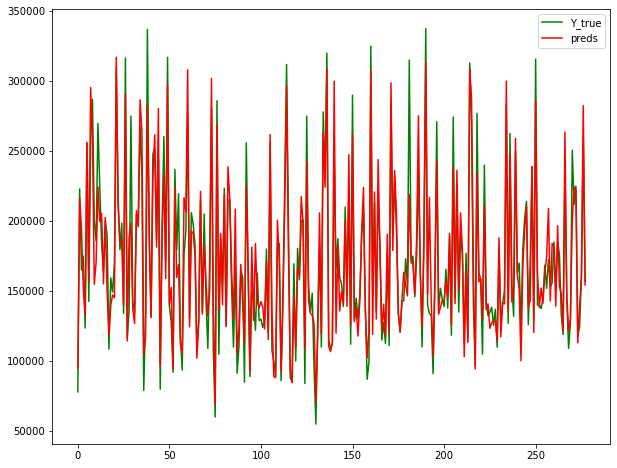

Fold = 4, RMSE = 20312.69556977027
mean_score =  20102.506050320862


In [168]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=NO_no_outlier[sub1],target=target,model=baseline,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

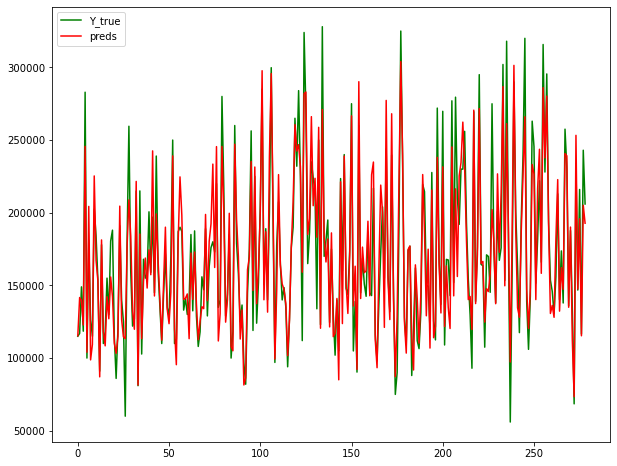

Fold = 0, RMSE = 21204.820018011484


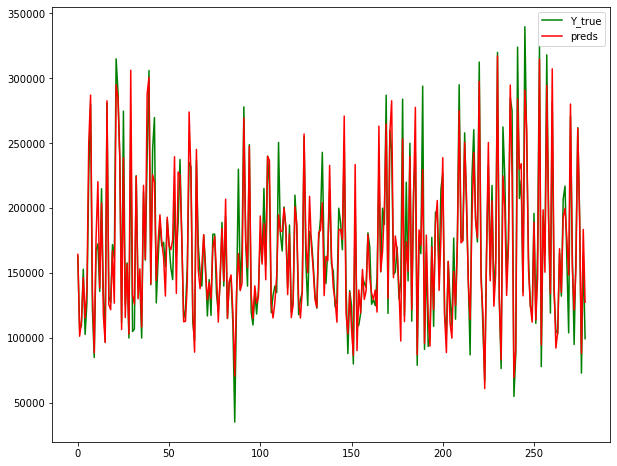

Fold = 1, RMSE = 18130.83634975104


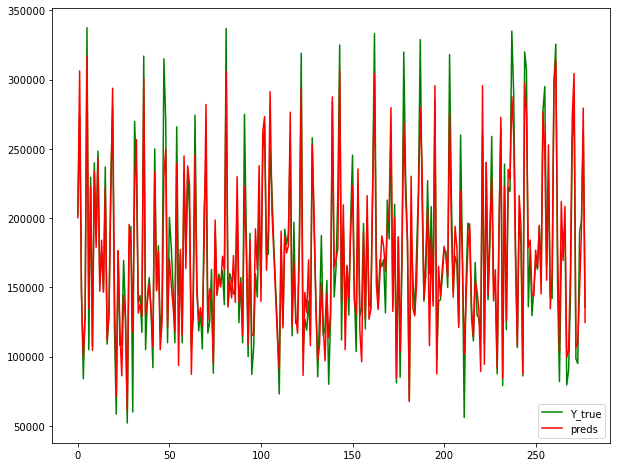

Fold = 2, RMSE = 19993.297706966794


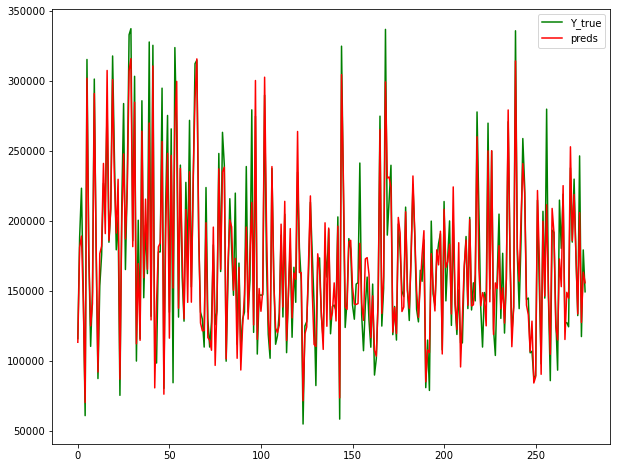

Fold = 3, RMSE = 18748.695031488198


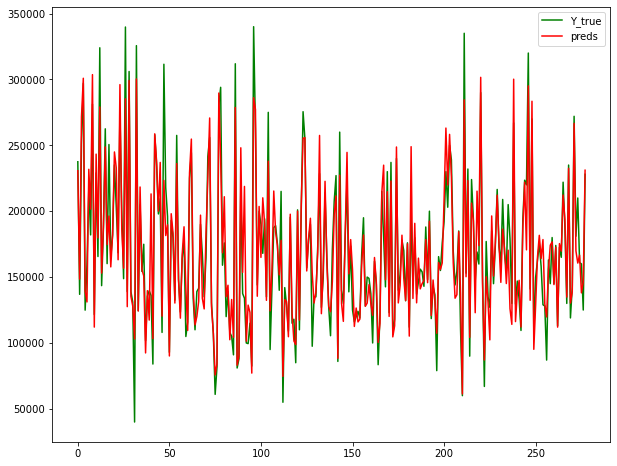

Fold = 4, RMSE = 20648.851314282205
mean_score =  19745.300084099945


In [169]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df=NO_no_outlier[sub1],target=target,model=et,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

In [170]:
def log_some_cols(df_in,col_list):
    df = df_in.copy()
    for col in col_list:
        df[col+'_log'] = np.log(df[col]+1) 
    df=df.drop(col_list,axis=1)
    return df

In [175]:
cols_better_with_log = ['total_in_out_sqft','LotArea']
No_no_log = log_some_cols(df_in=NO_no_outlier,col_list=cols_better_with_log)
LE_df_no_log = log_some_cols(df_in=LE_df_no_outlier,col_list=cols_better_with_log) 

In [178]:
No_no_log

,Id,MSSubClass,MSZoning,LotFrontage,Street,Alley,LotShape,LandContour,Utilities,LotConfig,...,avg_Bmt_Qual,avg_Gar_Qual,total_All_Qualities,avg_All_Qualities,kfold,LivLotRatio,Spaciousness,PorchTypes,total_in_out_sqft_log,LotArea_log
0,1,60,0,65.0,0,-1,0,0,0,0,...,5.0,4.0,59.0,5.363636,-1,0.202367,213.750000,1,9.493638,9.042040
1,2,20,0,80.0,0,-1,0,0,0,1,...,4.6,4.0,58.6,5.327273,-1,0.131458,210.333333,1,9.535824,9.169623
2,3,60,0,68.0,0,-1,1,0,0,0,...,5.2,4.0,60.2,5.472727,-1,0.158756,297.666667,1,9.702044,9.328212
3,4,70,0,60.0,0,-1,1,0,0,2,...,4.0,3.5,54.5,4.954545,-1,0.179791,245.285714,2,9.573802,9.164401
4,5,60,0,84.0,0,-1,1,0,0,1,...,5.4,4.0,61.4,5.581818,-1,0.154137,244.222222,2,9.934889,9.565284
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1455,1456,60,0,62.0,0,-1,0,0,0,0,...,3.4,4.0,54.4,4.945455,-1,0.208033,235.285714,1,9.443434,8.976894
1456,1457,20,0,85.0,0,-1,0,0,0,0,...,4.7,3.5,50.2,4.563636,-1,0.157343,296.142857,1,9.871171,9.486152
1457,1458,70,0,66.0,0,-1,0,0,0,0,...,5.0,4.0,67.5,6.136364,-1,0.258792,260.000000,1,9.624237,9.109746
1458,1459,20,0,68.0,0,-1,0,0,0,0,...,5.5,3.5,52.0,4.727273,-1,0.110940,215.600000,2,9.487366,9.181735


# logged some columns

In [186]:
sub1= ['TotalBsmtSF', '2ndFlrSF', 'YrSd_YrBlt', 'total_indoor_sqft', 'no_finishes', 'OverallQual', 'avg_All_Qualities', 'total_All_Qualities', 'MasVnrArea',
       'YearBuilt', 'GrLivArea', 'BsmtFinSF1', '1stFlrSF', 'GarageArea', 'YearBuilt_Age', 'LotFrontage','LivLotRatio','Spaciousness',
       'PorchTypes','total_in_out_sqft_log','LotArea_log','SalePrice']
sub1

['TotalBsmtSF',
 '2ndFlrSF',
 'YrSd_YrBlt',
 'total_indoor_sqft',
 'no_finishes',
 'OverallQual',
 'avg_All_Qualities',
 'total_All_Qualities',
 'MasVnrArea',
 'YearBuilt',
 'GrLivArea',
 'BsmtFinSF1',
 '1stFlrSF',
 'GarageArea',
 'YearBuilt_Age',
 'LotFrontage',
 'LivLotRatio',
 'Spaciousness',
 'PorchTypes',
 'total_in_out_sqft_log',
 'LotArea_log',
 'SalePrice']

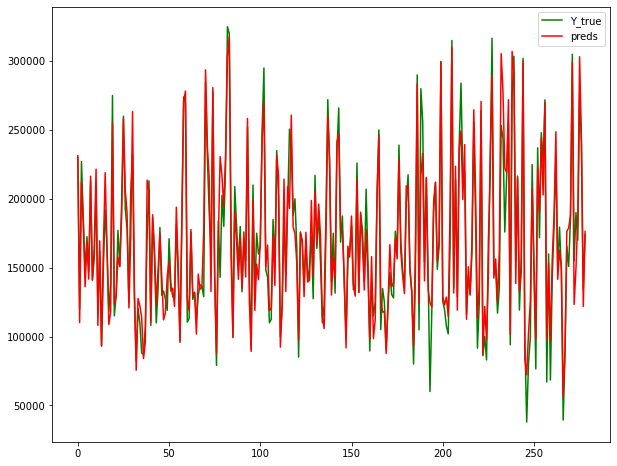

Fold = 0, RMSE = 17023.53175630004


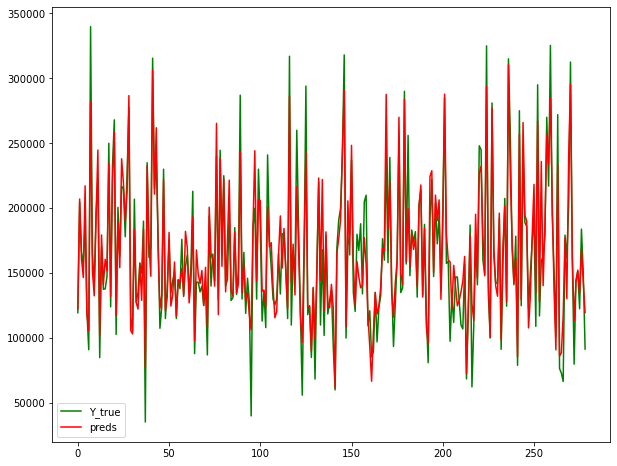

Fold = 1, RMSE = 20238.509910363086


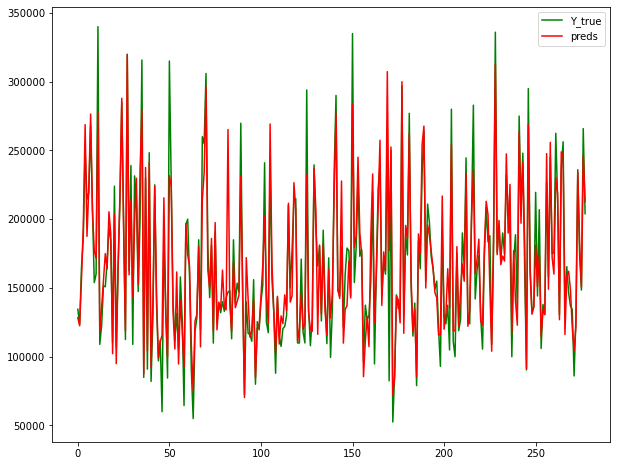

Fold = 2, RMSE = 20439.627989081255


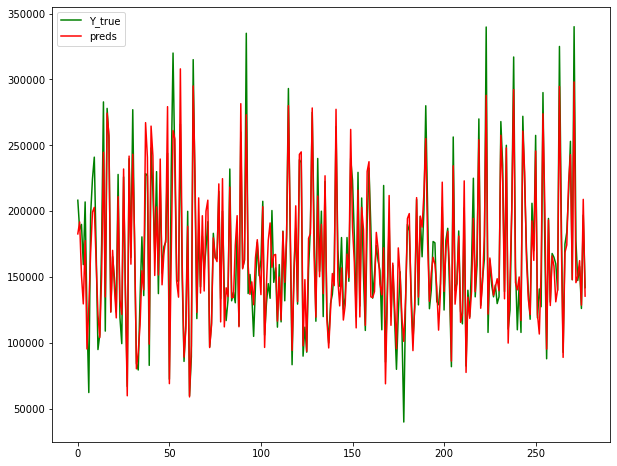

Fold = 3, RMSE = 19476.520980818877


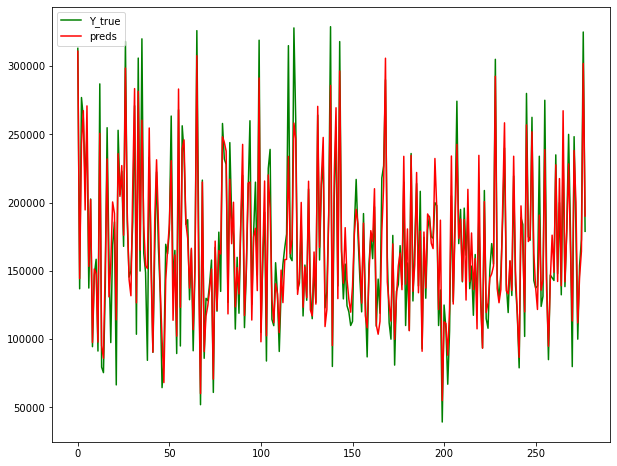

Fold = 4, RMSE = 19082.803813290273
mean_score =  19252.198889970707


In [188]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df= No_no_log[sub1],target=target,model=et,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

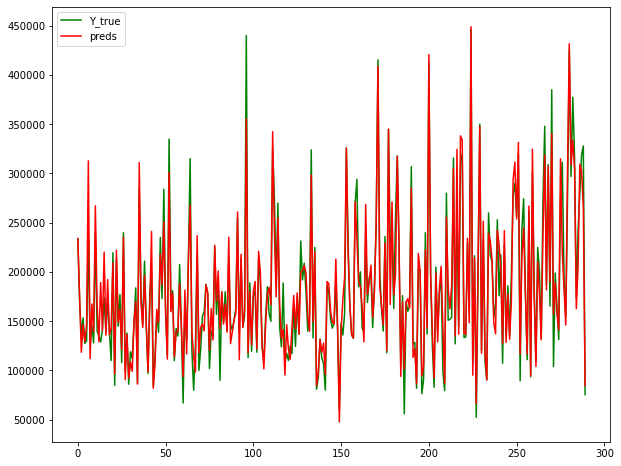

Fold = 0, RMSE = 21067.19489634367


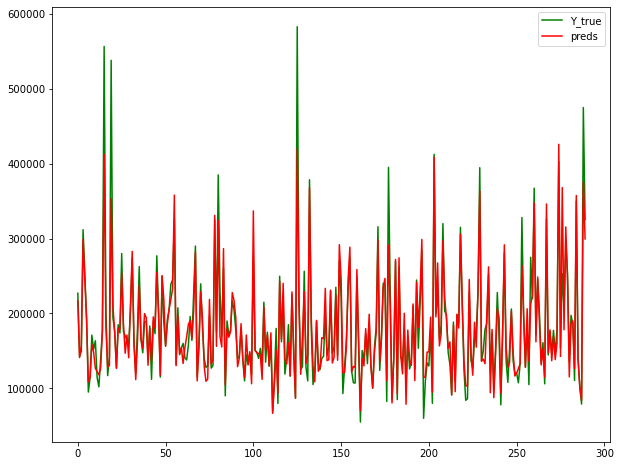

Fold = 1, RMSE = 26211.364215947193


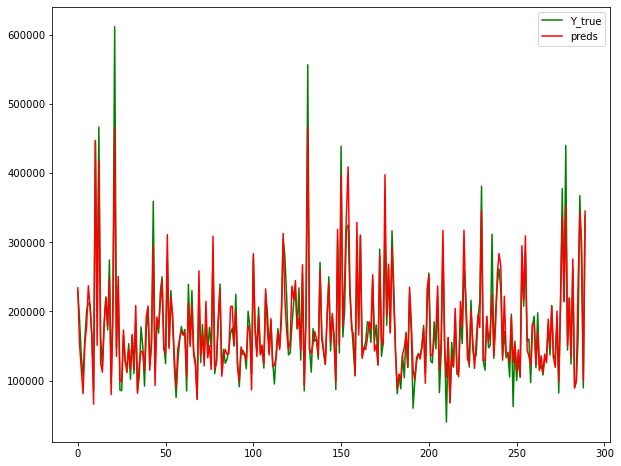

Fold = 2, RMSE = 24250.854861248517


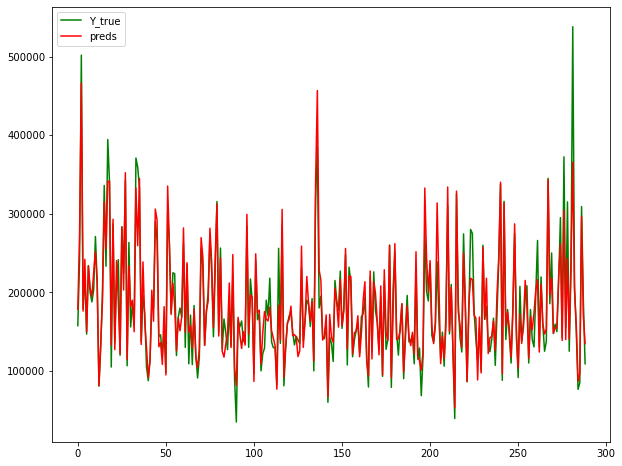

Fold = 3, RMSE = 23731.012404178782


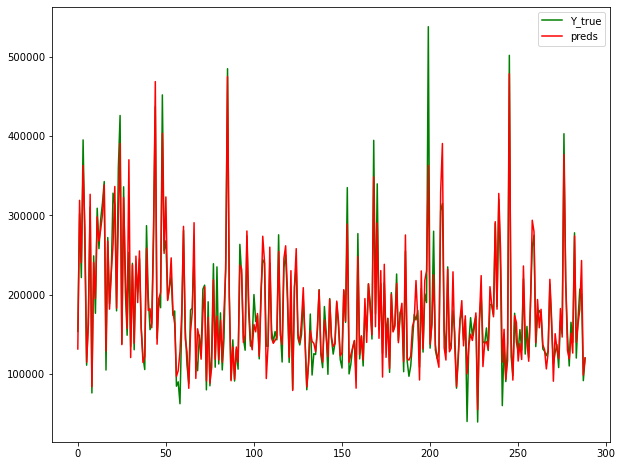

Fold = 4, RMSE = 23558.814424248136
mean_score =  23763.84816039326


In [189]:
RMSE_arr=[]
for i in np.arange(5):
    score= run(df= LE_df_no_log[sub1],target=target,model=et,fold=i,dropped=[],save_fold_csv=False)  ; RMSE_arr.append(score)
print('mean_score = ', np.mean(RMSE_arr))

# whole new universe  of clustering

### check kaggle cluster exercise

## Cluster Labels as a Feature
Applied to a single real-valued feature, 
clustering acts like a traditional "binning" or "discretization" transform. 
On multiple features, it's like "multi-dimensional binning" (sometimes called vector quantization).

In [7]:
NO_no_outlier.shape

NameError: name 'NO_no_outlier' is not defined

In [ ]:
#YearBuilt

In [ ]:
from sklearn.cluster import KMeans

In [ ]:
X = df.copy()
y = X.pop("SalePrice")


# YOUR CODE HERE: Define a list of the features to be used for the clustering
features = ['LotArea', 'TotalBsmtSF', 'FirstFlrSF', 'SecondFlrSF','GrLivArea']


# Standardize
X_scaled = X.loc[:, features]
X_scaled = (X_scaled - X_scaled.mean(axis=0)) / X_scaled.std(axis=0)


# YOUR CODE HERE: Fit the KMeans model to X_scaled and create the cluster labels
kmeans = KMeans( n_clusters=10, random_state=0)

X_scaled = (X_scaled - X_scaled.mean(axis=0)) / X_scaled.std(axis=0)
X["Cluster"] = kmeans.fit_predict(X_scaled)
#X["Cluster"]=  X["Cluster"].astype('category')

# Check your answer
q_2.check()

In [ ]:
Xy = X.copy()
Xy["Cluster"] = Xy.Cluster.astype("category")
Xy["SalePrice"] = y
sns.relplot(
    x="value", y="SalePrice", hue="Cluster", col="variable",
    height=4, aspect=1, facet_kws={'sharex': False}, col_wrap=3,
    data=Xy.melt(
        value_vars=features, id_vars=["SalePrice", "Cluster"],
    ),
);


In [ ]:
# from cluster baby
#elbow plot
k_rng = range(1,10)
sse=[]
for i in k_rng:
    k=KMeans(n_clusters=i)
    k.fit(df1[['xl','xw']])
    sse.append(k.inertia_)
    
plt.figure(figsize=(10,7))
plt.plot(k_rng,sse,'-r+')
plt.title('elbow plot')
plt.xlabel('no of clusters')
plt.ylabel('square sum error')

# PCA

In [2]:
"""
(Technical note: 
PCA is typically applied to standardized data.
With standardized data "variation" means "correlation". 
With unstandardized data "variation" means "covariance". 
All data in this course will be standardized before applying PCA.)
"""

'\n(Technical note: \nPCA is typically applied to standardized data.\nWith standardized data "variation" means "correlation". \nWith unstandardized data "variation" means "covariance". \nAll data in this course will be standardized before applying PCA.)\n'

In [ ]:
"""
The first way is to use it as a descriptive technique. 
Since the components tell you about the variation, 
you could compute the MI scores for the components and see what kind of variation is most predictive of your target. 

You could even try clustering on one or more of the high-scoring components.
"""